## Adversarial AI Vaccine

#### Written by gyu young Lee    2021.10.11

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn import datasets
from sklearn.model_selection import train_test_split

import tensorflow as tf
import matplotlib

In [2]:
mnist = tf.keras.datasets.mnist
(train_images, train_labels), (test_images, test_labels) = mnist.load_data()

In [3]:
## 이미지 데이터는 픽셀마다 0~255 사이의 값을 가짐.
## [데이터표준화] 255로 나누어 0~1 사이로 맞추는 것이 유리함.
train_images = train_images / 255
test_images = test_images / 255

In [4]:
# -- 각 설정값 --
img_size = 28  # 이미지 크기와 폭
n_mid = 30  # 은닉층 뉴런 수
n_out = 10
eta = 0.001  # 학습률
epochs = 20 
batch_size = 32
interval = 5  # 경과 시간 표시 간격

In [5]:
# -- 전결합층의 부모 클래스 --
class BaseLayer:
    def update(self, eta):
        self.w -= eta * self.grad_w
        self.b -= eta * self.grad_b

# -- 은닉층 --
class MiddleLayer(BaseLayer):
    def __init__(self, n_upper, n):
        self.w = np.random.randn(n_upper, n) * np.sqrt(2/n_upper)
        self.b = np.zeros(n)

    def forward(self, x):
        self.x = x
        self.u = np.dot(x, self.w) + self.b
        self.y = np.where(self.u <= 0, 0, self.u) # ReLU
    
    def backward(self, grad_y):
        delta = grad_y * np.where(self.u <= 0, 0, 1)  # ReLU 미분

        self.grad_w = np.dot(self.x.T, delta)
        self.grad_b = np.sum(delta, axis=0)
        self.grad_x = np.dot(delta, self.w.T) 

# -- 출력층 --
class OutputLayer(BaseLayer):
    def __init__(self, n_upper, n):
        self.w = np.random.randn(n_upper, n) / np.sqrt(n_upper)  # 자비에르 초기화 기반의 초깃값
        self.b = np.zeros(n)

    def forward(self, x):
        self.x = x
        u = np.dot(x, self.w) + self.b
        # amended by gylee 2021-07-10
        #self.y = np.exp(u)/np.sum(np.exp(u), axis=1, keepdims=True)  # softmax 함수
        self.y = np.exp(u-np.max(u))/np.sum(np.exp(u-np.max(u)), axis=1, keepdims=True)  # softmax 함수
        #self.y = np.clip(np.exp(u-np.max(u)), 1e-10, None)/np.clip(np.sum(np.exp(u-np.max(u)), axis=1, keepdims=True), 1e-10, None)  # softmax 함수

    def backward(self, t):
        delta = self.y - t
                
        self.grad_w = np.dot(self.x.T, delta)
        self.grad_b = np.sum(delta, axis=0)
        self.grad_x = np.dot(delta, self.w.T)

# -- 각층의 초기화 --
layers = [MiddleLayer(img_size*img_size, n_mid), OutputLayer(n_mid, n_out)]

# -- 순전파 --
def forward_propagation(x):
    for layer in layers:
        layer.forward(x)
        x = layer.y
    return x

# -- 역전파 --
def backpropagation(t):
    grad_y = t
    for layer in reversed(layers):
        layer.backward(grad_y)
        grad_y = layer.grad_x
    return grad_y

# -- 파라미터 갱신 --
def update_params():
    for layer in layers:
        layer.update(eta)

# -- 오차 측정 --
def get_error(x, t):
    y = forward_propagation(x)
    return -np.sum(t*np.log(y+1e-7)) / len(y)  # 교차엔트로피 오차

# -- 정답률 측정 --
def get_accuracy(x, t):
    y = forward_propagation(x)
    total = len(y)
    hit = np.sum(np.argmax(y, axis=1) == np.argmax(t, axis=1))
    miss = total-hit
    acc = hit / total
    return total, hit, miss, acc

In [6]:
# -- 은닉층 --
class MiddleLayer_Ad(BaseLayer):
    def __init__(self, n_upper, n):
        self.w = np.random.randn(n_upper, n) * np.sqrt(2/n_upper)
        self.b = np.zeros(n)
   
    def backward(self, layer, grad_y):
        delta = grad_y * np.where(layer.u <= 0, 0, 1)  # ReLU 미분

        self.grad_w = np.dot(layer.x.T, delta)
        self.grad_b = np.sum(delta, axis=0)
        self.grad_x = np.dot(delta, layer.w.T)       

# -- 출력층 --
class OutputLayer_Ad(BaseLayer):
    def __init__(self, n_upper, n):
        self.w = np.random.randn(n_upper, n) / np.sqrt(n_upper)  # 자비에르 초기화 기반의 초깃값
        self.b = np.zeros(n)

    def backward(self, layer, t):
        delta = layer.y - t
        self.grad_w = np.dot(layer.x.T, delta)
        self.grad_b = np.sum(delta, axis=0)
        self.grad_x = np.dot(delta, layer.w.T)
        
# -- 각층의 초기화 --
layers_ad = [MiddleLayer_Ad(img_size*img_size, n_mid),
          OutputLayer_Ad(n_mid, n_out)]

# -- 역전파 --
def backpropagation_ad(t):
    grad_y = t
    for layer, layer_ad in zip(reversed(layers), reversed(layers_ad)):
        layer_ad.backward(layer, grad_y)
        grad_y = layer_ad.grad_x
    return grad_y

# -- 파라미터 갱신 --
def update_params_ad():
    for layer in layers_ad:
        layer.update(eta)

In [7]:
def input_derivative(x, y):  
    # 예측값을 구한다.
    forward_propagation(x)
         
    # 역전파
    grad_y = backpropagation_ad(y)

    # 파라미터 갱신
    update_params_ad()
                  
    # Return derivatives WRT to input
    return grad_y

In [8]:
def adversarial(n, steps, eta):
    """
    n : integer
        our goal label (just an int, the function transforms it into a one-hot vector)
    steps : integer
        number of steps for gradient descent
    eta : float
        step size for gradient descent
    """
    # Set the goal output
    goal = np.zeros((1, 10))
    goal[0, n] = 1

    # Create a random image to initialize gradient descent with
    x = np.random.normal(.5, .3, (1, 784))

    # Gradient descent on the input
    for i in range(steps):
        # Calculate the derivative
        d = input_derivative(x, goal)
        
        # The GD update on x
        x -= eta * d
        
    return x

# Wrapper function
def generate(n):
    """
    n : integer
        goal label (not a one hot vector)
    """
    a = adversarial(n, 1000, 1)
    prediction = forward_propagation(a)
    x = np.round(prediction, 2)
    
    print('Network Output: \n' + str(x) + '\n')
    print('Network Prediction: ' + str(np.argmax(x)) + '\n')
    
    print('Adversarial Example: ')
    plt.imshow(a.reshape(28,28), cmap='Greys')

In [9]:
# generate(9)

In [10]:
def sneaky_adversarial(n, x_target, steps, eta, lam=.05):
    """
    net : network object
        neural network instance to use
    n : integer
        our goal label (just an int, the function transforms it into a one-hot vector)
    x_target : numpy vector
        our goal image for the adversarial example
    steps : integer
        number of steps for gradient descent
    eta : float
        step size for gradient descent
    lam : float
        lambda, our regularization parameter. Default is .05
    """
    
    # Set the goal output
    goal = np.zeros((1, 10))
    goal[0, n] = 1

    # Create a random image to initialize gradient descent with
    x = np.random.normal(.5, .3, (1, 784))

    # Gradient descent on the input
    for i in range(steps):
        # Calculate the derivative
        d = input_derivative(x,goal)
        
        # The GD update on x, with an added penalty to the cost function
        # ONLY CHANGE IS RIGHT HERE!!!
        x_target = x_target.reshape(1,784)
        x -= eta * (d + lam * (x - x_target))

    return x

# Wrapper function
def sneaky_generate(n, m):
    """
    n: int 0-9, the target number to match. 머신러닝 네트워크로 하여금 판정하게 하고 싶은 숫자
    m: index of example image to use (from the test set). 만들고자 하는 숫자의 모습
    """
    
    # Find random instance of m in test set
    idx = np.random.randint(0, len(test_labels))
    while test_labels[idx] != m:
        idx += 1
    
    a = sneaky_adversarial(n, test_images[idx], 100, 1)  
    prediction = forward_propagation(a)
    x = np.round(prediction, 2)
    
    print('\nWhat we want our adversarial example to look like: ')
    plt.imshow(test_images[idx].reshape((28,28)), cmap='Greys')
    plt.show()
    
    print('\n')
    
    print('Adversarial Example: ')
    
    plt.imshow(a.reshape(28,28), cmap='Greys')
    plt.show()
    
    print('Network Prediction: ' + str(np.argmax(x)) + '\n')
    print('Network Output: \n' + str(x) + '\n')
    
    return a

In [11]:
# sneaky_generate(target label, target digit)
#adv_ex = sneaky_generate(7, 6)

In [12]:
# Wrapper function
def sneaky_generate_all():
    # ML MNIST dataset 불러오기
    saved_npz = np.load("./mnist.npz")
    x_train = saved_npz ['x_train']
    x_test = saved_npz ['x_test']
    t_train = saved_npz ['t_train']
    t_test = saved_npz ['t_test']    
    
    adv_x_train = x_train
    adv_x_test = x_test
    adv_t_train = t_train
    adv_t_test = t_test
    
    # Generate Adv sample for x_train
    n=0
    for i in range(len(train_labels)) :
        n+=1
        if(n==train_labels[i]): n+=1
        if(n>=10) : n=0    
        a = sneaky_adversarial(n, train_images[i], 100, 1)
        print('Adv sample for x_train : ' + str(i) + '\n')        
        adv_x_train[i, :] = a 

    # Generate Adv sample for x_test
    n=0
    for i in range(len(test_labels)) :
        n+=1
        if(n==test_labels[i]): n+=1
        if(n>=10) : n=0            
        a = sneaky_adversarial(n, test_images[i], 100, 1)
        print('Adv sample for x_test : ' + str(i) + '\n')        
        adv_x_test[i, :] = a 
        
    # -- numpy arrary 데이터 저장 --
    np.savez("./adv_mnist.npz", adv_x_train=adv_x_train, adv_x_test=adv_x_test, adv_t_train=adv_t_train, adv_t_test=adv_t_test)
    
    return a

In [13]:
#sneaky_generate_all()

In [14]:
def Training(x_train, x_test, t_train, t_test):
    # -- 오차 기록 --
    error_record_train = []
    error_record_test = []

    n_batch = len(x_train) // batch_size  # 1에포크당 배치 개수
    for i in range(epochs):
        # -- 학습 -- 
        index_random = np.arange(len(x_train))
        np.random.shuffle(index_random)  # 인덱스 임의 섞기
        
        for j in range(n_batch):        
            # 미니배치 생성
            mb_index = index_random[j*batch_size : (j+1)*batch_size]
            x_mb = x_train[mb_index, :]
            t_mb = t_train[mb_index, :]

            # 순전파와 역전파
            forward_propagation(x_mb)
            backpropagation(t_mb)

            # 파라미터 갱신
            update_params()

        # -- 오차 측정 및 기록 --  
        error_train = get_error(x_train, t_train)
        error_record_train.append(error_train)
        error_test = get_error(x_test, t_test)
        error_record_test.append(error_test)

        # -- 경과 표시 -- 
        if i%interval == 0:
            print("Epoch:" + str(i+1) + "/" + str(epochs),
                  "Error_train: " + str(error_train),
                  "Error_test: " + str(error_test))
            
    return error_record_train, error_record_test

In [15]:
def ShowGraph_ErrorRecord(error_record_train, error_record_test):
    # -- 오차 추이를 그래프로 표시 - -- 
    plt.plot(range(1, len(error_record_train)+1), error_record_train, label="Train")
    plt.plot(range(1, len(error_record_test)+1), error_record_test, label="Test")
    plt.legend()

    plt.xlabel("Epochs")
    plt.ylabel("Error")
    plt.show()    

In [16]:
def Print_Accuracy(x_train, x_test, t_train, t_test):
    # -- - 정답률 측정 -- 
    total, hit, miss, acc = get_accuracy(x_train, t_train)
    print(f'Result of Training Data : (total){total}, (hit){hit}, (miss){miss}, (accuracy){acc*100}%')

    total, hit, miss, acc = get_accuracy(x_test, t_test)
    print(f'Result of Test Data : (total){total}, (hit){hit}, (miss){miss}, (accuracy){acc*100}%')

In [17]:
def Report_model_miss(x, t):
    hit = 0
    miss = 0
    nCnt = 0
    misses = []
    
    y = forward_propagation(x)               
    for i in range(len(y)):
      if np.argmax(y[i]) == np.argmax(t[i]):
        hit += 1
      else:
        miss += 1
        miss_item = [i, y[i], t[i]]
        misses.append(miss_item)
    
    #score = hit/len(x)*100        
    #print(f'Score is {score}')
    #print(f'The number of miss: {miss}')
    
    for i in range(len(misses)):
      print(f'[{misses[i][0]}] (예측값){np.argmax(misses[i][1])} (실제값){np.argmax(misses[i][2])}')
      #print(f'(예측값-상세){misses[i][1]}')

      digit_image = x[misses[i][0]].reshape(28, 28)
      plt.imshow(digit_image, cmap=matplotlib.cm.binary, interpolation="nearest")
      #plt.imshow(digit_image)
      #plt.colorbar()
      plt.axis("off")
      plt.show()

In [18]:
# Adversarial Training 실시 전 성능 측정 : 정상샘플에 대한 성능측정
def ML_Training():
    # -- numpy arrary 데이터 불러오기 --
    saved_npz = np.load("./mnist.npz")
    x_train = saved_npz ['x_train']
    x_test = saved_npz ['x_test']
    t_train = saved_npz ['t_train']
    t_test = saved_npz ['t_test']
       
    error_record_train, error_record_test = Training(x_train, x_test, t_train, t_test)
    ShowGraph_ErrorRecord(error_record_train, error_record_test)
       
    print("정상샘플로 측정한 성능결과 (정상샘플 학습완료 후): ")
    Print_Accuracy(x_train, x_test, t_train, t_test)
    Report_model_miss(x_test, t_test)

In [19]:
def Report_Performance():
    # -- numpy arrary 데이터 불러오기 --
    saved_npz = np.load("./mnist.npz")
    x_train = saved_npz ['x_train']
    x_test = saved_npz ['x_test']
    t_train = saved_npz ['t_train']
    t_test = saved_npz ['t_test']
    
    # Adversarial MNIST dataset 불러오기
    adv_saved_npz = np.load("./adv_mnist.npz")
    adv_x_train = adv_saved_npz ['adv_x_train']
    adv_x_test = adv_saved_npz ['adv_x_test']
    adv_t_train = adv_saved_npz ['adv_t_train']
    adv_t_test = adv_saved_npz ['adv_t_test']     
           
    print("정상샘플로 측정한 성능결과 : ")
    Print_Accuracy(x_train, x_test, t_train, t_test)
    #Report_model_miss(x_test, t_test)
    
    print("적대적샘플로 측정한 성능결과 : ")
    Print_Accuracy(adv_x_train, adv_x_test, adv_t_train, adv_t_test)
    Report_model_miss(adv_x_test, adv_t_test)        

Epoch:1/20 Error_train: 0.30594266637421436 Error_test: 0.297811697244231
Epoch:6/20 Error_train: 0.1577916737311365 Error_test: 0.16667071760919738
Epoch:11/20 Error_train: 0.1155879673860606 Error_test: 0.1370283147930577
Epoch:16/20 Error_train: 0.09559893602837859 Error_test: 0.1268738251557263


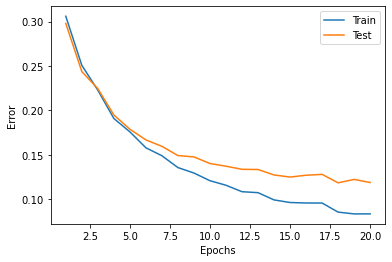

정상샘플로 측정한 성능결과 (정상샘플 학습완료 후): 
Result of Training Data : (total)60000, (hit)58538, (miss)1462, (accuracy)97.56333333333333%
Result of Test Data : (total)10000, (hit)9644, (miss)356, (accuracy)96.44%
[8] (예측값)6 (실제값)5


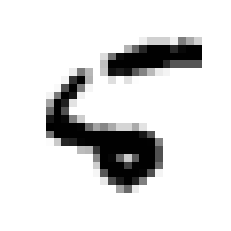

[115] (예측값)9 (실제값)4


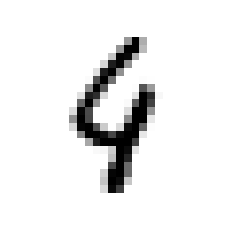

[149] (예측값)8 (실제값)2


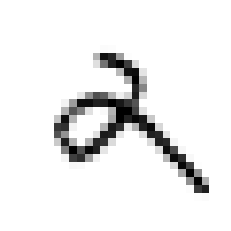

[247] (예측값)2 (실제값)4


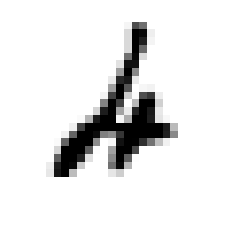

[259] (예측값)0 (실제값)6


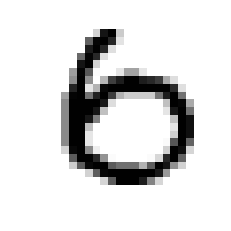

[321] (예측값)7 (실제값)2


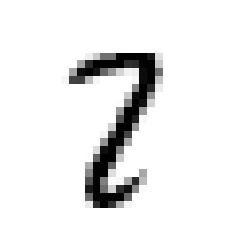

[324] (예측값)7 (실제값)0


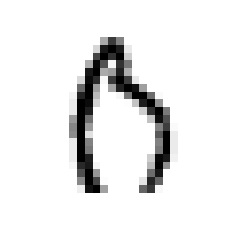

[340] (예측값)3 (실제값)5


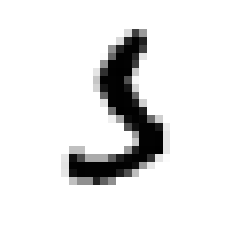

[352] (예측값)3 (실제값)5


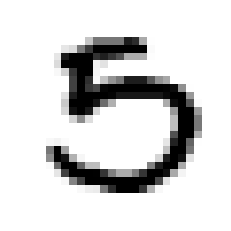

[358] (예측값)9 (실제값)7


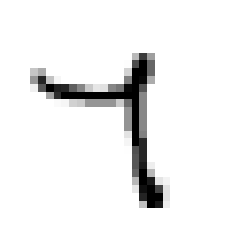

[381] (예측값)7 (실제값)3


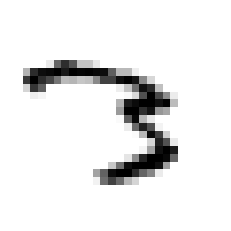

[403] (예측값)5 (실제값)8


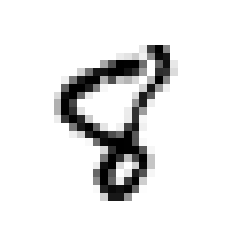

[406] (예측값)9 (실제값)5


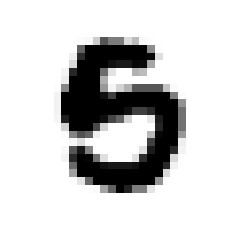

[412] (예측값)3 (실제값)5


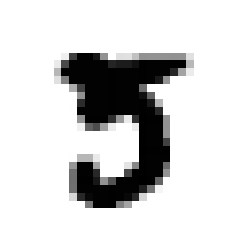

[445] (예측값)0 (실제값)6


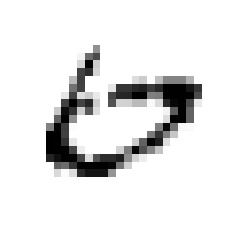

[536] (예측값)1 (실제값)2


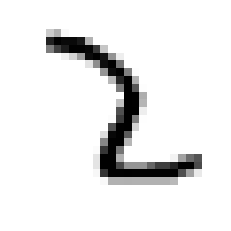

[543] (예측값)4 (실제값)8


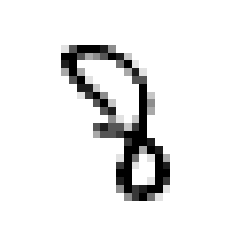

[551] (예측값)1 (실제값)7


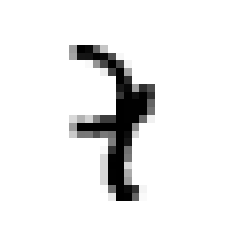

[582] (예측값)1 (실제값)8


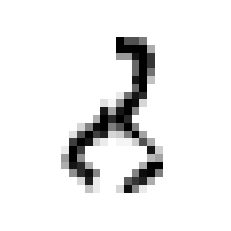

[583] (예측값)8 (실제값)2


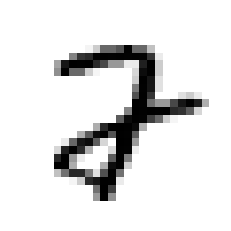

[591] (예측값)3 (실제값)8


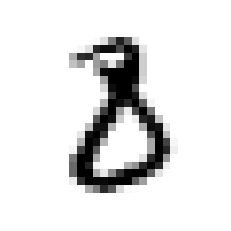

[610] (예측값)2 (실제값)4


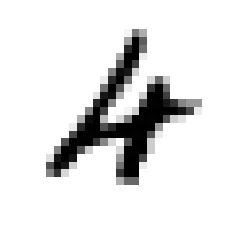

[619] (예측값)8 (실제값)1


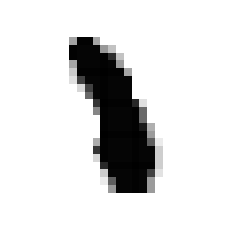

[646] (예측값)6 (실제값)2


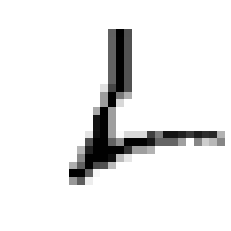

[684] (예측값)3 (실제값)7


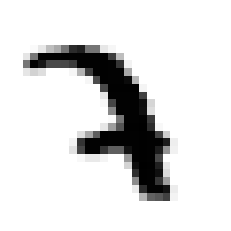

[691] (예측값)4 (실제값)8


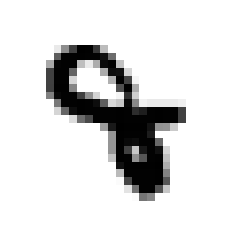

[707] (예측값)9 (실제값)4


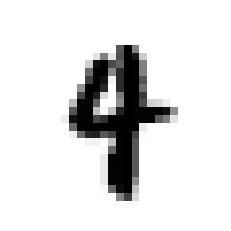

[717] (예측값)7 (실제값)0


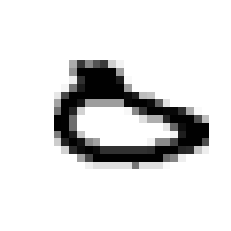

[720] (예측값)8 (실제값)5


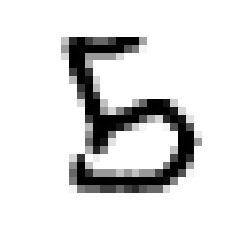

[738] (예측값)8 (실제값)2


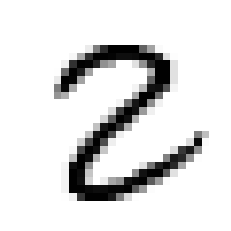

[740] (예측값)9 (실제값)4


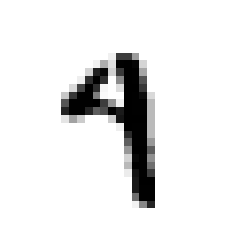

[760] (예측값)9 (실제값)4


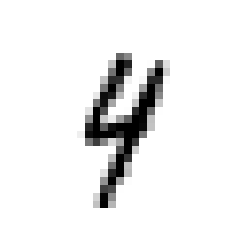

[810] (예측값)2 (실제값)7


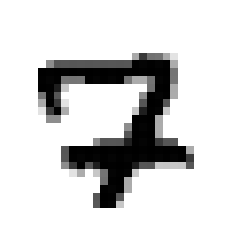

[813] (예측값)8 (실제값)9


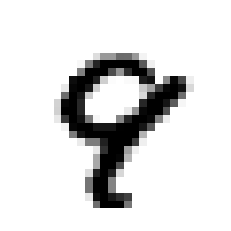

[846] (예측값)9 (실제값)7


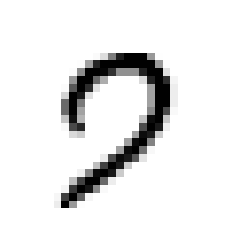

[881] (예측값)9 (실제값)4


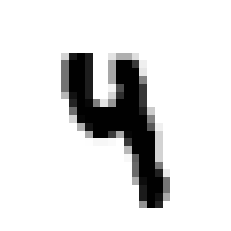

[947] (예측값)9 (실제값)8


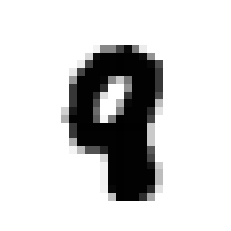

[951] (예측값)4 (실제값)5


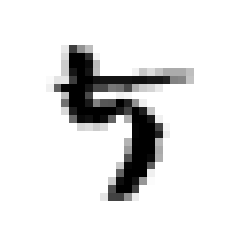

[956] (예측값)3 (실제값)1


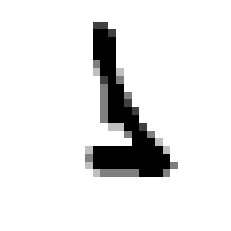

[965] (예측값)0 (실제값)6


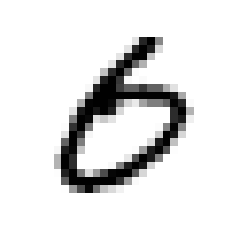

[1003] (예측값)3 (실제값)5


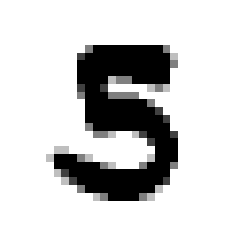

[1014] (예측값)5 (실제값)6


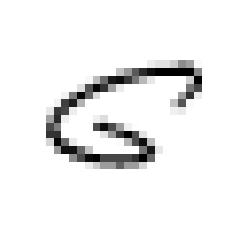

[1032] (예측값)8 (실제값)5


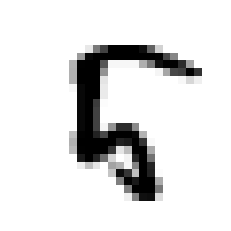

[1039] (예측값)8 (실제값)7


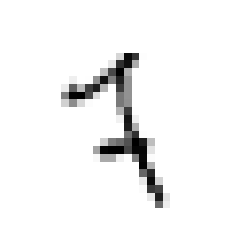

[1044] (예측값)8 (실제값)6


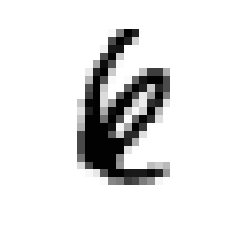

[1082] (예측값)8 (실제값)5


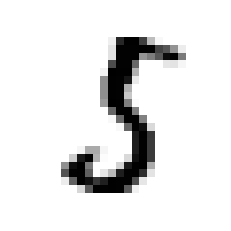

[1107] (예측값)5 (실제값)9


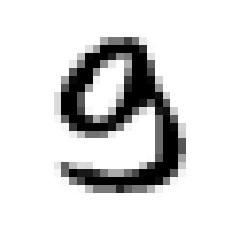

[1112] (예측값)6 (실제값)4


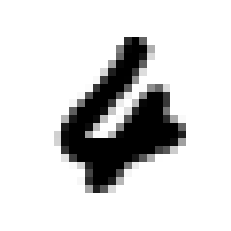

[1128] (예측값)7 (실제값)3


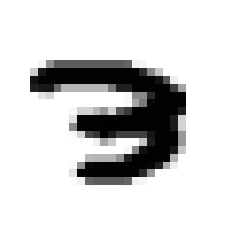

[1156] (예측값)8 (실제값)7


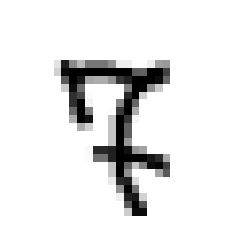

[1173] (예측값)9 (실제값)7


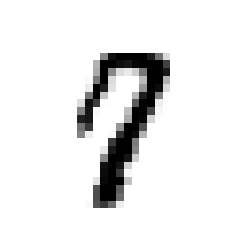

[1178] (예측값)6 (실제값)4


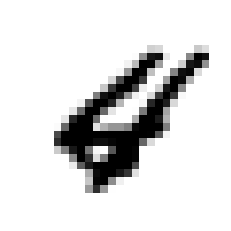

[1181] (예측값)1 (실제값)6


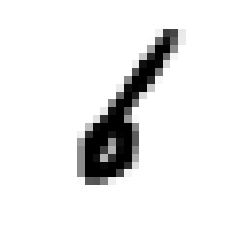

[1182] (예측값)8 (실제값)6


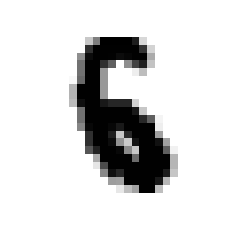

[1191] (예측값)4 (실제값)0


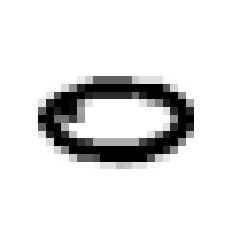

[1192] (예측값)4 (실제값)9


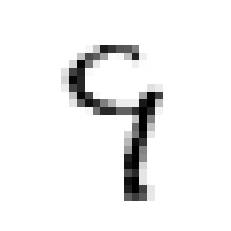

[1226] (예측값)3 (실제값)7


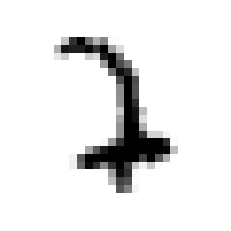

[1232] (예측값)4 (실제값)9


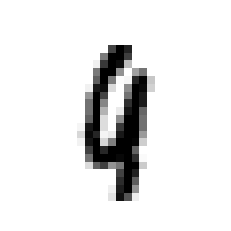

[1242] (예측값)9 (실제값)4


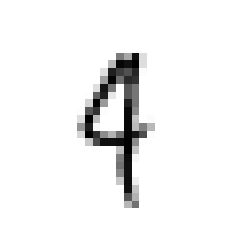

[1247] (예측값)5 (실제값)9


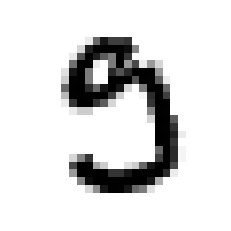

[1251] (예측값)1 (실제값)2


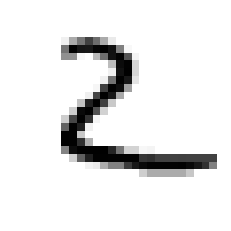

[1260] (예측값)1 (실제값)7


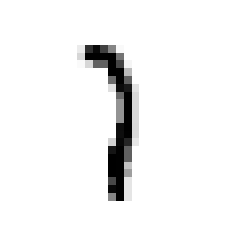

[1283] (예측값)2 (실제값)7


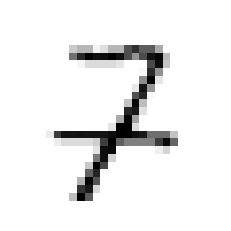

[1289] (예측값)9 (실제값)5


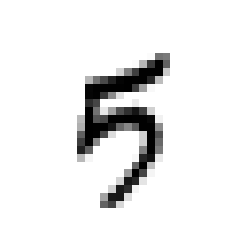

[1319] (예측값)0 (실제값)8


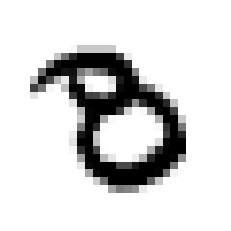

[1325] (예측값)6 (실제값)8


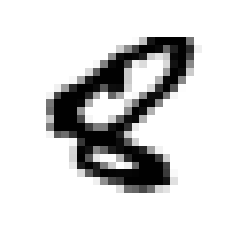

[1326] (예측값)1 (실제값)7


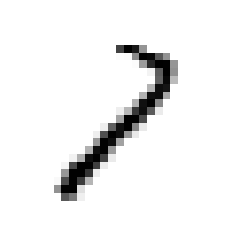

[1328] (예측값)9 (실제값)7


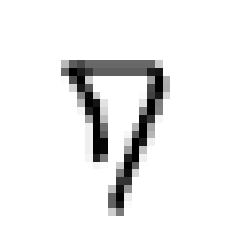

[1337] (예측값)6 (실제값)2


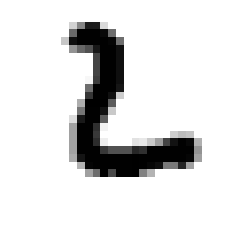

[1364] (예측값)2 (실제값)8


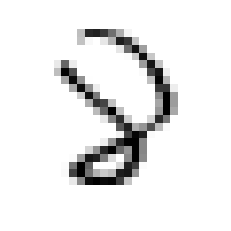

[1414] (예측값)7 (실제값)9


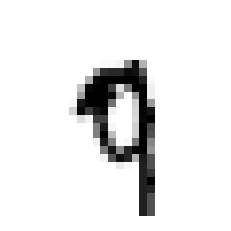

[1444] (예측값)4 (실제값)6


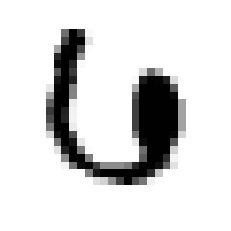

[1494] (예측값)9 (실제값)7


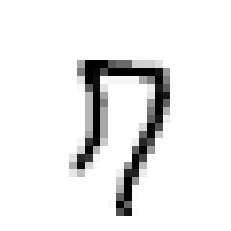

[1500] (예측값)1 (실제값)7


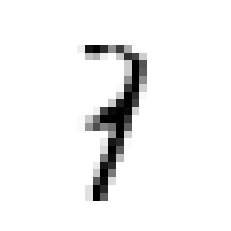

[1522] (예측값)9 (실제값)7


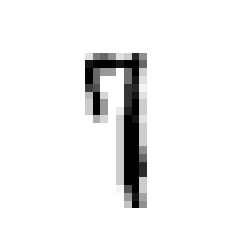

[1527] (예측값)3 (실제값)1


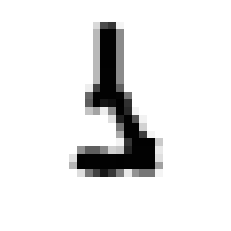

[1530] (예측값)7 (실제값)8


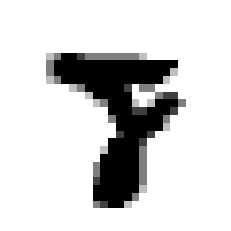

[1549] (예측값)2 (실제값)4


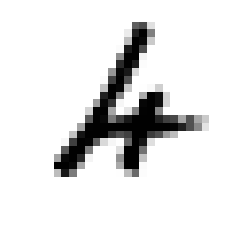

[1553] (예측값)8 (실제값)9


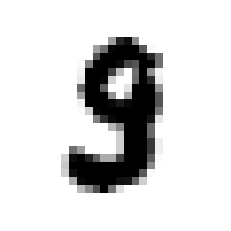

[1569] (예측값)4 (실제값)6


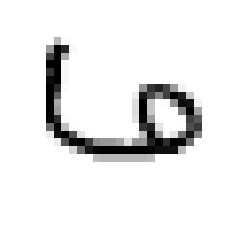

[1581] (예측값)9 (실제값)7


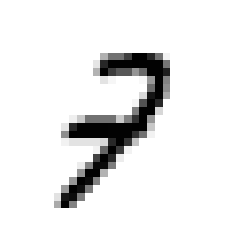

[1609] (예측값)4 (실제값)2


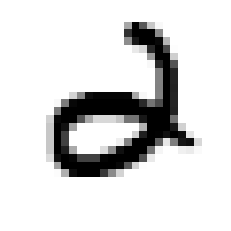

[1621] (예측값)6 (실제값)0


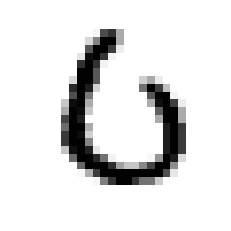

[1681] (예측값)7 (실제값)3


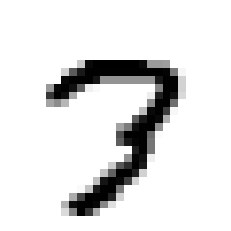

[1709] (예측값)3 (실제값)9


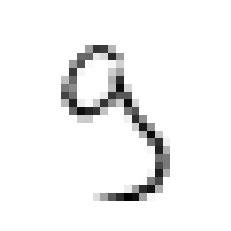

[1717] (예측값)0 (실제값)8


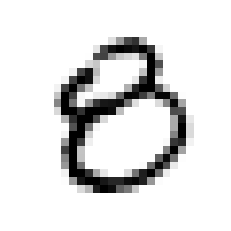

[1721] (예측값)9 (실제값)7


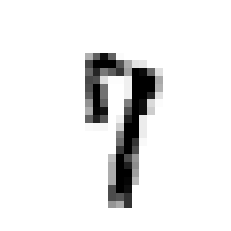

[1751] (예측값)2 (실제값)4


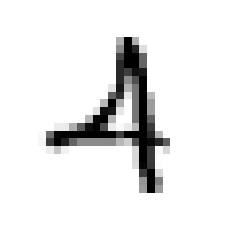

[1754] (예측값)2 (실제값)7


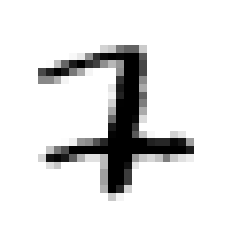

[1790] (예측값)9 (실제값)2


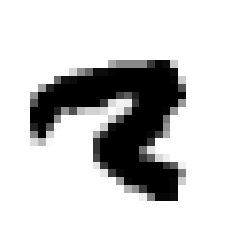

[1800] (예측값)4 (실제값)6


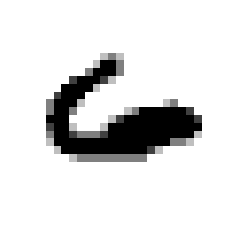

[1828] (예측값)7 (실제값)3


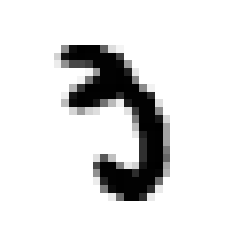

[1878] (예측값)3 (실제값)8


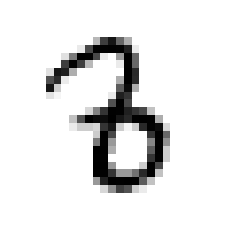

[1901] (예측값)4 (실제값)9


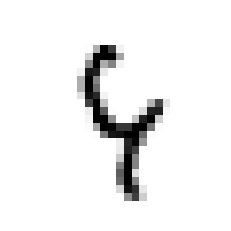

[1903] (예측값)2 (실제값)7


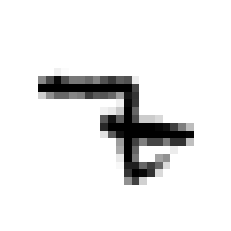

[1911] (예측값)6 (실제값)5


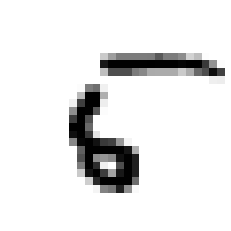

[1940] (예측값)0 (실제값)5


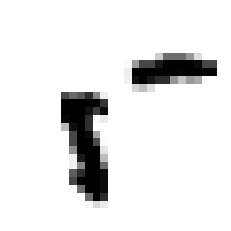

[1941] (예측값)2 (실제값)7


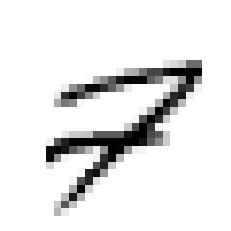

[1970] (예측값)3 (실제값)5


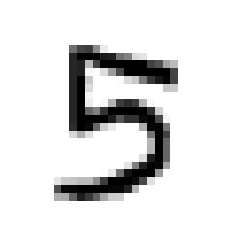

[1982] (예측값)5 (실제값)6


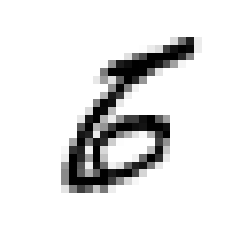

[1984] (예측값)0 (실제값)2


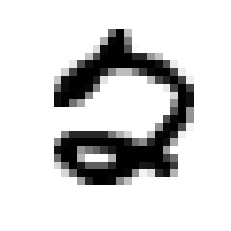

[1987] (예측값)9 (실제값)0


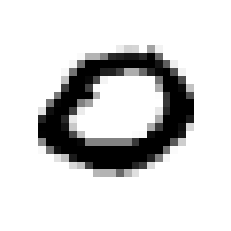

[2001] (예측값)9 (실제값)5


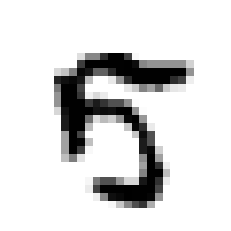

[2016] (예측값)2 (실제값)7


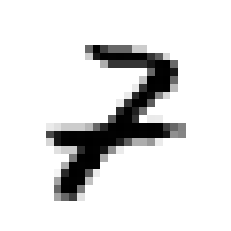

[2024] (예측값)9 (실제값)7


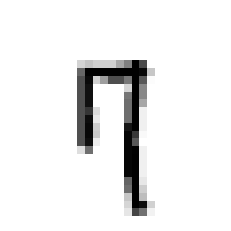

[2033] (예측값)4 (실제값)0


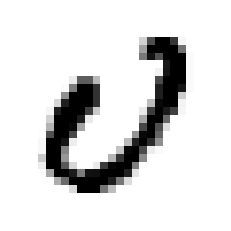

[2035] (예측값)3 (실제값)5


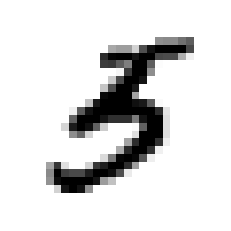

[2040] (예측값)4 (실제값)5


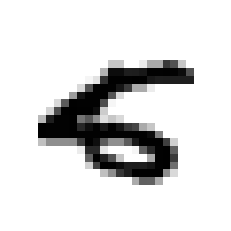

[2043] (예측값)8 (실제값)4


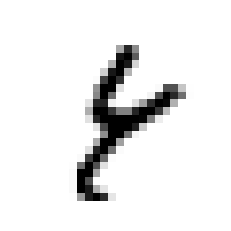

[2053] (예측값)9 (실제값)4


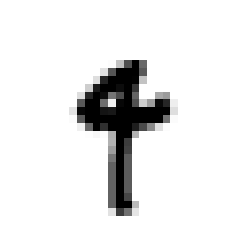

[2070] (예측값)9 (실제값)7


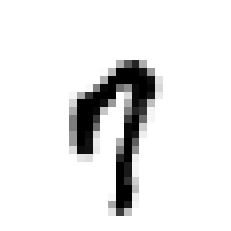

[2098] (예측값)0 (실제값)2


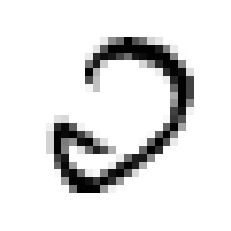

[2105] (예측값)8 (실제값)3


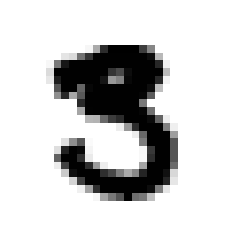

[2118] (예측값)0 (실제값)6


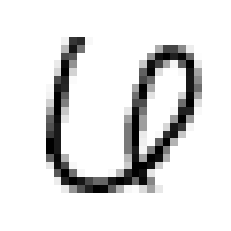

[2130] (예측값)9 (실제값)4


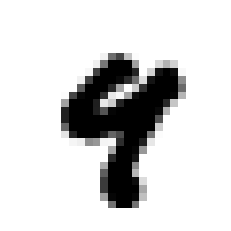

[2135] (예측값)1 (실제값)6


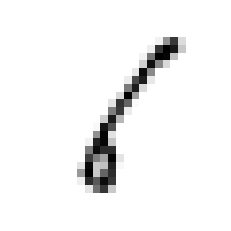

[2162] (예측값)8 (실제값)5


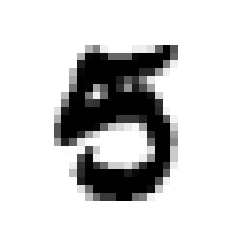

[2182] (예측값)2 (실제값)1


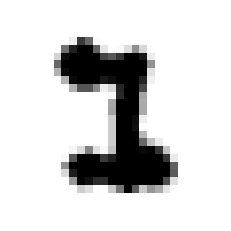

[2224] (예측값)8 (실제값)5


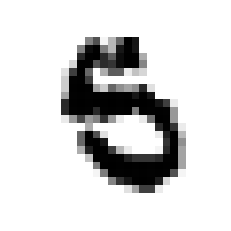

[2266] (예측값)3 (실제값)1


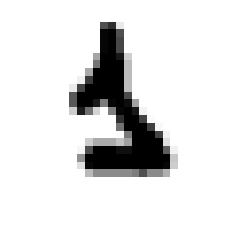

[2272] (예측값)0 (실제값)8


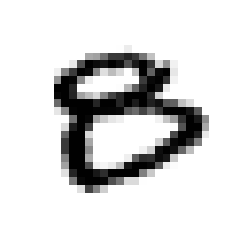

[2293] (예측값)6 (실제값)9


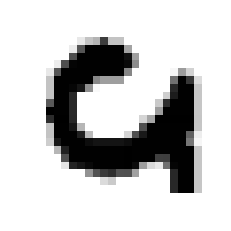

[2298] (예측값)0 (실제값)8


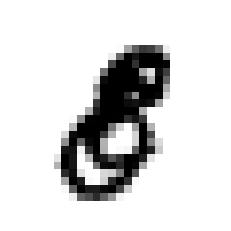

[2299] (예측값)8 (실제값)2


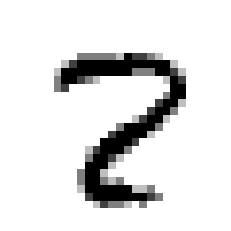

[2369] (예측값)9 (실제값)5


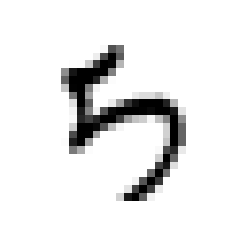

[2387] (예측값)1 (실제값)9


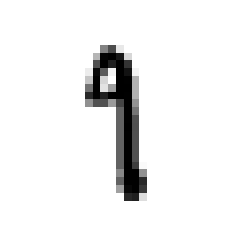

[2393] (예측값)3 (실제값)8


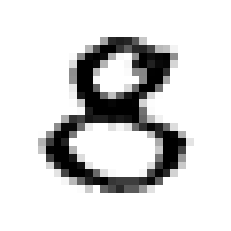

[2406] (예측값)1 (실제값)9


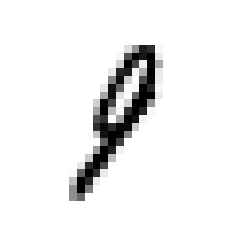

[2408] (예측값)9 (실제값)3


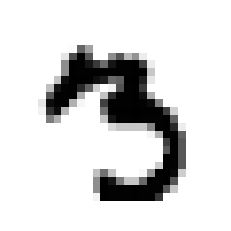

[2414] (예측값)4 (실제값)9


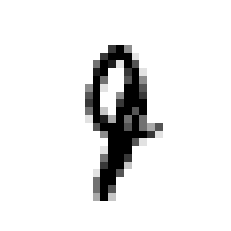

[2422] (예측값)4 (실제값)6


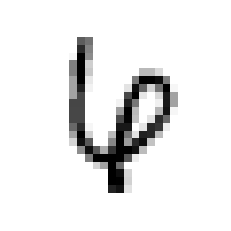

[2433] (예측값)1 (실제값)2


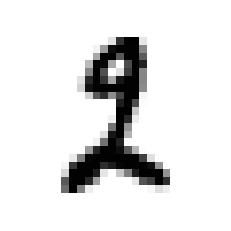

[2447] (예측값)9 (실제값)4


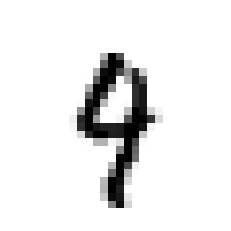

[2488] (예측값)4 (실제값)2


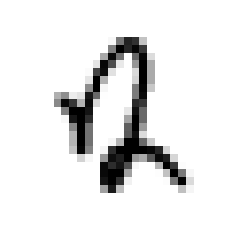

[2514] (예측값)9 (실제값)4


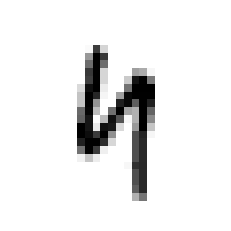

[2573] (예측값)8 (실제값)5


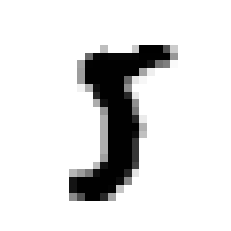

[2610] (예측값)8 (실제값)2


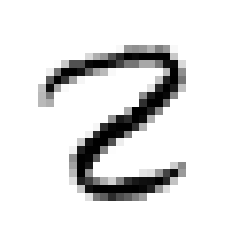

[2648] (예측값)0 (실제값)9


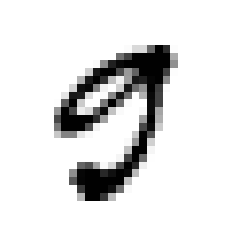

[2654] (예측값)1 (실제값)6


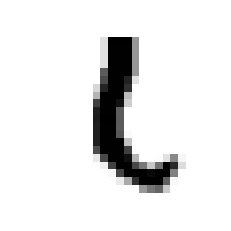

[2713] (예측값)8 (실제값)0


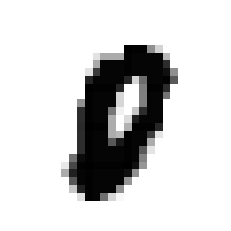

[2810] (예측값)2 (실제값)5


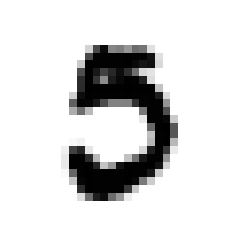

[2863] (예측값)4 (실제값)9


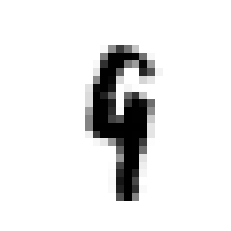

[2877] (예측값)7 (실제값)4


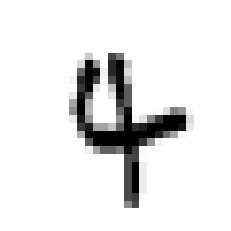

[2896] (예측값)0 (실제값)8


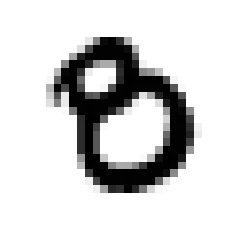

[2921] (예측값)2 (실제값)3


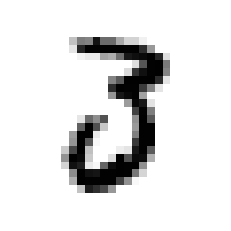

[2939] (예측값)7 (실제값)9


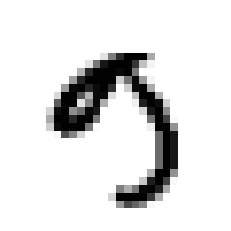

[2945] (예측값)7 (실제값)3


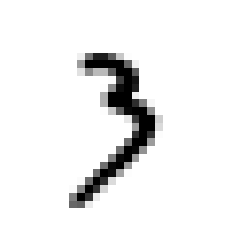

[2953] (예측값)5 (실제값)3


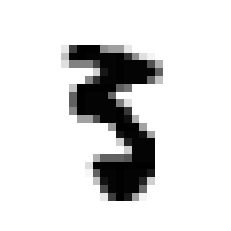

[2970] (예측값)7 (실제값)5


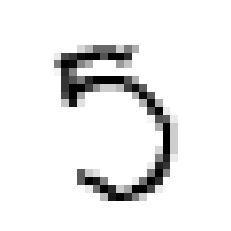

[2995] (예측값)8 (실제값)6


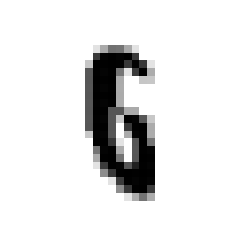

[3005] (예측값)1 (실제값)9


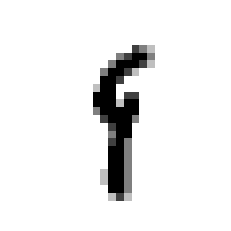

[3073] (예측값)2 (실제값)1


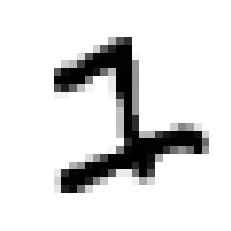

[3117] (예측값)9 (실제값)5


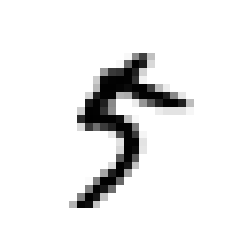

[3122] (예측값)2 (실제값)7


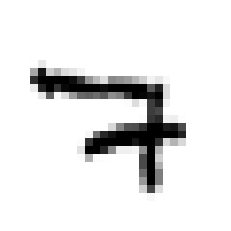

[3157] (예측값)7 (실제값)5


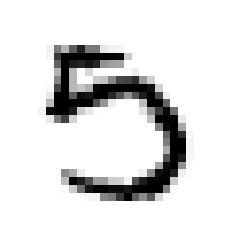

[3173] (예측값)2 (실제값)6


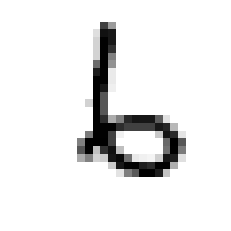

[3189] (예측값)4 (실제값)7


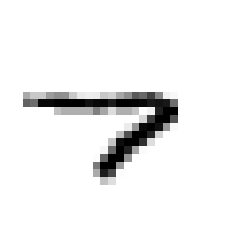

[3206] (예측값)3 (실제값)8


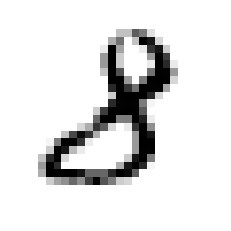

[3284] (예측값)7 (실제값)8


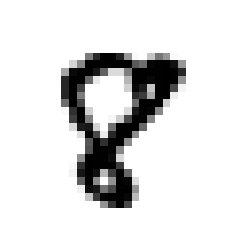

[3330] (예측값)3 (실제값)2


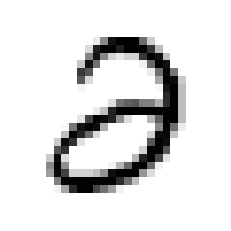

[3333] (예측값)9 (실제값)7


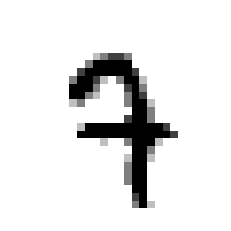

[3405] (예측값)9 (실제값)4


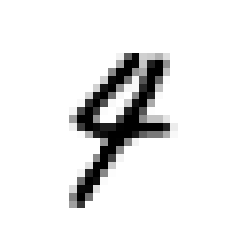

[3412] (예측값)9 (실제값)0


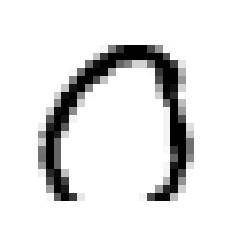

[3422] (예측값)0 (실제값)6


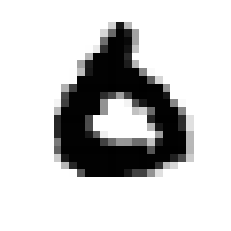

[3474] (예측값)1 (실제값)2


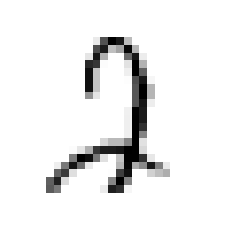

[3490] (예측값)9 (실제값)4


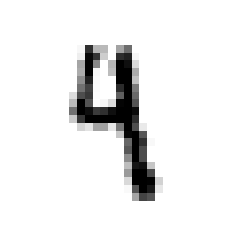

[3503] (예측값)1 (실제값)9


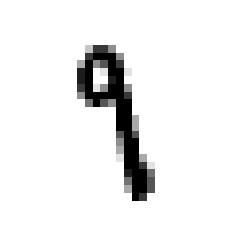

[3520] (예측값)4 (실제값)6


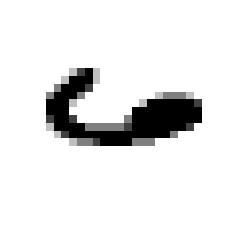

[3533] (예측값)9 (실제값)4


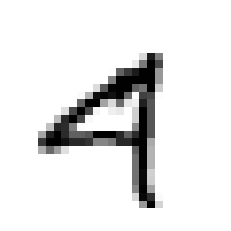

[3549] (예측값)8 (실제값)3


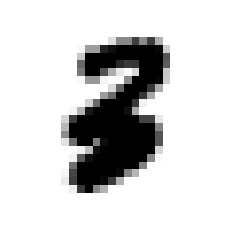

[3558] (예측값)0 (실제값)5


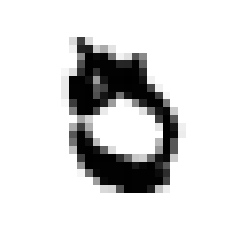

[3559] (예측값)5 (실제값)8


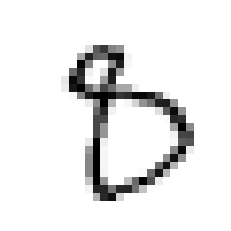

[3567] (예측값)5 (실제값)8


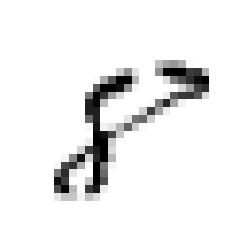

[3575] (예측값)8 (실제값)7


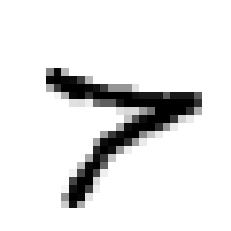

[3597] (예측값)3 (실제값)9


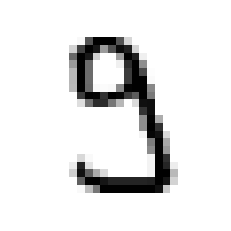

[3599] (예측값)3 (실제값)2


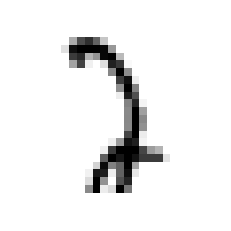

[3674] (예측값)3 (실제값)8


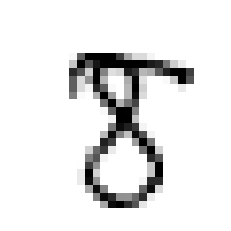

[3681] (예측값)8 (실제값)2


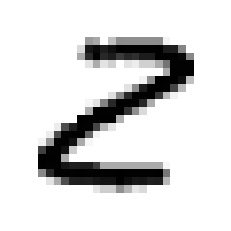

[3718] (예측값)9 (실제값)4


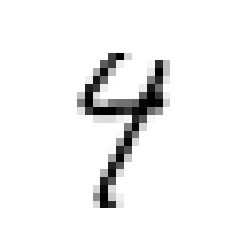

[3727] (예측값)4 (실제값)8


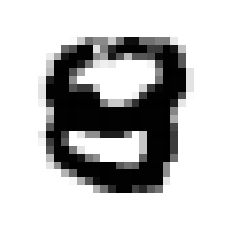

[3749] (예측값)4 (실제값)6


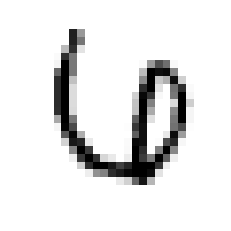

[3751] (예측값)2 (실제값)7


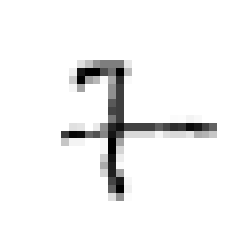

[3757] (예측값)3 (실제값)8


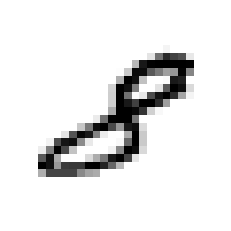

[3767] (예측값)2 (실제값)7


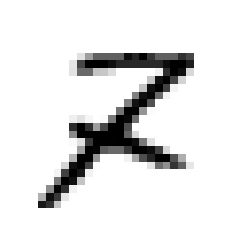

[3776] (예측값)8 (실제값)5


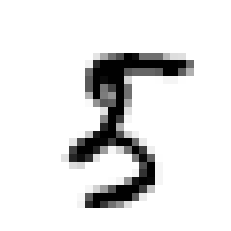

[3778] (예측값)2 (실제값)5


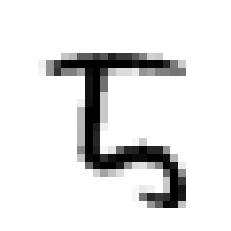

[3780] (예측값)2 (실제값)4


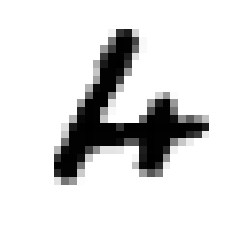

[3796] (예측값)3 (실제값)2


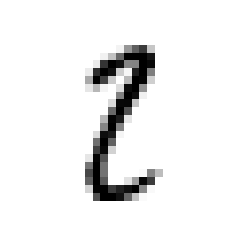

[3808] (예측값)3 (실제값)7


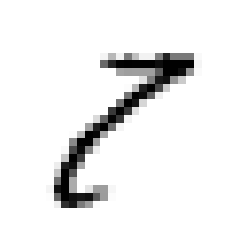

[3811] (예측값)9 (실제값)2


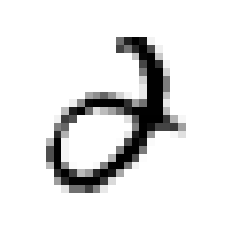

[3818] (예측값)6 (실제값)0


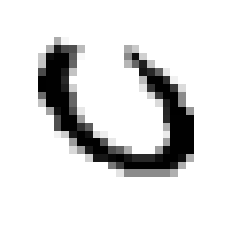

[3853] (예측값)5 (실제값)6


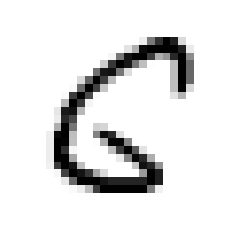

[3893] (예측값)6 (실제값)5


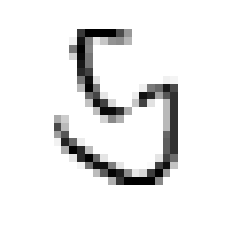

[3902] (예측값)3 (실제값)5


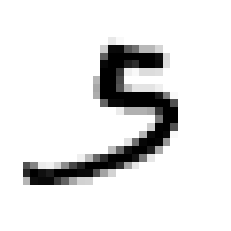

[3906] (예측값)3 (실제값)1


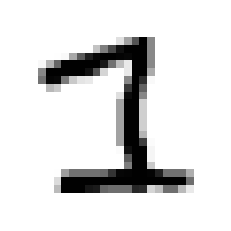

[3926] (예측값)3 (실제값)9


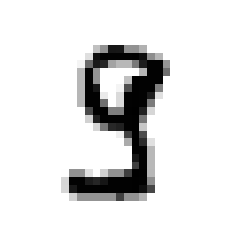

[3941] (예측값)2 (실제값)4


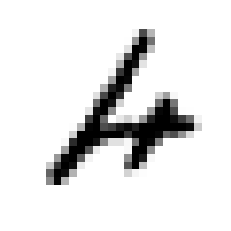

[3976] (예측값)1 (실제값)7


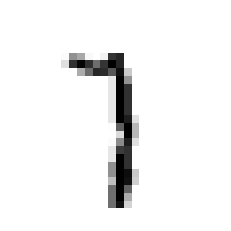

[4000] (예측값)8 (실제값)9


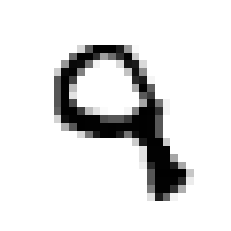

[4063] (예측값)5 (실제값)6


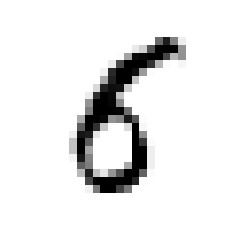

[4065] (예측값)2 (실제값)0


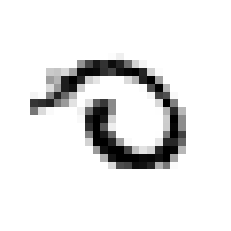

[4075] (예측값)0 (실제값)8


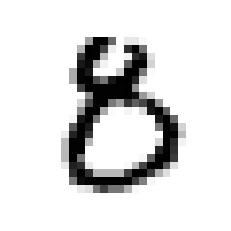

[4078] (예측값)3 (실제값)9


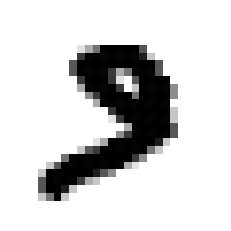

[4093] (예측값)4 (실제값)9


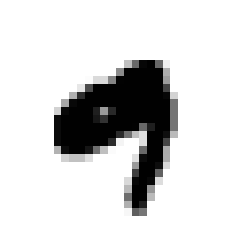

[4152] (예측값)1 (실제값)5


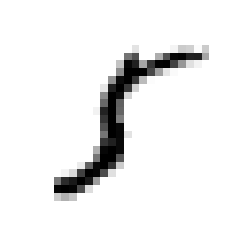

[4154] (예측값)4 (실제값)9


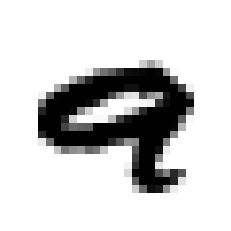

[4163] (예측값)0 (실제값)9


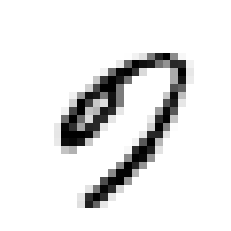

[4176] (예측값)7 (실제값)2


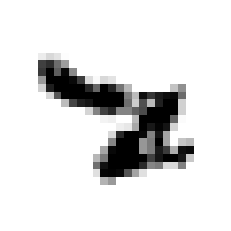

[4177] (예측값)4 (실제값)5


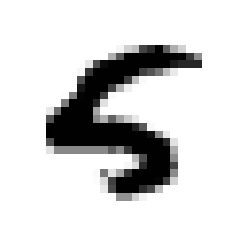

[4199] (예측값)9 (실제값)7


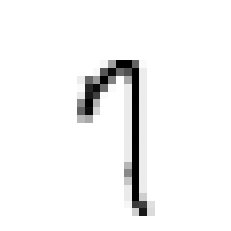

[4201] (예측값)7 (실제값)1


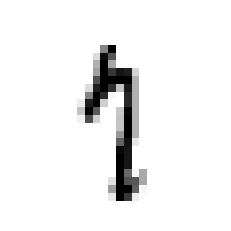

[4224] (예측값)7 (실제값)9


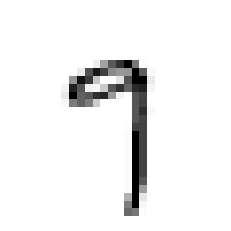

[4248] (예측값)8 (실제값)2


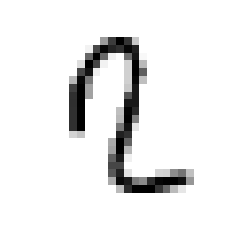

[4255] (예측값)3 (실제값)5


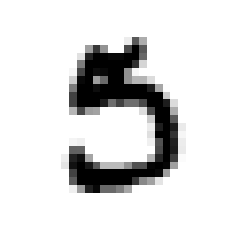

[4289] (예측값)7 (실제값)2


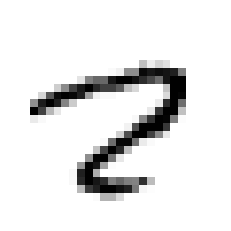

[4300] (예측값)3 (실제값)5


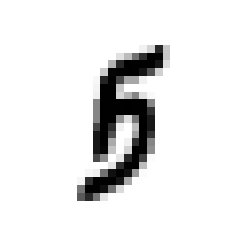

[4306] (예측값)7 (실제값)3


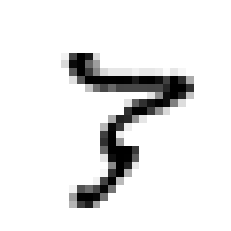

[4313] (예측값)9 (실제값)4


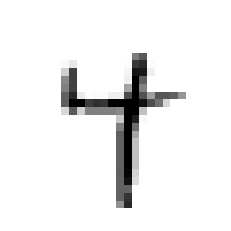

[4344] (예측값)7 (실제값)9


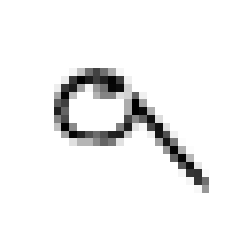

[4355] (예측값)9 (실제값)5


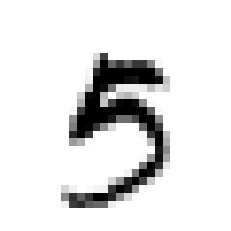

[4356] (예측값)9 (실제값)5


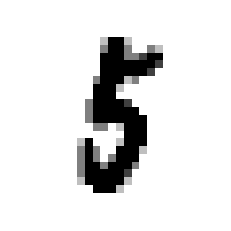

[4360] (예측값)3 (실제값)5


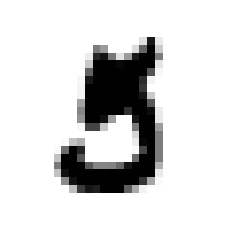

[4425] (예측값)4 (실제값)9


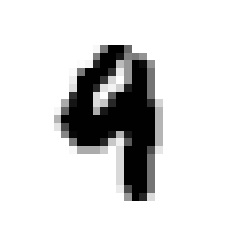

[4437] (예측값)2 (실제값)3


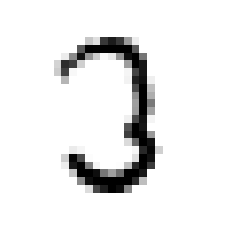

[4497] (예측값)7 (실제값)8


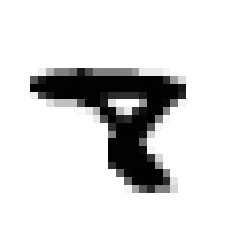

[4500] (예측값)1 (실제값)9


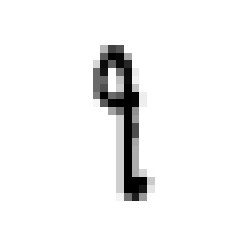

[4567] (예측값)9 (실제값)4


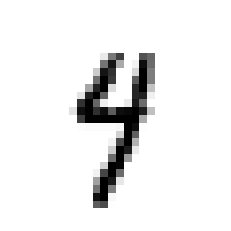

[4601] (예측값)4 (실제값)8


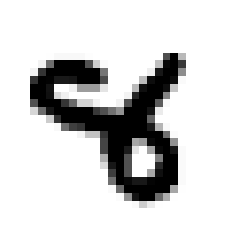

[4615] (예측값)4 (실제값)2


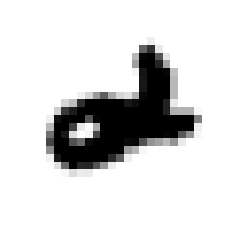

[4619] (예측값)8 (실제값)6


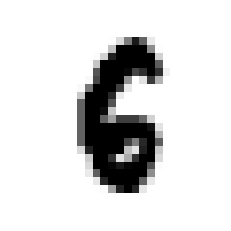

[4740] (예측값)7 (실제값)3


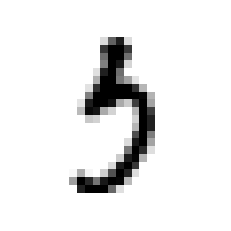

[4761] (예측값)8 (실제값)9


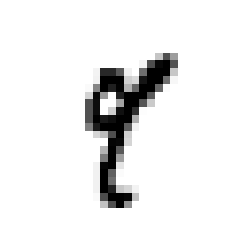

[4763] (예측값)6 (실제값)5


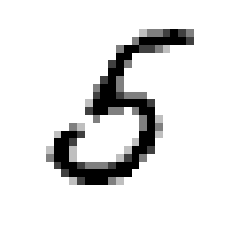

[4807] (예측값)3 (실제값)8


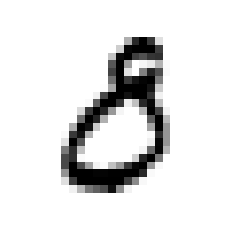

[4823] (예측값)4 (실제값)9


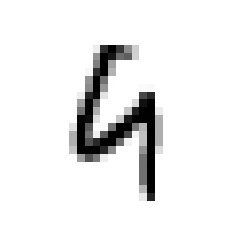

[4827] (예측값)9 (실제값)4


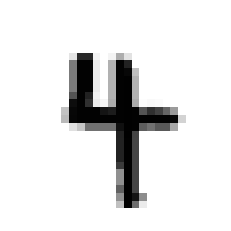

[4860] (예측값)9 (실제값)4


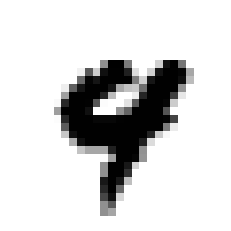

[4880] (예측값)8 (실제값)0


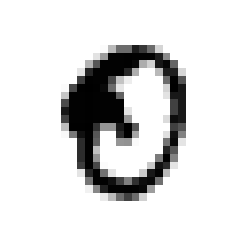

[4886] (예측값)1 (실제값)7


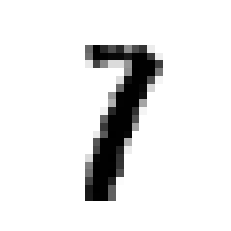

[4956] (예측값)4 (실제값)8


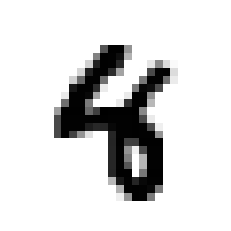

[4966] (예측값)1 (실제값)7


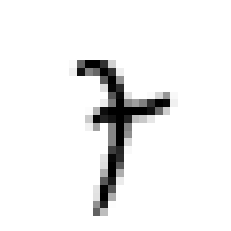

[4990] (예측값)8 (실제값)3


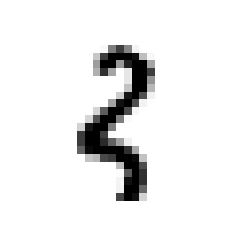

[5140] (예측값)6 (실제값)3


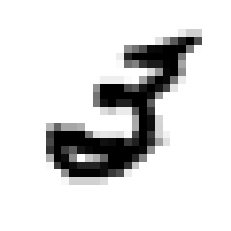

[5165] (예측값)3 (실제값)0


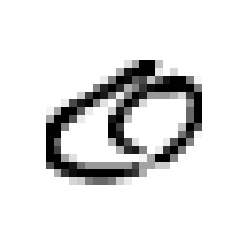

[5331] (예측값)6 (실제값)1


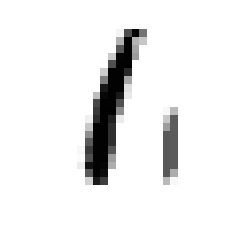

[5457] (예측값)8 (실제값)1


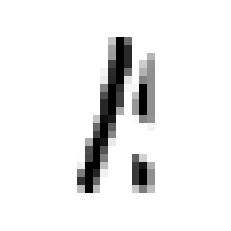

[5495] (예측값)3 (실제값)8


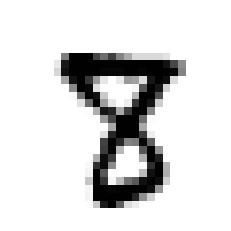

[5600] (예측값)9 (실제값)7


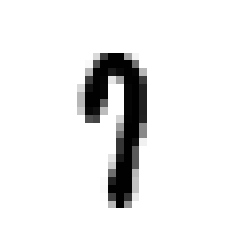

[5623] (예측값)2 (실제값)3


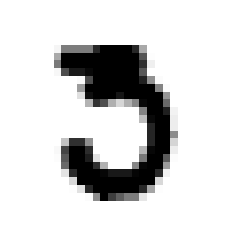

[5634] (예측값)3 (실제값)2


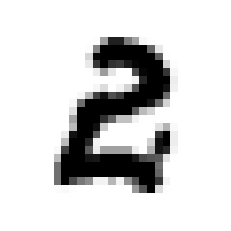

[5642] (예측값)5 (실제값)1


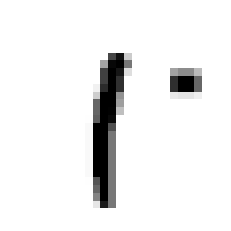

[5734] (예측값)7 (실제값)3


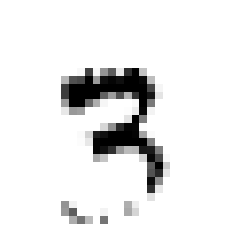

[5749] (예측값)6 (실제값)8


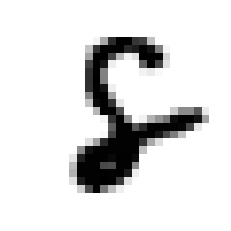

[5802] (예측값)3 (실제값)5


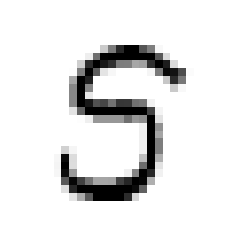

[5835] (예측값)9 (실제값)7


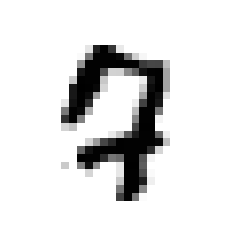

[5842] (예측값)7 (실제값)4


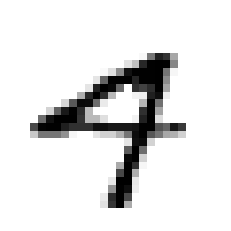

[5874] (예측값)3 (실제값)5


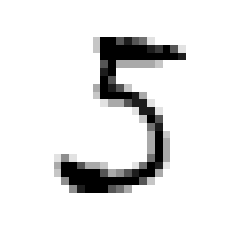

[5887] (예측값)4 (실제값)7


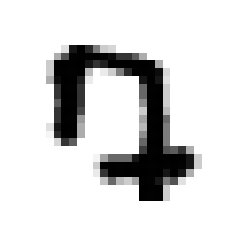

[5913] (예측값)3 (실제값)5


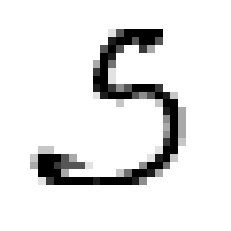

[5926] (예측값)9 (실제값)4


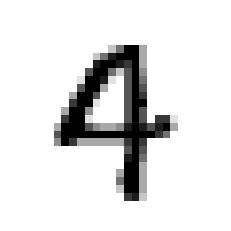

[5936] (예측값)9 (실제값)4


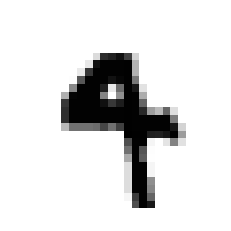

[5937] (예측값)3 (실제값)5


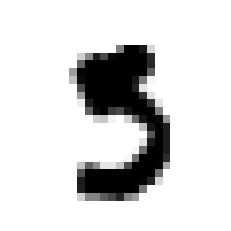

[5955] (예측값)8 (실제값)3


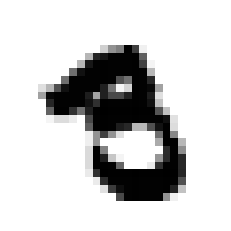

[5972] (예측값)3 (실제값)5


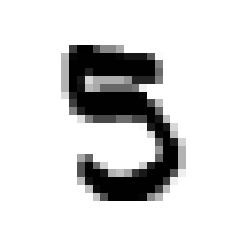

[5973] (예측값)8 (실제값)3


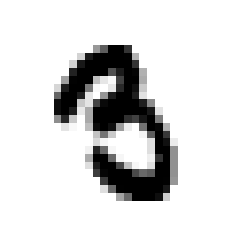

[5975] (예측값)9 (실제값)4


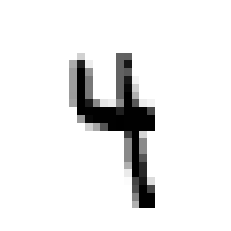

[5982] (예측값)3 (실제값)5


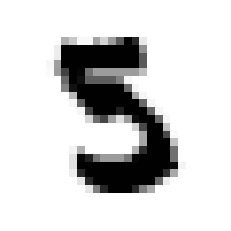

[5997] (예측값)9 (실제값)5


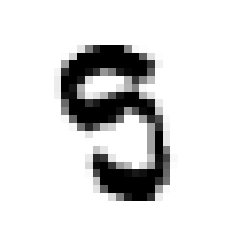

[6015] (예측값)5 (실제값)0


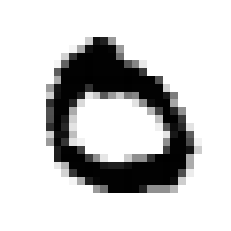

[6023] (예측값)8 (실제값)3


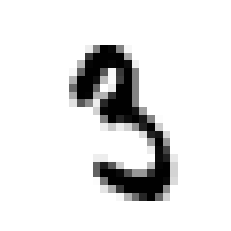

[6045] (예측값)9 (실제값)3


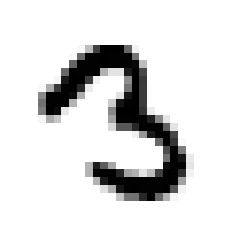

[6059] (예측값)9 (실제값)3


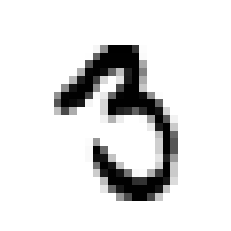

[6065] (예측값)8 (실제값)3


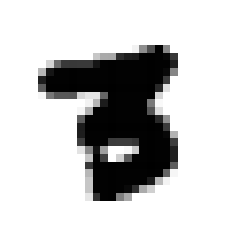

[6166] (예측값)3 (실제값)9


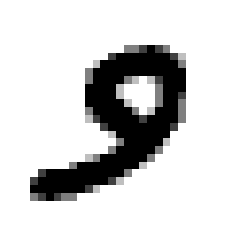

[6174] (예측값)5 (실제값)3


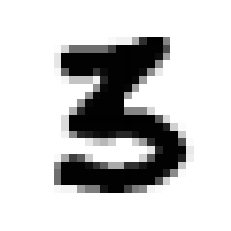

[6392] (예측값)2 (실제값)5


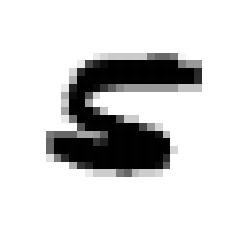

[6400] (예측값)6 (실제값)0


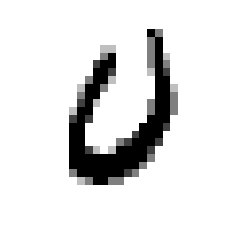

[6426] (예측값)6 (실제값)0


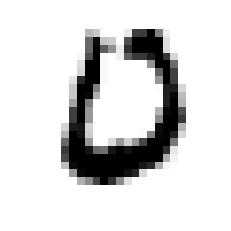

[6505] (예측값)0 (실제값)9


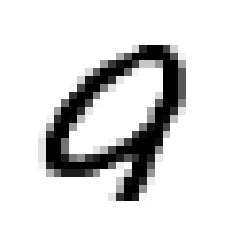

[6555] (예측값)9 (실제값)8


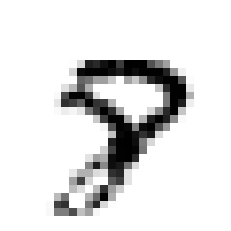

[6558] (예측값)2 (실제값)6


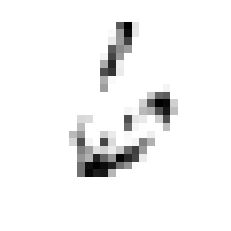

[6559] (예측값)2 (실제값)4


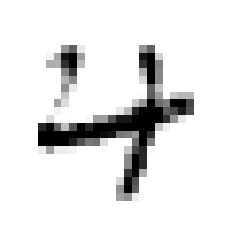

[6564] (예측값)9 (실제값)3


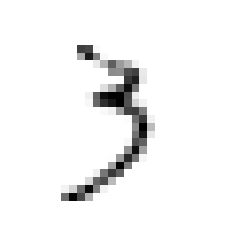

[6574] (예측값)6 (실제값)2


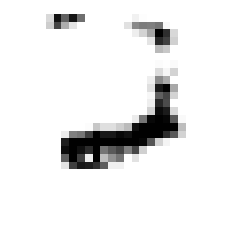

[6576] (예측값)1 (실제값)7


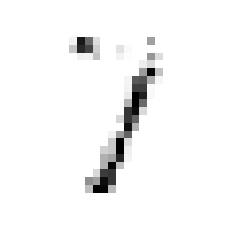

[6597] (예측값)7 (실제값)0


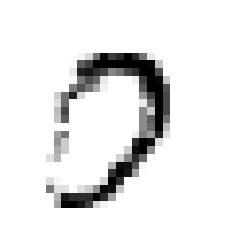

[6651] (예측값)5 (실제값)0


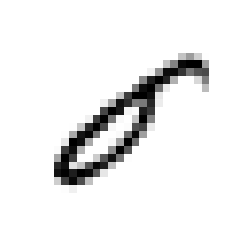

[6744] (예측값)8 (실제값)2


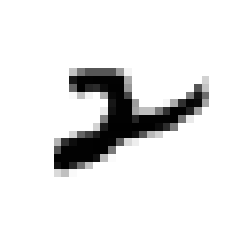

[6769] (예측값)8 (실제값)4


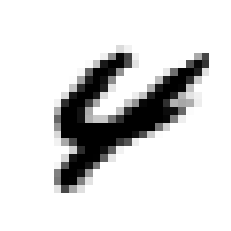

[6783] (예측값)6 (실제값)1


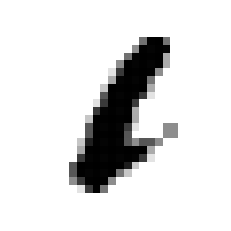

[6847] (예측값)4 (실제값)6


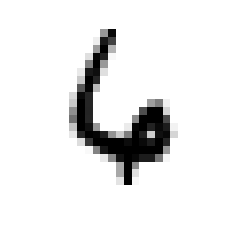

[6926] (예측값)4 (실제값)6


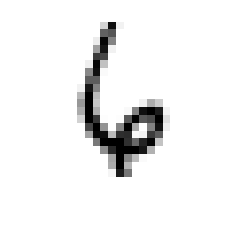

[7216] (예측값)6 (실제값)0


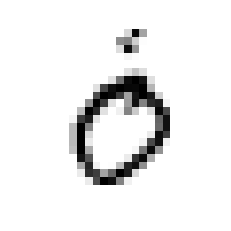

[7432] (예측값)1 (실제값)7


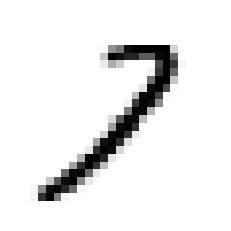

[7434] (예측값)8 (실제값)4


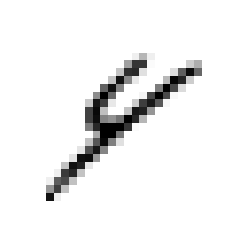

[7545] (예측값)9 (실제값)8


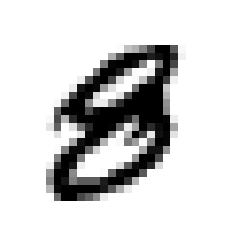

[7732] (예측값)8 (실제값)5


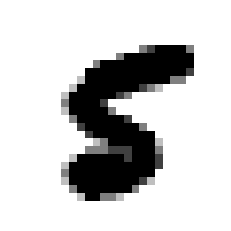

[7793] (예측값)8 (실제값)5


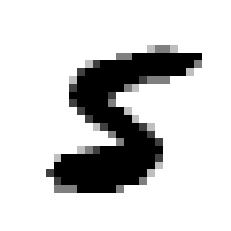

[7797] (예측값)6 (실제값)5


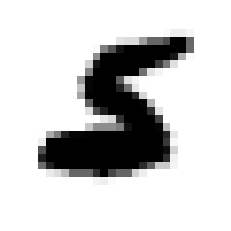

[7821] (예측값)2 (실제값)3


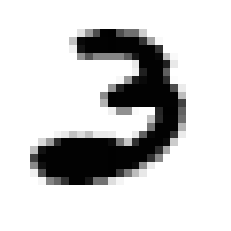

[7856] (예측값)8 (실제값)1


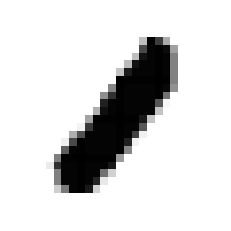

[7899] (예측값)8 (실제값)1


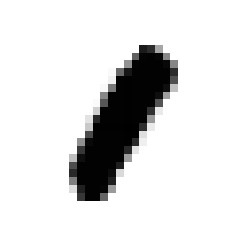

[7902] (예측값)9 (실제값)7


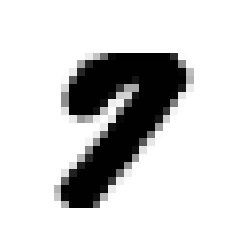

[7915] (예측값)9 (실제값)7


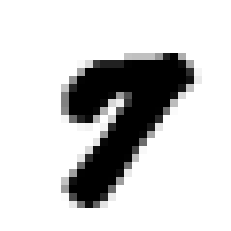

[7921] (예측값)1 (실제값)8


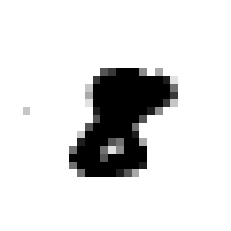

[7927] (예측값)9 (실제값)7


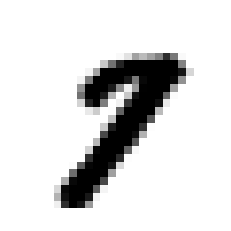

[7928] (예측값)8 (실제값)1


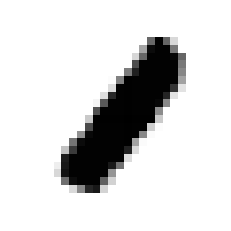

[7990] (예측값)8 (실제값)1


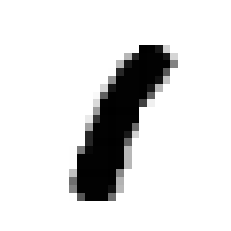

[8020] (예측값)8 (실제값)1


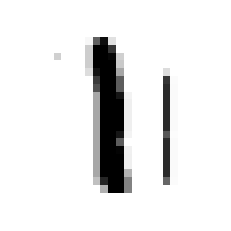

[8061] (예측값)9 (실제값)4


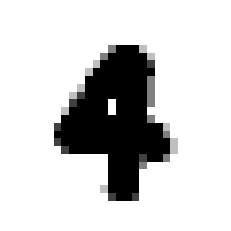

[8062] (예측값)8 (실제값)5


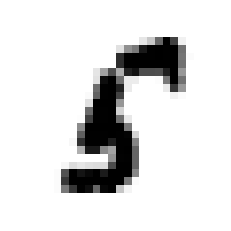

[8091] (예측값)8 (실제값)2


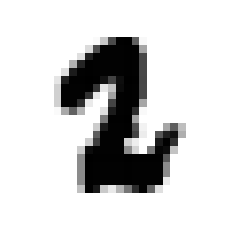

[8094] (예측값)8 (실제값)2


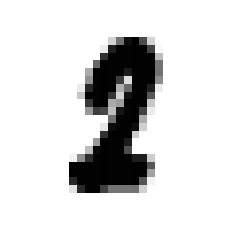

[8183] (예측값)5 (실제값)8


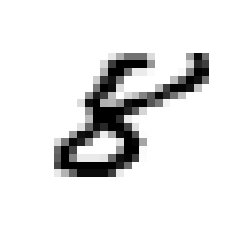

[8246] (예측값)8 (실제값)3


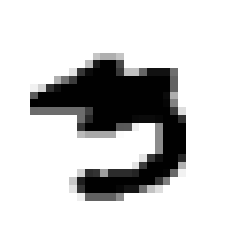

[8277] (예측값)8 (실제값)3


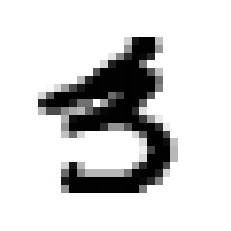

[8296] (예측값)8 (실제값)3


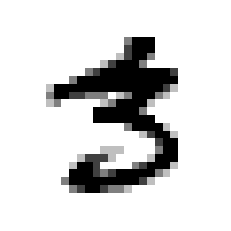

[8311] (예측값)4 (실제값)6


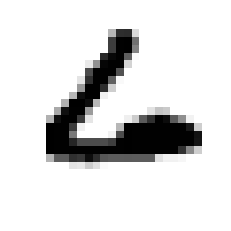

[8325] (예측값)6 (실제값)0


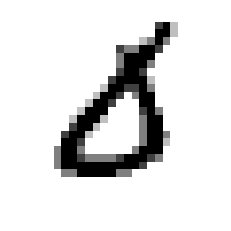

[8339] (예측값)4 (실제값)8


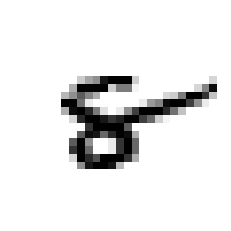

[8375] (예측값)9 (실제값)7


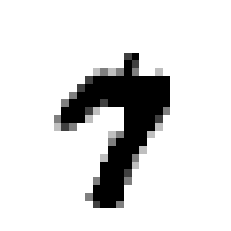

[8408] (예측값)6 (실제값)8


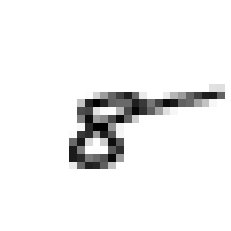

[8502] (예측값)8 (실제값)5


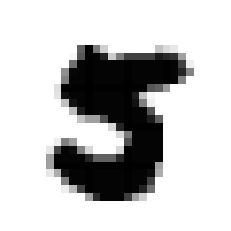

[8520] (예측값)9 (실제값)4


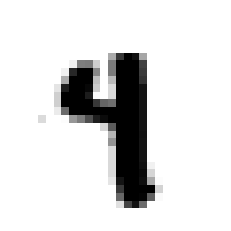

[8522] (예측값)6 (실제값)8


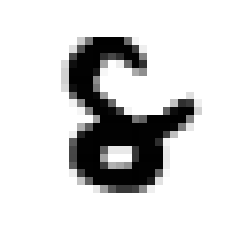

[8523] (예측값)5 (실제값)9


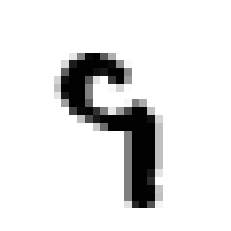

[8584] (예측값)3 (실제값)2


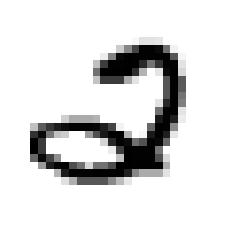

[8863] (예측값)6 (실제값)5


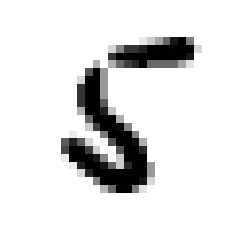

[9009] (예측값)2 (실제값)7


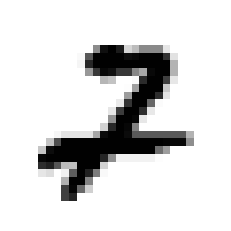

[9015] (예측값)2 (실제값)7


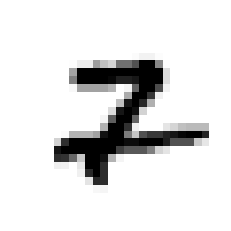

[9019] (예측값)2 (실제값)7


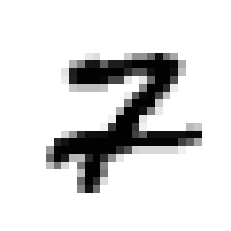

[9024] (예측값)2 (실제값)7


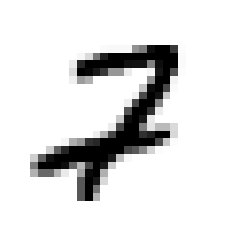

[9071] (예측값)8 (실제값)1


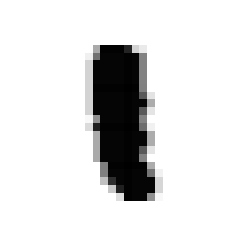

[9202] (예측값)9 (실제값)3


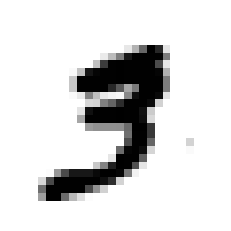

[9427] (예측값)3 (실제값)5


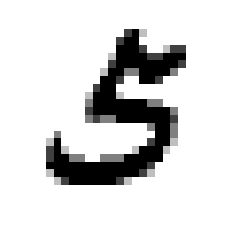

[9482] (예측값)3 (실제값)5


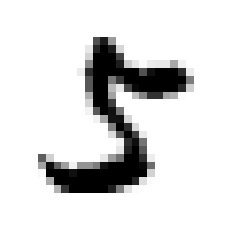

[9534] (예측값)9 (실제값)7


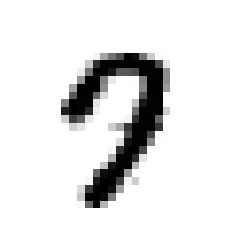

[9587] (예측값)4 (실제값)9


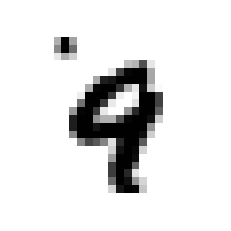

[9624] (예측값)8 (실제값)3


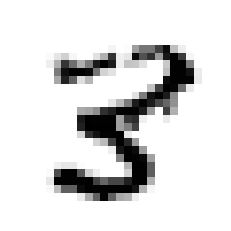

[9634] (예측값)3 (실제값)0


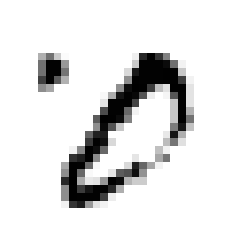

[9669] (예측값)5 (실제값)4


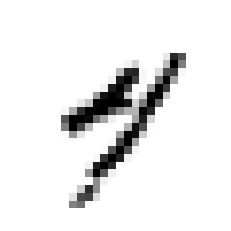

[9679] (예측값)5 (실제값)6


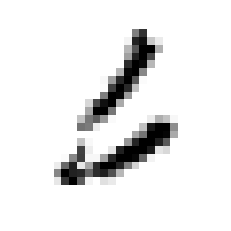

[9729] (예측값)6 (실제값)5


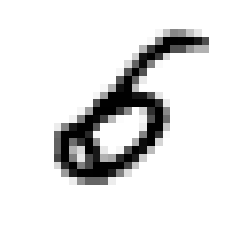

[9745] (예측값)2 (실제값)4


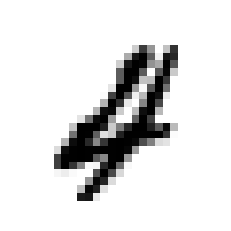

[9749] (예측값)6 (실제값)5


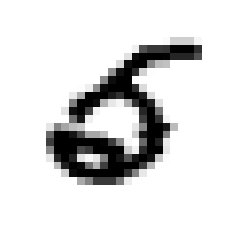

[9768] (예측값)0 (실제값)2


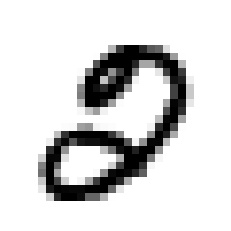

[9770] (예측값)0 (실제값)5


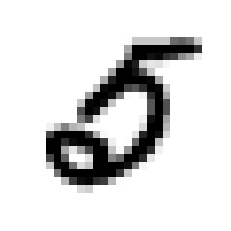

[9777] (예측값)0 (실제값)5


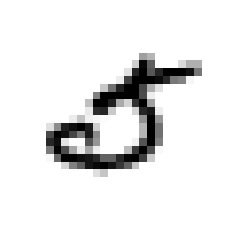

[9808] (예측값)4 (실제값)9


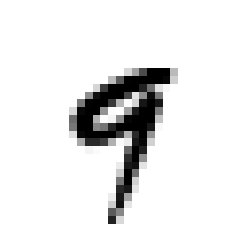

[9839] (예측값)3 (실제값)2


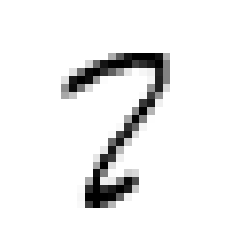

[9888] (예측값)0 (실제값)6


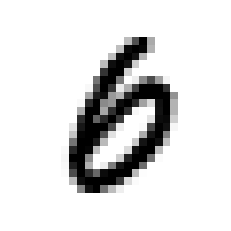

[9890] (예측값)4 (실제값)9


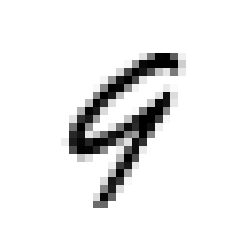

[9940] (예측값)4 (실제값)6


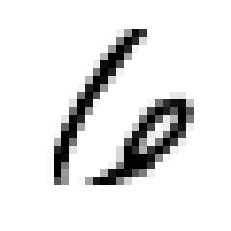

[9944] (예측값)8 (실제값)3


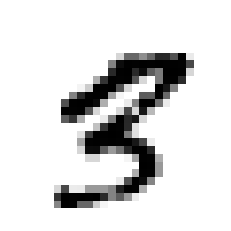

[9975] (예측값)8 (실제값)3


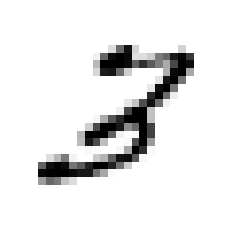

[9982] (예측값)6 (실제값)5


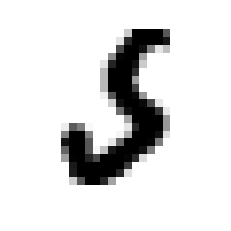

In [20]:
ML_Training()
#sneaky_generate_all()

정상샘플로 측정한 성능결과 : 
Result of Training Data : (total)60000, (hit)58538, (miss)1462, (accuracy)97.56333333333333%
Result of Test Data : (total)10000, (hit)9644, (miss)356, (accuracy)96.44%
적대적샘플로 측정한 성능결과 : 
Result of Training Data : (total)60000, (hit)37903, (miss)22097, (accuracy)63.17166666666667%
Result of Test Data : (total)10000, (hit)6253, (miss)3747, (accuracy)62.529999999999994%
[2] (예측값)4 (실제값)1


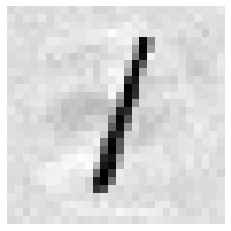

[3] (예측값)5 (실제값)0


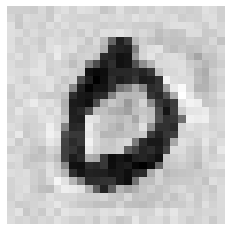

[5] (예측값)7 (실제값)1


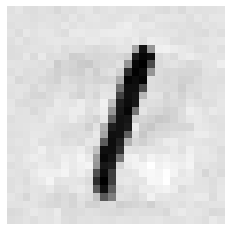

[6] (예측값)8 (실제값)4


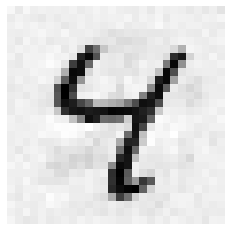

[8] (예측값)6 (실제값)5


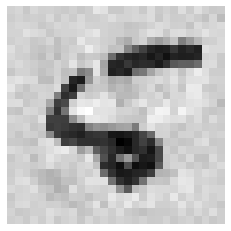

[10] (예측값)3 (실제값)0


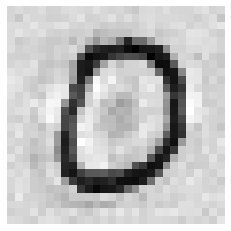

[19] (예측값)3 (실제값)4


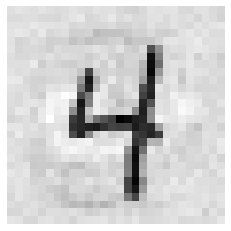

[21] (예측값)5 (실제값)6


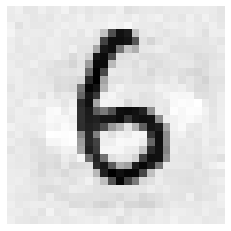

[24] (예측값)9 (실제값)4


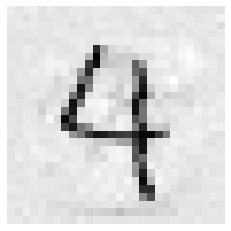

[26] (예측값)2 (실제값)7


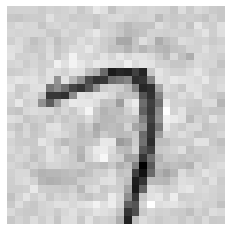

[28] (예측값)3 (실제값)0


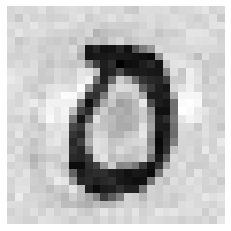

[29] (예측값)4 (실제값)1


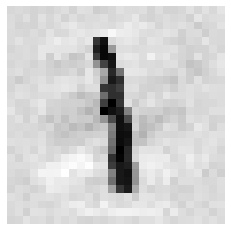

[38] (예측값)3 (실제값)2


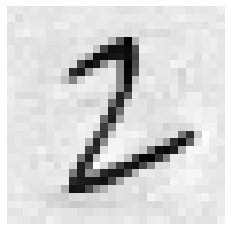

[39] (예측값)4 (실제값)1


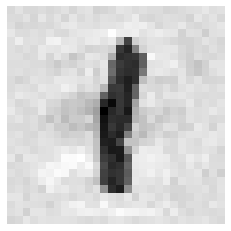

[40] (예측값)5 (실제값)1


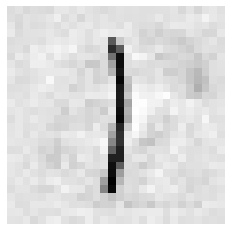

[41] (예측값)4 (실제값)7


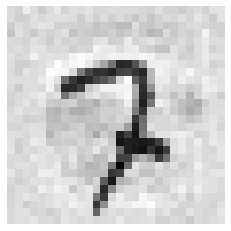

[42] (예측값)7 (실제값)4


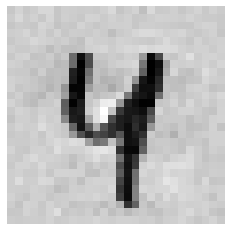

[43] (예측값)8 (실제값)2


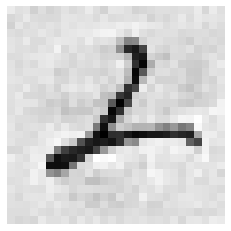

[45] (예측값)0 (실제값)5


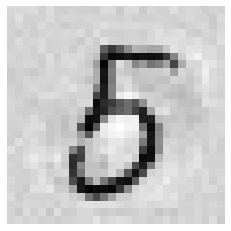

[46] (예측값)2 (실제값)1


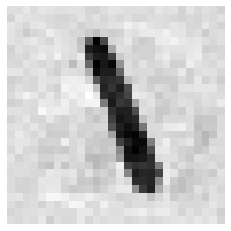

[50] (예측값)7 (실제값)6


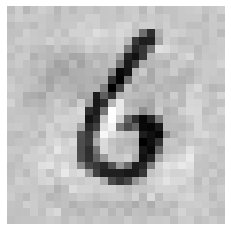

[52] (예측값)9 (실제값)5


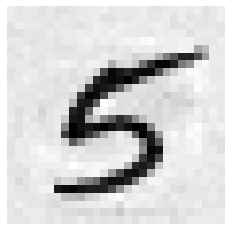

[57] (예측값)4 (실제값)1


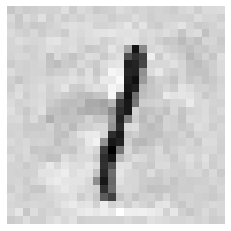

[61] (예측값)9 (실제값)8


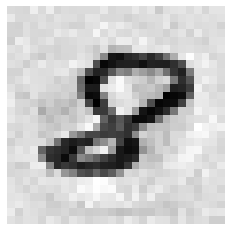

[62] (예측값)0 (실제값)9


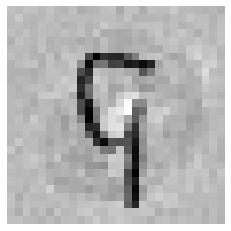

[64] (예측값)2 (실제값)7


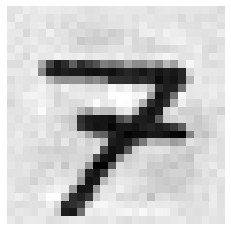

[65] (예측값)3 (실제값)4


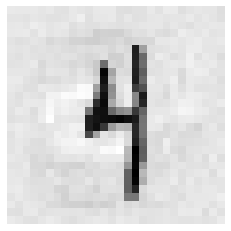

[66] (예측값)4 (실제값)6


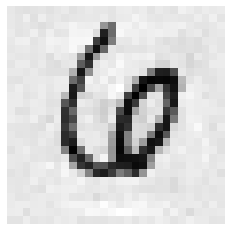

[68] (예측값)6 (실제값)3


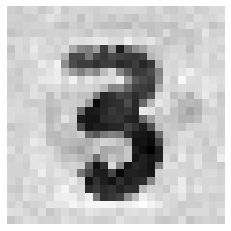

[72] (예측값)0 (실제값)2


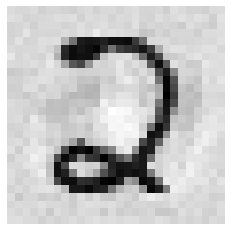

[76] (예측값)4 (실제값)3


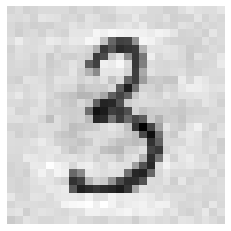

[78] (예측값)6 (실제값)9


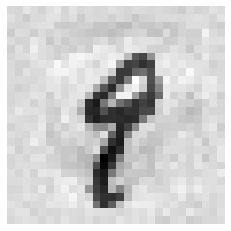

[79] (예측값)8 (실제값)7


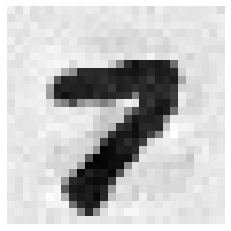

[80] (예측값)9 (실제값)7


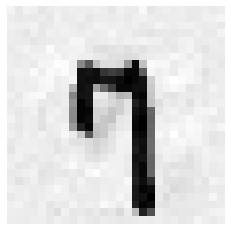

[84] (예측값)3 (실제값)8


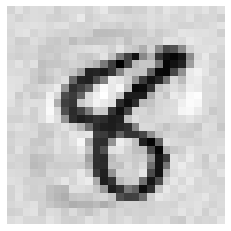

[87] (예측값)7 (실제값)3


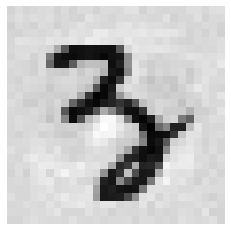

[92] (예측값)8 (실제값)9


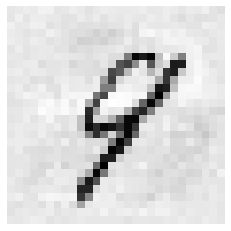

[93] (예측값)4 (실제값)3


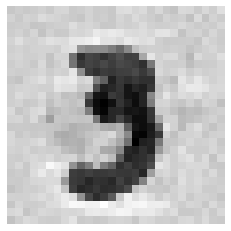

[95] (예측값)6 (실제값)4


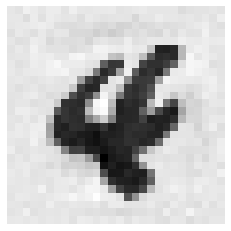

[96] (예측값)7 (실제값)1


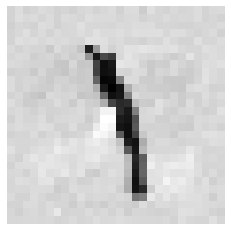

[97] (예측값)8 (실제값)7


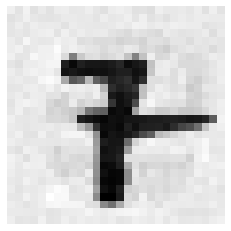

[101] (예측값)2 (실제값)0


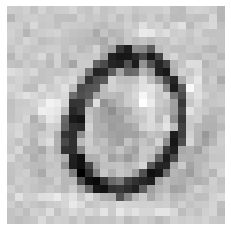

[104] (예측값)5 (실제값)9


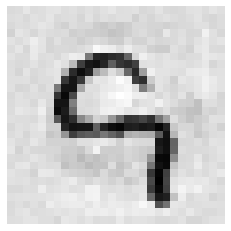

[106] (예측값)8 (실제값)2


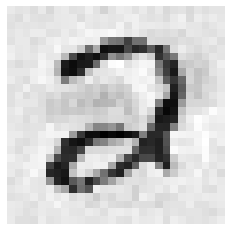

[107] (예측값)9 (실제값)1


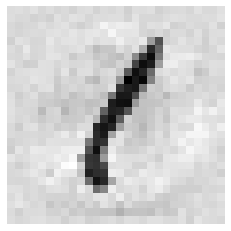

[112] (예측값)4 (실제값)3


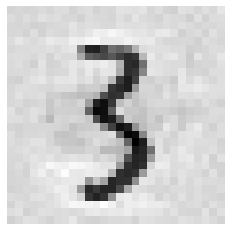

[116] (예측값)8 (실제값)4


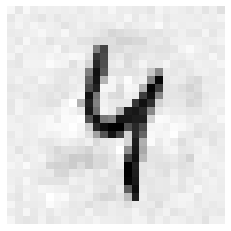

[118] (예측값)4 (실제값)9


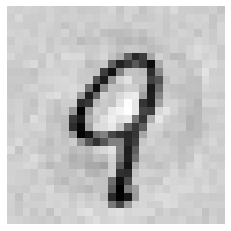

[122] (예측값)4 (실제값)7


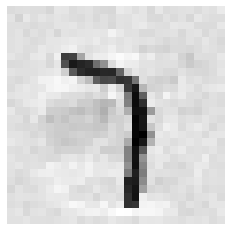

[124] (예측값)6 (실제값)7


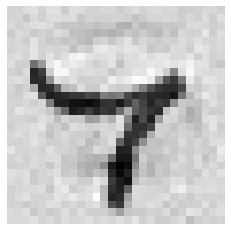

[126] (예측값)8 (실제값)0


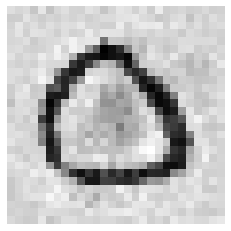

[132] (예측값)4 (실제값)5


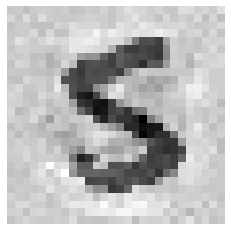

[134] (예측값)6 (실제값)8


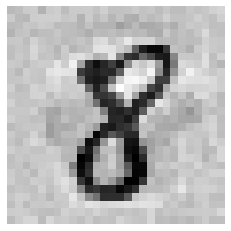

[137] (예측값)9 (실제값)1


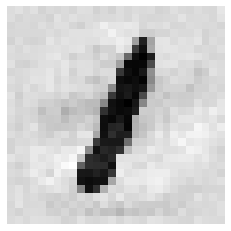

[139] (예측값)8 (실제값)4


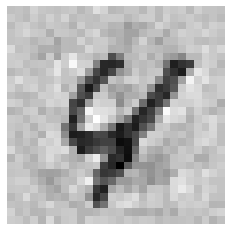

[144] (예측값)4 (실제값)7


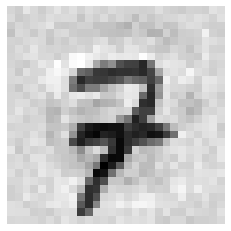

[145] (예측값)7 (실제값)1


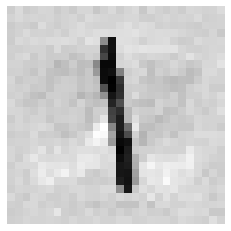

[146] (예측값)9 (실제값)8


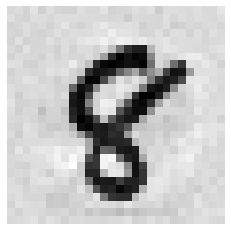

[148] (예측값)1 (실제값)0


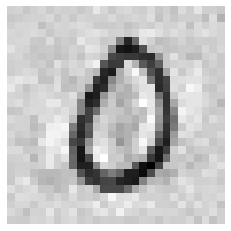

[149] (예측값)8 (실제값)2


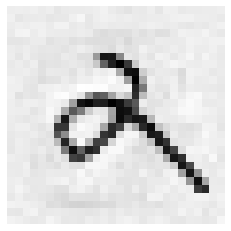

[151] (예측값)5 (실제값)9


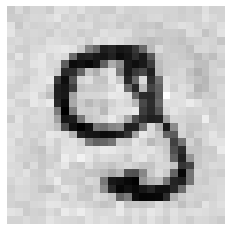

[152] (예측값)4 (실제값)5


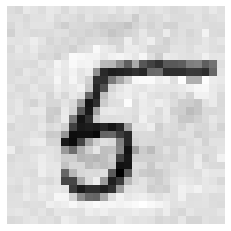

[154] (예측값)8 (실제값)1


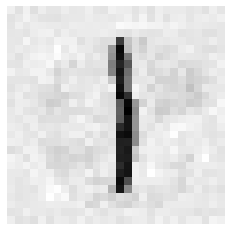

[157] (예측값)1 (실제값)0


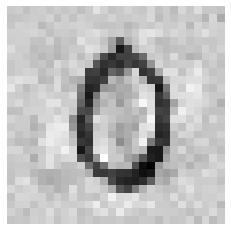

[158] (예측값)2 (실제값)3


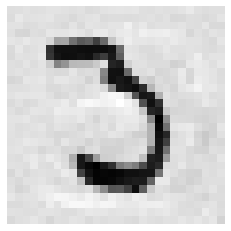

[159] (예측값)1 (실제값)4


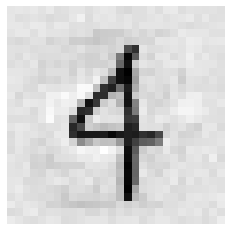

[169] (예측값)5 (실제값)4


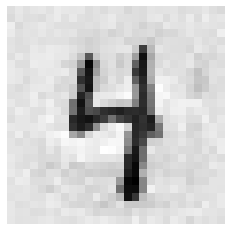

[171] (예측값)8 (실제값)7


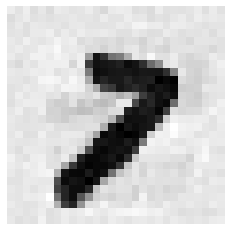

[175] (예측값)2 (실제값)7


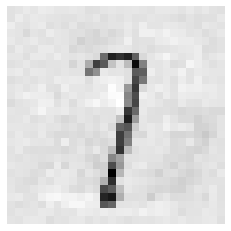

[177] (예측값)4 (실제값)8


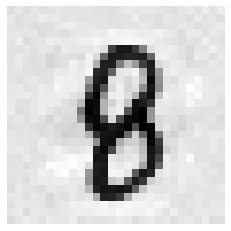

[179] (예측값)6 (실제값)8


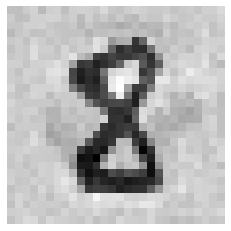

[189] (예측값)8 (실제값)1


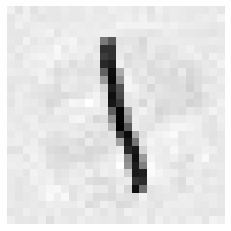

[190] (예측값)9 (실제값)1


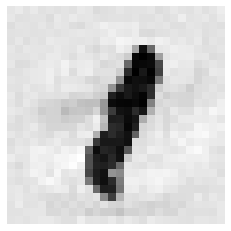

[191] (예측값)3 (실제값)1


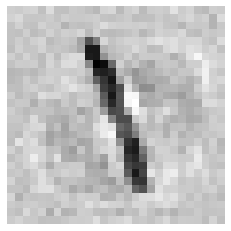

[192] (예측값)6 (실제값)0


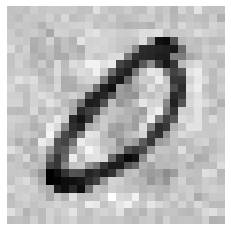

[193] (예측값)2 (실제값)9


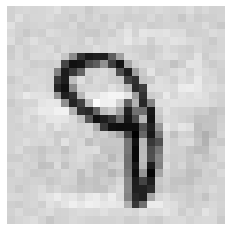

[194] (예측값)3 (실제값)0


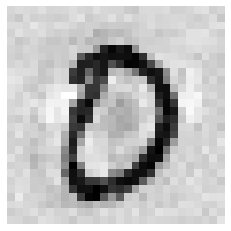

[198] (예측값)8 (실제값)4


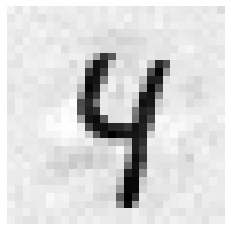

[200] (예측값)8 (실제값)3


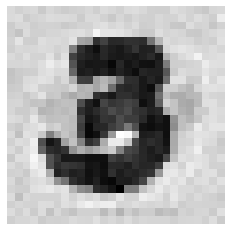

[202] (예측값)2 (실제값)1


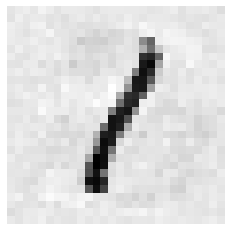

[204] (예측값)4 (실제값)1


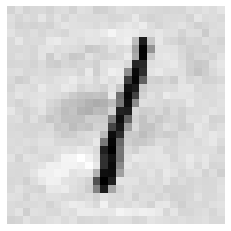

[208] (예측값)8 (실제값)2


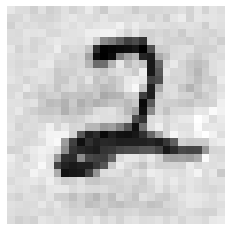

[210] (예측값)5 (실제값)4


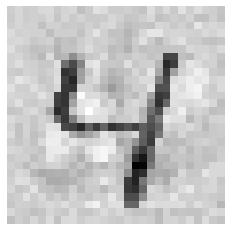

[211] (예측값)2 (실제값)5


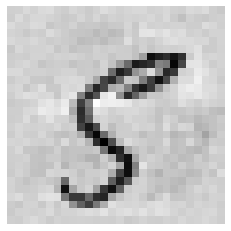

[213] (예측값)4 (실제값)3


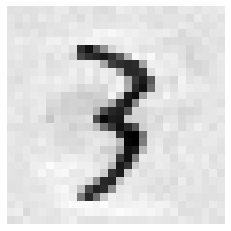

[217] (예측값)8 (실제값)6


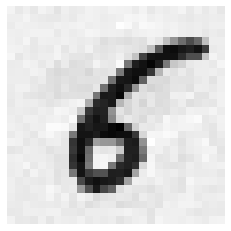

[219] (예측값)0 (실제값)5


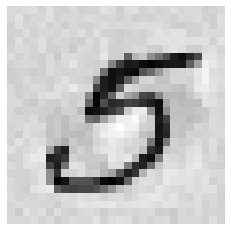

[221] (예측값)3 (실제값)2


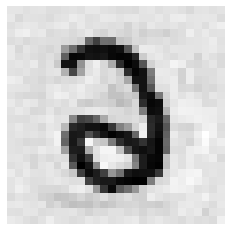

[222] (예측값)4 (실제값)2


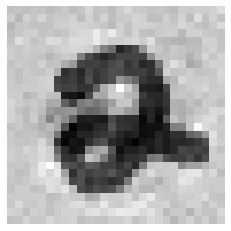

[224] (예측값)6 (실제값)1


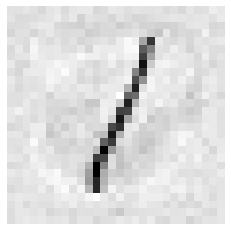

[227] (예측값)0 (실제값)4


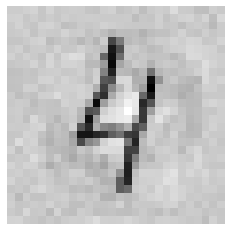

[228] (예측값)2 (실제값)1


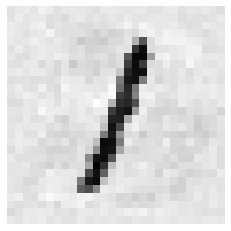

[229] (예측값)3 (실제값)7


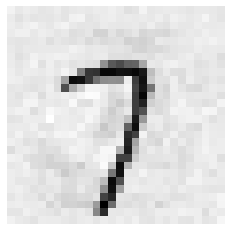

[231] (예측값)5 (실제값)3


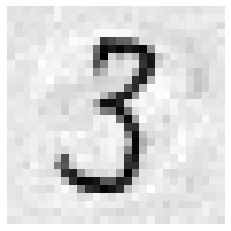

[232] (예측값)6 (실제값)8


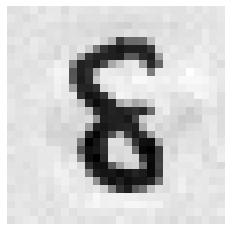

[233] (예측값)7 (실제값)8


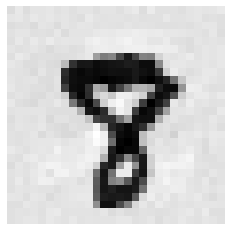

[234] (예측값)8 (실제값)7


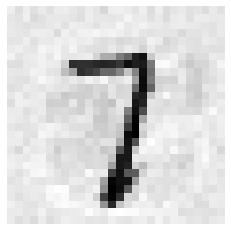

[237] (예측값)1 (실제값)2


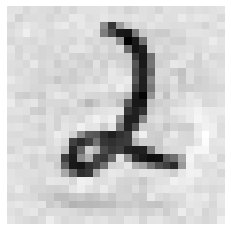

[241] (예측값)8 (실제값)9


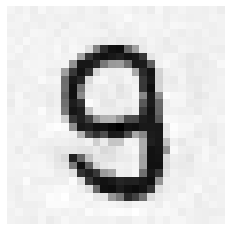

[242] (예측값)9 (실제값)8


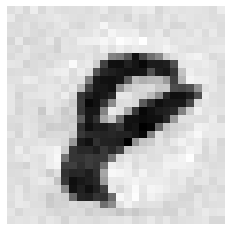

[247] (예측값)2 (실제값)4


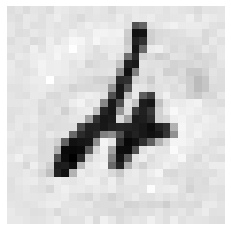

[249] (예측값)1 (실제값)2


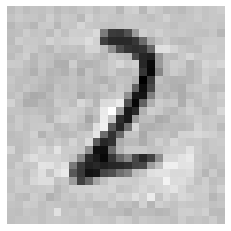

[250] (예측값)8 (실제값)4


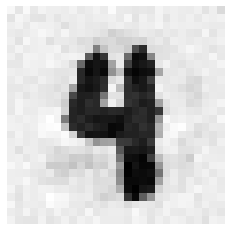

[251] (예측값)9 (실제값)1


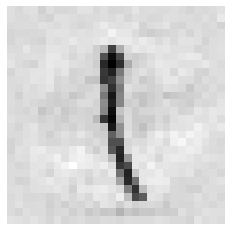

[255] (예측값)3 (실제값)7


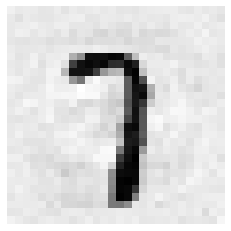

[259] (예측값)0 (실제값)6


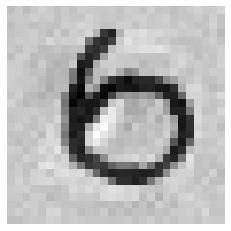

[265] (예측값)4 (실제값)1


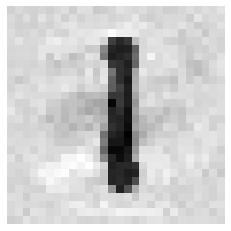

[268] (예측값)7 (실제값)8


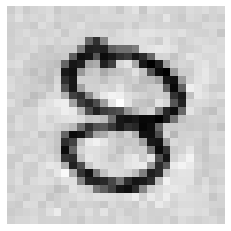

[269] (예측값)8 (실제값)0


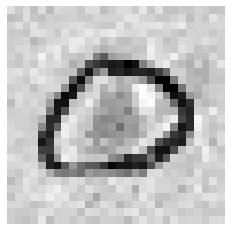

[273] (예측값)3 (실제값)9


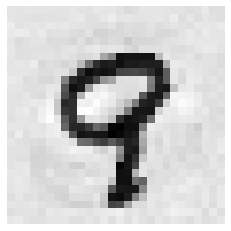

[277] (예측값)9 (실제값)8


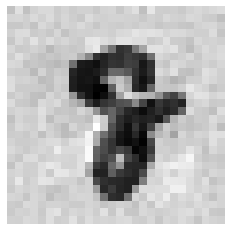

[279] (예측값)9 (실제값)1


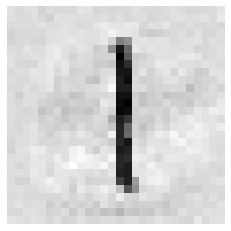

[282] (예측값)2 (실제값)7


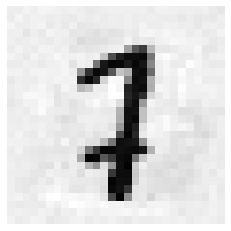

[284] (예측값)4 (실제값)9


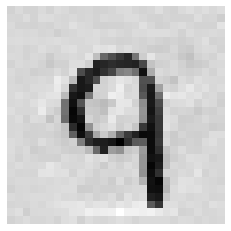

[288] (예측값)9 (실제값)1


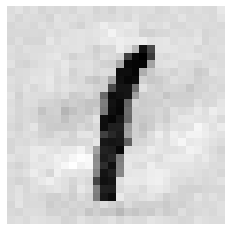

[291] (예측값)3 (실제값)2


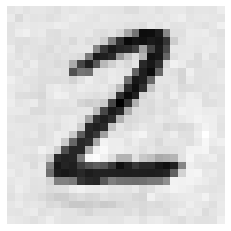

[292] (예측값)4 (실제값)9


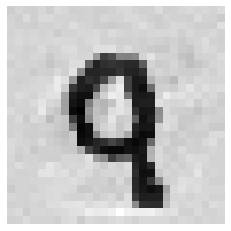

[293] (예측값)5 (실제값)2


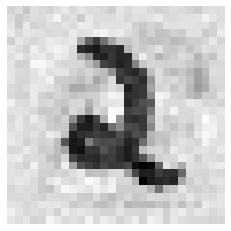

[294] (예측값)6 (실제값)0


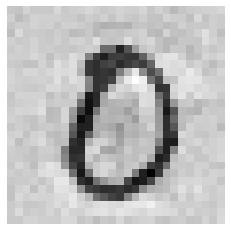

[297] (예측값)9 (실제값)0


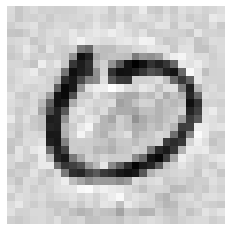

[300] (예측값)2 (실제값)4


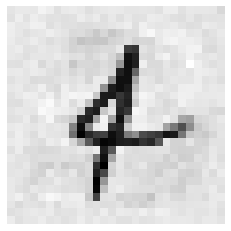

[304] (예측값)6 (실제값)4


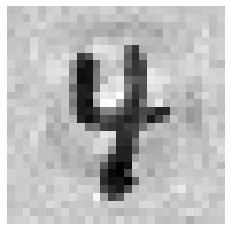

[307] (예측값)9 (실제값)7


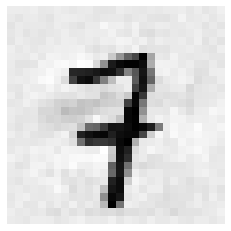

[308] (예측값)8 (실제값)4


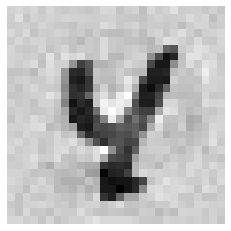

[312] (예측값)9 (실제값)0


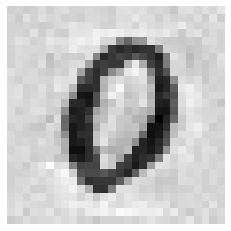

[313] (예측값)5 (실제값)3


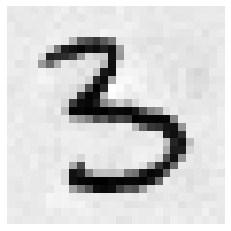

[315] (예측값)7 (실제값)9


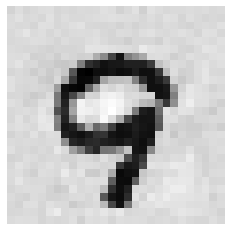

[316] (예측값)8 (실제값)6


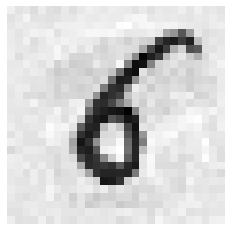

[318] (예측값)0 (실제값)2


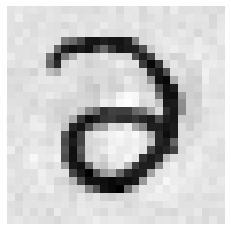

[320] (예측값)2 (실제값)9


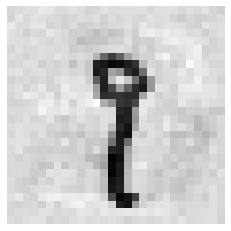

[321] (예측값)3 (실제값)2


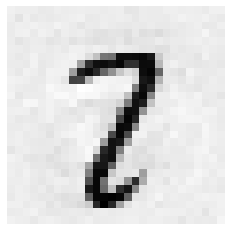

[323] (예측값)5 (실제값)3


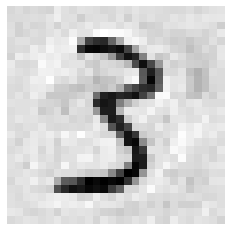

[324] (예측값)6 (실제값)0


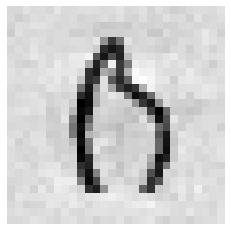

[325] (예측값)7 (실제값)4


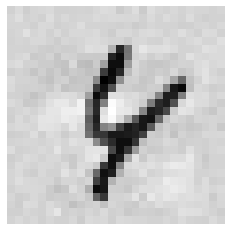

[326] (예측값)8 (실제값)2


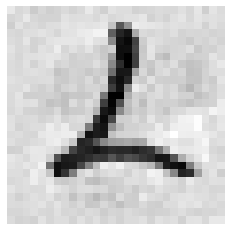

[327] (예측값)9 (실제값)0


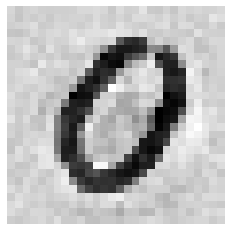

[328] (예측값)8 (실제값)7


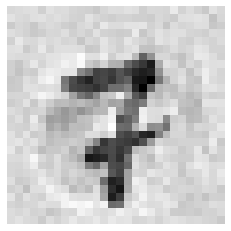

[333] (예측값)6 (실제값)5


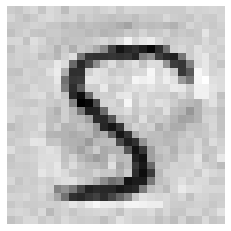

[340] (예측값)3 (실제값)5


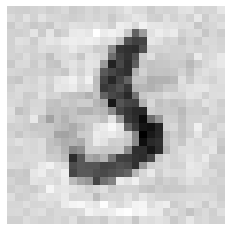

[346] (예측값)3 (실제값)0


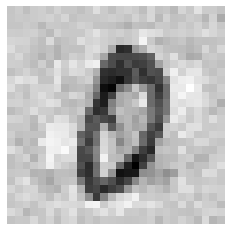

[349] (예측값)4 (실제값)3


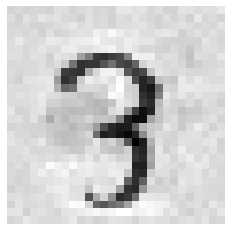

[352] (예측값)3 (실제값)5


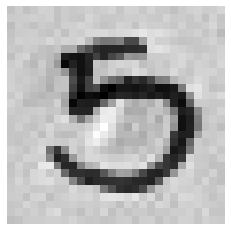

[353] (예측값)8 (실제값)6


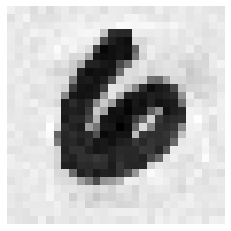

[357] (예측값)2 (실제값)1


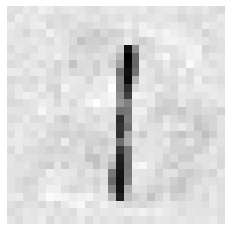

[358] (예측값)3 (실제값)7


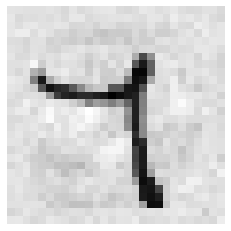

[359] (예측값)4 (실제값)9


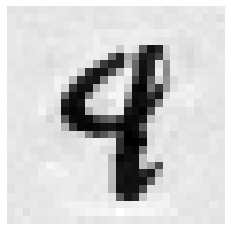

[360] (예측값)5 (실제값)4


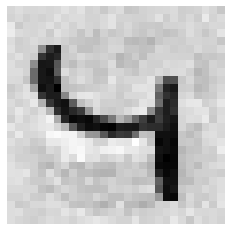

[361] (예측값)9 (실제값)6


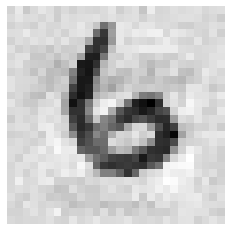

[363] (예측값)8 (실제값)2


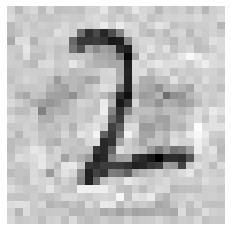

[365] (예측값)1 (실제값)0


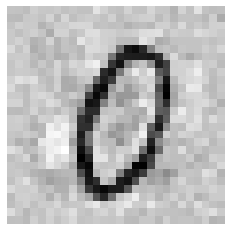

[368] (예측값)4 (실제값)6


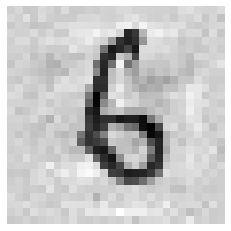

[372] (예측값)8 (실제값)0


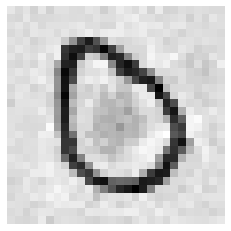

[376] (예측값)9 (실제값)4


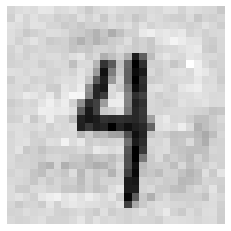

[380] (예측값)6 (실제값)0


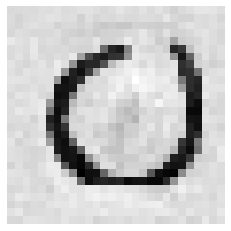

[381] (예측값)7 (실제값)3


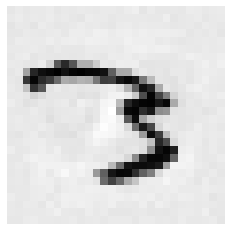

[382] (예측값)8 (실제값)3


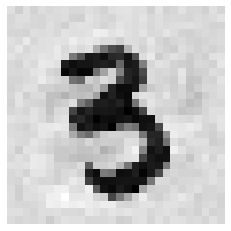

[390] (예측값)7 (실제값)2


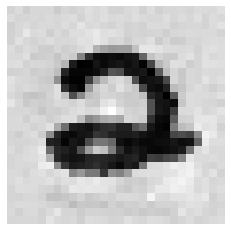

[391] (예측값)9 (실제값)8


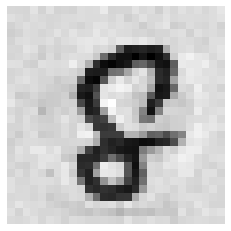

[401] (예측값)0 (실제값)8


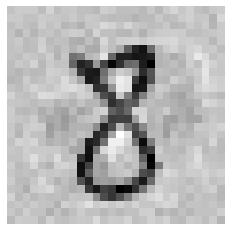

[403] (예측값)5 (실제값)8


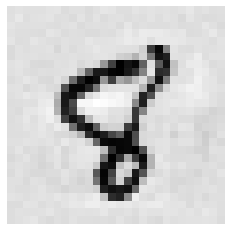

[404] (예측값)3 (실제값)2


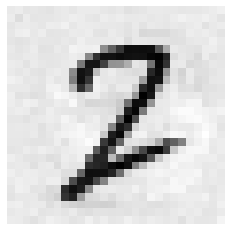

[405] (예측값)5 (실제값)4


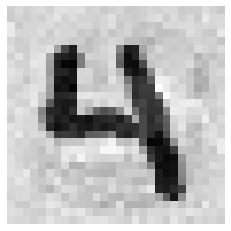

[406] (예측값)6 (실제값)5


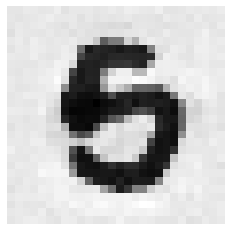

[407] (예측값)7 (실제값)0


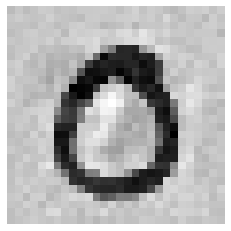

[408] (예측값)8 (실제값)3


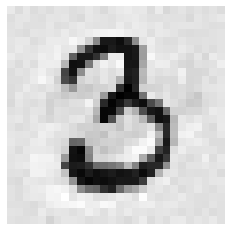

[409] (예측값)9 (실제값)1


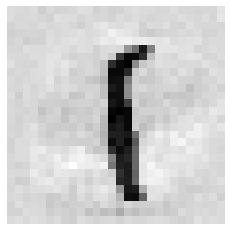

[410] (예측값)5 (실제값)7


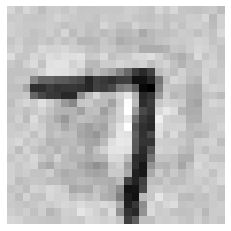

[414] (예측값)4 (실제값)9


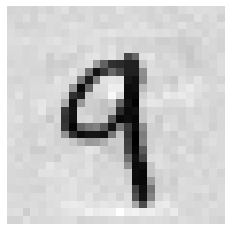

[415] (예측값)5 (실제값)7


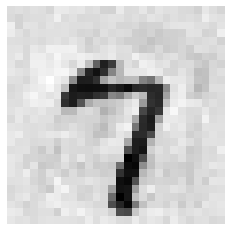

[417] (예측값)7 (실제값)9


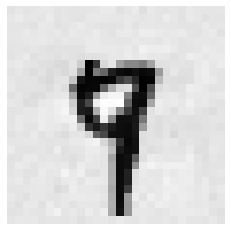

[418] (예측값)8 (실제값)2


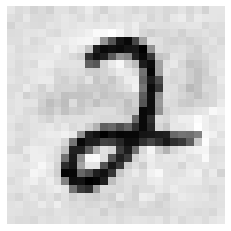

[419] (예측값)9 (실제값)1


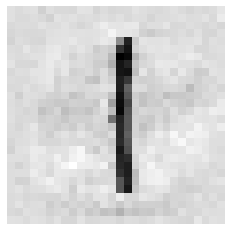

[420] (예측값)7 (실제값)4


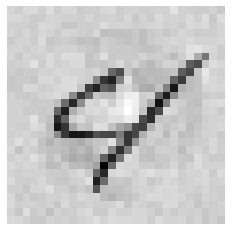

[423] (예측값)3 (실제값)2


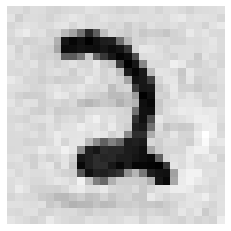

[424] (예측값)4 (실제값)0


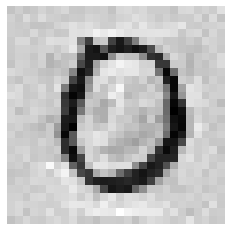

[428] (예측값)9 (실제값)4


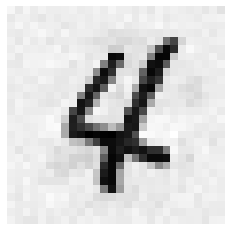

[429] (예측값)9 (실제값)8


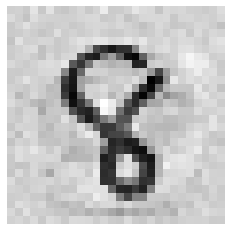

[432] (예측값)2 (실제값)4


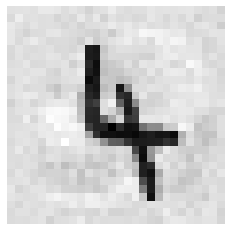

[434] (예측값)4 (실제값)9


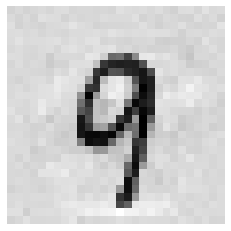

[436] (예측값)6 (실제값)8


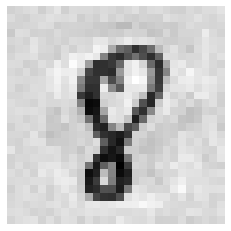

[438] (예측값)9 (실제값)7


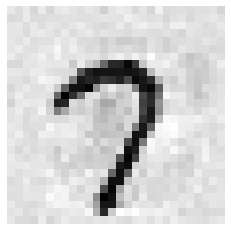

[439] (예측값)9 (실제값)6


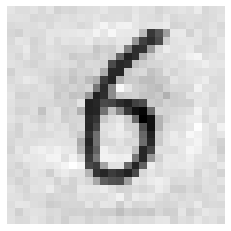

[441] (예측값)6 (실제값)0


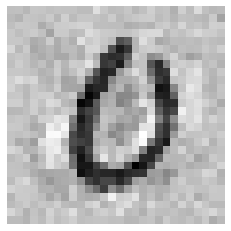

[443] (예측값)3 (실제값)0


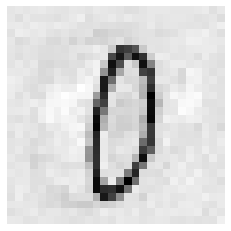

[445] (예측값)0 (실제값)6


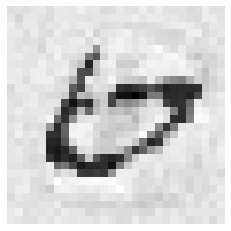

[446] (예측값)9 (실제값)6


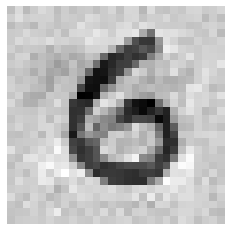

[447] (예측값)8 (실제값)4


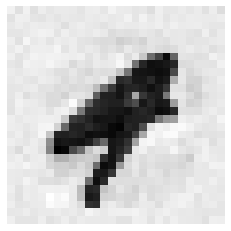

[453] (예측값)5 (실제값)3


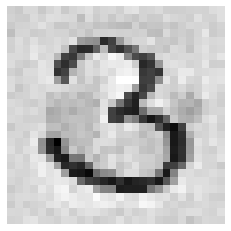

[456] (예측값)9 (실제값)2


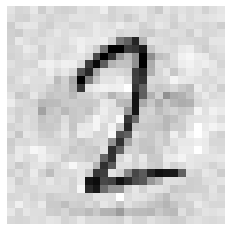

[457] (예측값)0 (실제값)6


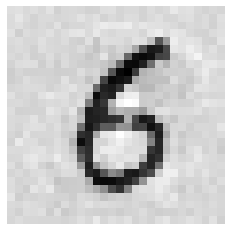

[459] (예측값)2 (실제값)0


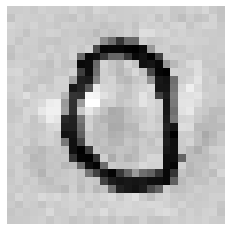

[460] (예측값)3 (실제값)5


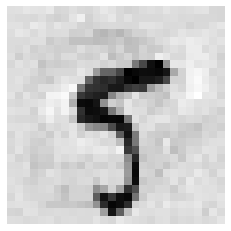

[464] (예측값)8 (실제값)3


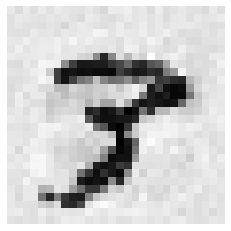

[469] (예측값)3 (실제값)5


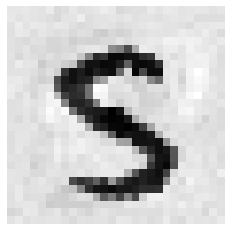

[473] (예측값)8 (실제값)1


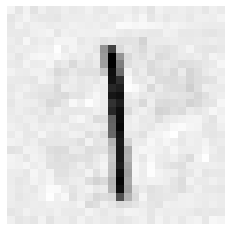

[478] (예측값)4 (실제값)5


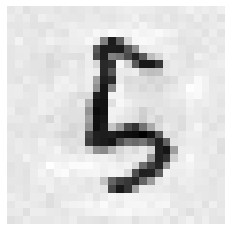

[479] (예측값)5 (실제값)9


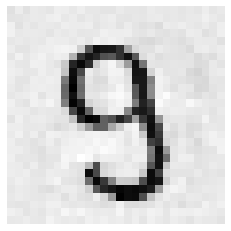

[480] (예측값)6 (실제값)1


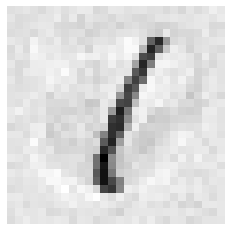

[485] (예측값)1 (실제값)0


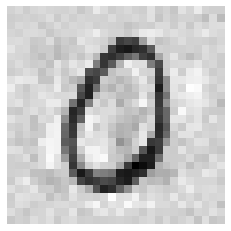

[488] (예측값)4 (실제값)9


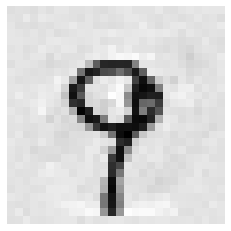

[490] (예측값)6 (실제값)0


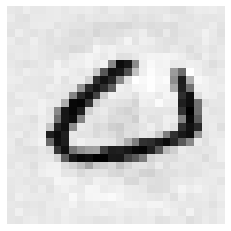

[491] (예측값)7 (실제값)5


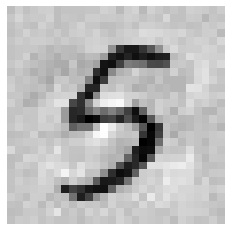

[492] (예측값)8 (실제값)2


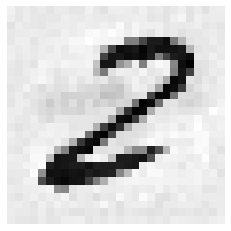

[496] (예측값)2 (실제값)9


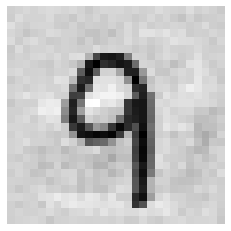

[497] (예측값)3 (실제값)4


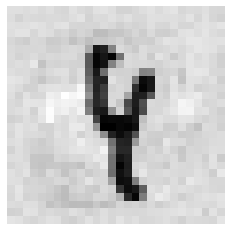

[498] (예측값)4 (실제값)0


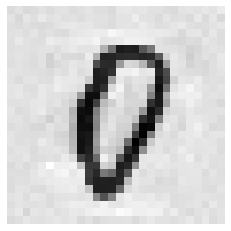

[499] (예측값)5 (실제값)6


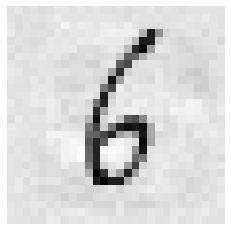

[500] (예측값)6 (실제값)3


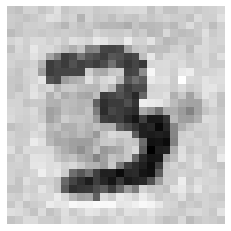

[504] (예측값)0 (실제값)1


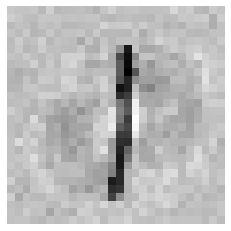

[506] (예측값)2 (실제값)1


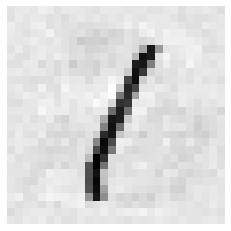

[507] (예측값)4 (실제값)3


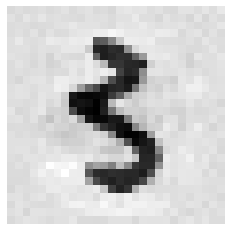

[508] (예측값)5 (실제값)6


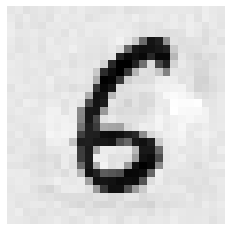

[510] (예측값)8 (실제값)7


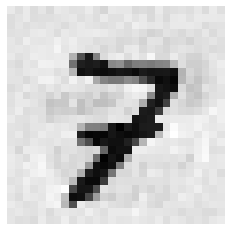

[511] (예측값)9 (실제값)4


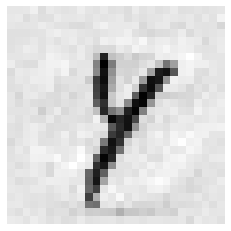

[515] (예측값)4 (실제값)3


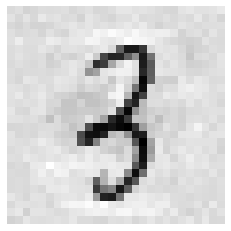

[516] (예측값)4 (실제값)2


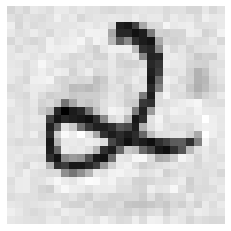

[519] (예측값)9 (실제값)4


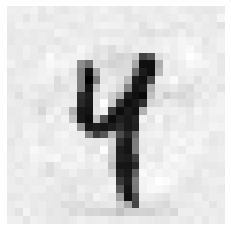

[520] (예측값)2 (실제값)8


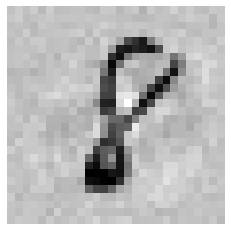

[522] (예측값)2 (실제값)7


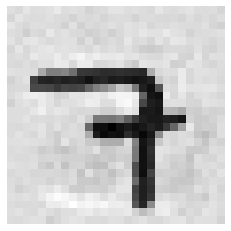

[526] (예측값)8 (실제값)3


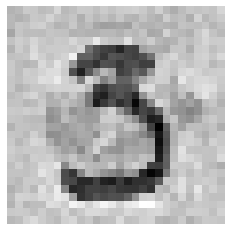

[528] (예측값)8 (실제값)3


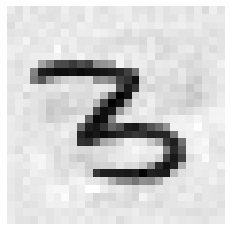

[529] (예측값)9 (실제값)1


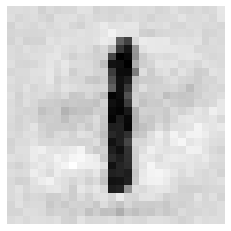

[530] (예측값)0 (실제값)9


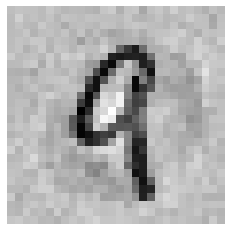

[534] (예측값)4 (실제값)6


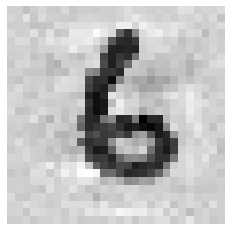

[536] (예측값)1 (실제값)2


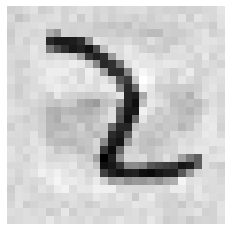

[538] (예측값)9 (실제값)8


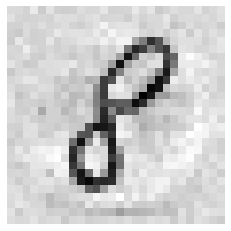

[542] (예측값)3 (실제값)8


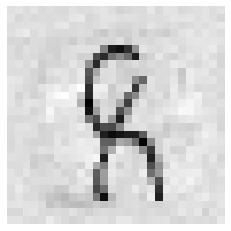

[543] (예측값)4 (실제값)8


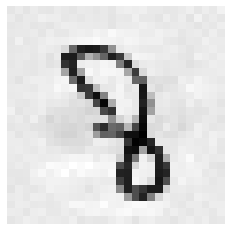

[545] (예측값)9 (실제값)0


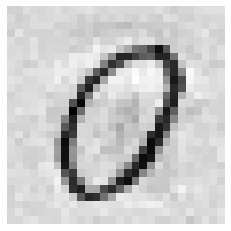

[547] (예측값)8 (실제값)2


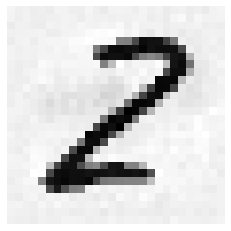

[548] (예측값)9 (실제값)3


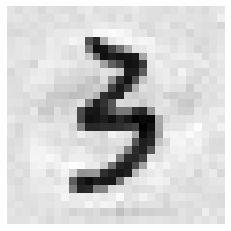

[549] (예측값)0 (실제값)2


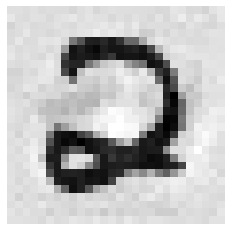

[550] (예측값)3 (실제값)7


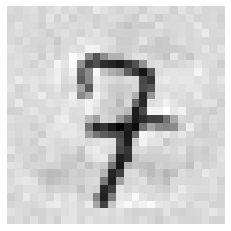

[551] (예측값)8 (실제값)7


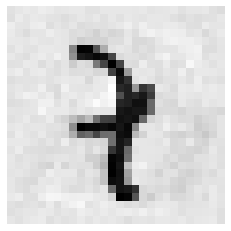

[553] (예측값)4 (실제값)8


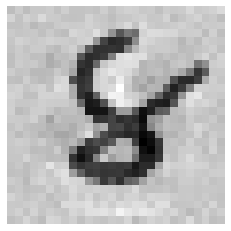

[557] (예측값)8 (실제값)7


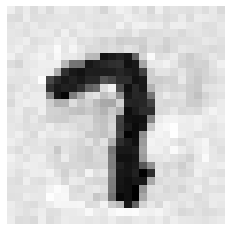

[559] (예측값)4 (실제값)6


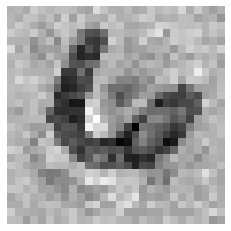

[561] (예측값)5 (실제값)0


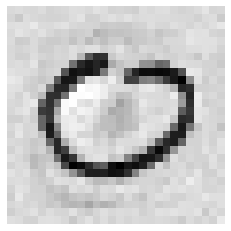

[562] (예측값)4 (실제값)9


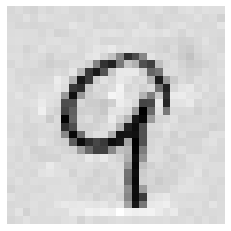

[564] (예측값)6 (실제값)0


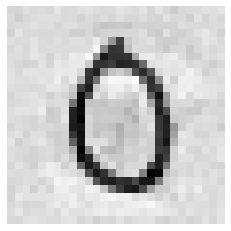

[565] (예측값)9 (실제값)4


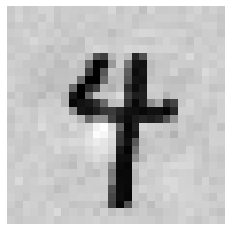

[566] (예측값)8 (실제값)6


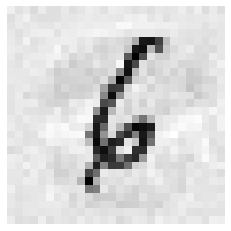

[568] (예측값)0 (실제값)6


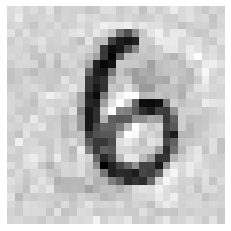

[571] (예측값)9 (실제값)4


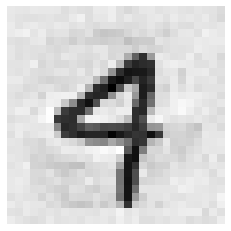

[572] (예측값)4 (실제값)8


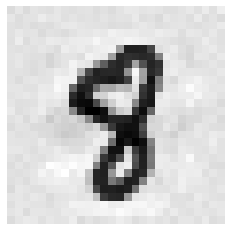

[576] (예측값)8 (실제값)3


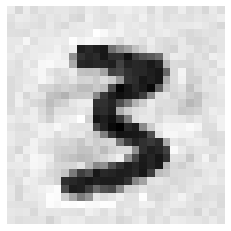

[577] (예측값)9 (실제값)3


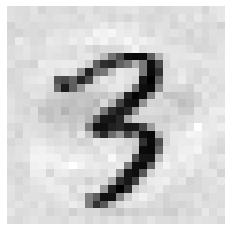

[578] (예측값)8 (실제값)3


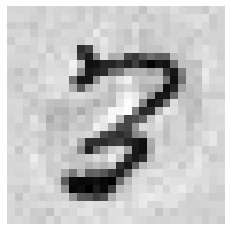

[579] (예측값)1 (실제값)7


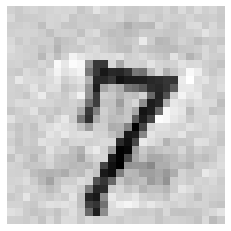

[582] (예측값)1 (실제값)8


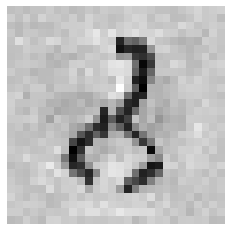

[583] (예측값)8 (실제값)2


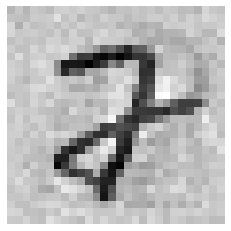

[587] (예측값)0 (실제값)6


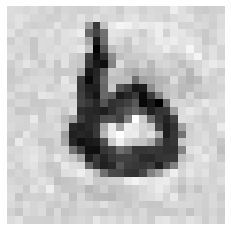

[589] (예측값)2 (실제값)4


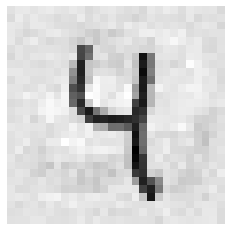

[593] (예측값)7 (실제값)9


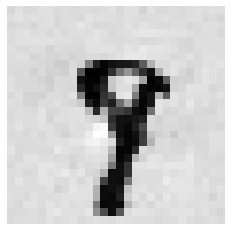

[594] (예측값)8 (실제값)6


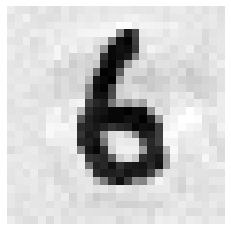

[596] (예측값)0 (실제값)8


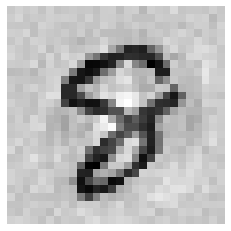

[597] (예측값)1 (실제값)0


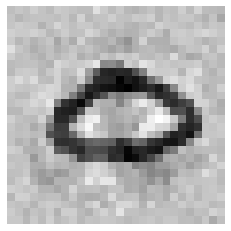

[603] (예측값)9 (실제값)8


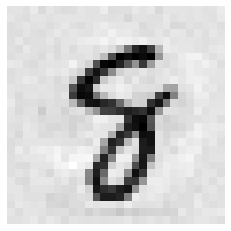

[610] (예측값)2 (실제값)4


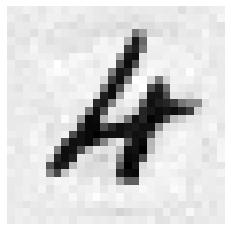

[614] (예측값)8 (실제값)3


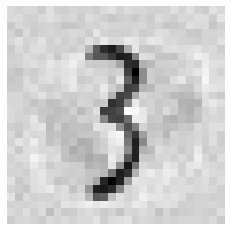

[615] (예측값)2 (실제값)1


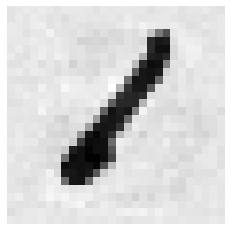

[616] (예측값)3 (실제값)9


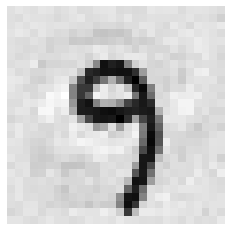

[617] (예측값)4 (실제값)7


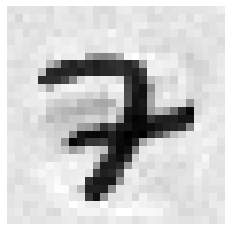

[619] (예측값)7 (실제값)1


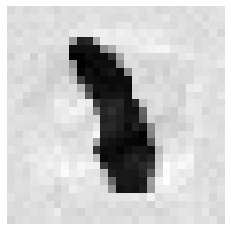

[620] (예측값)8 (실제값)0


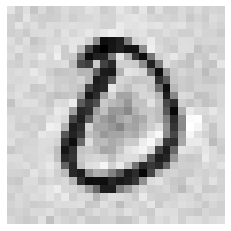

[621] (예측값)9 (실제값)8


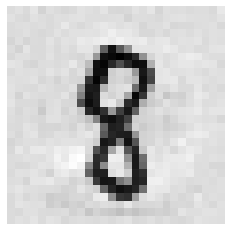

[624] (예측값)3 (실제값)2


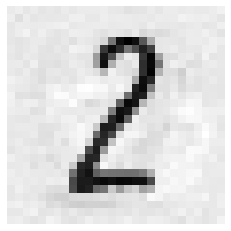

[625] (예측값)4 (실제값)6


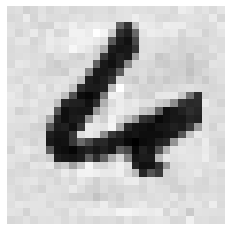

[627] (예측값)6 (실제값)9


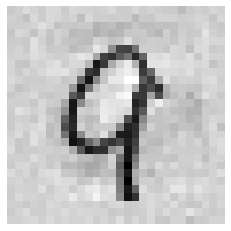

[629] (예측값)8 (실제값)2


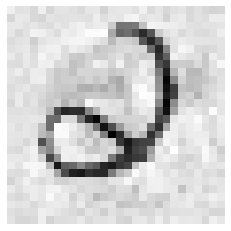

[630] (예측값)0 (실제값)9


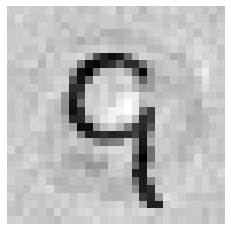

[636] (예측값)5 (실제값)7


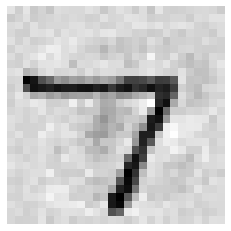

[637] (예측값)9 (실제값)3


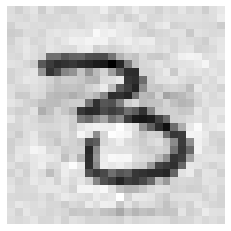

[639] (예측값)8 (실제값)9


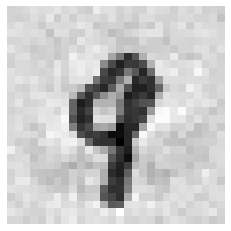

[640] (예측값)2 (실제값)1


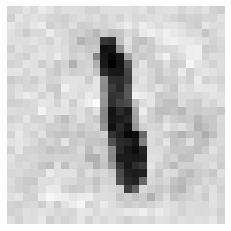

[641] (예측값)3 (실제값)8


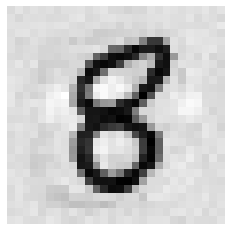

[645] (예측값)9 (실제값)5


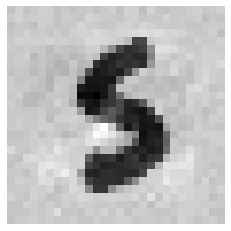

[646] (예측값)8 (실제값)2


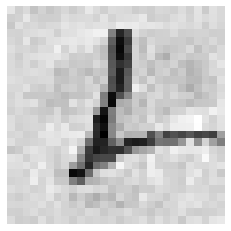

[647] (예측값)9 (실제값)1


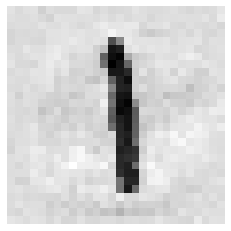

[653] (예측값)5 (실제값)2


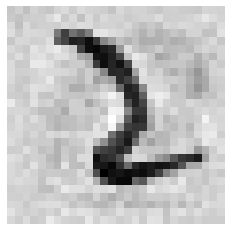

[657] (예측값)9 (실제값)3


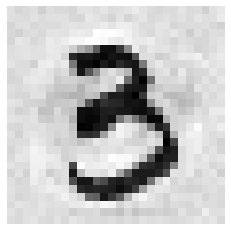

[658] (예측값)0 (실제값)7


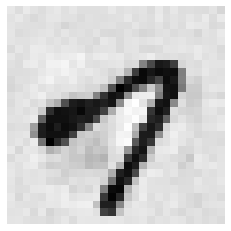

[659] (예측값)1 (실제값)2


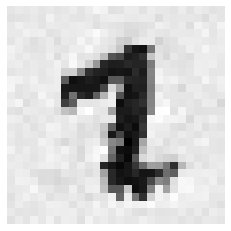

[662] (예측값)4 (실제값)9


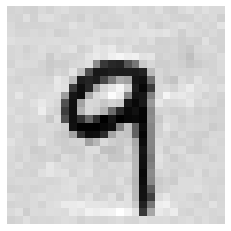

[666] (예측값)8 (실제값)7


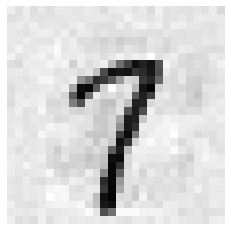

[667] (예측값)9 (실제값)7


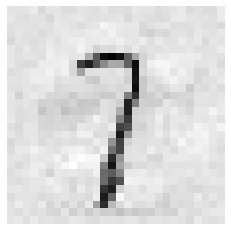

[668] (예측값)0 (실제값)4


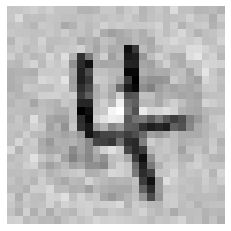

[672] (예측값)4 (실제값)1


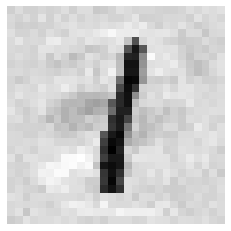

[674] (예측값)6 (실제값)5


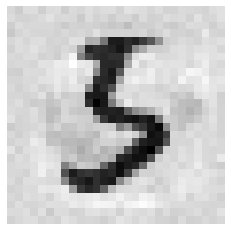

[677] (예측값)9 (실제값)3


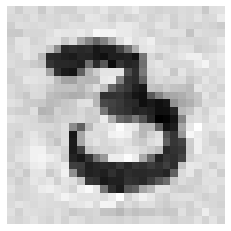

[680] (예측값)2 (실제값)6


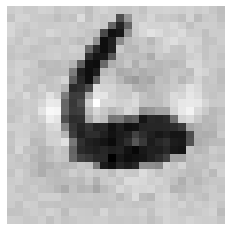

[682] (예측값)4 (실제값)1


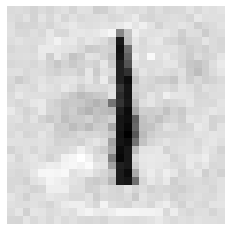

[684] (예측값)2 (실제값)7


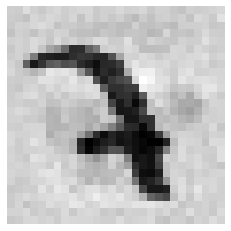

[685] (예측값)4 (실제값)8


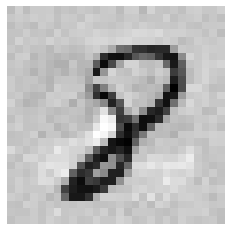

[688] (예측값)0 (실제값)6


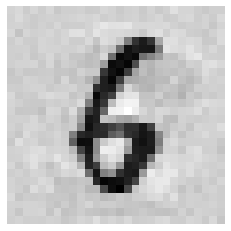

[689] (예측값)3 (실제값)7


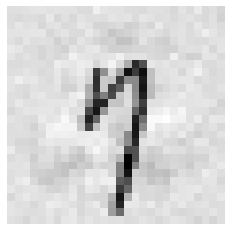

[690] (예측값)3 (실제값)2


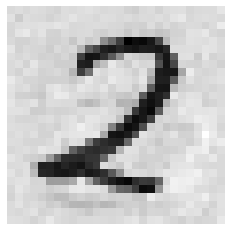

[691] (예측값)4 (실제값)8


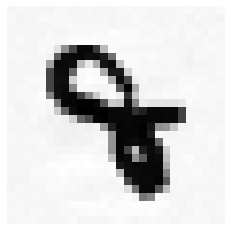

[692] (예측값)7 (실제값)5


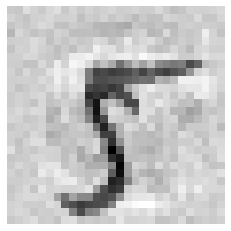

[694] (예측값)8 (실제값)5


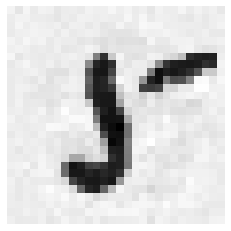

[695] (예측값)9 (실제값)1


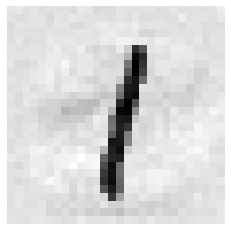

[696] (예측값)2 (실제값)1


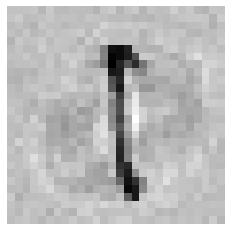

[698] (예측값)2 (실제값)4


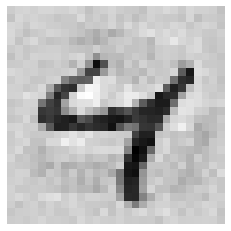

[699] (예측값)4 (실제값)3


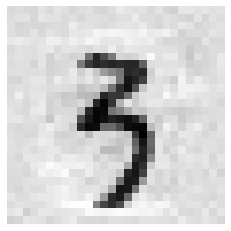

[700] (예측값)5 (실제값)1


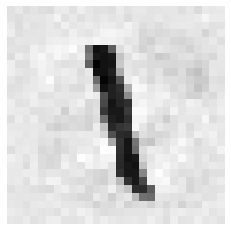

[707] (예측값)9 (실제값)4


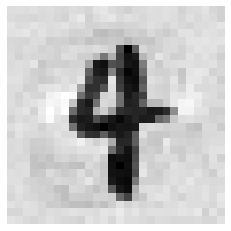

[709] (예측값)6 (실제값)8


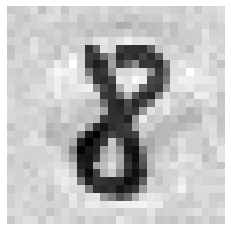

[710] (예측값)7 (실제값)5


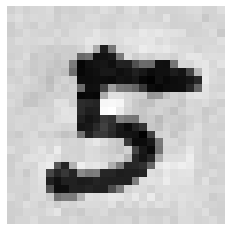

[711] (예측값)8 (실제값)5


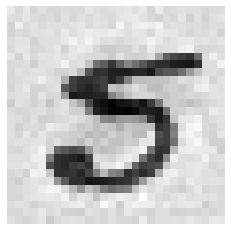

[712] (예측값)9 (실제값)4


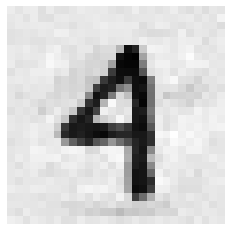

[714] (예측값)5 (실제값)8


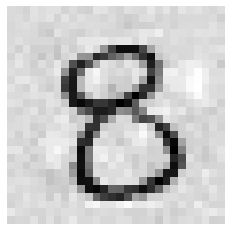

[716] (예측값)4 (실제값)1


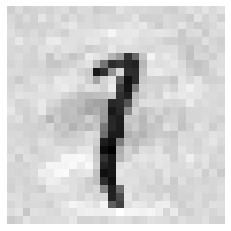

[717] (예측값)9 (실제값)0


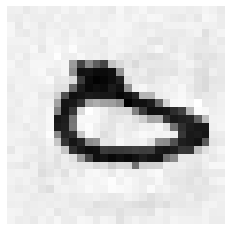

[720] (예측값)8 (실제값)5


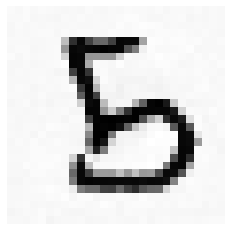

[723] (예측값)1 (실제값)0


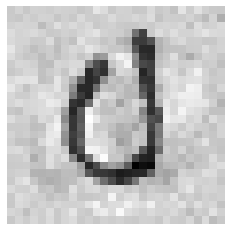

[724] (예측값)2 (실제값)6


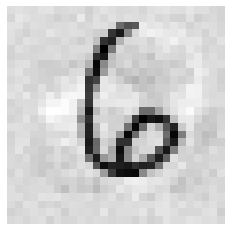

[726] (예측값)4 (실제값)7


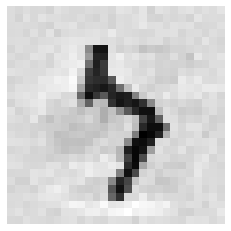

[729] (예측값)4 (실제값)6


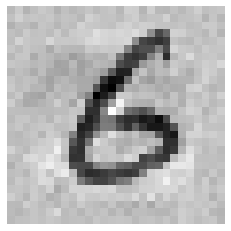

[730] (예측값)5 (실제값)7


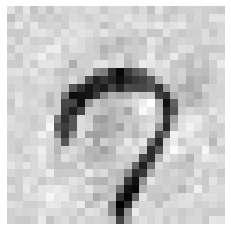

[733] (예측값)8 (실제값)9


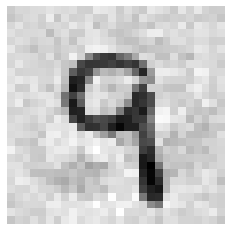

[738] (예측값)8 (실제값)2


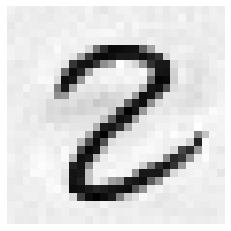

[739] (예측값)9 (실제값)5


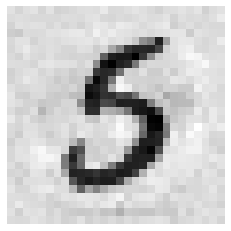

[740] (예측값)5 (실제값)4


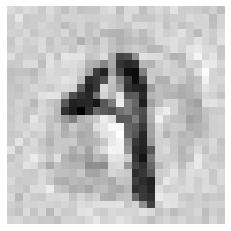

[742] (예측값)2 (실제값)0


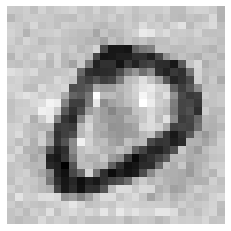

[746] (예측값)9 (실제값)7


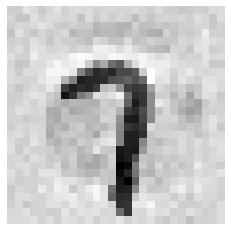

[747] (예측값)7 (실제값)3


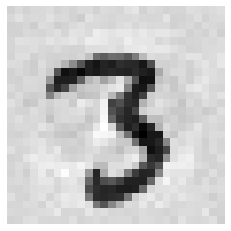

[748] (예측값)8 (실제값)4


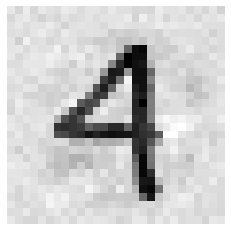

[749] (예측값)9 (실제값)1


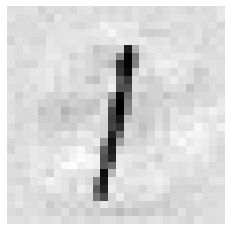

[757] (예측값)9 (실제값)4


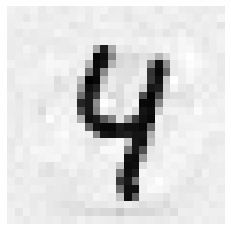

[760] (예측값)9 (실제값)4


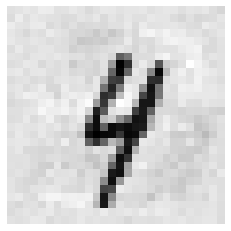

[763] (예측값)6 (실제값)0


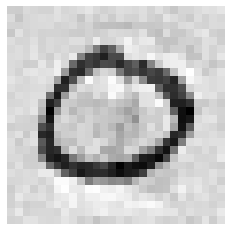

[764] (예측값)7 (실제값)2


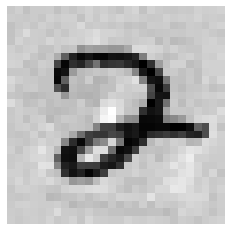

[767] (예측값)0 (실제값)1


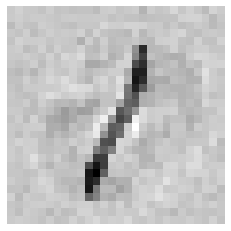

[771] (예측값)9 (실제값)7


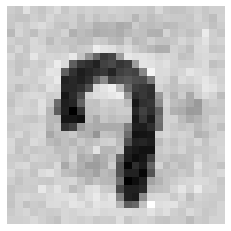

[772] (예측값)7 (실제값)1


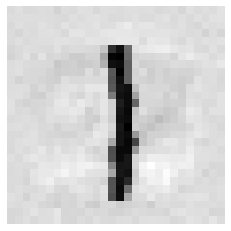

[773] (예측값)8 (실제값)9


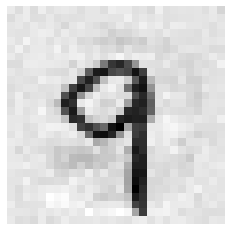

[774] (예측값)9 (실제값)4


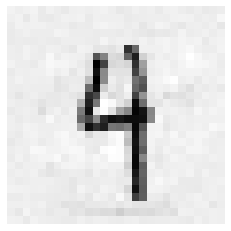

[777] (예측값)8 (실제값)1


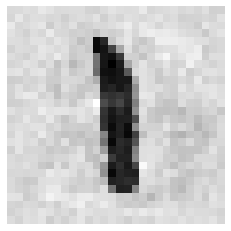

[779] (예측값)4 (실제값)5


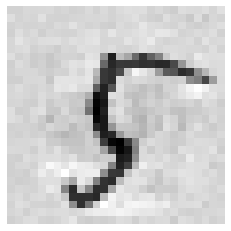

[780] (예측값)5 (실제값)3


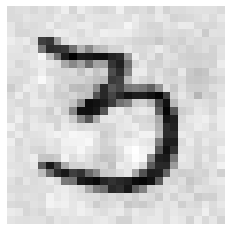

[781] (예측값)6 (실제값)8


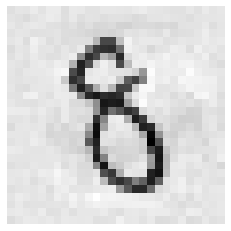

[783] (예측값)8 (실제값)1


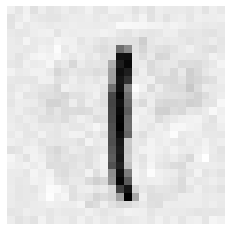

[789] (예측값)5 (실제값)4


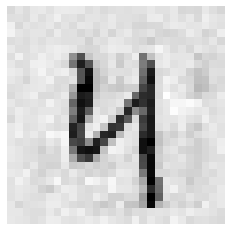

[795] (예측값)1 (실제값)3


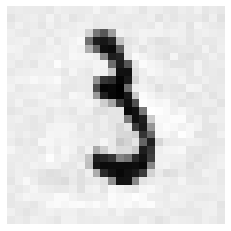

[797] (예측값)4 (실제값)5


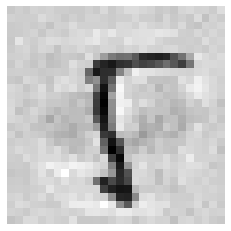

[798] (예측값)5 (실제값)1


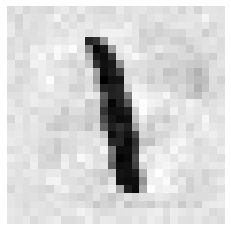

[800] (예측값)9 (실제값)8


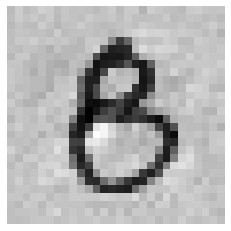

[801] (예측값)8 (실제값)3


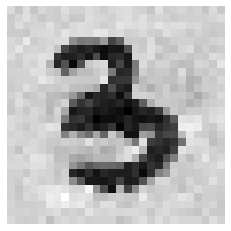

[802] (예측값)9 (실제값)4


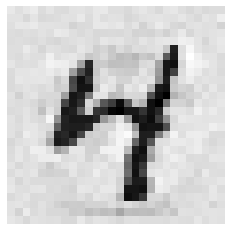

[806] (예측값)3 (실제값)8


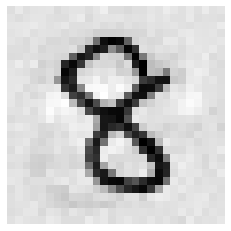

[810] (예측값)8 (실제값)7


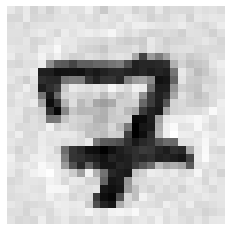

[813] (예측값)8 (실제값)9


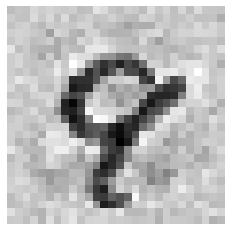

[818] (예측값)8 (실제값)1


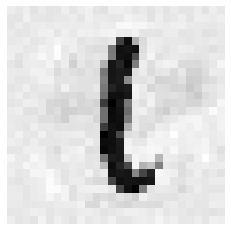

[819] (예측값)9 (실제값)3


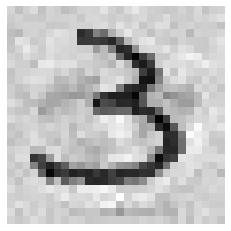

[821] (예측값)6 (실제값)0


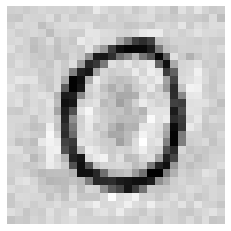

[822] (예측값)2 (실제값)7


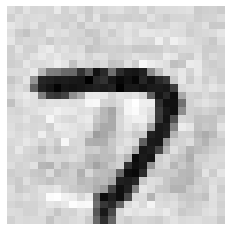

[829] (예측값)9 (실제값)4


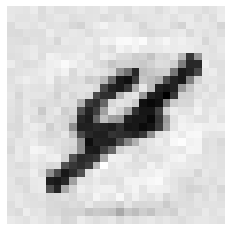

[832] (예측값)3 (실제값)7


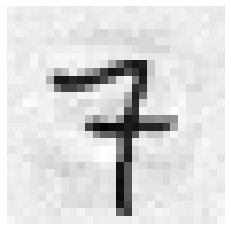

[834] (예측값)8 (실제값)6


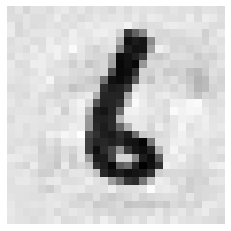

[838] (예측값)9 (실제값)4


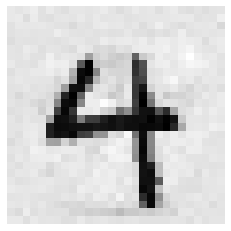

[839] (예측값)0 (실제값)8


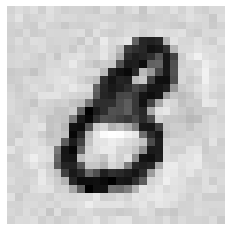

[840] (예측값)2 (실제값)1


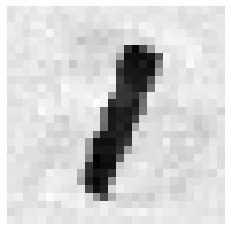

[841] (예측값)2 (실제값)7


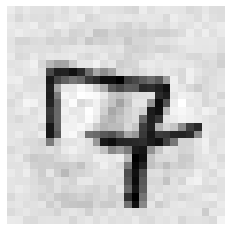

[842] (예측값)4 (실제값)7


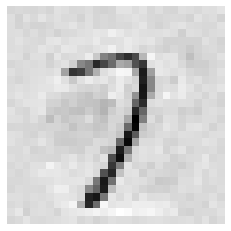

[844] (예측값)6 (실제값)8


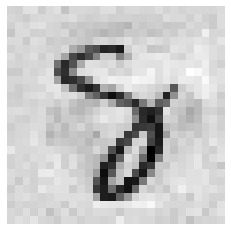

[845] (예측값)7 (실제값)0


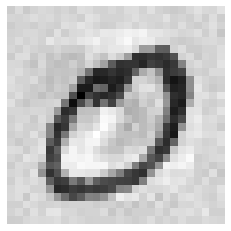

[846] (예측값)8 (실제값)7


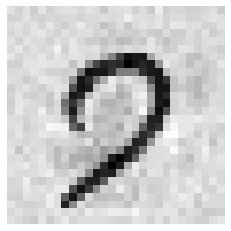

[847] (예측값)9 (실제값)3


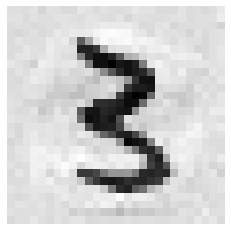

[848] (예측값)0 (실제값)1


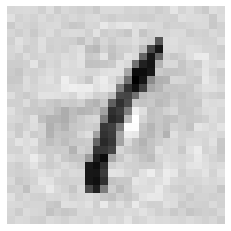

[852] (예측값)4 (실제값)7


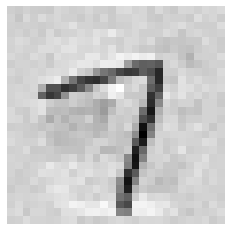

[854] (예측값)6 (실제값)0


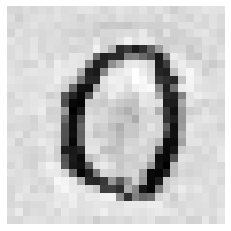

[857] (예측값)9 (실제값)5


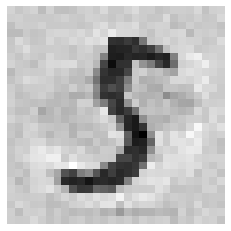

[862] (예측값)4 (실제값)9


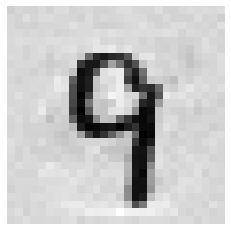

[866] (예측값)8 (실제값)5


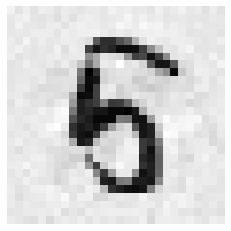

[867] (예측값)9 (실제값)2


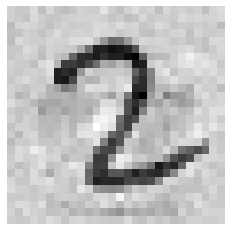

[874] (예측값)4 (실제값)9


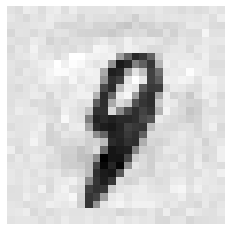

[877] (예측값)0 (실제값)8


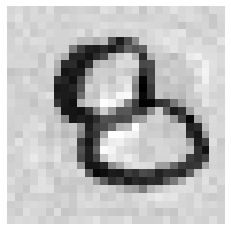

[881] (예측값)5 (실제값)4


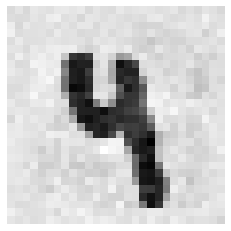

[882] (예측값)8 (실제값)9


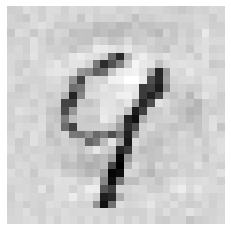

[883] (예측값)7 (실제값)3


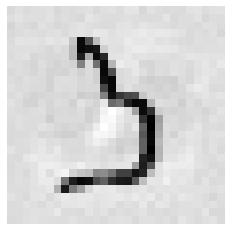

[885] (예측값)4 (실제값)6


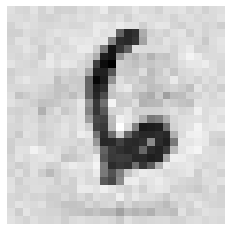

[886] (예측값)0 (실제값)6


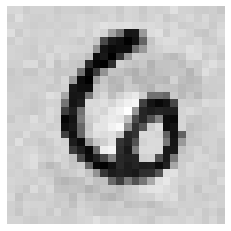

[889] (예측값)4 (실제값)1


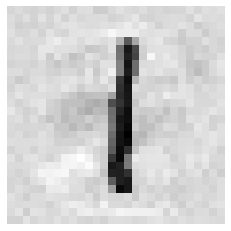

[890] (예측값)5 (실제값)3


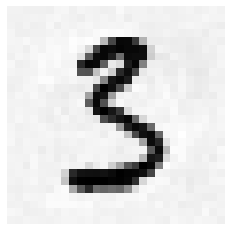

[892] (예측값)7 (실제값)2


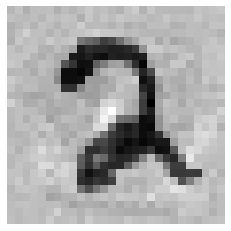

[893] (예측값)8 (실제값)9


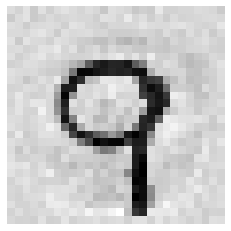

[894] (예측값)8 (실제값)3


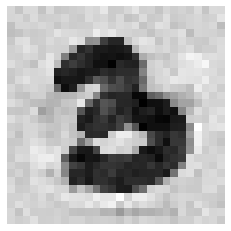

[896] (예측값)5 (실제값)0


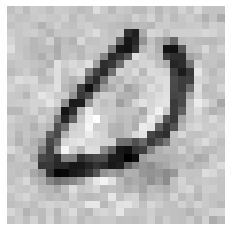

[898] (예측값)3 (실제값)7


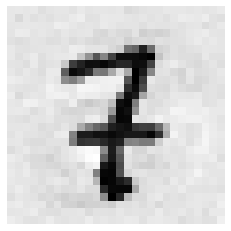

[899] (예측값)4 (실제값)8


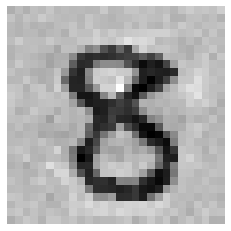

[900] (예측값)5 (실제값)1


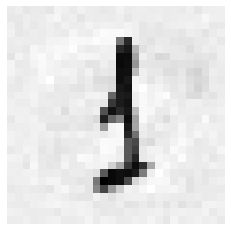

[902] (예측값)7 (실제값)4


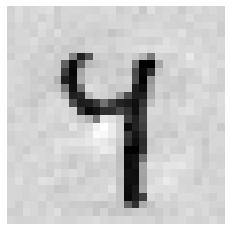

[903] (예측값)8 (실제값)6


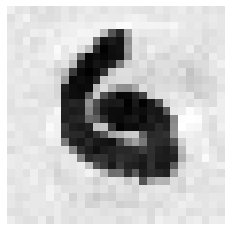

[905] (예측값)0 (실제값)2


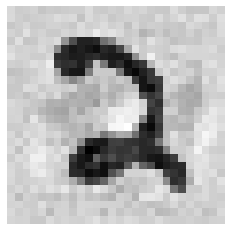

[906] (예측값)3 (실제값)9


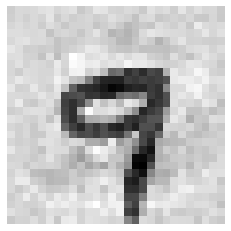

[909] (예측값)4 (실제값)7


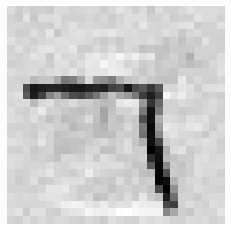

[911] (예측값)8 (실제값)7


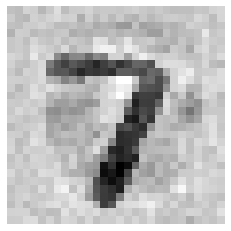

[914] (예측값)9 (실제값)8


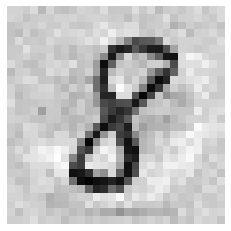

[915] (예측값)0 (실제값)8


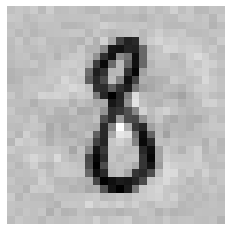

[919] (예측값)7 (실제값)2


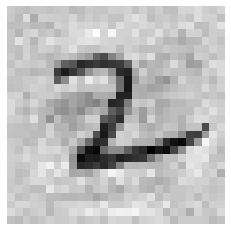

[925] (예측값)0 (실제값)3


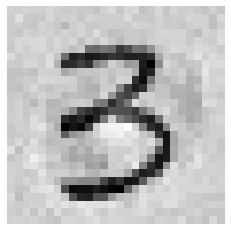

[927] (예측값)2 (실제값)3


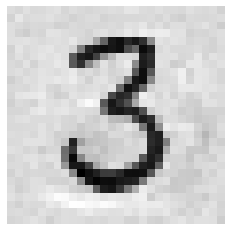

[928] (예측값)3 (실제값)9


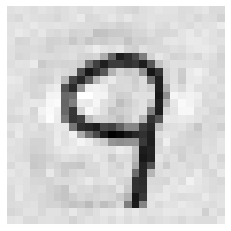

[929] (예측값)4 (실제값)1


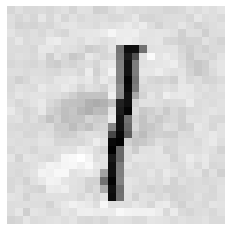

[930] (예측값)5 (실제값)7


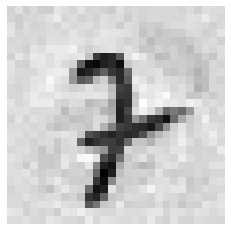

[931] (예측값)6 (실제값)4


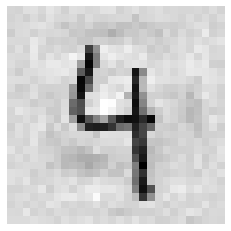

[938] (예측값)8 (실제값)3


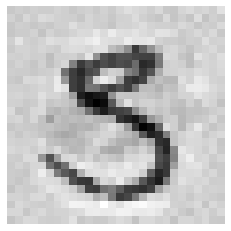

[939] (예측값)5 (실제값)2


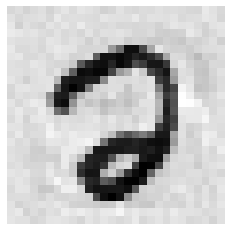

[940] (예측값)4 (실제값)6


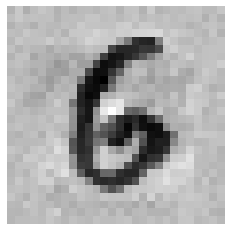

[943] (예측값)0 (실제값)6


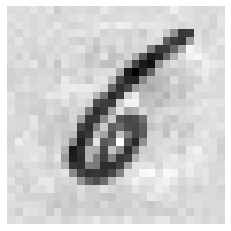

[946] (예측값)4 (실제값)7


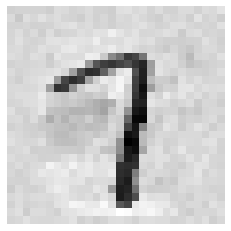

[947] (예측값)9 (실제값)8


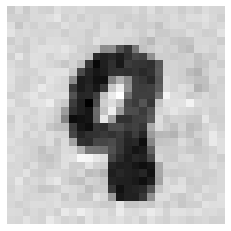

[950] (예측값)8 (실제값)7


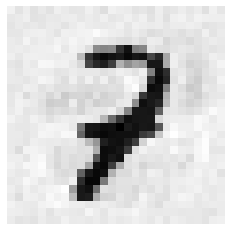

[951] (예측값)9 (실제값)5


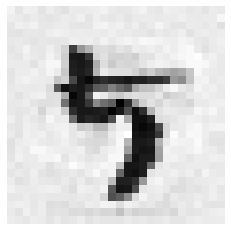

[952] (예측값)0 (실제값)6


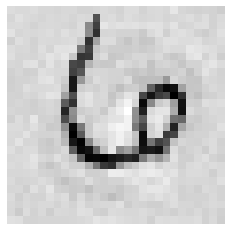

[956] (예측값)3 (실제값)1


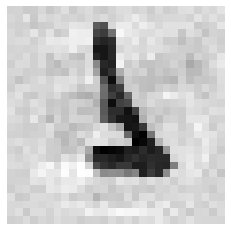

[957] (예측값)5 (실제값)3


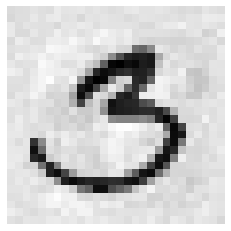

[958] (예측값)6 (실제값)3


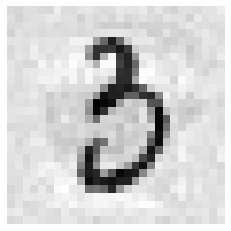

[959] (예측값)9 (실제값)4


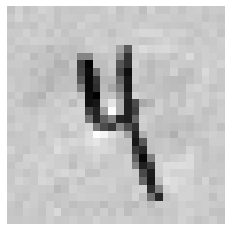

[961] (예측값)9 (실제값)8


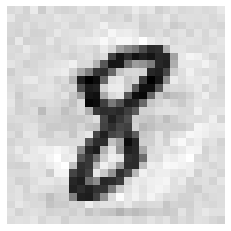

[962] (예측값)7 (실제값)9


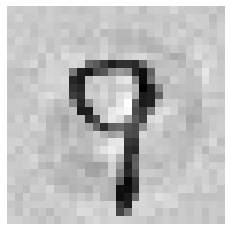

[963] (예측값)2 (실제값)1


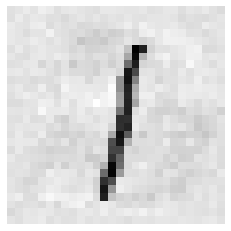

[964] (예측값)3 (실제값)1


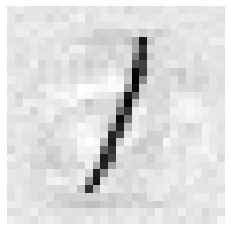

[965] (예측값)0 (실제값)6


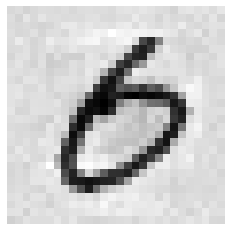

[969] (예측값)8 (실제값)4


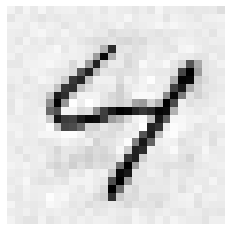

[970] (예측값)9 (실제값)5


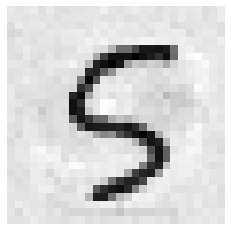

[976] (예측값)5 (실제값)3


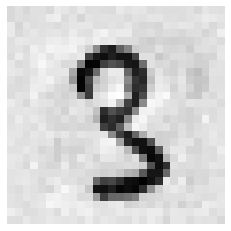

[979] (예측값)8 (실제값)1


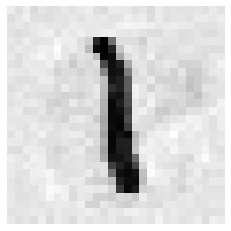

[988] (예측값)7 (실제값)1


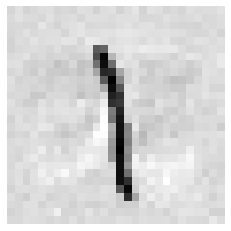

[989] (예측값)5 (실제값)6


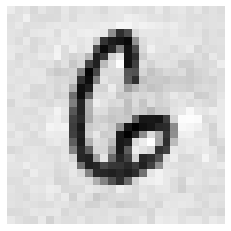

[990] (예측값)9 (실제값)2


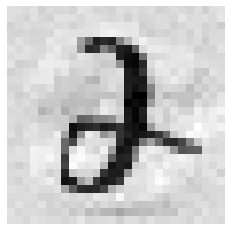

[992] (예측값)4 (실제값)9


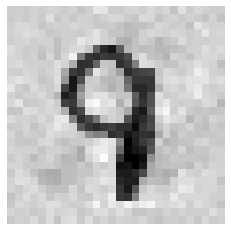

[994] (예측값)3 (실제값)1


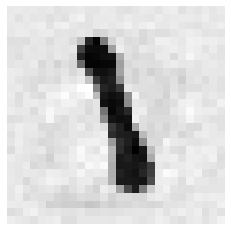

[999] (예측값)4 (실제값)9


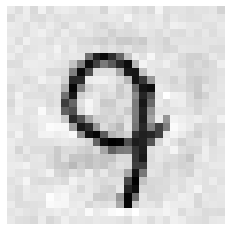

[1002] (예측값)3 (실제값)2


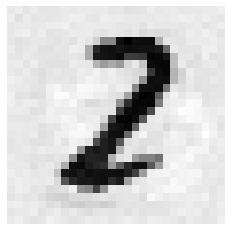

[1003] (예측값)4 (실제값)5


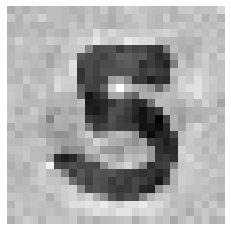

[1004] (예측값)5 (실제값)1


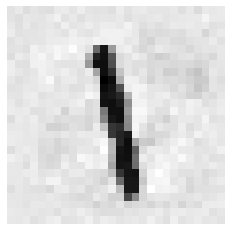

[1005] (예측값)6 (실제값)9


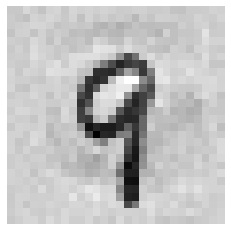

[1006] (예측값)9 (실제값)7


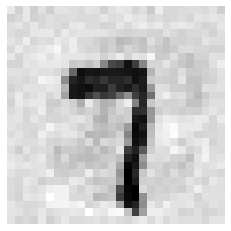

[1007] (예측값)9 (실제값)8


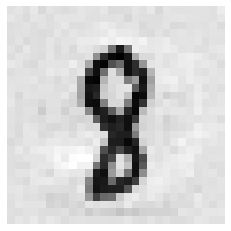

[1009] (예측값)1 (실제값)0


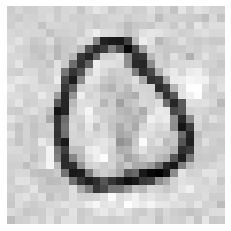

[1012] (예측값)4 (실제값)7


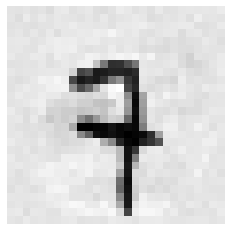

[1014] (예측값)7 (실제값)6


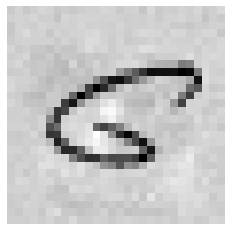

[1015] (예측값)8 (실제값)4


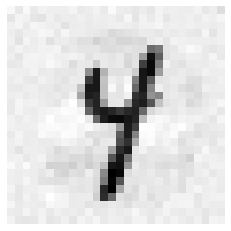

[1021] (예측값)2 (실제값)7


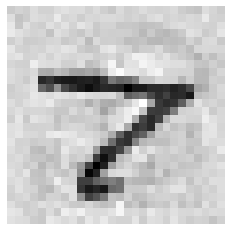

[1024] (예측값)8 (실제값)4


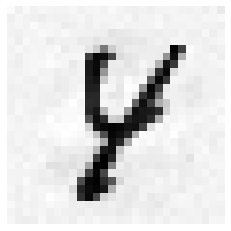

[1025] (예측값)9 (실제값)1


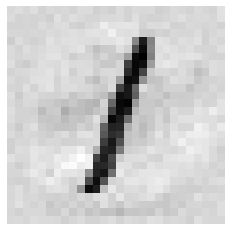

[1028] (예측값)4 (실제값)3


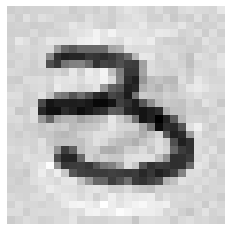

[1029] (예측값)5 (실제값)8


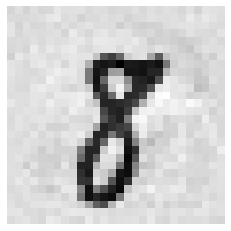

[1031] (예측값)7 (실제값)2


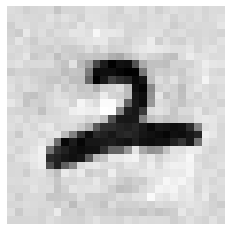

[1032] (예측값)8 (실제값)5


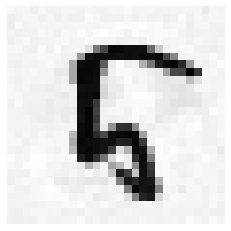

[1033] (예측값)9 (실제값)8


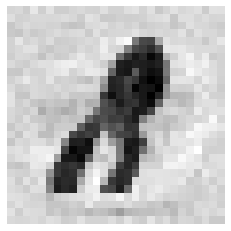

[1038] (예측값)5 (실제값)1


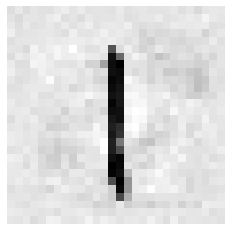

[1039] (예측값)8 (실제값)7


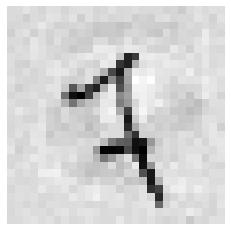

[1041] (예측값)8 (실제값)5


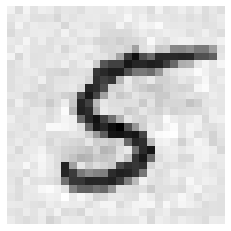

[1044] (예측값)1 (실제값)6


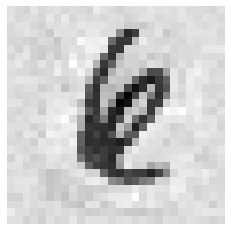

[1046] (예측값)3 (실제값)5


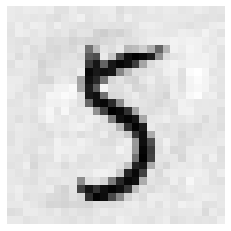

[1048] (예측값)5 (실제값)9


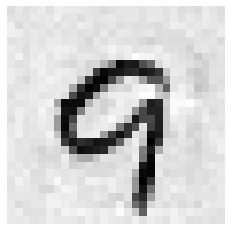

[1050] (예측값)7 (실제값)2


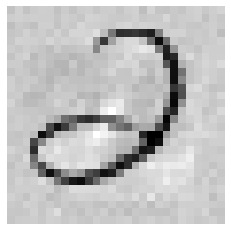

[1052] (예측값)9 (실제값)8


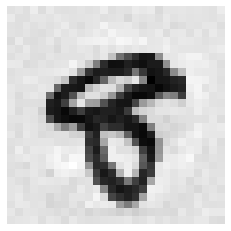

[1054] (예측값)2 (실제값)1


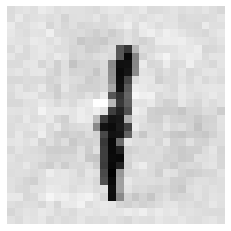

[1055] (예측값)9 (실제값)7


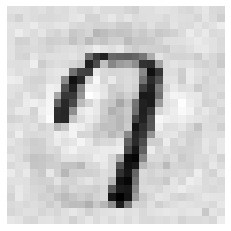

[1062] (예측값)9 (실제값)3


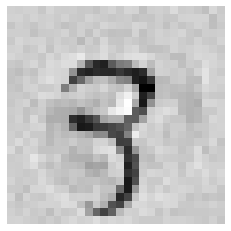

[1064] (예측값)3 (실제값)2


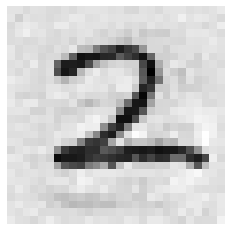

[1066] (예측값)5 (실제값)3


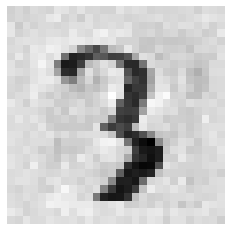

[1067] (예측값)8 (실제값)3


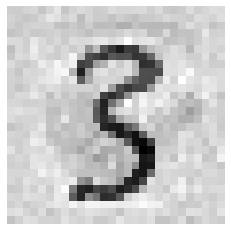

[1072] (예측값)1 (실제값)3


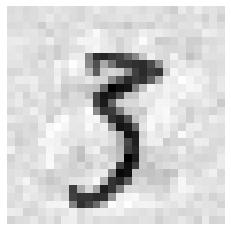

[1074] (예측값)3 (실제값)8


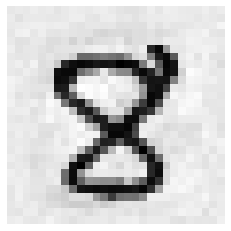

[1075] (예측값)4 (실제값)1


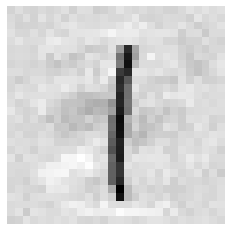

[1079] (예측값)8 (실제값)6


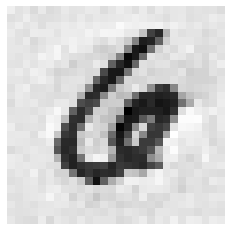

[1080] (예측값)9 (실제값)4


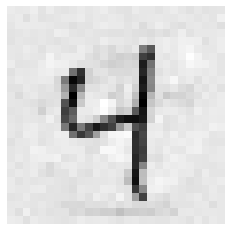

[1081] (예측값)8 (실제값)9


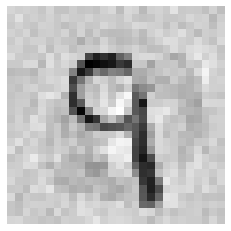

[1082] (예측값)8 (실제값)5


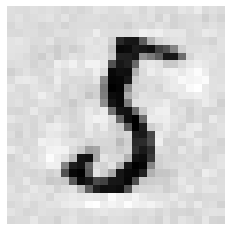

[1083] (예측값)2 (실제값)1


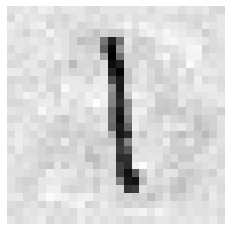

[1085] (예측값)4 (실제값)6


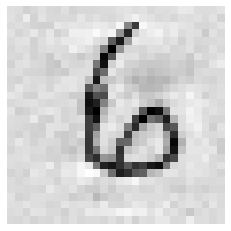

[1087] (예측값)8 (실제값)5


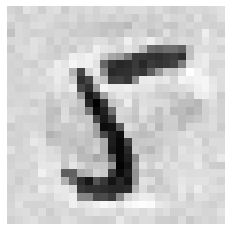

[1088] (예측값)7 (실제값)9


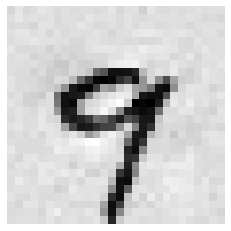

[1089] (예측값)8 (실제값)5


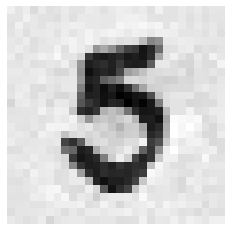

[1092] (예측값)2 (실제값)3


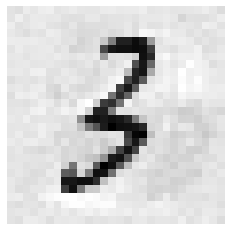

[1096] (예측값)9 (실제값)7


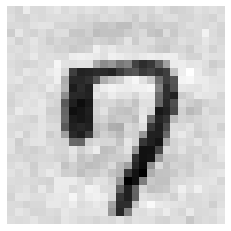

[1098] (예측값)8 (실제값)3


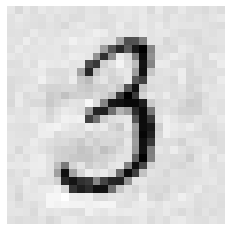

[1099] (예측값)9 (실제값)6


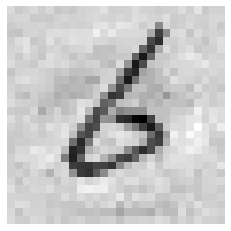

[1103] (예측값)3 (실제값)9


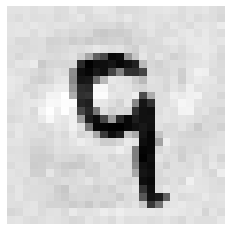

[1104] (예측값)4 (실제값)7


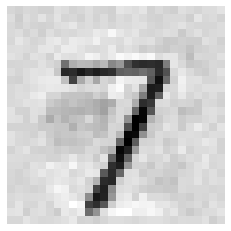

[1105] (예측값)4 (실제값)9


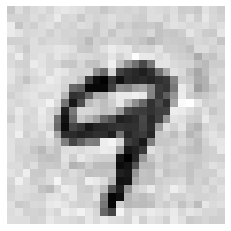

[1107] (예측값)8 (실제값)9


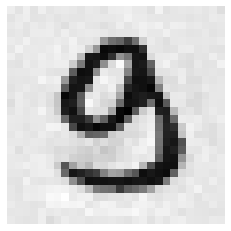

[1108] (예측값)9 (실제값)6


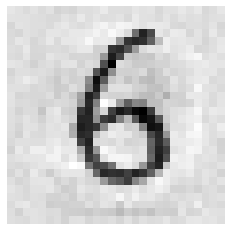

[1112] (예측값)6 (실제값)4


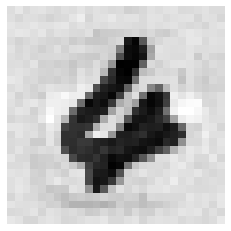

[1114] (예측값)5 (실제값)3


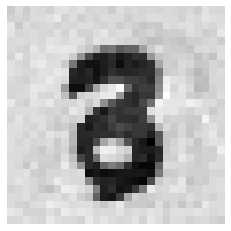

[1122] (예측값)3 (실제값)7


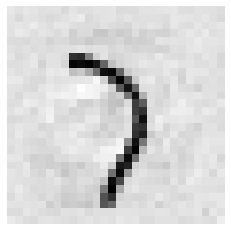

[1124] (예측값)5 (실제값)8


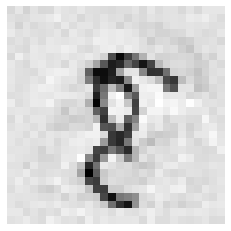

[1126] (예측값)9 (실제값)7


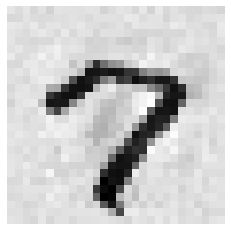

[1127] (예측값)9 (실제값)3


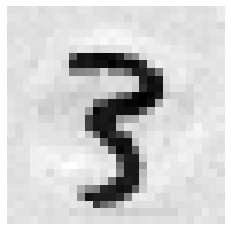

[1128] (예측값)0 (실제값)3


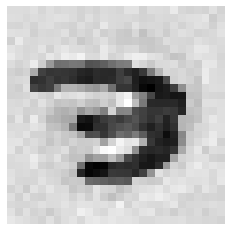

[1133] (예측값)6 (실제값)7


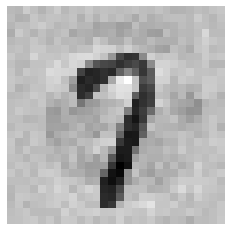

[1136] (예측값)9 (실제값)1


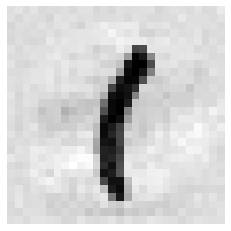

[1138] (예측값)1 (실제값)2


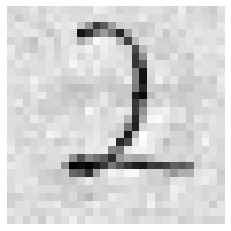

[1140] (예측값)3 (실제값)4


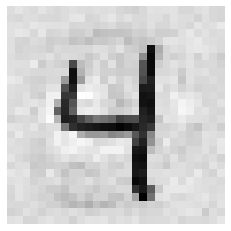

[1143] (예측값)6 (실제값)7


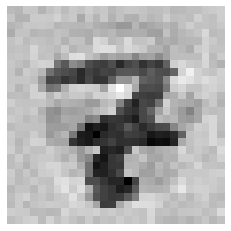

[1145] (예측값)8 (실제값)4


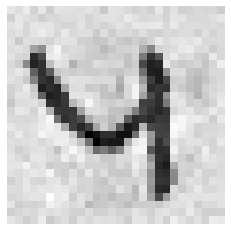

[1146] (예측값)9 (실제값)5


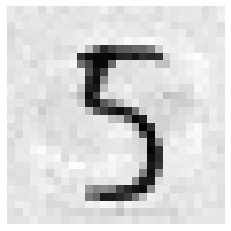

[1148] (예측값)6 (실제값)0


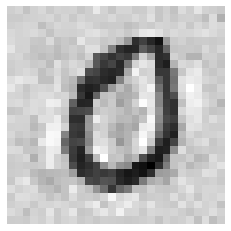

[1151] (예측값)5 (실제값)6


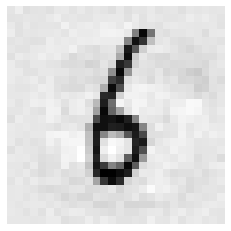

[1153] (예측값)0 (실제값)6


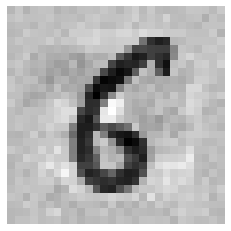

[1155] (예측값)9 (실제값)2


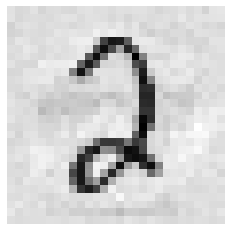

[1156] (예측값)8 (실제값)7


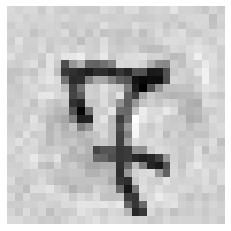

[1157] (예측값)1 (실제값)4


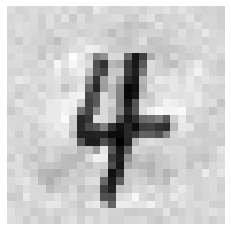

[1159] (예측값)8 (실제값)4


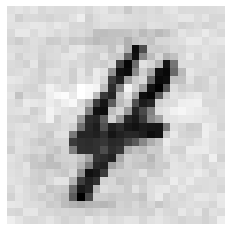

[1163] (예측값)9 (실제값)4


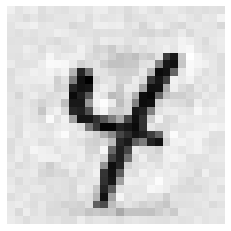

[1165] (예측값)1 (실제값)9


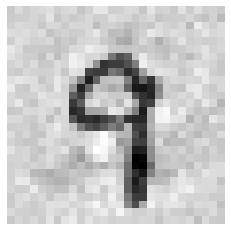

[1166] (예측값)2 (실제값)3


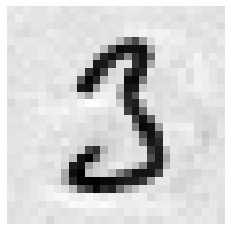

[1169] (예측값)6 (실제값)5


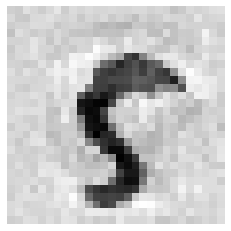

[1171] (예측값)8 (실제값)7


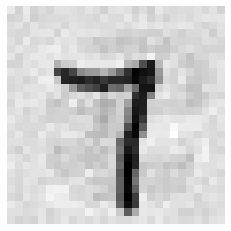

[1173] (예측값)0 (실제값)7


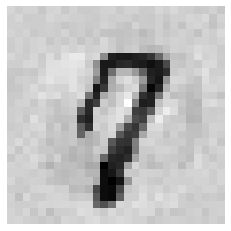

[1176] (예측값)3 (실제값)0


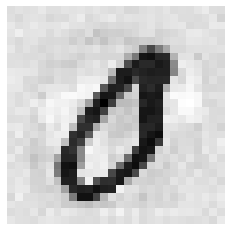

[1178] (예측값)5 (실제값)4


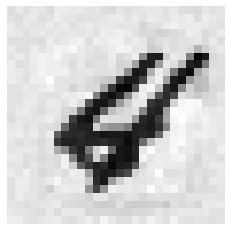

[1181] (예측값)8 (실제값)6


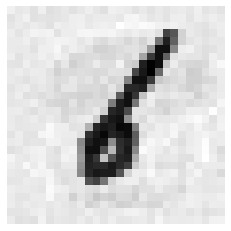

[1182] (예측값)9 (실제값)6


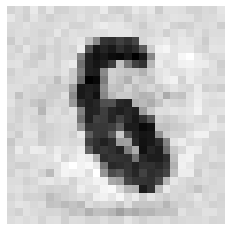

[1184] (예측값)1 (실제값)2


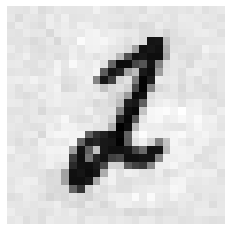

[1186] (예측값)5 (실제값)7


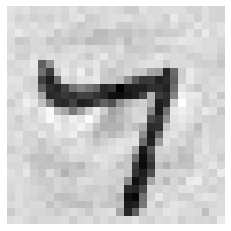

[1188] (예측값)5 (실제값)0


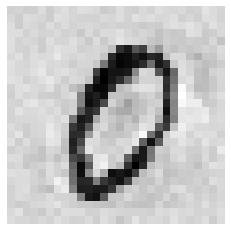

[1191] (예측값)9 (실제값)0


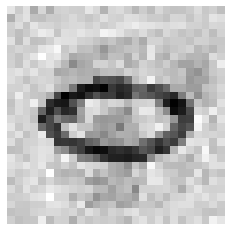

[1194] (예측값)9 (실제값)7


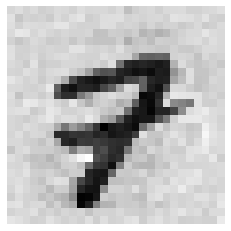

[1198] (예측값)4 (실제값)8


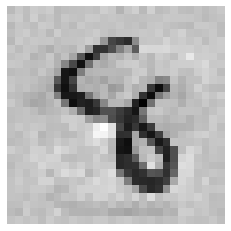

[1200] (예측값)9 (실제값)8


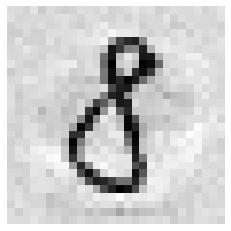

[1208] (예측값)8 (실제값)3


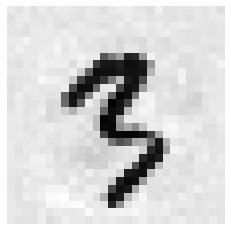

[1209] (예측값)8 (실제값)6


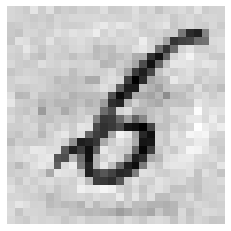

[1212] (예측값)8 (실제값)6


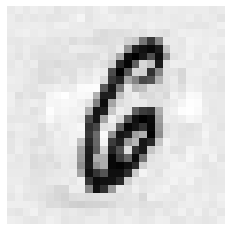

[1213] (예측값)4 (실제값)1


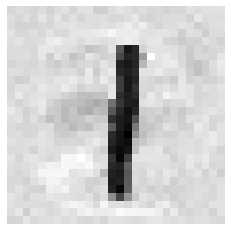

[1215] (예측값)6 (실제값)3


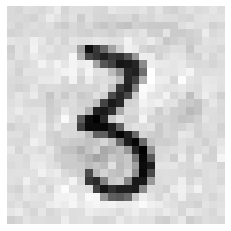

[1216] (예측값)8 (실제값)7


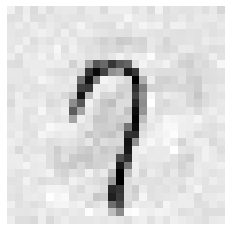

[1218] (예측값)1 (실제값)0


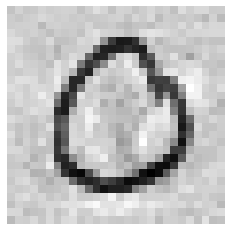

[1221] (예측값)4 (실제값)5


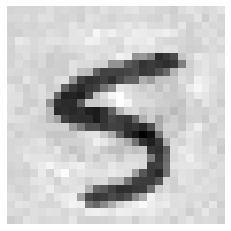

[1223] (예측값)6 (실제값)0


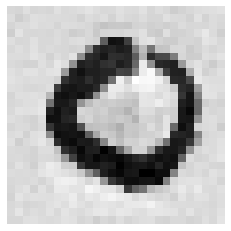

[1226] (예측값)0 (실제값)7


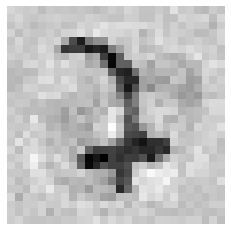

[1229] (예측값)3 (실제값)8


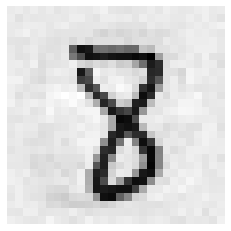

[1232] (예측값)7 (실제값)9


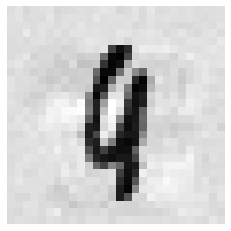

[1233] (예측값)8 (실제값)5


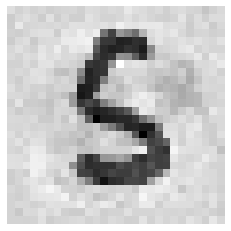

[1234] (예측값)9 (실제값)8


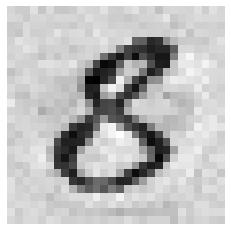

[1237] (예측값)3 (실제값)2


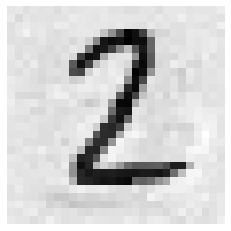

[1238] (예측값)4 (실제값)1


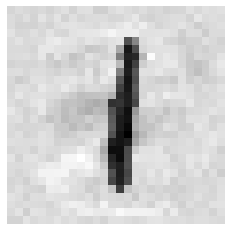

[1239] (예측값)5 (실제값)3


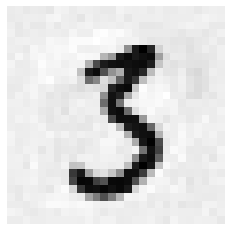

[1240] (예측값)6 (실제값)1


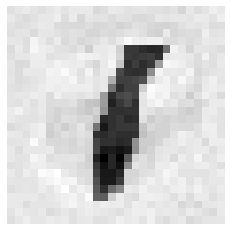

[1241] (예측값)8 (실제값)7


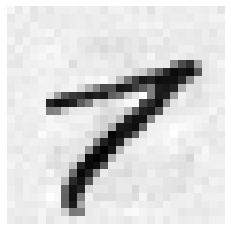

[1242] (예측값)9 (실제값)4


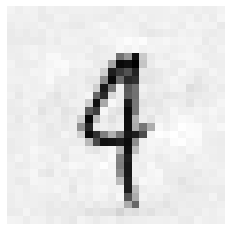

[1247] (예측값)5 (실제값)9


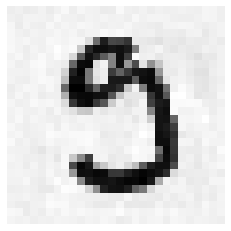

[1248] (예측값)6 (실제값)8


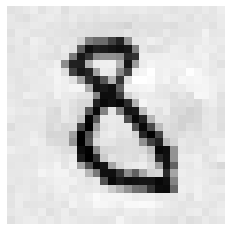

[1250] (예측값)8 (실제값)6


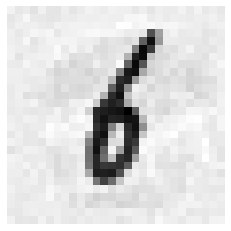

[1251] (예측값)3 (실제값)2


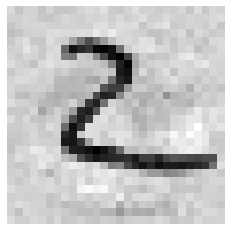

[1256] (예측값)4 (실제값)2


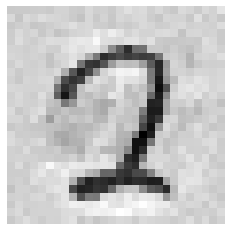

[1258] (예측값)6 (실제값)5


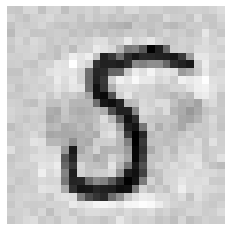

[1260] (예측값)8 (실제값)7


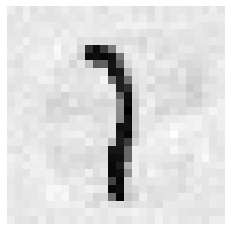

[1262] (예측값)0 (실제값)2


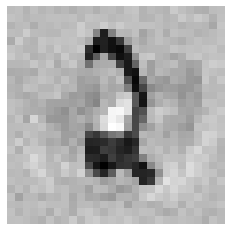

[1266] (예측값)4 (실제값)6


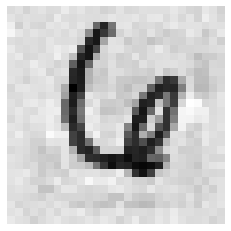

[1270] (예측값)9 (실제값)4


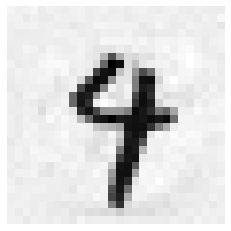

[1275] (예측값)5 (실제값)4


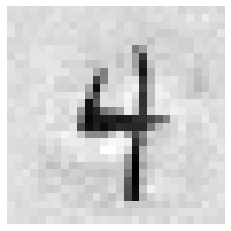

[1278] (예측값)8 (실제값)3


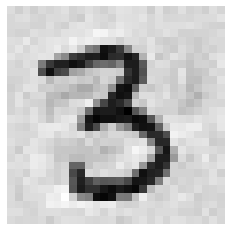

[1279] (예측값)9 (실제값)4


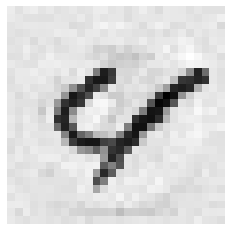

[1280] (예측값)0 (실제값)1


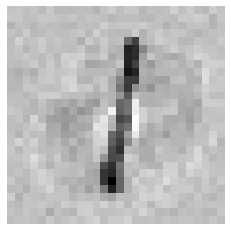

[1283] (예측값)3 (실제값)7


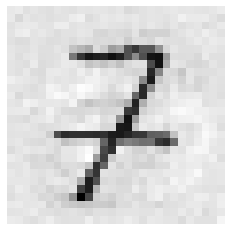

[1285] (예측값)6 (실제값)5


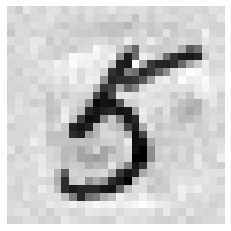

[1287] (예측값)9 (실제값)8


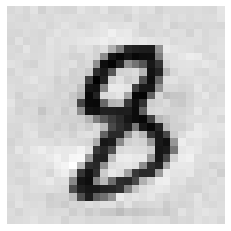

[1289] (예측값)1 (실제값)5


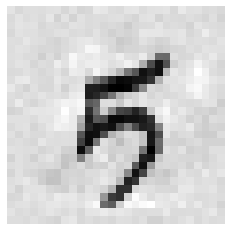

[1290] (예측값)2 (실제값)3


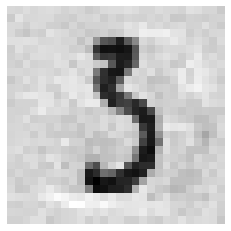

[1291] (예측값)4 (실제값)3


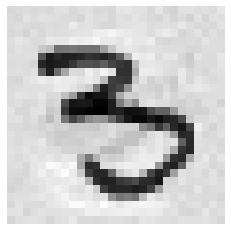

[1295] (예측값)9 (실제값)1


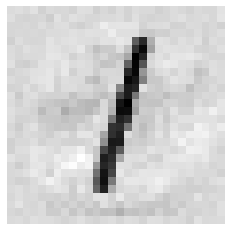

[1296] (예측값)0 (실제값)6


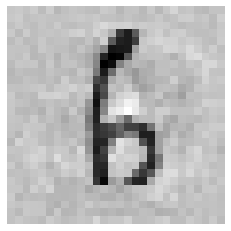

[1298] (예측값)2 (실제값)3


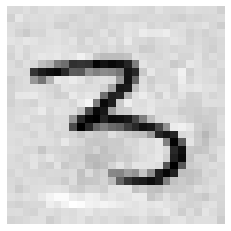

[1299] (예측값)3 (실제값)5


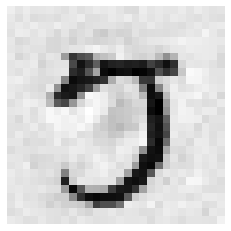

[1303] (예측값)8 (실제값)2


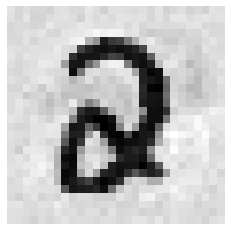

[1305] (예측값)2 (실제값)1


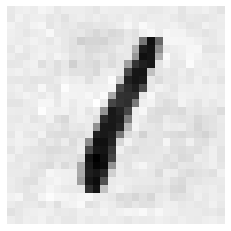

[1307] (예측값)4 (실제값)6


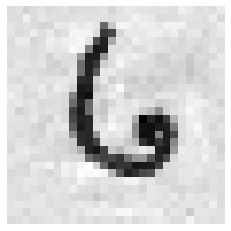

[1308] (예측값)5 (실제값)9


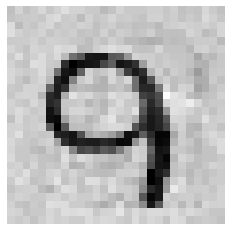

[1310] (예측값)7 (실제값)3


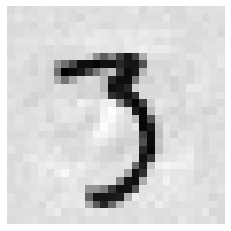

[1311] (예측값)8 (실제값)9


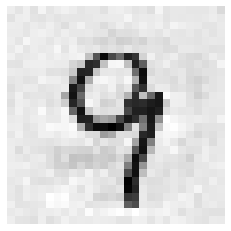

[1312] (예측값)9 (실제값)8


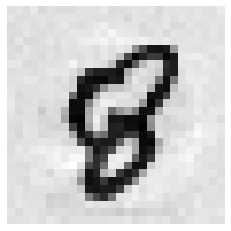

[1319] (예측값)6 (실제값)8


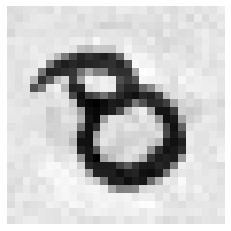

[1320] (예측값)7 (실제값)8


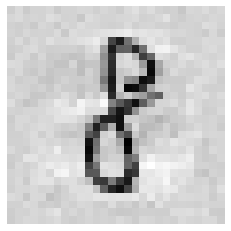

[1321] (예측값)9 (실제값)7


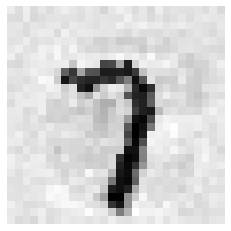

[1322] (예측값)2 (실제값)9


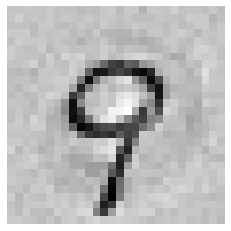

[1324] (예측값)2 (실제값)8


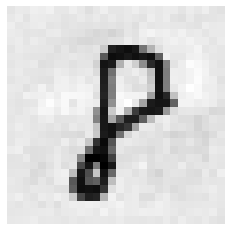

[1326] (예측값)2 (실제값)7


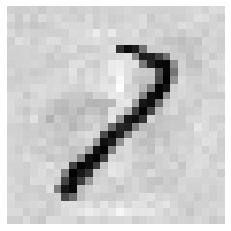

[1327] (예측값)5 (실제값)9


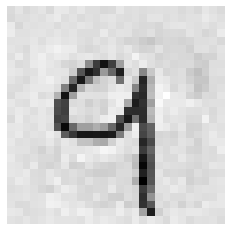

[1328] (예측값)6 (실제값)7


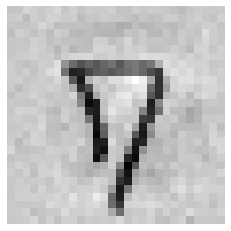

[1330] (예측값)8 (실제값)4


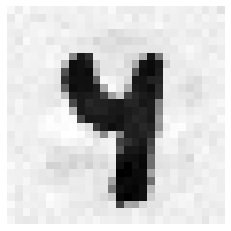

[1331] (예측값)3 (실제값)5


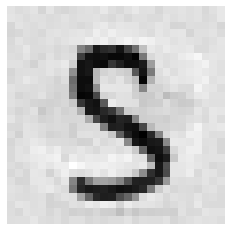

[1337] (예측값)6 (실제값)2


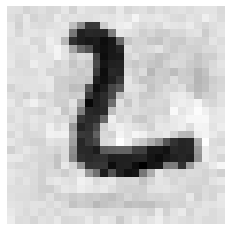

[1340] (예측값)8 (실제값)5


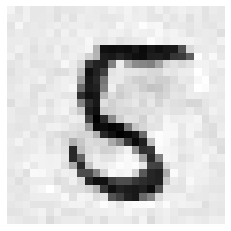

[1347] (예측값)5 (실제값)7


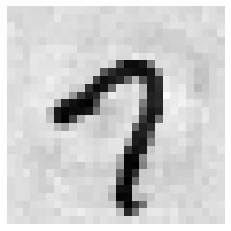

[1348] (예측값)6 (실제값)2


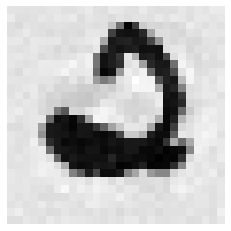

[1350] (예측값)8 (실제값)1


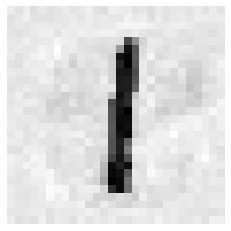

[1351] (예측값)9 (실제값)1


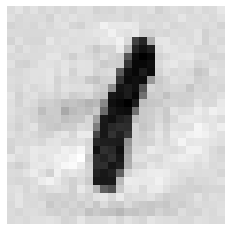

[1352] (예측값)0 (실제값)2


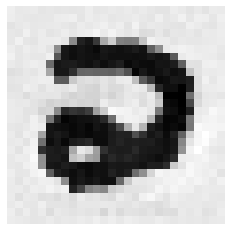

[1354] (예측값)2 (실제값)3


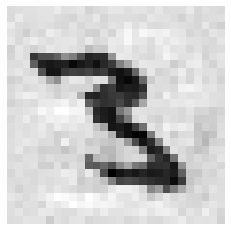

[1356] (예측값)8 (실제값)2


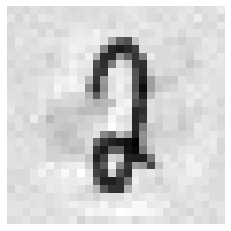

[1357] (예측값)5 (실제값)4


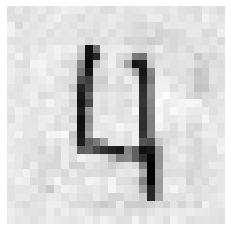

[1359] (예측값)8 (실제값)7


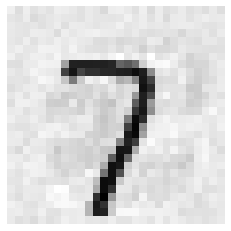

[1360] (예측값)9 (실제값)1


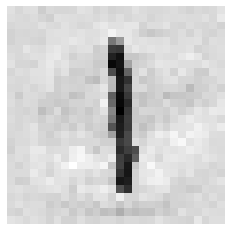

[1363] (예측값)2 (실제값)7


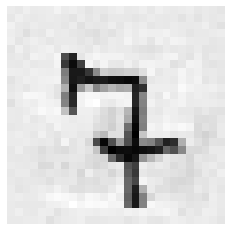

[1364] (예측값)3 (실제값)8


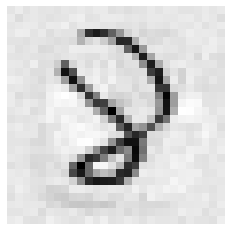

[1366] (예측값)5 (실제값)7


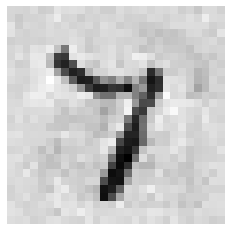

[1374] (예측값)3 (실제값)2


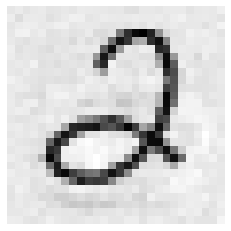

[1375] (예측값)1 (실제값)2


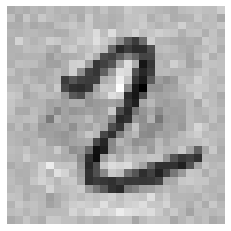

[1377] (예측값)9 (실제값)6


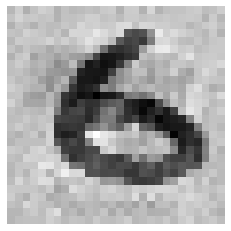

[1378] (예측값)8 (실제값)5


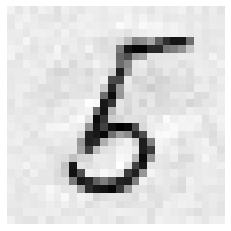

[1379] (예측값)9 (실제값)0


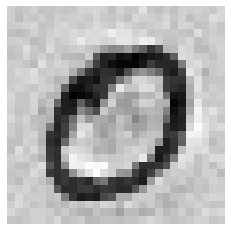

[1384] (예측값)5 (실제값)3


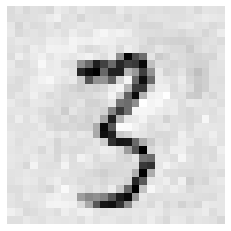

[1385] (예측값)6 (실제값)9


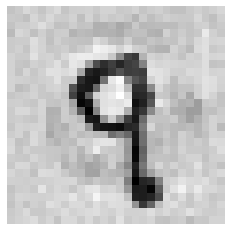

[1386] (예측값)8 (실제값)7


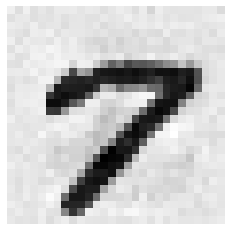

[1387] (예측값)9 (실제값)6


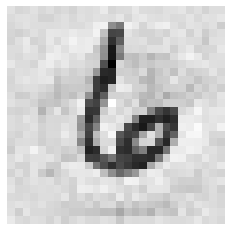

[1391] (예측값)3 (실제값)4


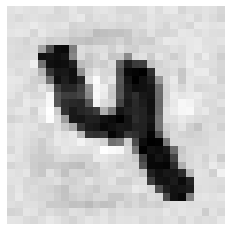

[1392] (예측값)4 (실제값)1


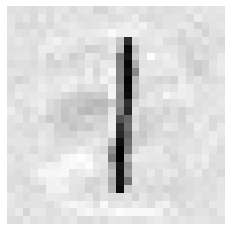

[1393] (예측값)6 (실제값)5


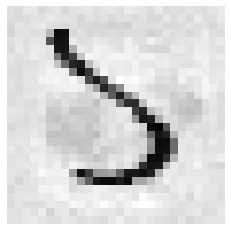

[1395] (예측값)8 (실제값)2


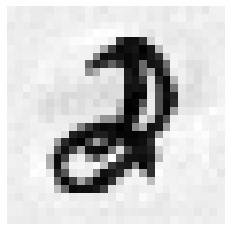

[1398] (예측값)3 (실제값)8


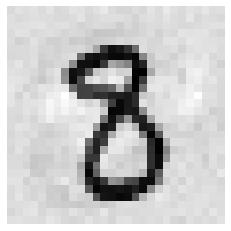

[1399] (예측값)4 (실제값)0


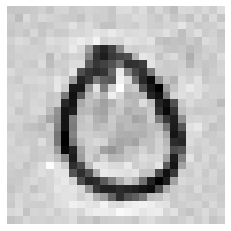

[1401] (예측값)9 (실제값)7


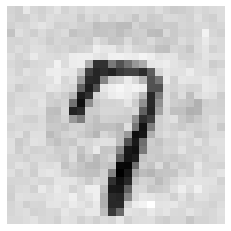

[1402] (예측값)7 (실제값)2


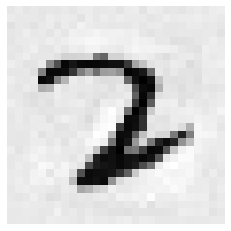

[1403] (예측값)8 (실제값)1


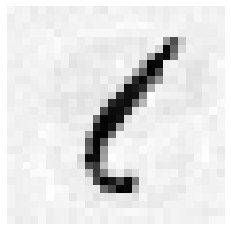

[1404] (예측값)9 (실제값)0


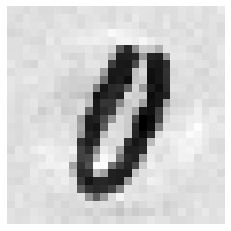

[1409] (예측값)5 (실제값)2


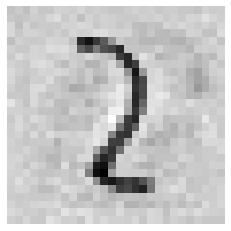

[1410] (예측값)6 (실제값)2


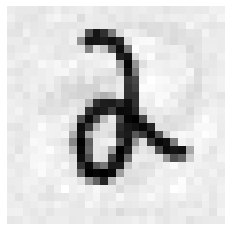

[1411] (예측값)7 (실제값)0


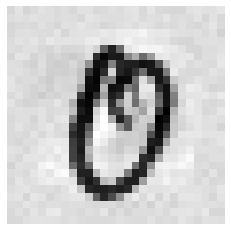

[1413] (예측값)9 (실제값)4


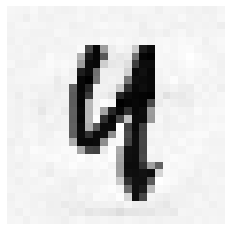

[1414] (예측값)0 (실제값)9


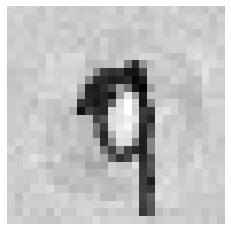

[1418] (예측값)4 (실제값)9


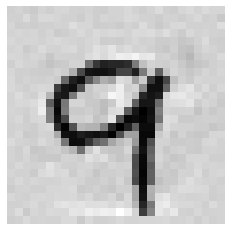

[1422] (예측값)9 (실제값)4


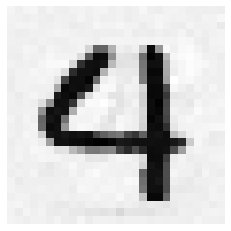

[1426] (예측값)4 (실제값)3


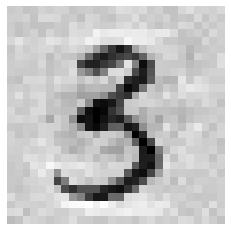

[1430] (예측값)8 (실제값)1


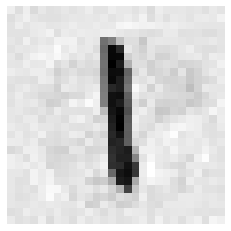

[1433] (예측값)1 (실제값)8


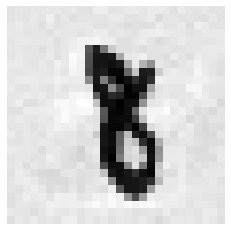

[1434] (예측값)8 (실제값)1


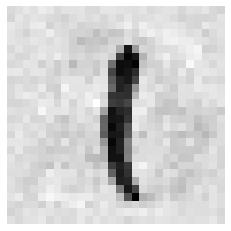

[1437] (예측값)5 (실제값)4


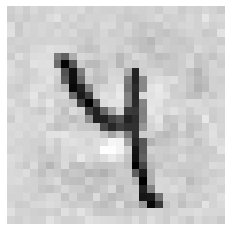

[1438] (예측값)6 (실제값)0


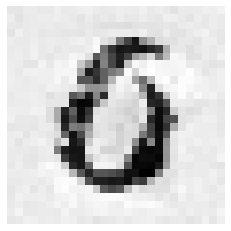

[1440] (예측값)8 (실제값)4


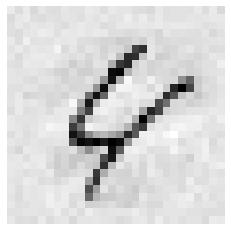

[1441] (예측값)9 (실제값)8


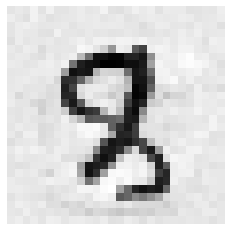

[1447] (예측값)6 (실제값)5


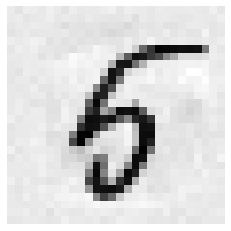

[1448] (예측값)7 (실제값)1


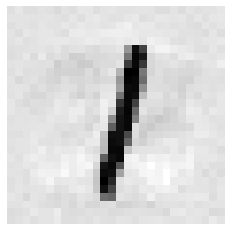

[1449] (예측값)8 (실제값)9


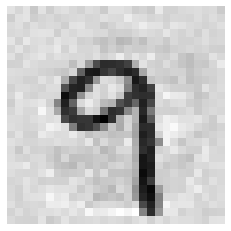

[1455] (예측값)4 (실제값)9


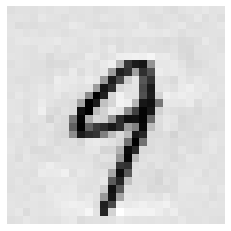

[1463] (예측값)7 (실제값)3


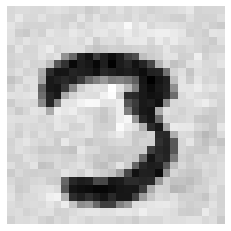

[1465] (예측값)5 (실제값)4


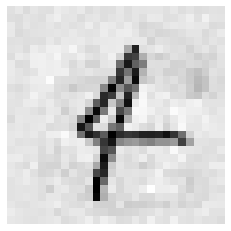

[1467] (예측값)7 (실제값)5


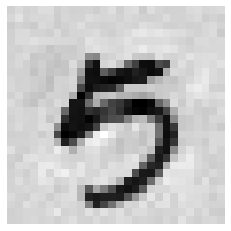

[1468] (예측값)5 (실제값)0


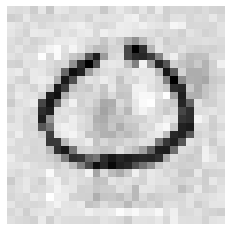

[1469] (예측값)9 (실제값)3


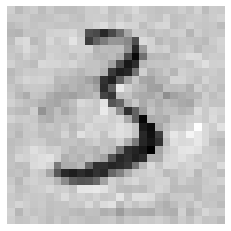

[1470] (예측값)0 (실제값)8


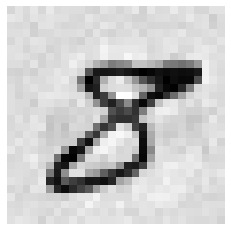

[1474] (예측값)2 (실제값)8


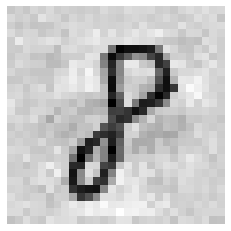

[1475] (예측값)5 (실제값)6


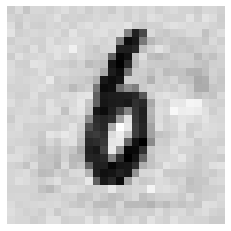

[1476] (예측값)6 (실제값)5


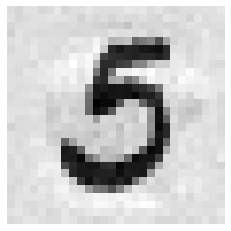

[1477] (예측값)8 (실제값)7


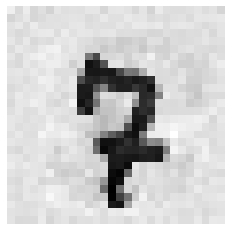

[1478] (예측값)8 (실제값)6


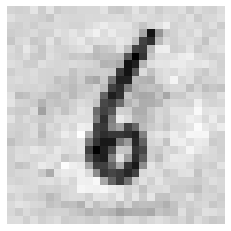

[1483] (예측값)4 (실제값)1


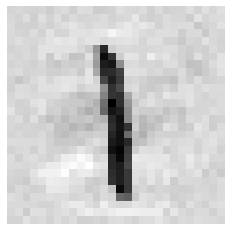

[1485] (예측값)6 (실제값)2


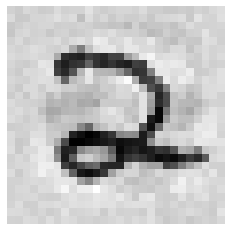

[1488] (예측값)9 (실제값)4


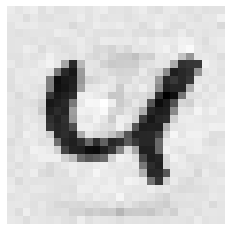

[1489] (예측값)8 (실제값)3


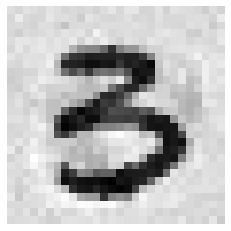

[1492] (예측값)3 (실제값)9


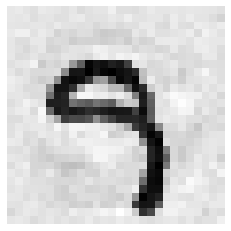

[1493] (예측값)4 (실제값)5


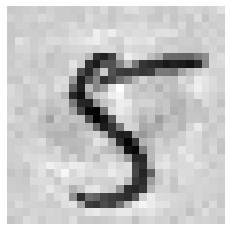

[1494] (예측값)5 (실제값)7


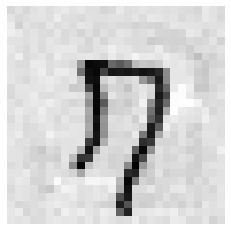

[1496] (예측값)8 (실제값)7


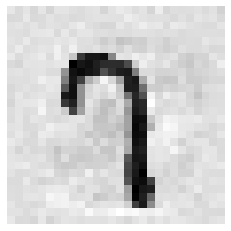

[1500] (예측값)2 (실제값)7


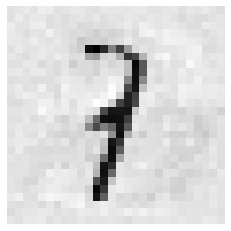

[1502] (예측값)4 (실제값)8


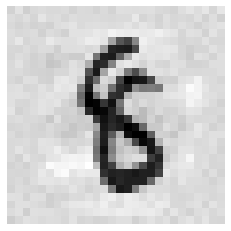

[1503] (예측값)5 (실제값)3


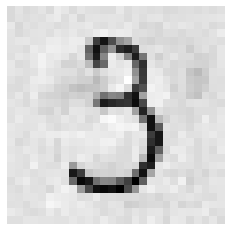

[1504] (예측값)6 (실제값)0


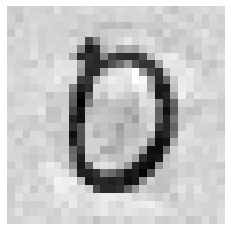

[1505] (예측값)8 (실제값)7


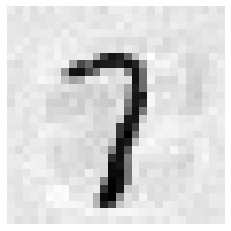

[1507] (예측값)0 (실제값)7


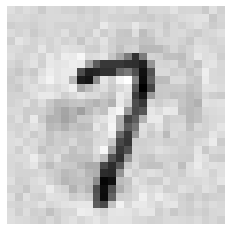

[1509] (예측값)2 (실제값)4


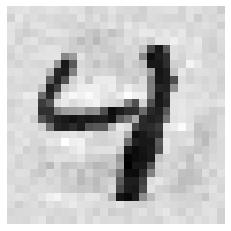

[1512] (예측값)8 (실제값)9


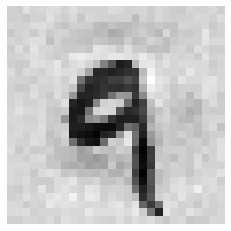

[1514] (예측값)8 (실제값)2


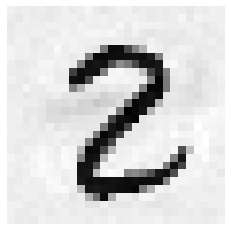

[1518] (예측값)3 (실제값)2


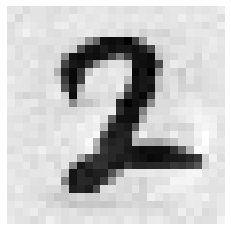

[1520] (예측값)5 (실제값)7


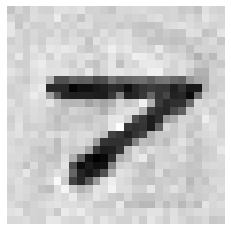

[1522] (예측값)8 (실제값)7


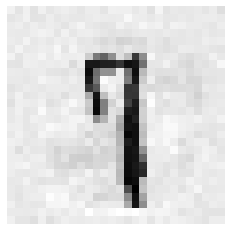

[1527] (예측값)3 (실제값)1


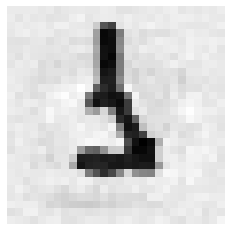

[1530] (예측값)7 (실제값)8


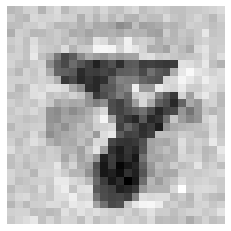

[1532] (예측값)8 (실제값)9


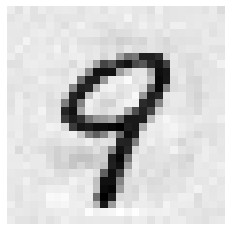

[1533] (예측값)9 (실제값)0


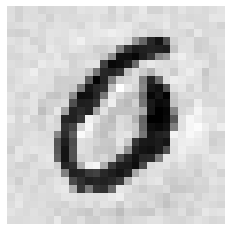

[1541] (예측값)9 (실제값)8


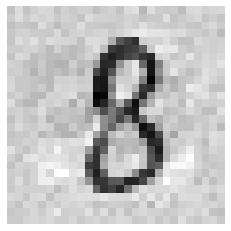

[1545] (예측값)8 (실제값)9


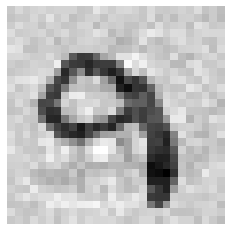

[1546] (예측값)3 (실제값)2


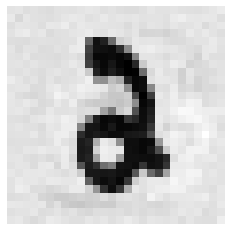

[1549] (예측값)7 (실제값)4


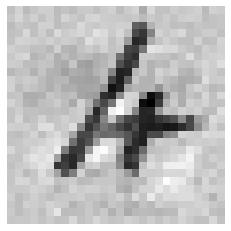

[1553] (예측값)3 (실제값)9


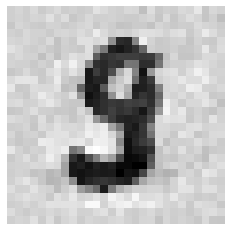

[1554] (예측값)8 (실제값)9


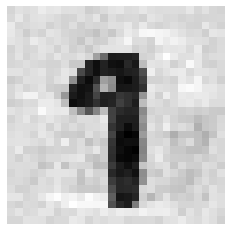

[1555] (예측값)3 (실제값)1


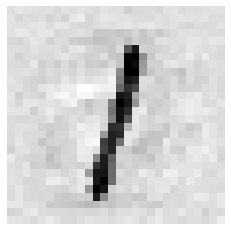

[1556] (예측값)9 (실제값)8


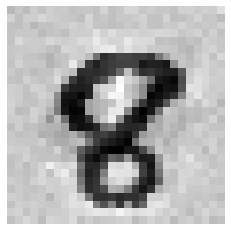

[1558] (예측값)6 (실제값)0


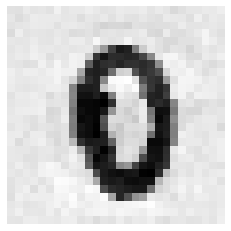

[1559] (예측값)7 (실제값)9


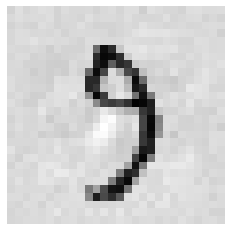

[1560] (예측값)9 (실제값)8


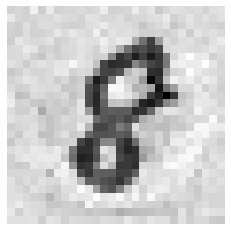

[1561] (예측값)0 (실제값)4


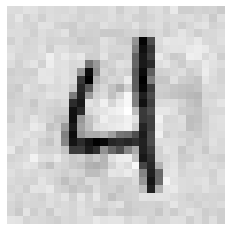

[1564] (예측값)3 (실제값)7


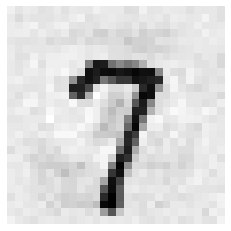

[1565] (예측값)4 (실제값)0


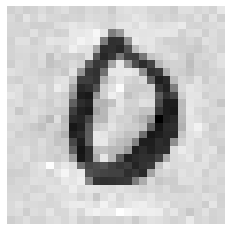

[1566] (예측값)5 (실제값)7


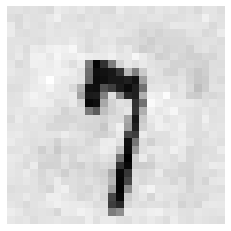

[1568] (예측값)7 (실제값)8


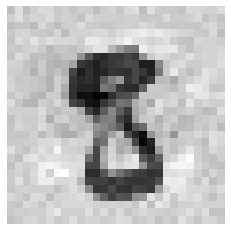

[1569] (예측값)8 (실제값)6


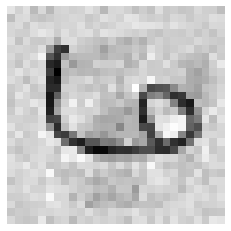

[1570] (예측값)6 (실제값)0


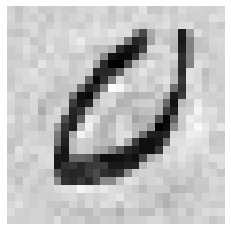

[1571] (예측값)0 (실제값)4


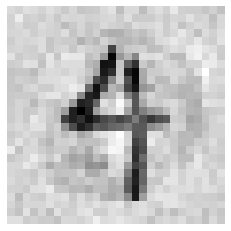

[1573] (예측값)2 (실제값)8


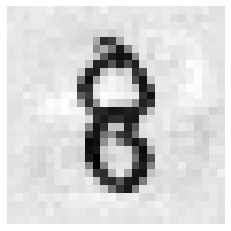

[1579] (예측값)9 (실제값)6


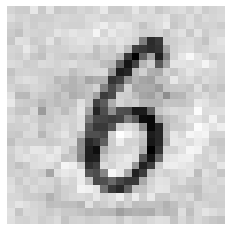

[1582] (예측값)2 (실제값)1


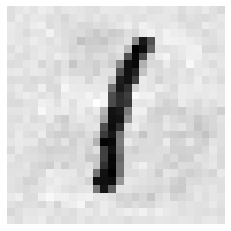

[1583] (예측값)3 (실제값)8


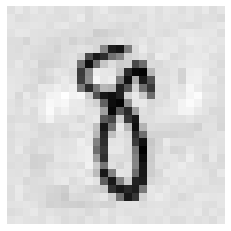

[1584] (예측값)4 (실제값)8


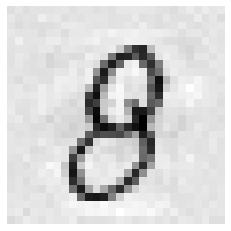

[1586] (예측값)7 (실제값)3


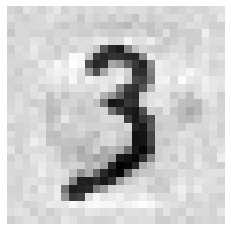

[1587] (예측값)7 (실제값)6


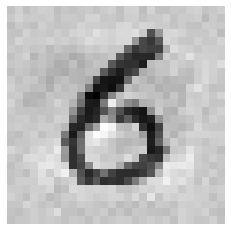

[1588] (예측값)8 (실제값)3


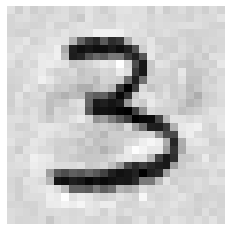

[1594] (예측값)4 (실제값)9


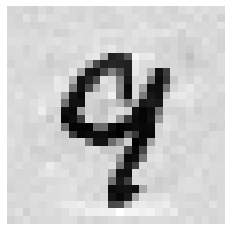

[1596] (예측값)6 (실제값)9


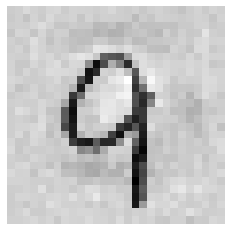

[1597] (예측값)7 (실제값)9


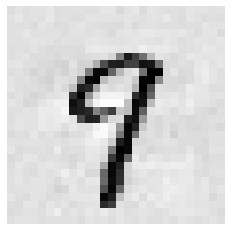

[1598] (예측값)8 (실제값)5


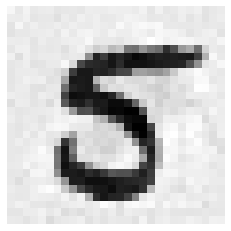

[1599] (예측값)9 (실제값)4


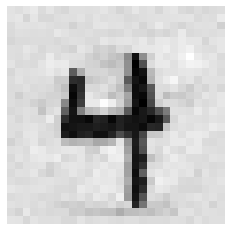

[1607] (예측값)7 (실제값)3


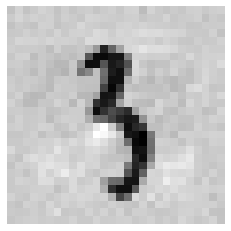

[1608] (예측값)8 (실제값)3


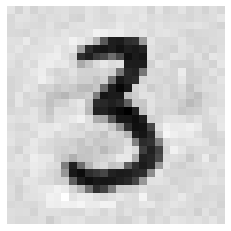

[1609] (예측값)4 (실제값)2


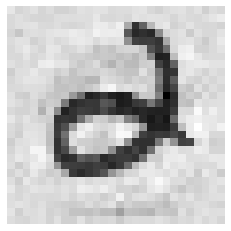

[1611] (예측값)1 (실제값)3


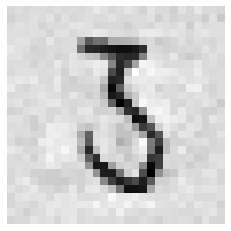

[1614] (예측값)9 (실제값)4


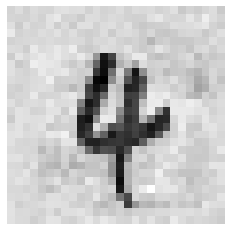

[1617] (예측값)8 (실제값)3


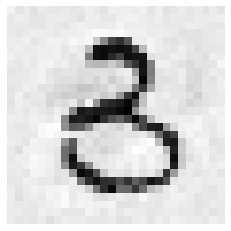

[1618] (예측값)9 (실제값)5


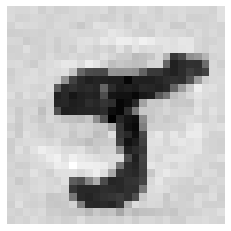

[1621] (예측값)6 (실제값)0


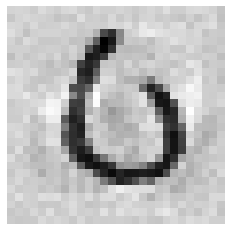

[1626] (예측값)7 (실제값)6


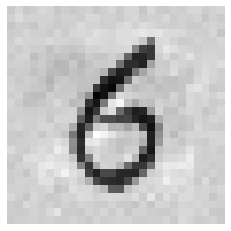

[1628] (예측값)9 (실제값)3


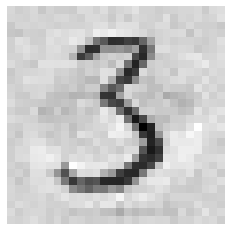

[1630] (예측값)2 (실제값)1


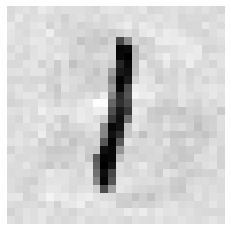

[1637] (예측값)9 (실제값)5


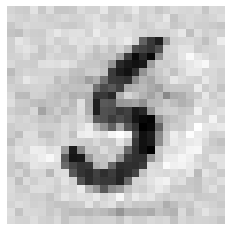

[1640] (예측값)4 (실제값)9


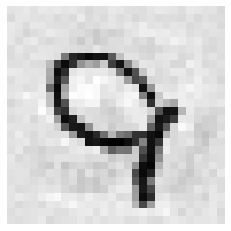

[1642] (예측값)4 (실제값)2


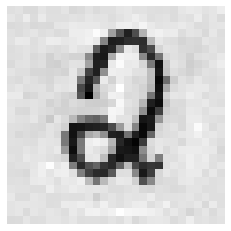

[1645] (예측값)7 (실제값)9


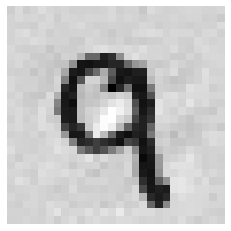

[1651] (예측값)4 (실제값)8


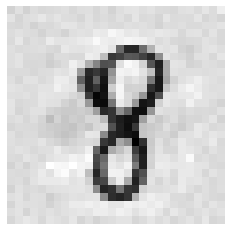

[1654] (예측값)3 (실제값)2


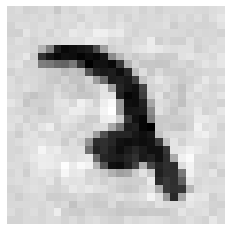

[1655] (예측값)8 (실제값)9


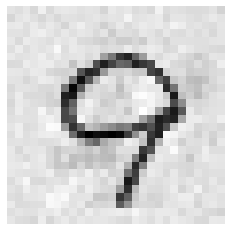

[1657] (예측값)8 (실제값)1


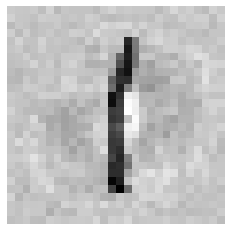

[1658] (예측값)1 (실제값)2


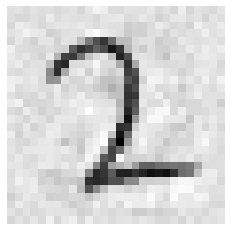

[1660] (예측값)3 (실제값)7


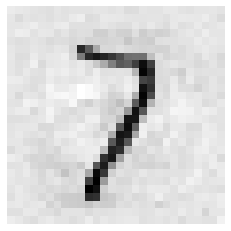

[1664] (예측값)9 (실제값)8


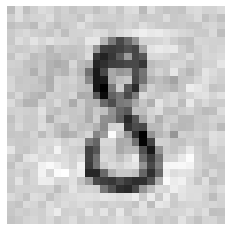

[1665] (예측값)8 (실제값)4


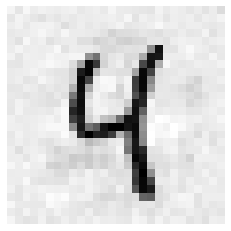

[1667] (예측값)8 (실제값)1


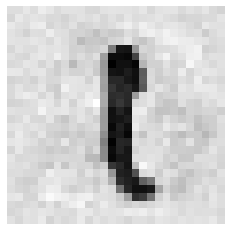

[1668] (예측값)3 (실제값)9


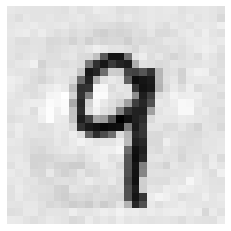

[1670] (예측값)8 (실제값)5


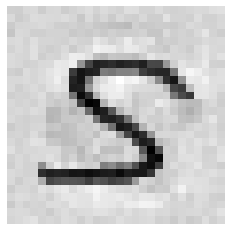

[1671] (예측값)3 (실제값)7


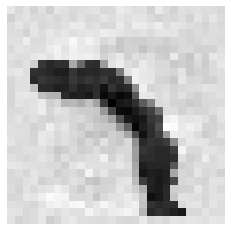

[1674] (예측값)2 (실제값)1


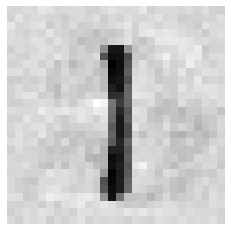

[1676] (예측값)4 (실제값)6


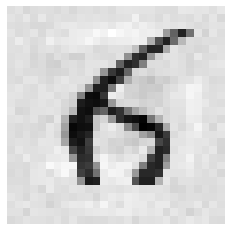

[1678] (예측값)7 (실제값)2


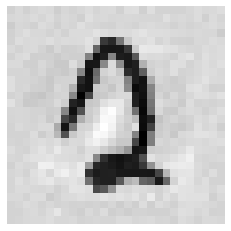

[1680] (예측값)9 (실제값)4


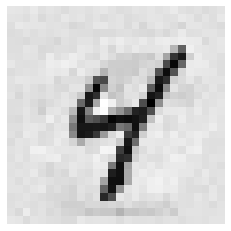

[1681] (예측값)7 (실제값)3


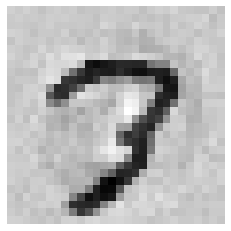

[1684] (예측값)3 (실제값)5


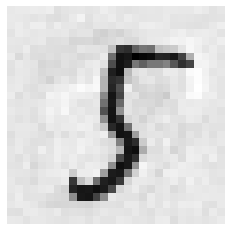

[1686] (예측값)5 (실제값)8


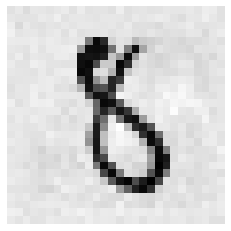

[1689] (예측값)8 (실제값)2


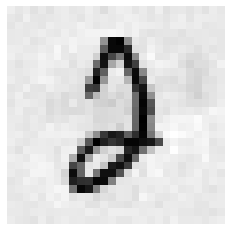

[1690] (예측값)9 (실제값)3


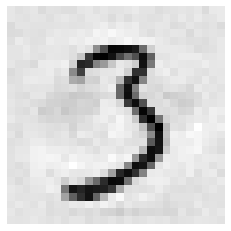

[1691] (예측값)3 (실제값)1


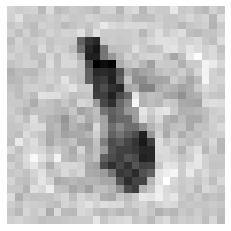

[1694] (예측값)3 (실제값)8


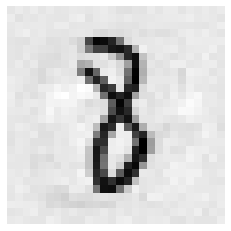

[1696] (예측값)5 (실제값)2


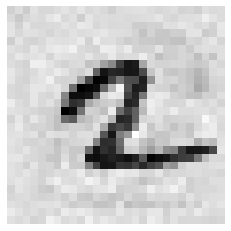

[1697] (예측값)6 (실제값)9


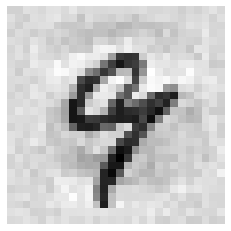

[1700] (예측값)9 (실제값)0


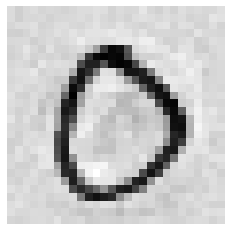

[1701] (예측값)9 (실제값)4


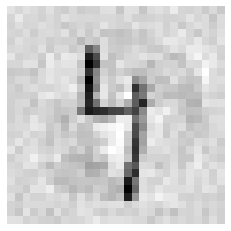

[1703] (예측값)2 (실제값)7


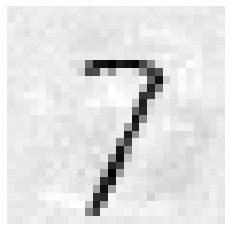

[1705] (예측값)4 (실제값)7


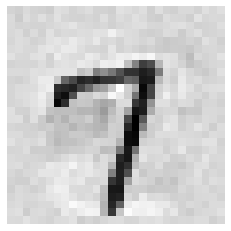

[1709] (예측값)8 (실제값)9


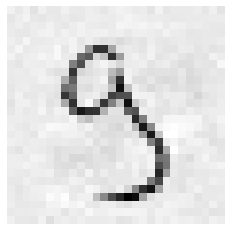

[1710] (예측값)9 (실제값)7


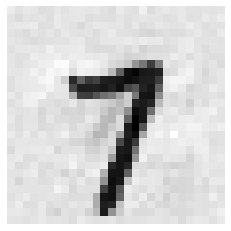

[1712] (예측값)1 (실제값)0


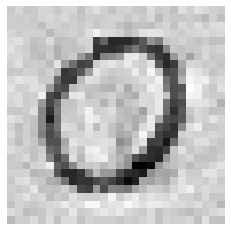

[1716] (예측값)5 (실제값)7


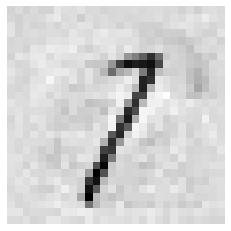

[1717] (예측값)6 (실제값)8


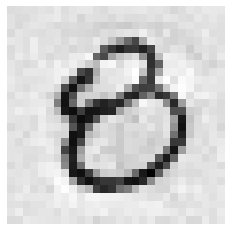

[1718] (예측값)4 (실제값)7


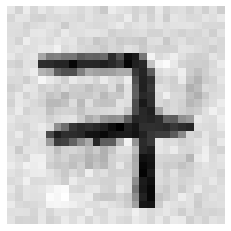

[1721] (예측값)9 (실제값)7


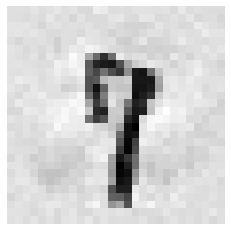

[1725] (예측값)7 (실제값)6


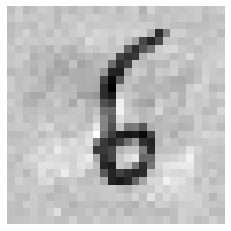

[1727] (예측값)9 (실제값)3


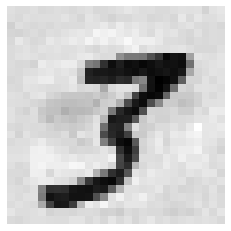

[1728] (예측값)7 (실제값)1


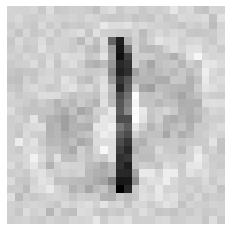

[1729] (예측값)2 (실제값)1


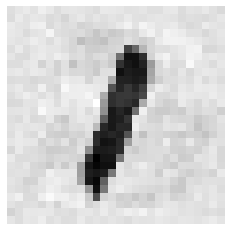

[1730] (예측값)4 (실제값)3


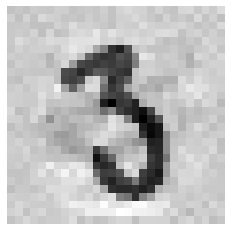

[1732] (예측값)8 (실제값)9


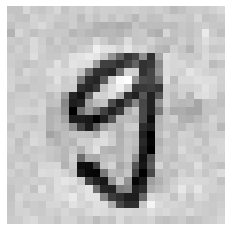

[1734] (예측값)9 (실제값)7


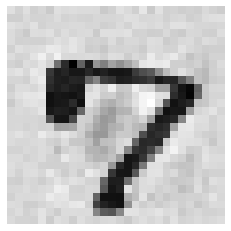

[1735] (예측값)9 (실제값)4


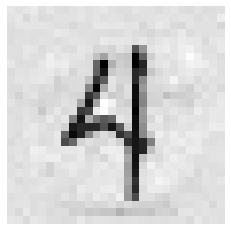

[1737] (예측값)8 (실제값)5


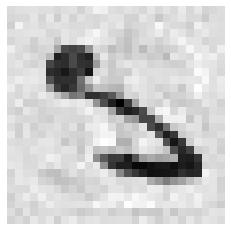

[1739] (예측값)2 (실제값)0


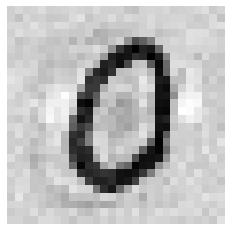

[1740] (예측값)6 (실제값)8


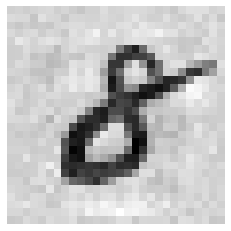

[1741] (예측값)5 (실제값)7


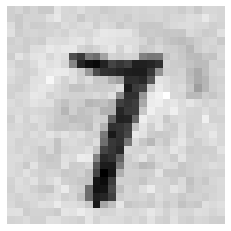

[1743] (예측값)7 (실제값)9


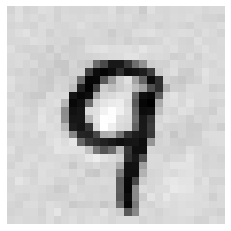

[1751] (예측값)6 (실제값)4


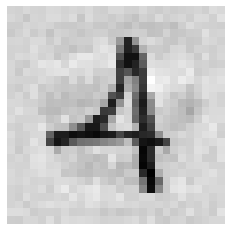

[1754] (예측값)9 (실제값)7


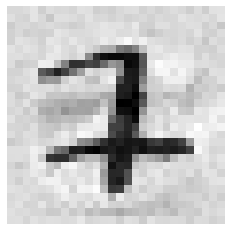

[1755] (예측값)0 (실제값)5


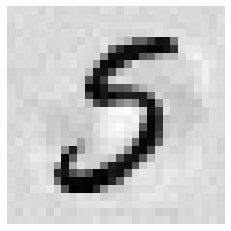

[1759] (예측값)4 (실제값)8


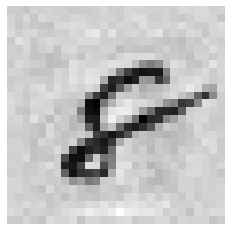

[1763] (예측값)8 (실제값)3


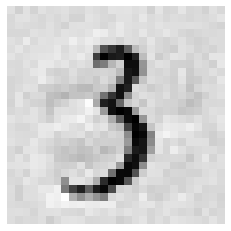

[1768] (예측값)4 (실제값)0


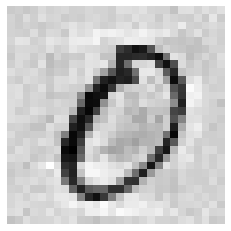

[1769] (예측값)5 (실제값)3


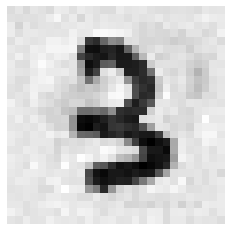

[1772] (예측값)8 (실제값)7


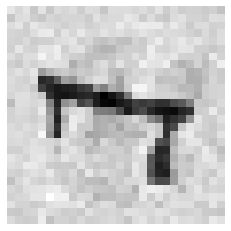

[1773] (예측값)9 (실제값)1


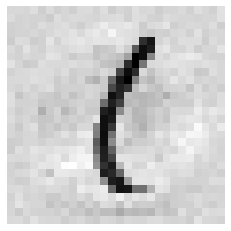

[1774] (예측값)0 (실제값)8


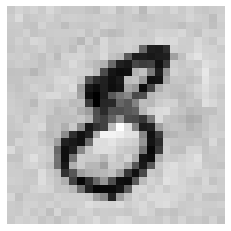

[1779] (예측값)6 (실제값)3


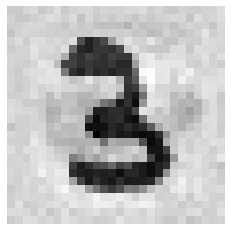

[1781] (예측값)8 (실제값)9


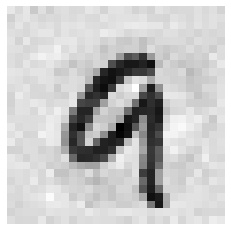

[1782] (예측값)9 (실제값)8


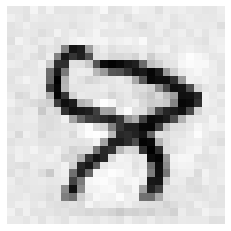

[1786] (예측값)3 (실제값)4


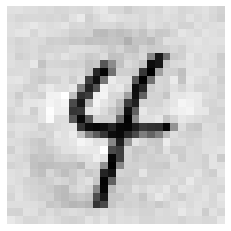

[1787] (예측값)4 (실제값)9


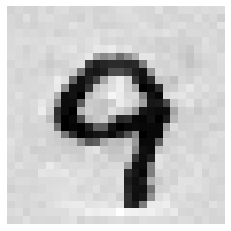

[1788] (예측값)5 (실제값)9


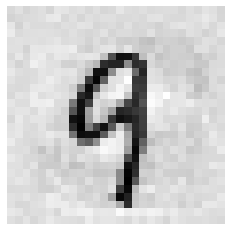

[1789] (예측값)6 (실제값)3


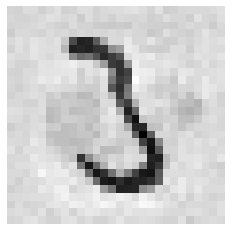

[1790] (예측값)7 (실제값)2


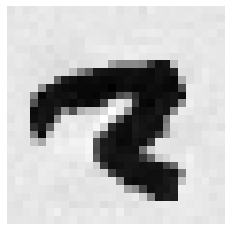

[1791] (예측값)8 (실제값)1


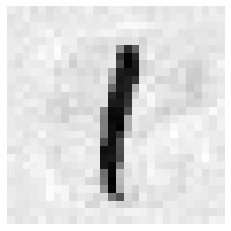

[1794] (예측값)2 (실제값)0


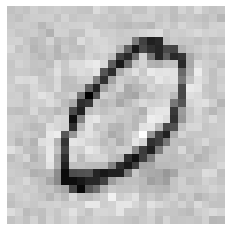

[1796] (예측값)4 (실제값)0


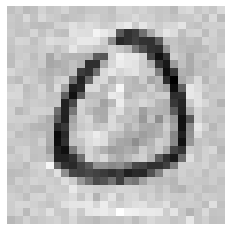

[1797] (예측값)5 (실제값)3


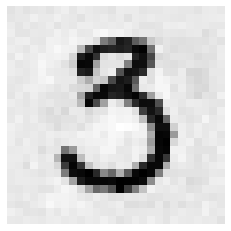

[1798] (예측값)6 (실제값)3


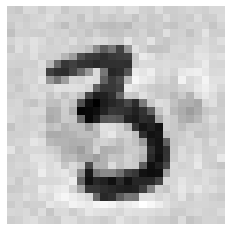

[1800] (예측값)9 (실제값)6


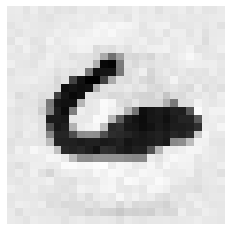

[1805] (예측값)5 (실제값)7


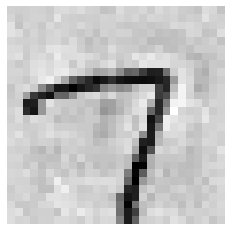

[1808] (예측값)4 (실제값)0


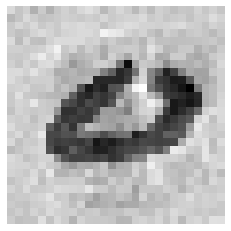

[1809] (예측값)9 (실제값)7


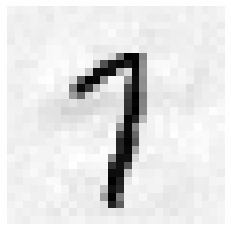

[1812] (예측값)2 (실제값)9


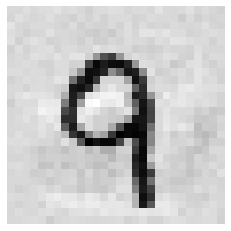

[1813] (예측값)3 (실제값)8


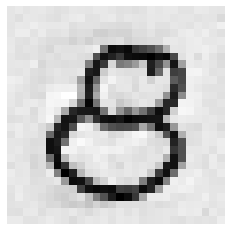

[1817] (예측값)1 (실제값)2


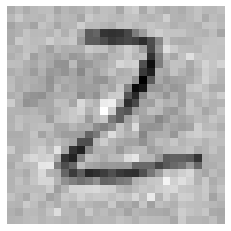

[1818] (예측값)8 (실제값)6


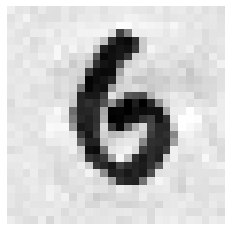

[1819] (예측값)9 (실제값)6


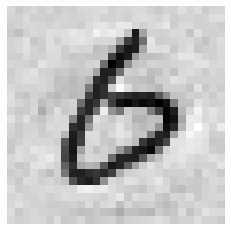

[1822] (예측값)2 (실제값)6


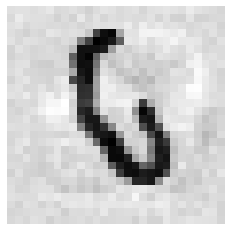

[1826] (예측값)6 (실제값)0


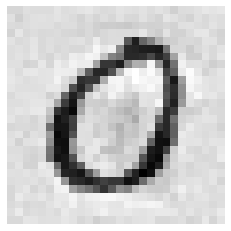

[1828] (예측값)5 (실제값)3


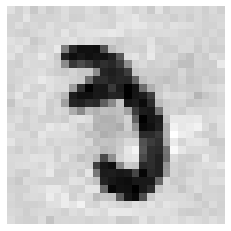

[1829] (예측값)9 (실제값)1


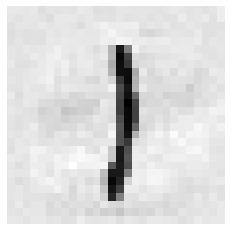

[1830] (예측값)0 (실제값)1


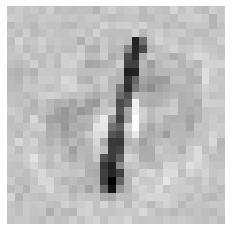

[1834] (예측값)4 (실제값)1


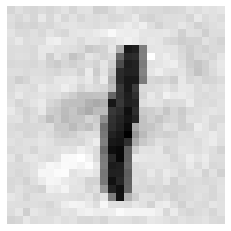

[1841] (예측값)7 (실제값)0


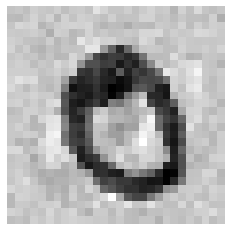

[1842] (예측값)3 (실제값)2


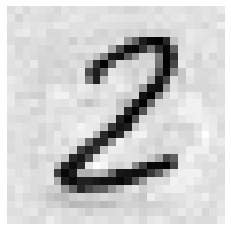

[1847] (예측값)8 (실제값)5


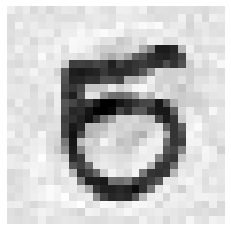

[1848] (예측값)9 (실제값)7


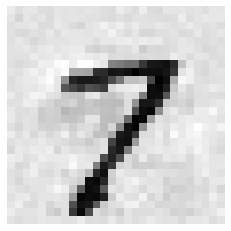

[1850] (예측값)3 (실제값)8


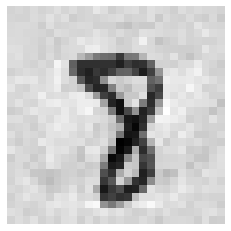

[1853] (예측값)4 (실제값)9


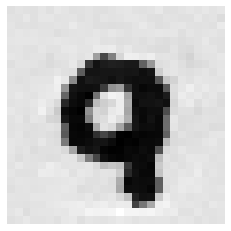

[1857] (예측값)4 (실제값)6


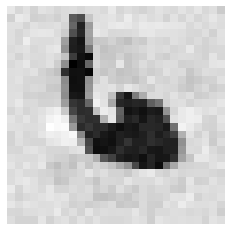

[1858] (예측값)9 (실제값)6


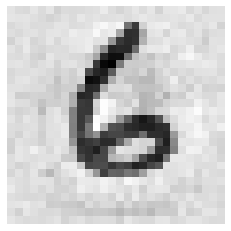

[1862] (예측값)3 (실제값)4


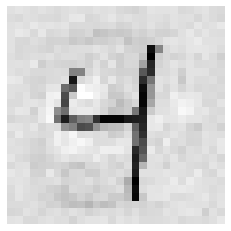

[1867] (예측값)8 (실제값)1


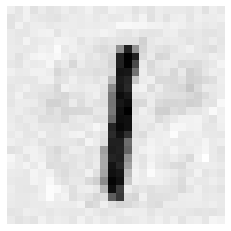

[1868] (예측값)9 (실제값)1


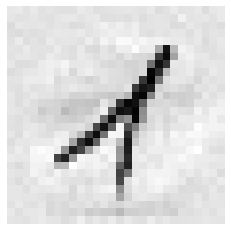

[1871] (예측값)3 (실제값)2


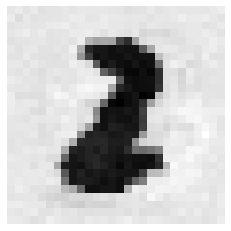

[1873] (예측값)6 (실제값)9


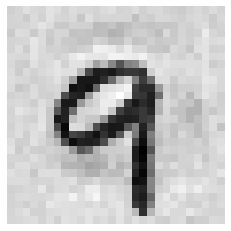

[1874] (예측값)9 (실제값)5


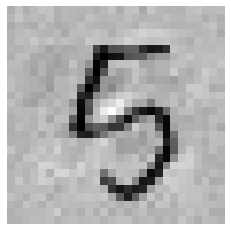

[1876] (예측값)9 (실제값)1


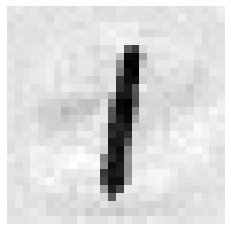

[1878] (예측값)3 (실제값)8


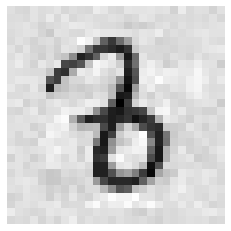

[1881] (예측값)4 (실제값)9


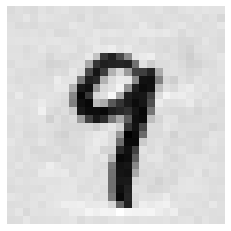

[1883] (예측값)9 (실제값)7


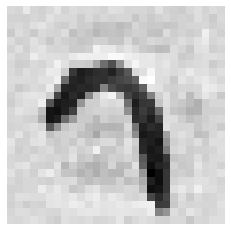

[1885] (예측값)8 (실제값)1


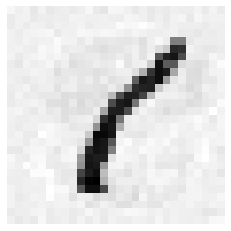

[1886] (예측값)8 (실제값)6


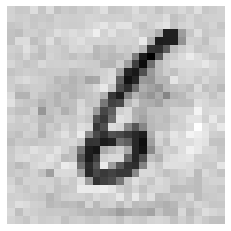

[1887] (예측값)5 (실제값)7


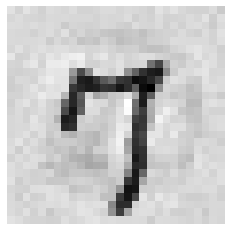

[1891] (예측값)4 (실제값)2


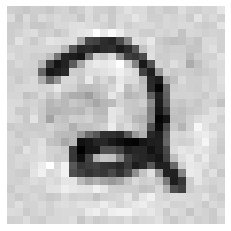

[1893] (예측값)6 (실제값)8


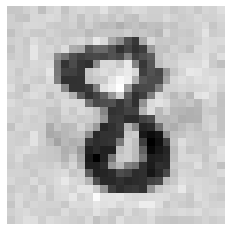

[1894] (예측값)7 (실제값)9


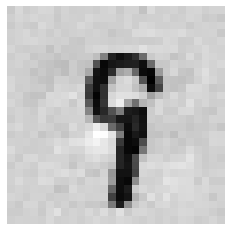

[1901] (예측값)4 (실제값)9


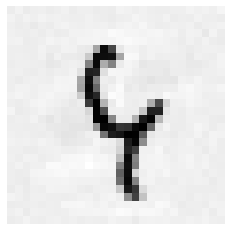

[1902] (예측값)6 (실제값)5


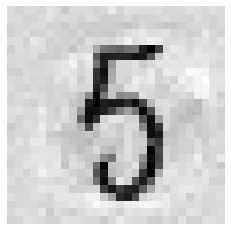

[1903] (예측값)2 (실제값)7


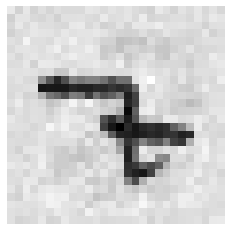

[1904] (예측값)0 (실제값)9


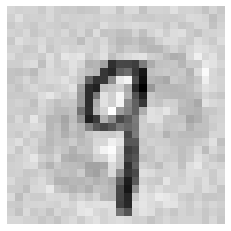

[1907] (예측값)3 (실제값)0


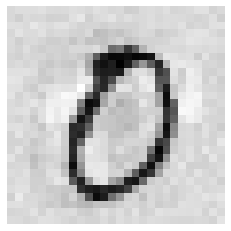

[1908] (예측값)4 (실제값)6


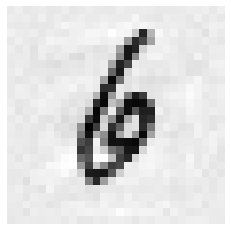

[1910] (예측값)6 (실제값)5


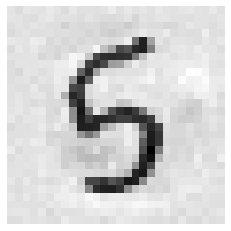

[1913] (예측값)0 (실제값)3


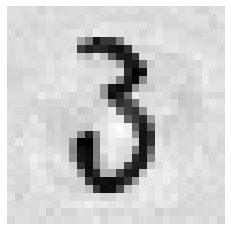

[1915] (예측값)3 (실제값)2


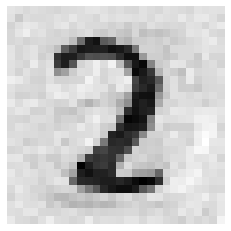

[1917] (예측값)8 (실제값)5


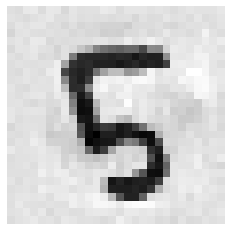

[1918] (예측값)7 (실제값)0


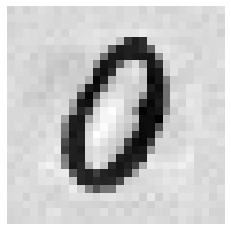

[1920] (예측값)9 (실제값)4


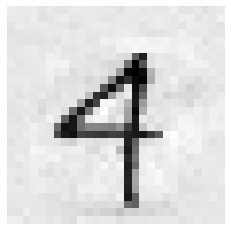

[1922] (예측값)2 (실제값)1


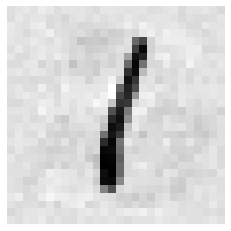

[1924] (예측값)5 (실제값)4


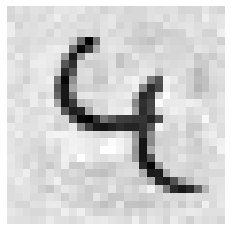

[1926] (예측값)7 (실제값)3


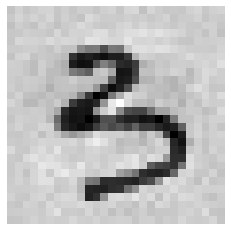

[1928] (예측값)9 (실제값)3


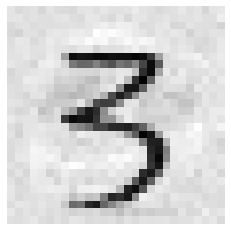

[1929] (예측값)0 (실제값)4


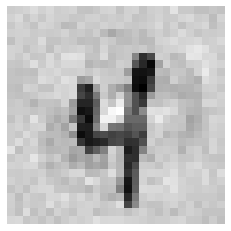

[1932] (예측값)3 (실제값)2


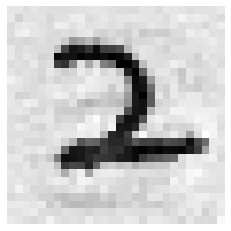

[1933] (예측값)4 (실제값)7


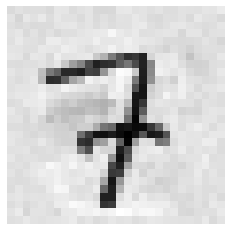

[1937] (예측값)8 (실제값)6


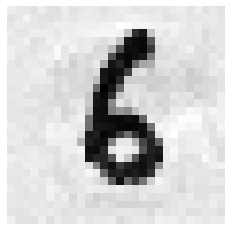

[1940] (예측값)1 (실제값)5


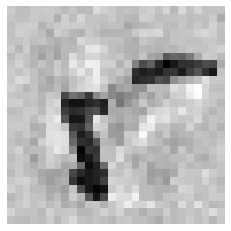

[1941] (예측값)2 (실제값)7


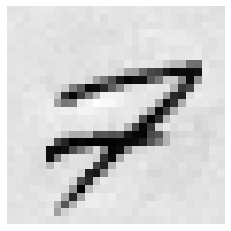

[1942] (예측값)3 (실제값)8


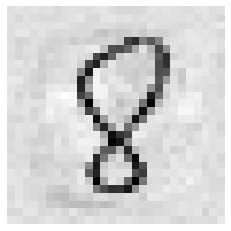

[1944] (예측값)5 (실제값)0


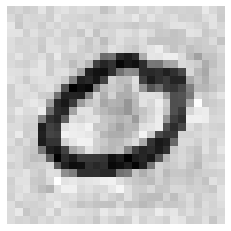

[1947] (예측값)8 (실제값)2


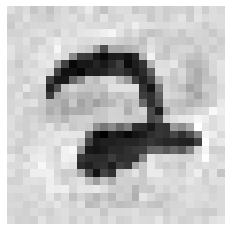

[1948] (예측값)9 (실제값)5


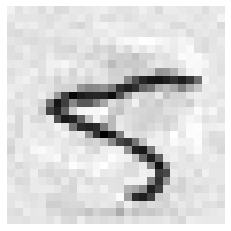

[1952] (예측값)3 (실제값)9


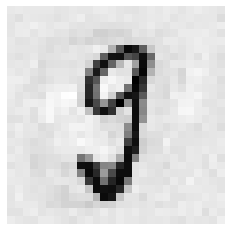

[1953] (예측값)4 (실제값)3


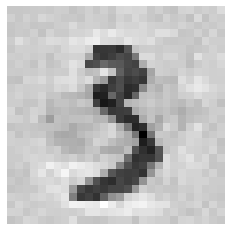

[1954] (예측값)4 (실제값)5


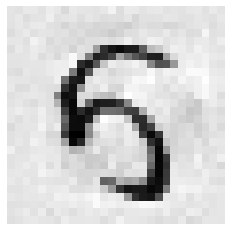

[1955] (예측값)3 (실제값)8


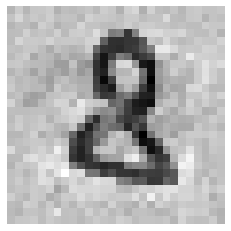

[1961] (예측값)3 (실제값)8


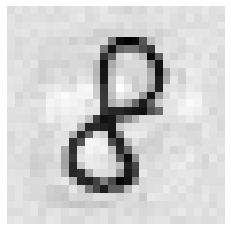

[1962] (예측값)8 (실제값)3


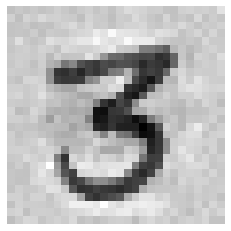

[1963] (예측값)9 (실제값)4


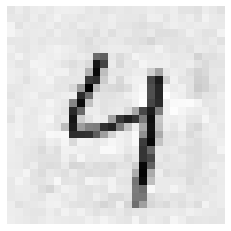

[1969] (예측값)1 (실제값)6


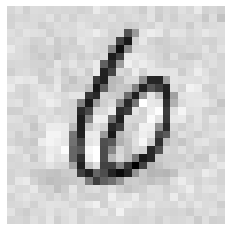

[1970] (예측값)3 (실제값)5


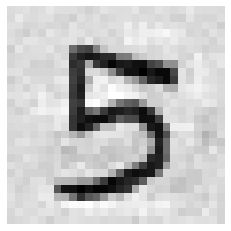

[1976] (예측값)9 (실제값)3


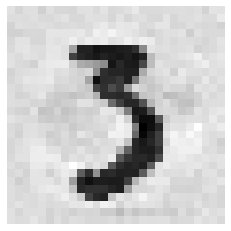

[1978] (예측값)3 (실제값)4


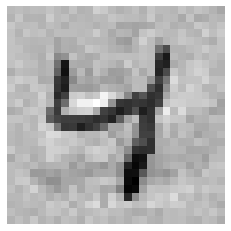

[1979] (예측값)2 (실제값)9


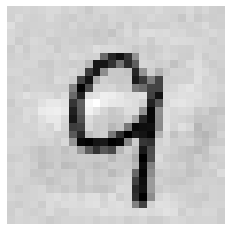

[1981] (예측값)4 (실제값)6


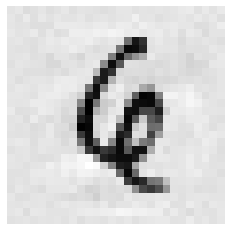

[1982] (예측값)5 (실제값)6


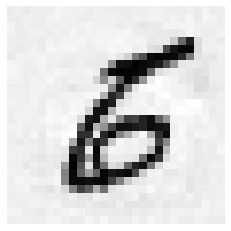

[1984] (예측값)0 (실제값)2


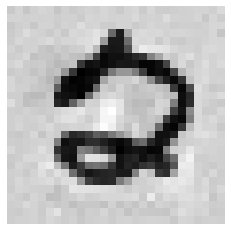

[1986] (예측값)9 (실제값)1


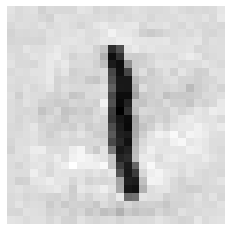

[1988] (예측값)8 (실제값)1


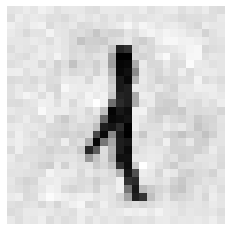

[1989] (예측값)3 (실제값)4


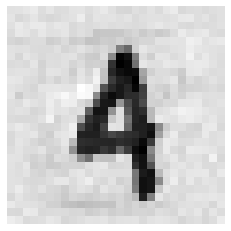

[1990] (예측값)4 (실제값)6


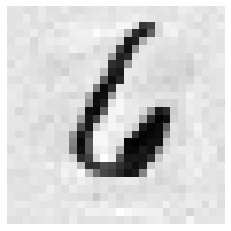

[1992] (예측값)8 (실제값)9


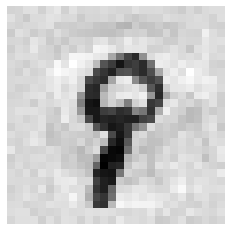

[1993] (예측값)7 (실제값)1


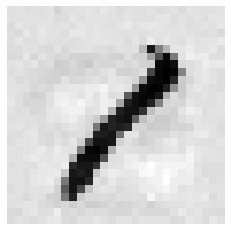

[1994] (예측값)8 (실제값)1


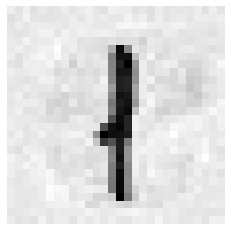

[1995] (예측값)9 (실제값)0


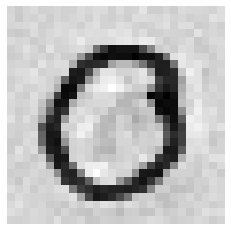

[1996] (예측값)0 (실제값)6


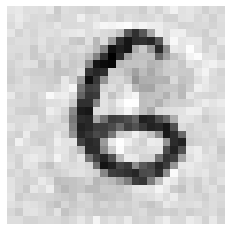

[1999] (예측값)3 (실제값)5


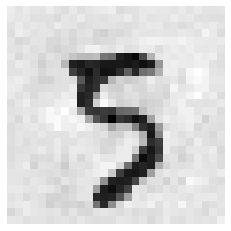

[2001] (예측값)4 (실제값)5


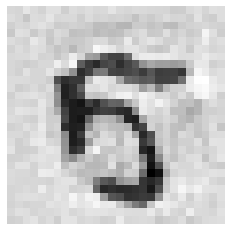

[2003] (예측값)8 (실제값)5


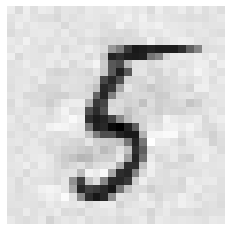

[2004] (예측값)9 (실제값)8


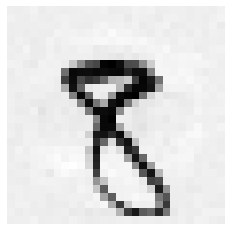

[2007] (예측값)2 (실제값)4


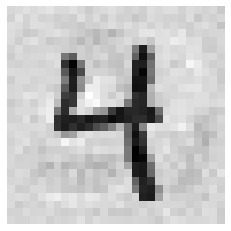

[2008] (예측값)4 (실제값)3


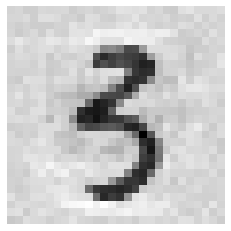

[2009] (예측값)5 (실제값)9


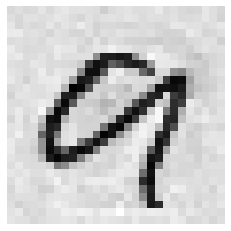

[2010] (예측값)6 (실제값)1


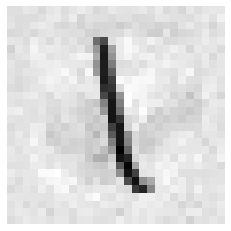

[2011] (예측값)7 (실제값)3


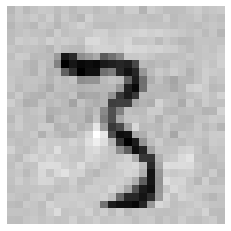

[2016] (예측값)3 (실제값)7


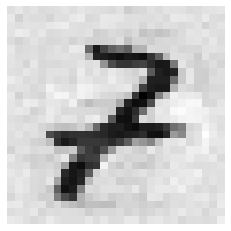

[2019] (예측값)6 (실제값)9


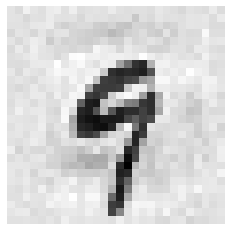

[2022] (예측값)9 (실제값)4


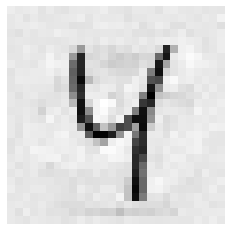

[2024] (예측값)1 (실제값)7


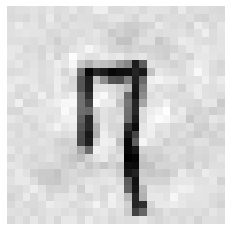

[2025] (예측값)8 (실제값)3


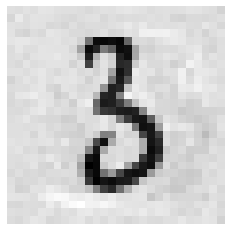

[2027] (예측값)4 (실제값)1


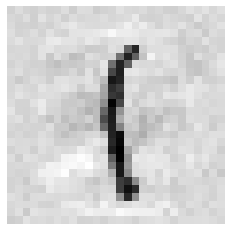

[2028] (예측값)5 (실제값)7


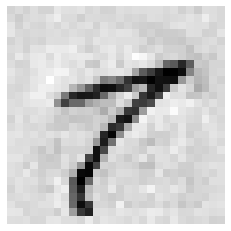

[2029] (예측값)6 (실제값)5


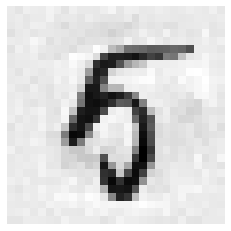

[2031] (예측값)8 (실제값)3


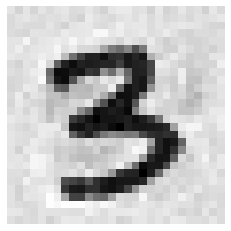

[2034] (예측값)2 (실제값)1


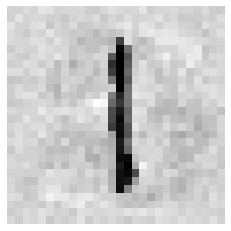

[2035] (예측값)3 (실제값)5


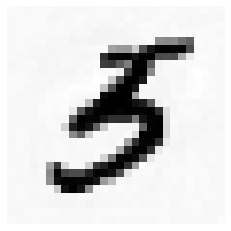

[2038] (예측값)7 (실제값)8


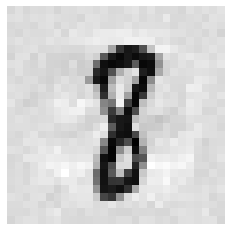

[2039] (예측값)8 (실제값)6


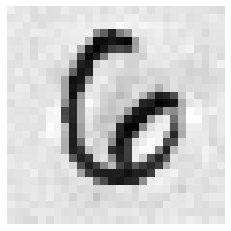

[2040] (예측값)9 (실제값)5


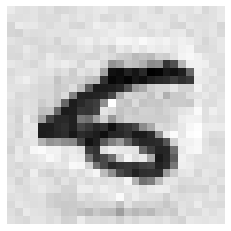

[2041] (예측값)7 (실제값)1


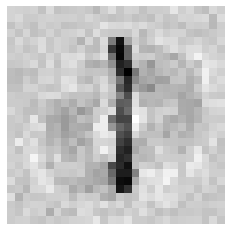

[2043] (예측값)8 (실제값)4


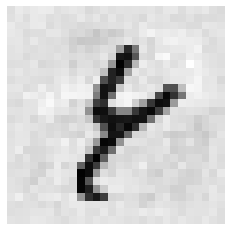

[2044] (예측값)7 (실제값)2


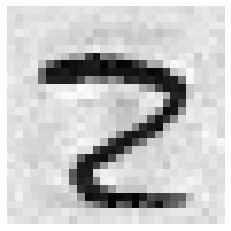

[2045] (예측값)8 (실제값)3


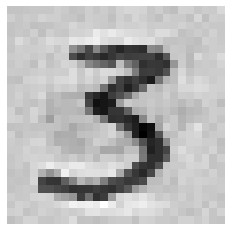

[2049] (예측값)0 (실제값)9


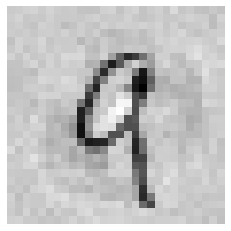

[2051] (예측값)2 (실제값)1


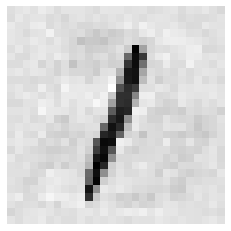

[2053] (예측값)9 (실제값)4


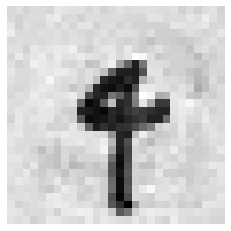

[2054] (예측값)6 (실제값)9


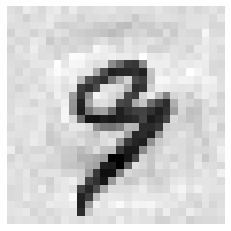

[2056] (예측값)9 (실제값)8


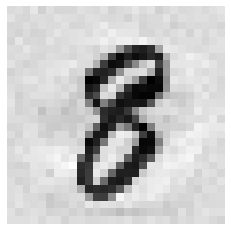

[2057] (예측값)0 (실제값)6


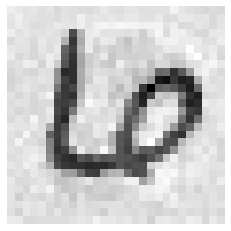

[2059] (예측값)2 (실제값)7


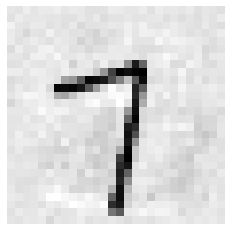

[2066] (예측값)0 (실제값)6


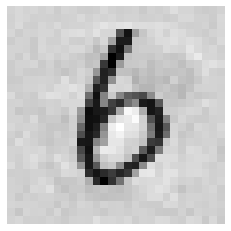

[2067] (예측값)6 (실제값)0


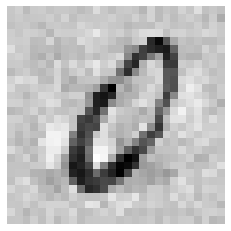

[2070] (예측값)9 (실제값)7


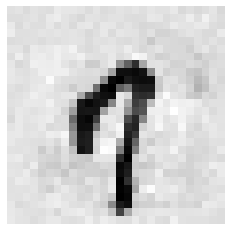

[2073] (예측값)8 (실제값)5


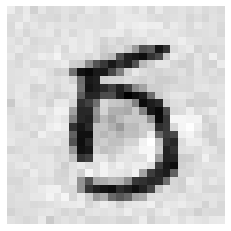

[2074] (예측값)9 (실제값)4


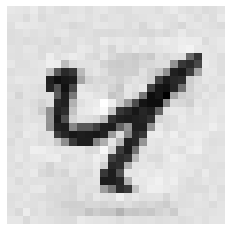

[2075] (예측값)8 (실제값)3


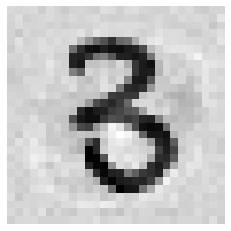

[2079] (예측값)4 (실제값)6


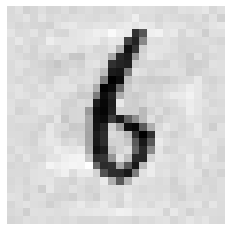

[2081] (예측값)6 (실제값)0


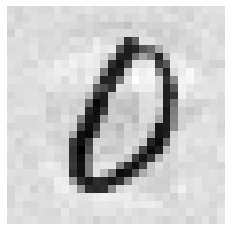

[2084] (예측값)9 (실제값)4


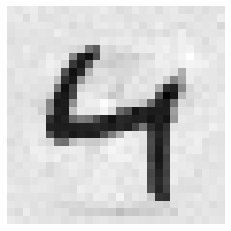

[2085] (예측값)0 (실제값)2


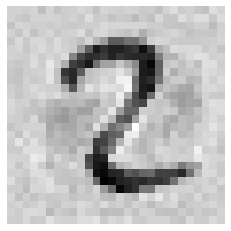

[2091] (예측값)5 (실제값)7


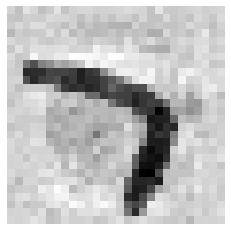

[2096] (예측값)2 (실제값)0


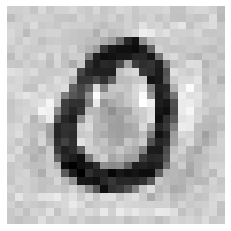

[2097] (예측값)3 (실제값)6


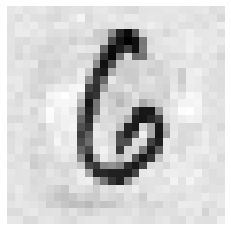

[2101] (예측값)7 (실제값)2


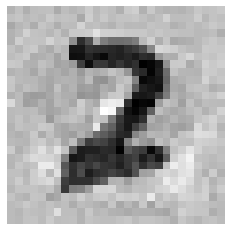

[2104] (예측값)5 (실제값)7


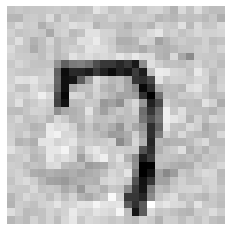

[2105] (예측값)2 (실제값)3


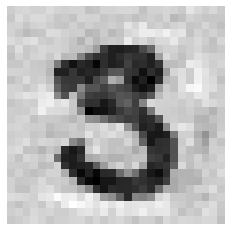

[2107] (예측값)4 (실제값)8


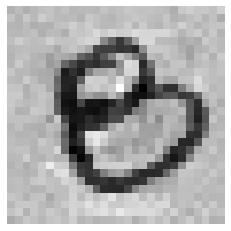

[2109] (예측값)8 (실제값)3


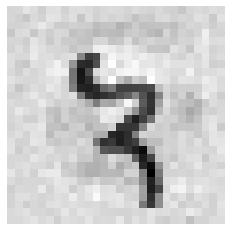

[2116] (예측값)4 (실제값)6


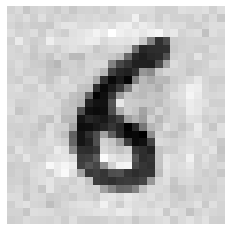

[2118] (예측값)0 (실제값)6


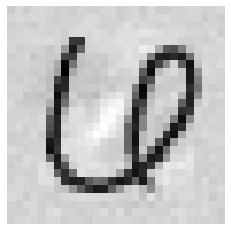

[2119] (예측값)9 (실제값)8


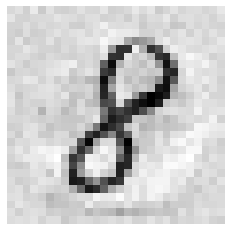

[2121] (예측값)1 (실제값)8


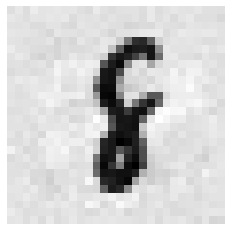

[2122] (예측값)3 (실제값)2


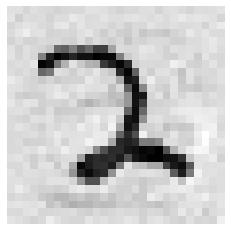

[2123] (예측값)9 (실제값)7


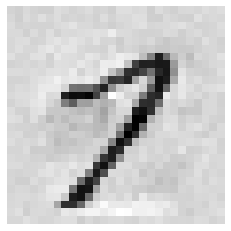

[2125] (예측값)6 (실제값)5


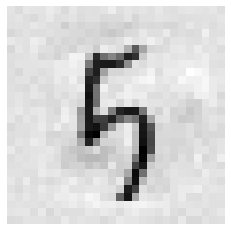

[2127] (예측값)8 (실제값)0


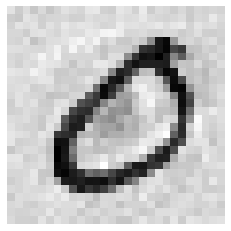

[2128] (예측값)9 (실제값)3


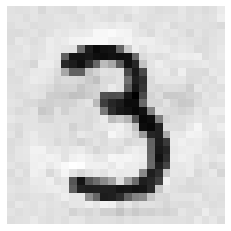

[2129] (예측값)2 (실제값)9


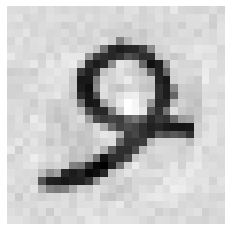

[2130] (예측값)8 (실제값)4


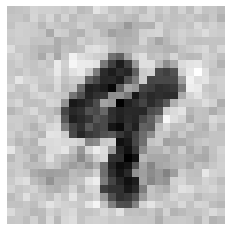

[2131] (예측값)2 (실제값)6


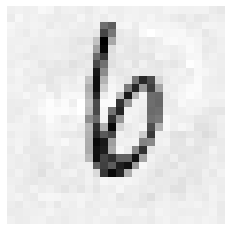

[2132] (예측값)3 (실제값)7


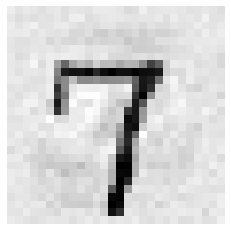

[2135] (예측값)7 (실제값)6


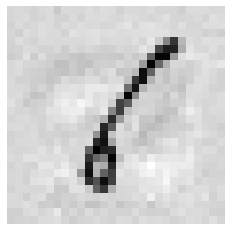

[2136] (예측값)8 (실제값)1


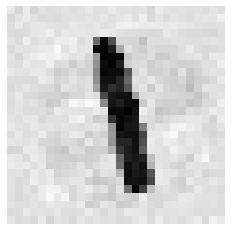

[2137] (예측값)9 (실제값)1


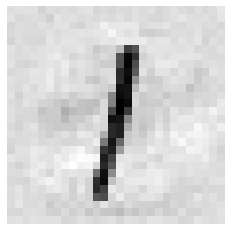

[2138] (예측값)0 (실제값)2


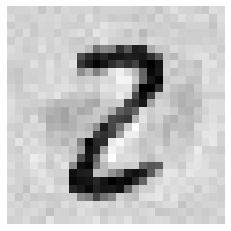

[2142] (예측값)4 (실제값)8


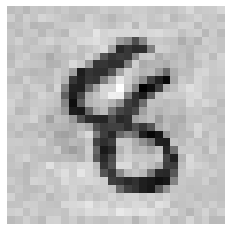

[2144] (예측값)4 (실제값)6


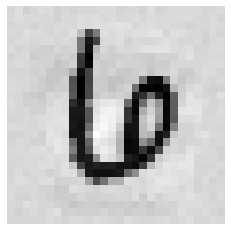

[2146] (예측값)9 (실제값)8


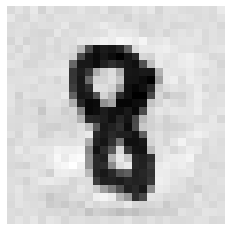

[2148] (예측값)3 (실제값)4


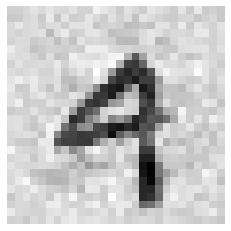

[2155] (예측값)8 (실제값)0


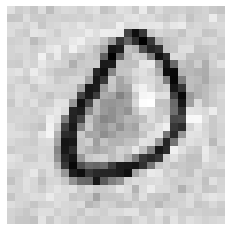

[2160] (예측값)3 (실제값)6


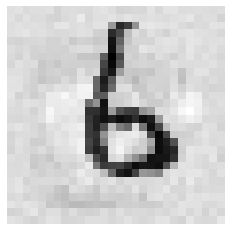

[2161] (예측값)4 (실제값)9


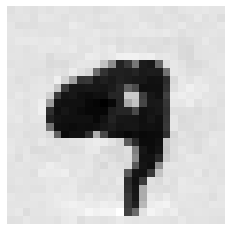

[2162] (예측값)8 (실제값)5


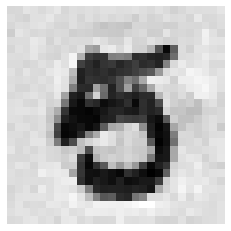

[2163] (예측값)7 (실제값)8


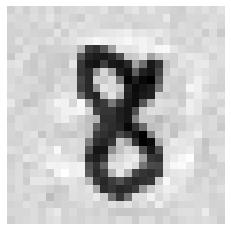

[2164] (예측값)8 (실제값)1


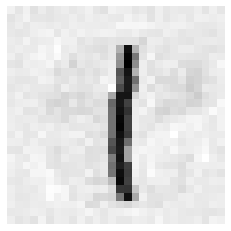

[2165] (예측값)9 (실제값)4


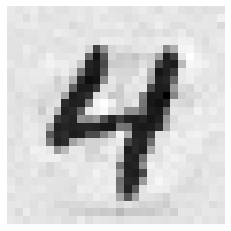

[2166] (예측값)7 (실제값)1


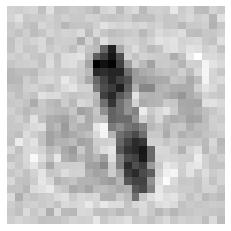

[2168] (예측값)2 (실제값)8


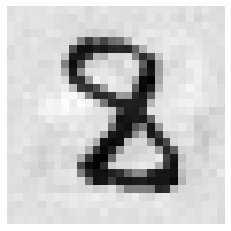

[2169] (예측값)3 (실제값)4


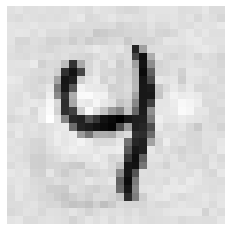

[2171] (예측값)5 (실제값)1


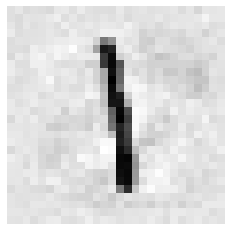

[2174] (예측값)8 (실제값)3


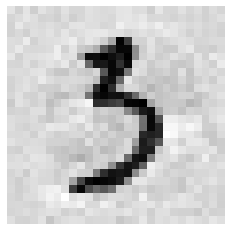

[2175] (예측값)9 (실제값)1


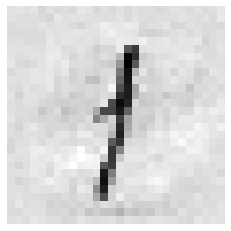

[2178] (예측값)2 (실제값)0


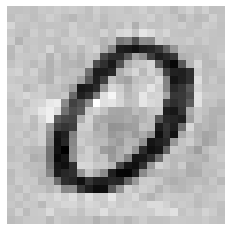

[2179] (예측값)3 (실제값)8


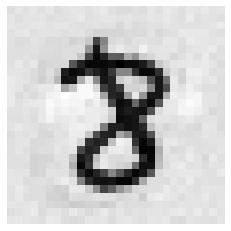

[2182] (예측값)6 (실제값)1


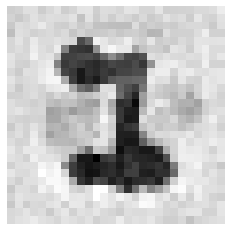

[2185] (예측값)9 (실제값)0


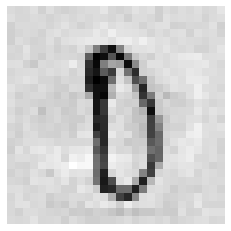

[2186] (예측값)0 (실제값)2


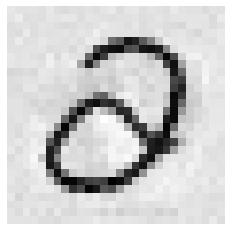

[2188] (예측값)8 (실제값)0


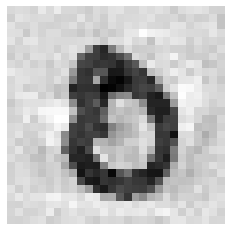

[2189] (예측값)3 (실제값)9


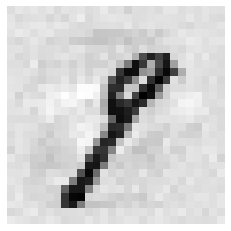

[2190] (예측값)4 (실제값)0


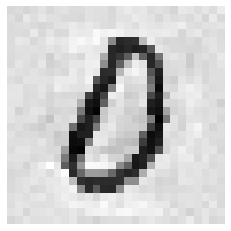

[2192] (예측값)8 (실제값)5


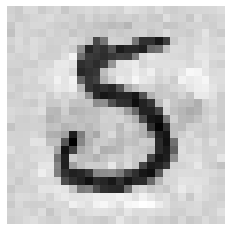

[2195] (예측값)2 (실제값)7


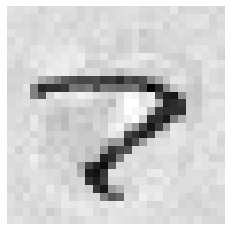

[2196] (예측값)1 (실제값)9


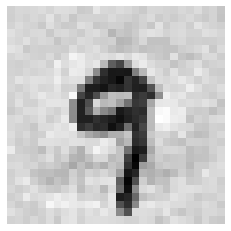

[2198] (예측값)3 (실제값)2


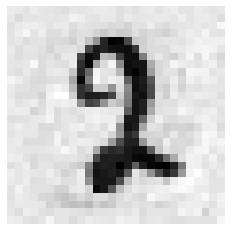

[2199] (예측값)4 (실제값)6


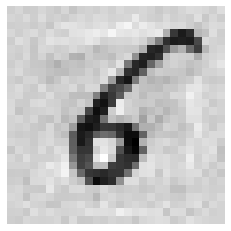

[2200] (예측값)5 (실제값)2


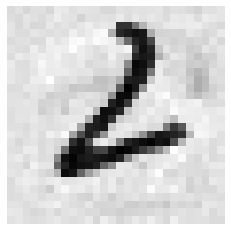

[2202] (예측값)9 (실제값)4


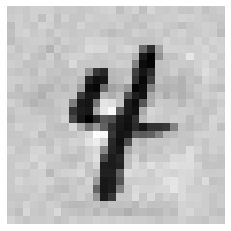

[2203] (예측값)9 (실제값)8


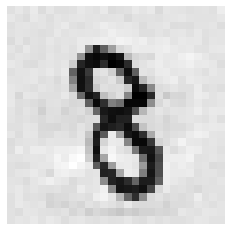

[2210] (예측값)7 (실제값)6


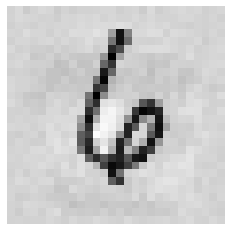

[2211] (예측값)9 (실제값)8


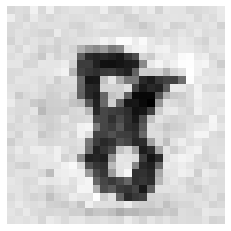

[2212] (예측값)8 (실제값)9


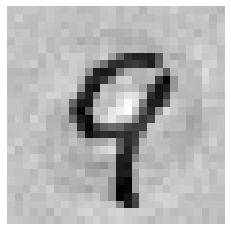

[2215] (예측값)5 (실제값)6


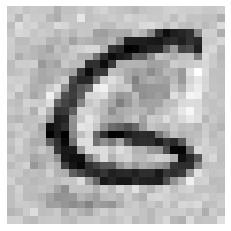

[2219] (예측값)7 (실제값)8


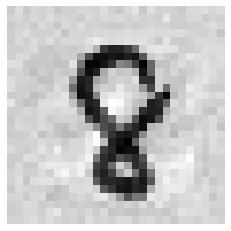

[2224] (예측값)6 (실제값)5


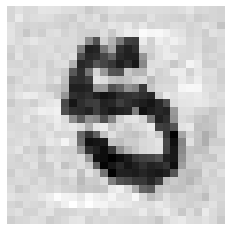

[2225] (예측값)3 (실제값)8


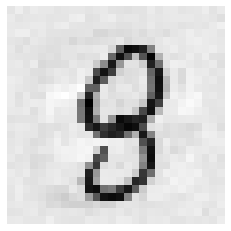

[2228] (예측값)6 (실제값)1


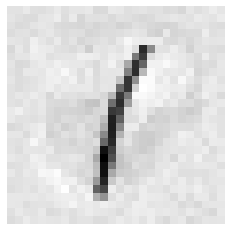

[2235] (예측값)3 (실제값)1


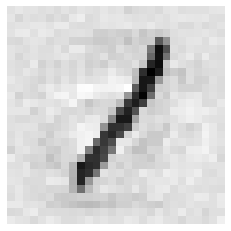

[2236] (예측값)4 (실제값)0


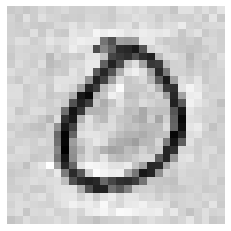

[2237] (예측값)6 (실제값)5


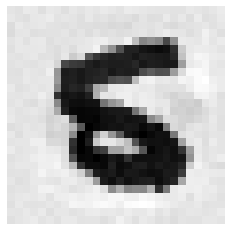

[2238] (예측값)8 (실제값)7


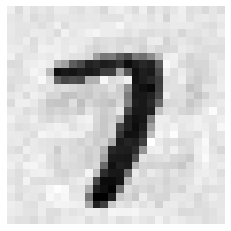

[2239] (예측값)9 (실제값)1


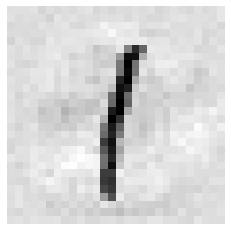

[2242] (예측값)3 (실제값)2


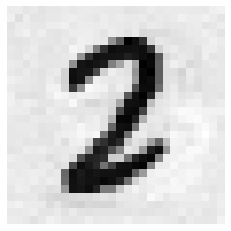

[2252] (예측값)3 (실제값)7


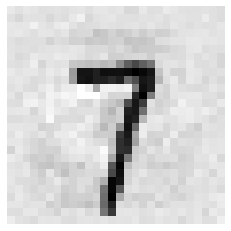

[2255] (예측값)6 (실제값)3


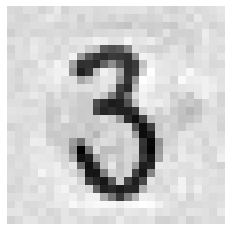

[2257] (예측값)8 (실제값)9


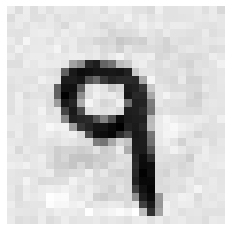

[2262] (예측값)3 (실제값)7


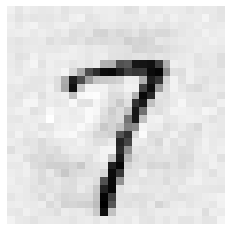

[2263] (예측값)4 (실제값)9


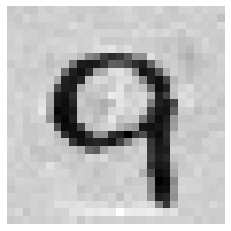

[2264] (예측값)5 (실제값)4


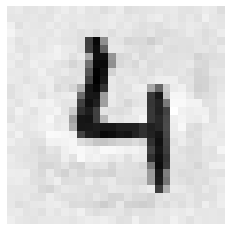

[2266] (예측값)3 (실제값)1


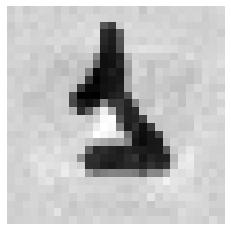

[2267] (예측값)8 (실제값)6


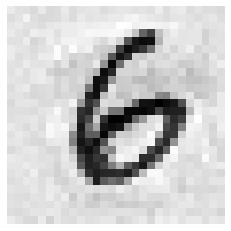

[2268] (예측값)9 (실제값)7


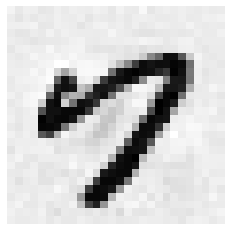

[2272] (예측값)0 (실제값)8


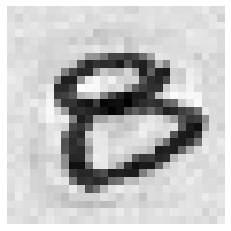

[2273] (예측값)4 (실제값)1


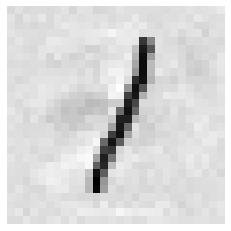

[2275] (예측값)9 (실제값)7


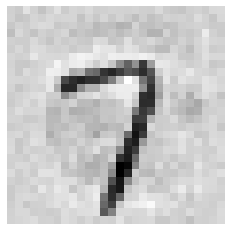

[2277] (예측값)8 (실제값)1


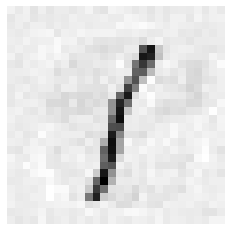

[2280] (예측값)1 (실제값)3


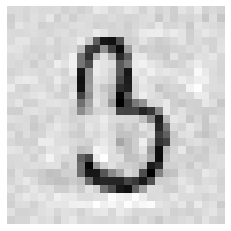

[2282] (예측값)3 (실제값)5


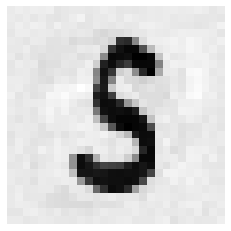

[2284] (예측값)5 (실제값)3


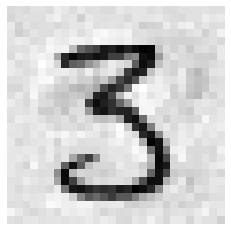

[2287] (예측값)8 (실제값)1


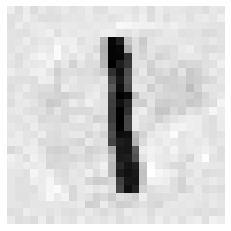

[2290] (예측값)1 (실제값)7


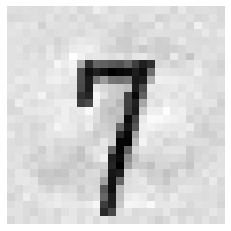

[2291] (예측값)2 (실제값)5


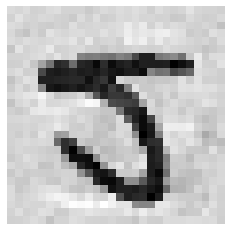

[2292] (예측값)3 (실제값)9


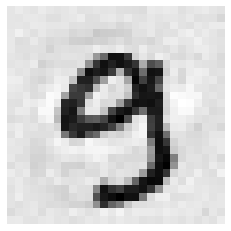

[2293] (예측값)6 (실제값)9


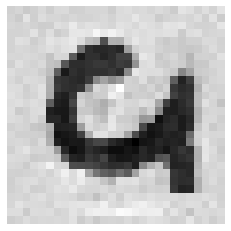

[2295] (예측값)6 (실제값)0


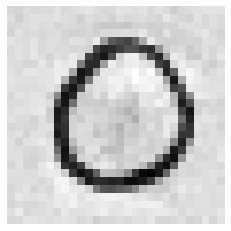

[2296] (예측값)7 (실제값)2


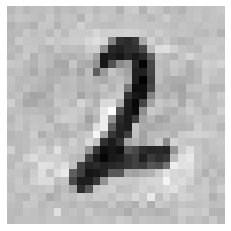

[2298] (예측값)0 (실제값)8


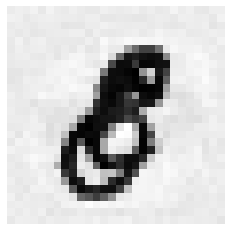

[2299] (예측값)7 (실제값)2


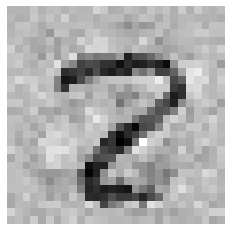

[2300] (예측값)2 (실제값)3


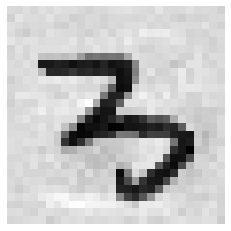

[2301] (예측값)3 (실제값)7


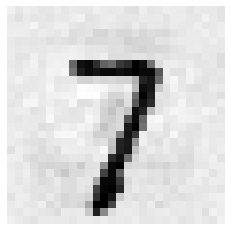

[2302] (예측값)4 (실제값)1


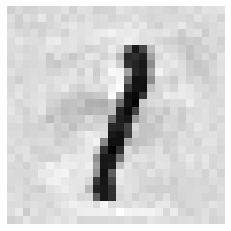

[2303] (예측값)5 (실제값)3


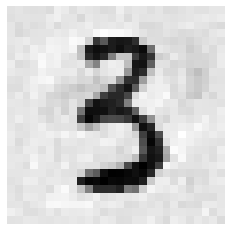

[2304] (예측값)6 (실제값)0


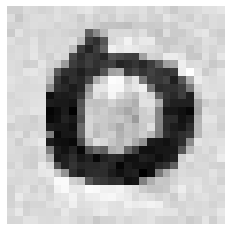

[2306] (예측값)8 (실제값)4


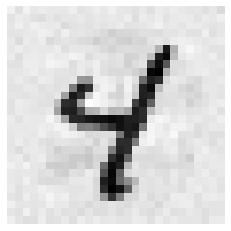

[2307] (예측값)9 (실제값)4


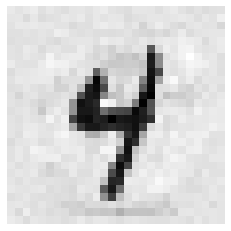

[2309] (예측값)5 (실제값)8


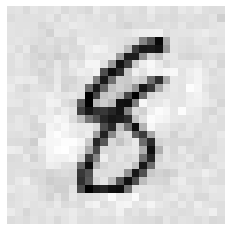

[2310] (예측값)2 (실제값)9


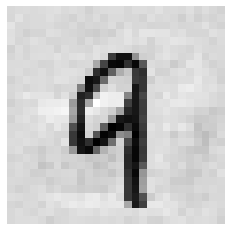

[2311] (예측값)3 (실제값)2


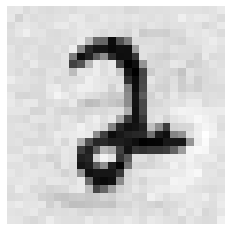

[2312] (예측값)4 (실제값)3


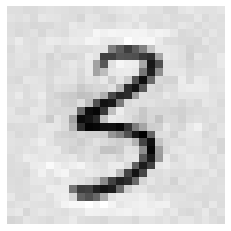

[2316] (예측값)8 (실제값)1


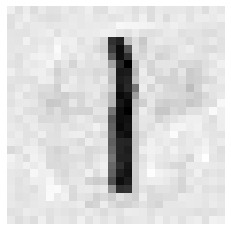

[2322] (예측값)4 (실제값)5


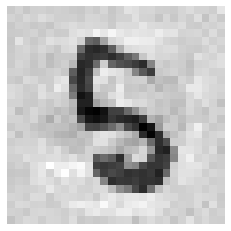

[2325] (예측값)8 (실제값)7


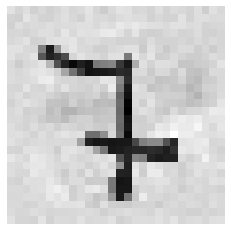

[2329] (예측값)2 (실제값)0


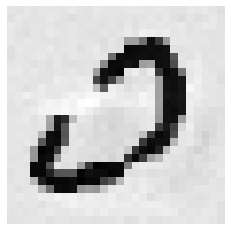

[2331] (예측값)4 (실제값)6


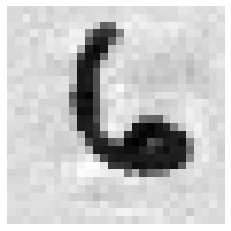

[2333] (예측값)6 (실제값)0


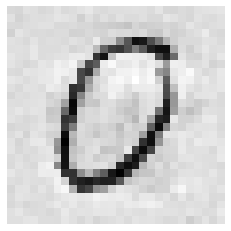

[2334] (예측값)8 (실제값)7


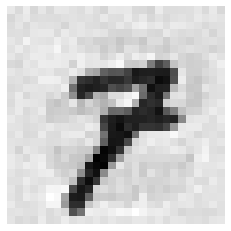

[2335] (예측값)9 (실제값)1


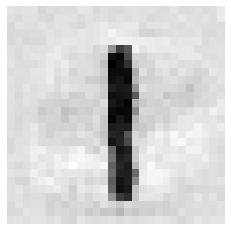

[2339] (예측값)3 (실제값)5


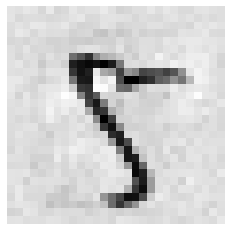

[2346] (예측값)3 (실제값)5


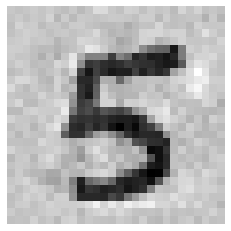

[2350] (예측값)6 (실제값)2


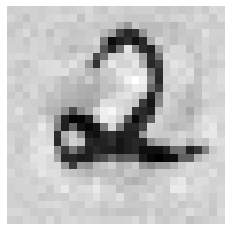

[2353] (예측값)8 (실제값)2


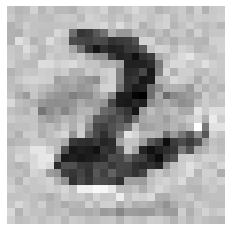

[2357] (예측값)4 (실제값)1


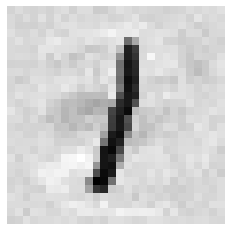

[2358] (예측값)5 (실제값)1


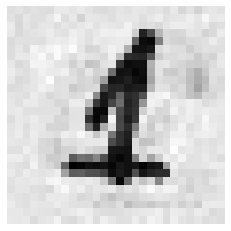

[2362] (예측값)9 (실제값)8


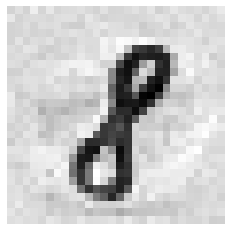

[2369] (예측값)6 (실제값)5


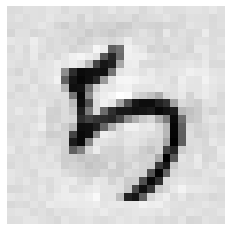

[2371] (예측값)9 (실제값)4


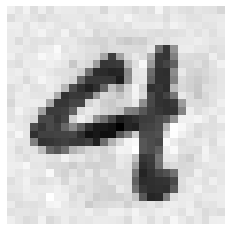

[2372] (예측값)9 (실제값)7


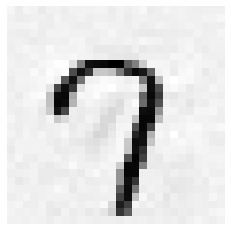

[2374] (예측값)1 (실제값)2


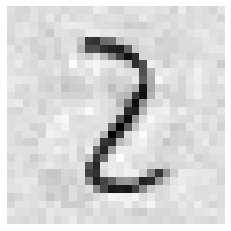

[2375] (예측값)2 (실제값)4


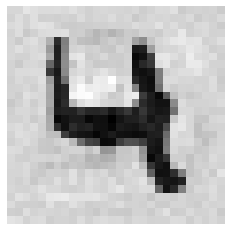

[2377] (예측값)9 (실제값)7


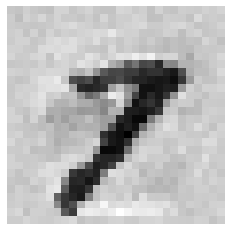

[2378] (예측값)5 (실제값)0


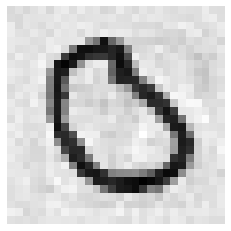

[2380] (예측값)4 (실제값)9


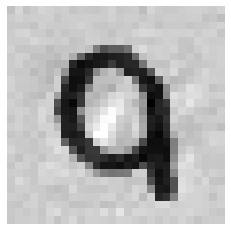

[2381] (예측값)9 (실제값)8


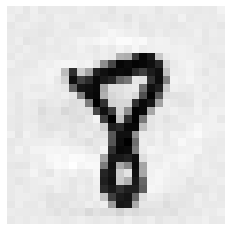

[2384] (예측값)2 (실제값)0


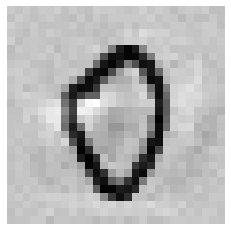

[2387] (예측값)1 (실제값)9


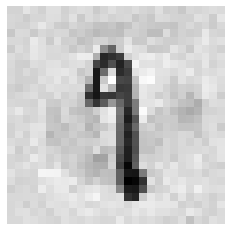

[2388] (예측값)4 (실제값)6


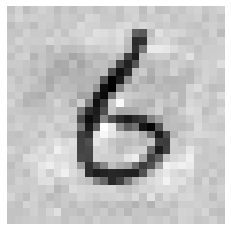

[2389] (예측값)9 (실제값)8


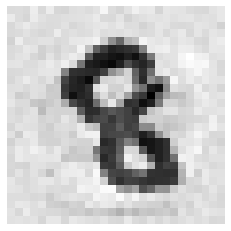

[2393] (예측값)3 (실제값)8


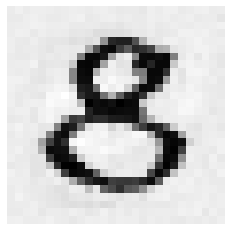

[2395] (예측값)6 (실제값)8


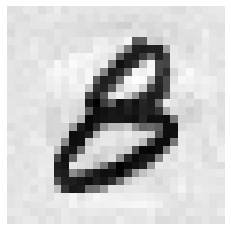

[2397] (예측값)8 (실제값)2


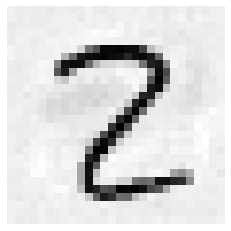

[2398] (예측값)9 (실제값)1


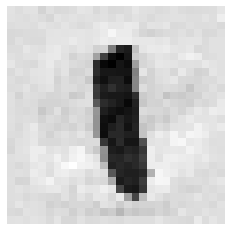

[2402] (예측값)3 (실제값)4


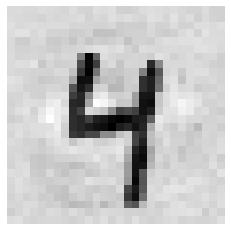

[2405] (예측값)6 (실제값)3


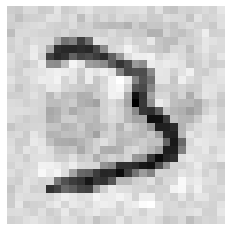

[2406] (예측값)7 (실제값)9


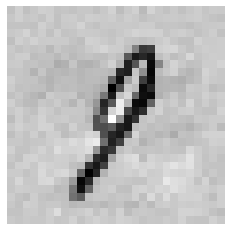

[2408] (예측값)9 (실제값)3


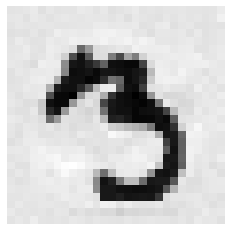

[2409] (예측값)2 (실제값)1


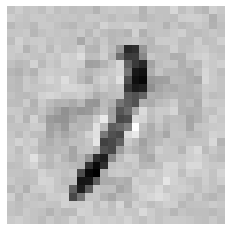

[2410] (예측값)2 (실제값)0


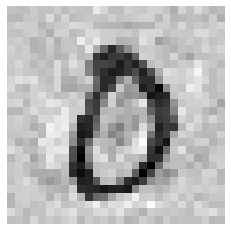

[2411] (예측값)2 (실제값)1


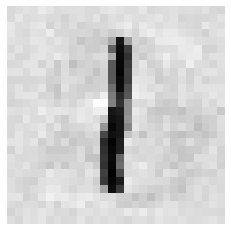

[2412] (예측값)1 (실제값)2


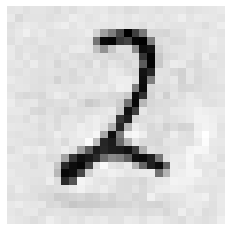

[2414] (예측값)5 (실제값)9


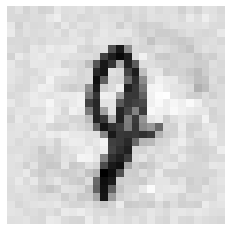

[2418] (예측값)9 (실제값)1


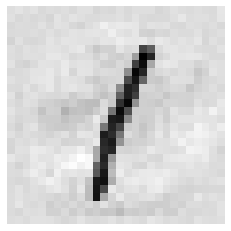

[2419] (예측값)0 (실제값)8


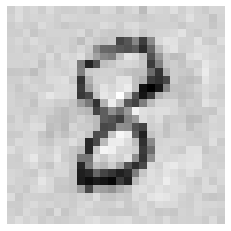

[2422] (예측값)7 (실제값)6


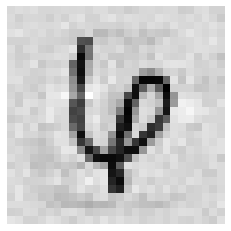

[2424] (예측값)5 (실제값)3


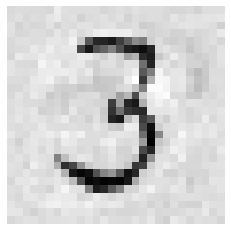

[2426] (예측값)7 (실제값)9


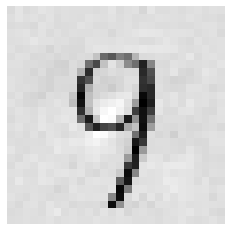

[2427] (예측값)8 (실제값)3


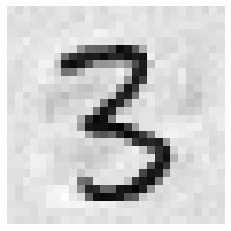

[2428] (예측값)9 (실제값)6


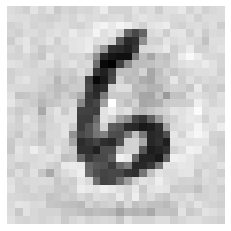

[2429] (예측값)0 (실제값)2


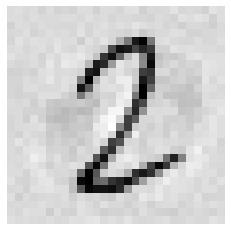

[2430] (예측값)1 (실제값)8


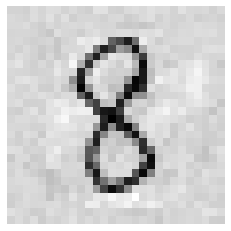

[2432] (예측값)3 (실제값)2


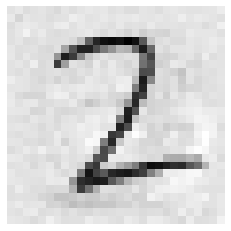

[2433] (예측값)1 (실제값)2


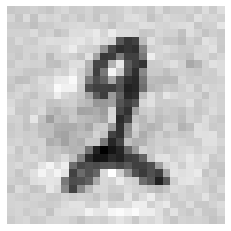

[2434] (예측값)5 (실제값)1


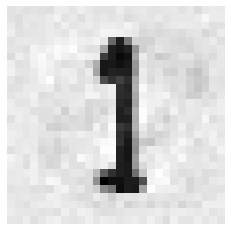

[2435] (예측값)6 (실제값)0


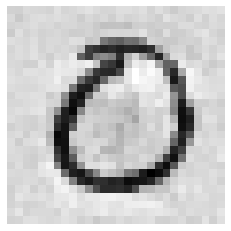

[2437] (예측값)8 (실제값)2


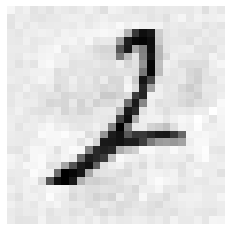

[2441] (예측값)4 (실제값)3


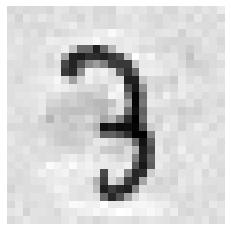

[2447] (예측값)9 (실제값)4


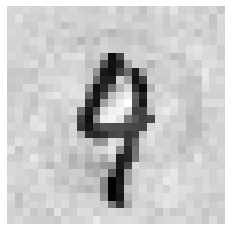

[2448] (예측값)8 (실제값)9


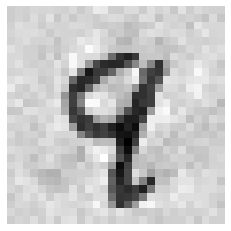

[2454] (예측값)8 (실제값)6


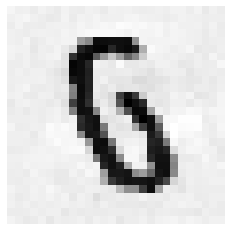

[2457] (예측값)8 (실제값)4


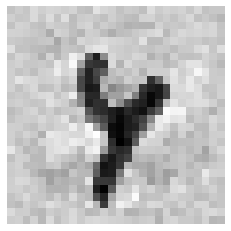

[2459] (예측값)3 (실제값)2


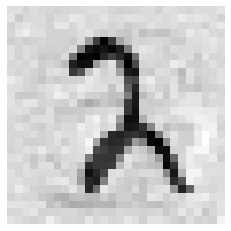

[2460] (예측값)4 (실제값)5


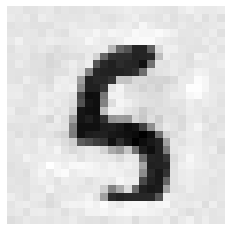

[2461] (예측값)5 (실제값)0


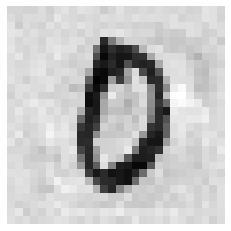

[2463] (예측값)8 (실제값)7


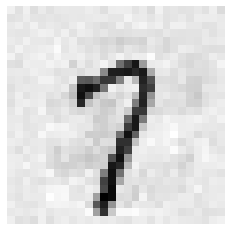

[2468] (예측값)3 (실제값)6


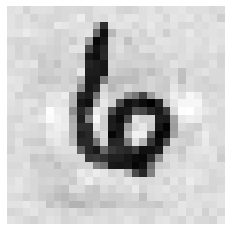

[2469] (예측값)4 (실제값)6


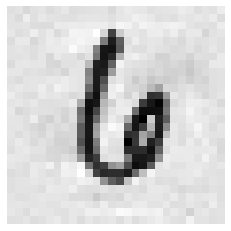

[2471] (예측값)7 (실제값)6


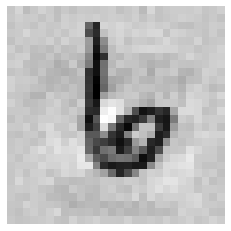

[2472] (예측값)8 (실제값)9


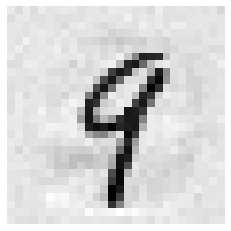

[2473] (예측값)8 (실제값)1


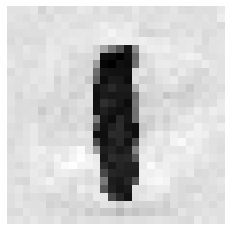

[2475] (예측값)1 (실제값)2


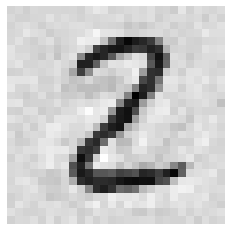

[2478] (예측값)4 (실제값)9


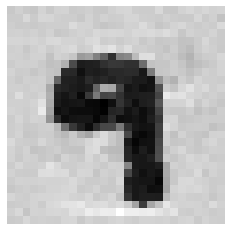

[2479] (예측값)5 (실제값)0


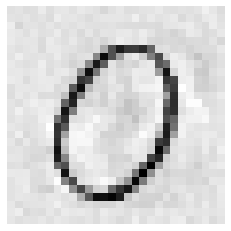

[2480] (예측값)9 (실제값)7


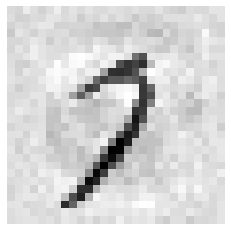

[2482] (예측값)8 (실제값)7


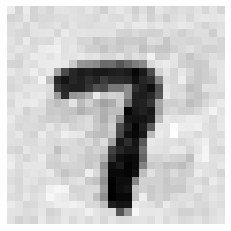

[2483] (예측값)9 (실제값)6


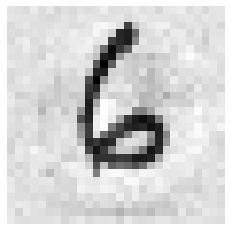

[2485] (예측값)1 (실제값)0


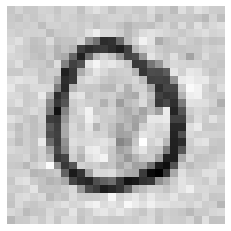

[2486] (예측값)2 (실제값)6


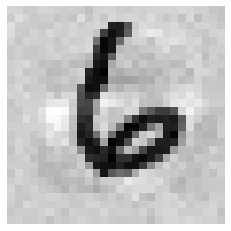

[2488] (예측값)4 (실제값)2


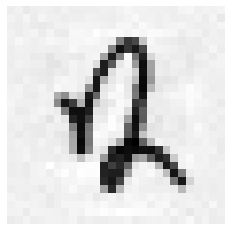

[2496] (예측값)4 (실제값)2


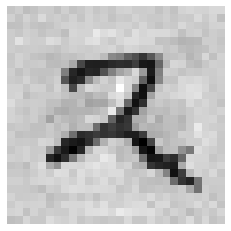

[2497] (예측값)5 (실제값)9


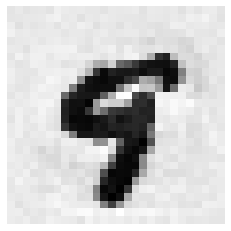

[2499] (예측값)9 (실제값)4


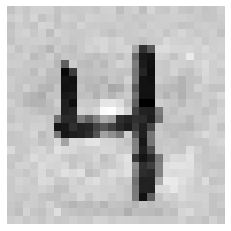

[2502] (예측값)8 (실제값)3


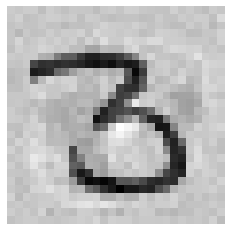

[2504] (예측값)2 (실제값)1


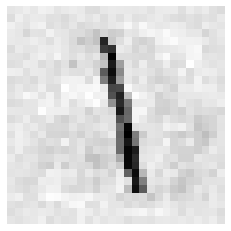

[2507] (예측값)9 (실제값)7


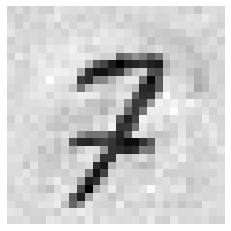

[2508] (예측값)7 (실제값)6


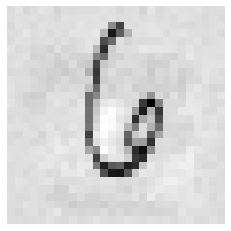

[2509] (예측값)8 (실제값)4


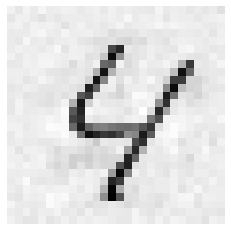

[2510] (예측값)9 (실제값)1


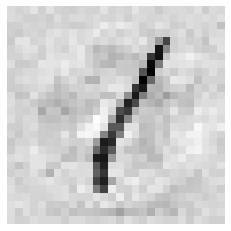

[2514] (예측값)3 (실제값)4


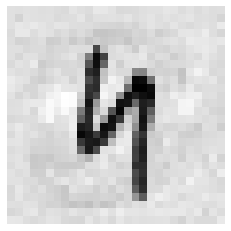

[2515] (예측값)4 (실제값)5


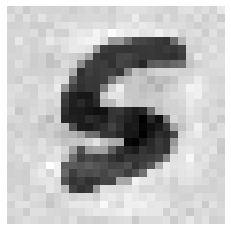

[2521] (예측값)0 (실제값)7


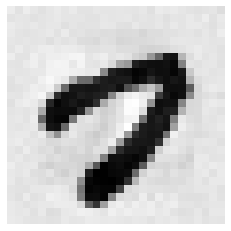

[2523] (예측값)2 (실제값)7


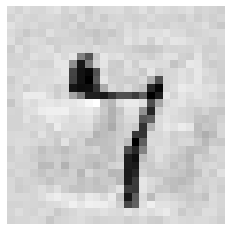

[2525] (예측값)4 (실제값)5


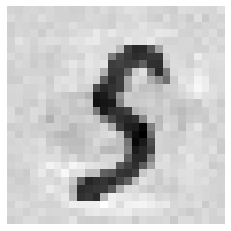

[2526] (예측값)8 (실제값)5


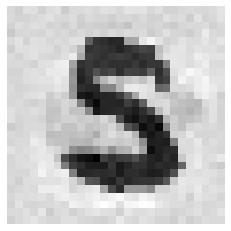

[2528] (예측값)8 (실제값)9


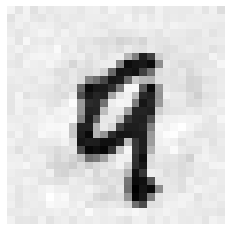

[2529] (예측값)9 (실제값)1


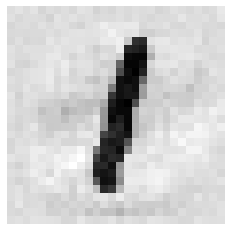

[2532] (예측값)2 (실제값)6


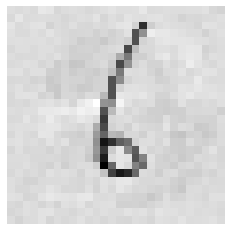

[2533] (예측값)7 (실제값)3


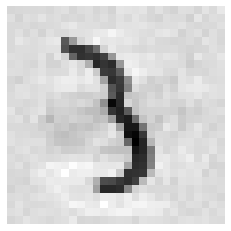

[2534] (예측값)5 (실제값)3


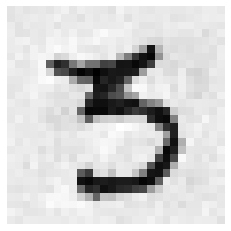

[2537] (예측값)9 (실제값)4


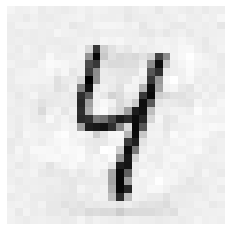

[2539] (예측값)3 (실제값)7


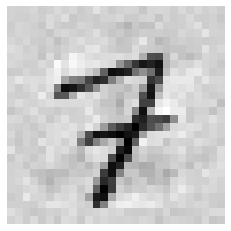

[2542] (예측값)4 (실제값)6


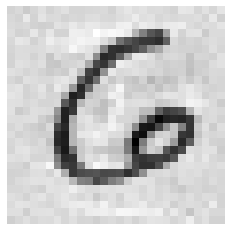

[2545] (예측값)3 (실제값)5


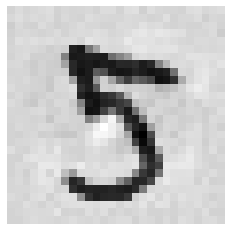

[2546] (예측값)8 (실제값)5


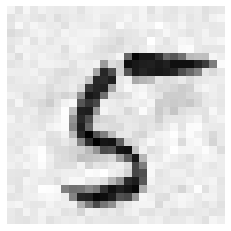

[2548] (예측값)0 (실제값)9


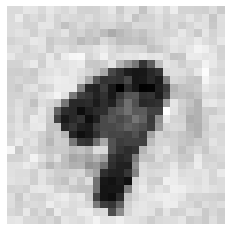

[2556] (예측값)9 (실제값)5


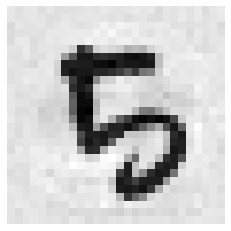

[2559] (예측값)3 (실제값)5


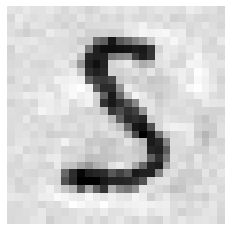

[2562] (예측값)7 (실제값)6


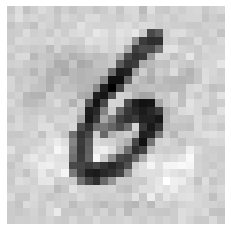

[2564] (예측값)9 (실제값)7


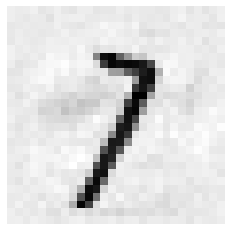

[2569] (예측값)4 (실제값)5


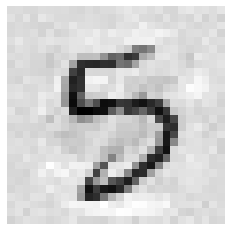

[2573] (예측값)8 (실제값)5


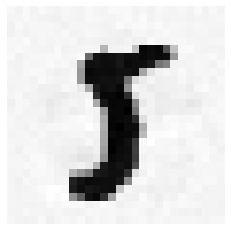

[2574] (예측값)9 (실제값)5


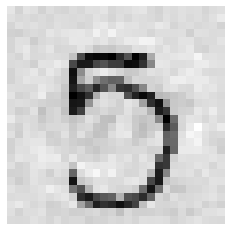

[2577] (예측값)3 (실제값)7


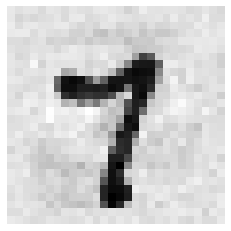

[2578] (예측값)9 (실제값)7


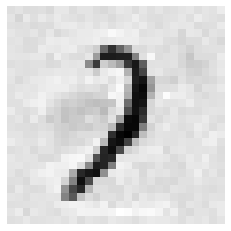

[2580] (예측값)7 (실제값)6


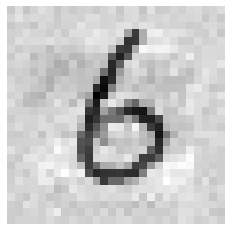

[2582] (예측값)0 (실제값)9


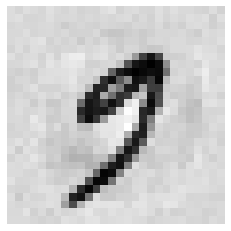

[2584] (예측값)6 (실제값)8


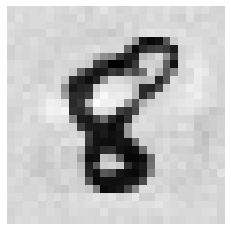

[2586] (예측값)4 (실제값)5


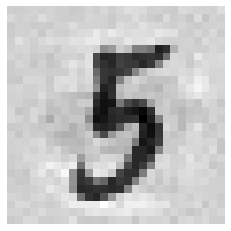

[2588] (예측값)5 (실제값)7


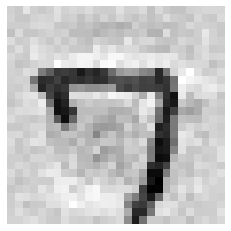

[2589] (예측값)7 (실제값)9


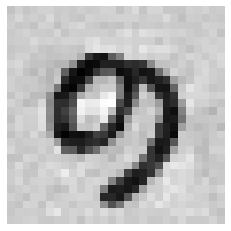

[2590] (예측값)8 (실제값)1


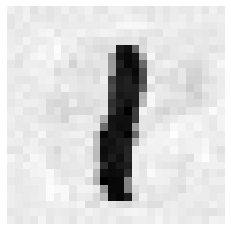

[2591] (예측값)9 (실제값)7


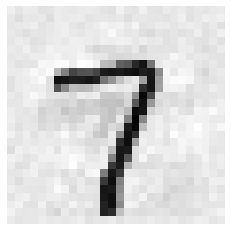

[2593] (예측값)1 (실제값)0


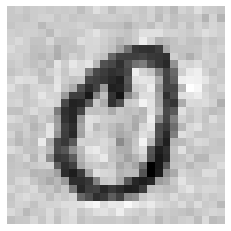

[2597] (예측값)8 (실제값)5


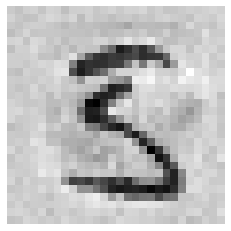

[2598] (예측값)7 (실제값)8


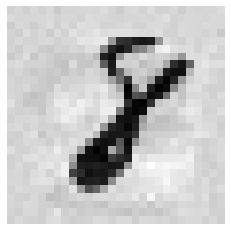

[2599] (예측값)8 (실제값)1


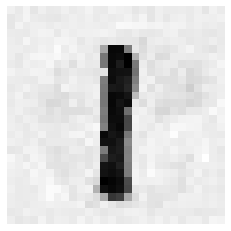

[2601] (예측값)0 (실제값)6


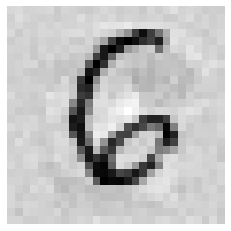

[2602] (예측값)1 (실제값)2


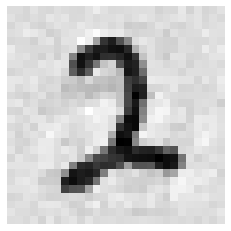

[2604] (예측값)3 (실제값)5


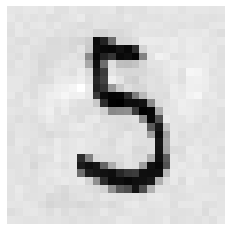

[2607] (예측값)8 (실제값)7


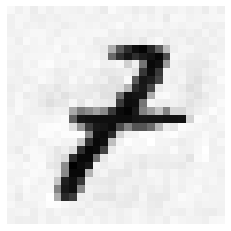

[2608] (예측값)9 (실제값)8


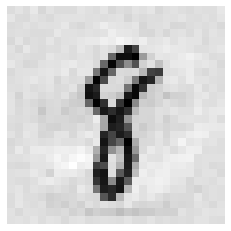

[2609] (예측값)0 (실제값)6


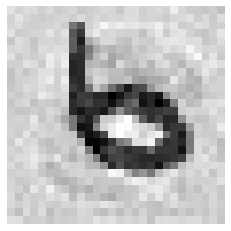

[2610] (예측값)8 (실제값)2


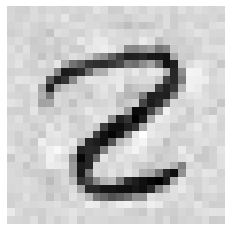

[2614] (예측값)6 (실제값)8


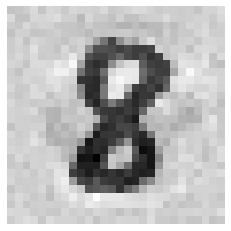

[2617] (예측값)9 (실제값)8


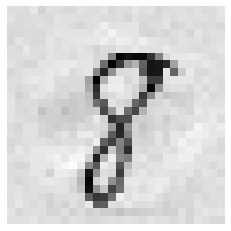

[2619] (예측값)2 (실제값)0


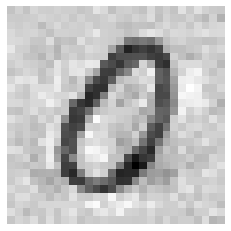

[2622] (예측값)4 (실제값)7


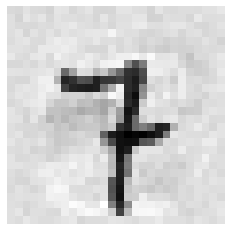

[2623] (예측값)5 (실제값)3


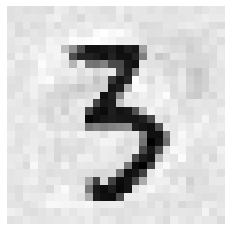

[2624] (예측값)8 (실제값)3


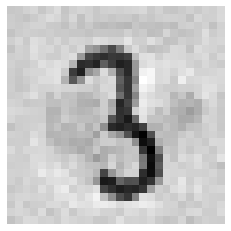

[2625] (예측값)1 (실제값)2


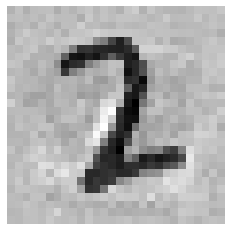

[2626] (예측값)8 (실제값)1


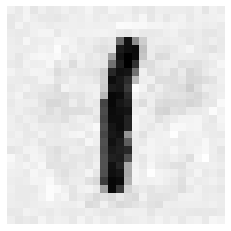

[2634] (예측값)6 (실제값)3


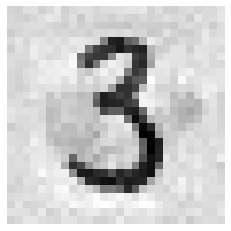

[2635] (예측값)7 (실제값)2


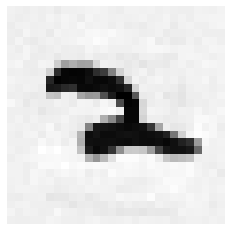

[2636] (예측값)9 (실제값)8


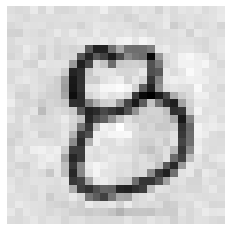

[2640] (예측값)3 (실제값)8


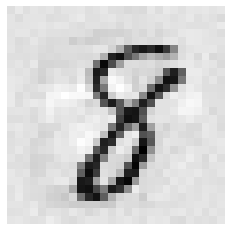

[2642] (예측값)5 (실제값)7


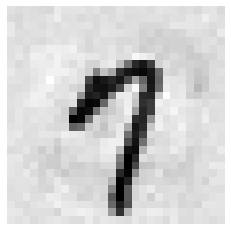

[2645] (예측값)9 (실제값)4


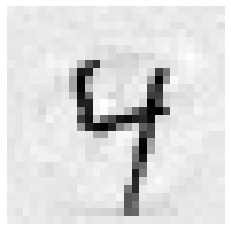

[2648] (예측값)5 (실제값)9


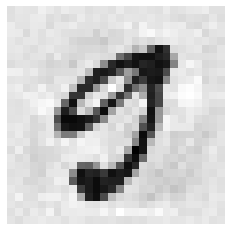

[2650] (예측값)4 (실제값)8


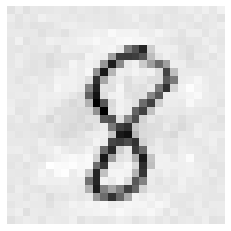

[2651] (예측값)5 (실제값)6


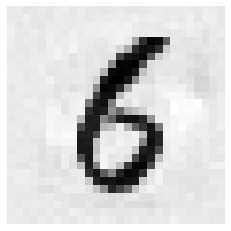

[2654] (예측값)8 (실제값)6


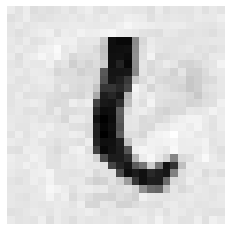

[2655] (예측값)9 (실제값)1


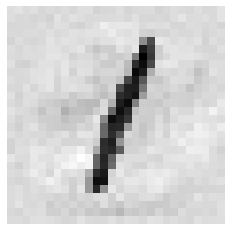

[2657] (예측값)1 (실제값)0


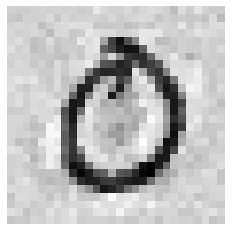

[2659] (예측값)3 (실제값)4


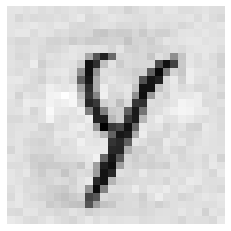

[2663] (예측값)7 (실제값)3


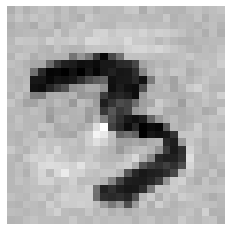

[2664] (예측값)8 (실제값)2


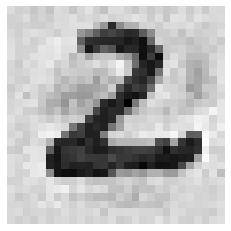

[2665] (예측값)9 (실제값)7


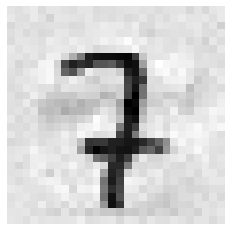

[2666] (예측값)2 (실제값)7


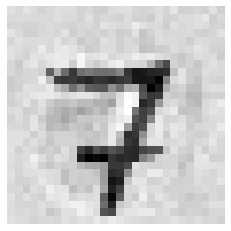

[2671] (예측값)9 (실제값)7


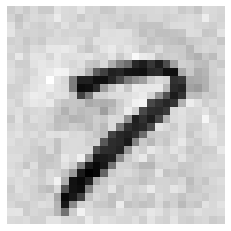

[2672] (예측값)4 (실제값)6


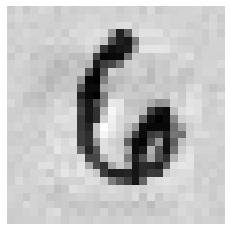

[2673] (예측값)8 (실제값)9


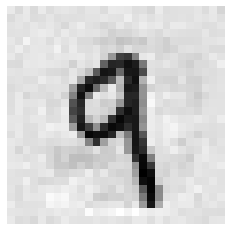

[2676] (예측값)2 (실제값)1


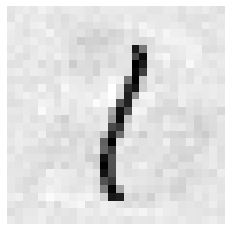

[2678] (예측값)5 (실제값)4


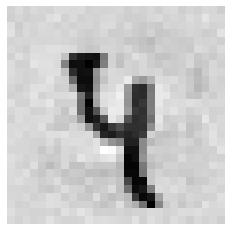

[2679] (예측값)6 (실제값)2


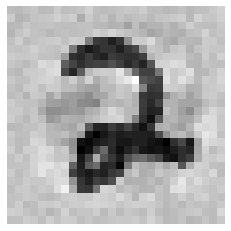

[2681] (예측값)8 (실제값)3


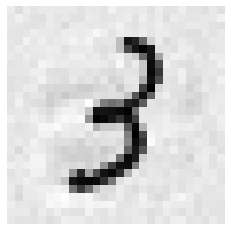

[2682] (예측값)9 (실제값)5


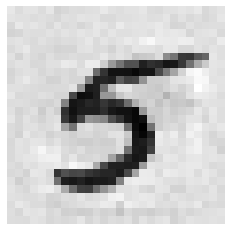

[2684] (예측값)1 (실제값)3


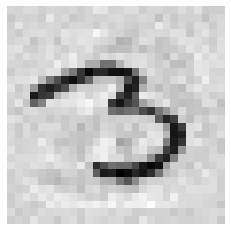

[2686] (예측값)3 (실제값)5


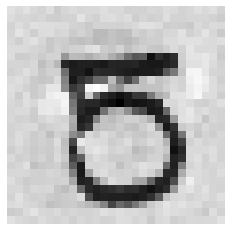

[2688] (예측값)5 (실제값)1


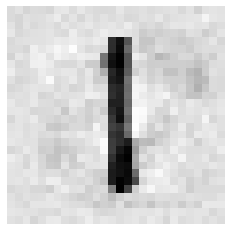

[2689] (예측값)6 (실제값)5


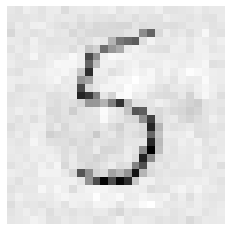

[2690] (예측값)7 (실제값)3


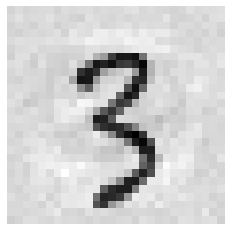

[2692] (예측값)0 (실제값)9


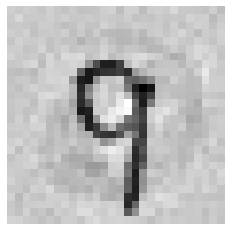

[2695] (예측값)4 (실제값)7


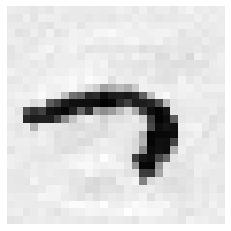

[2698] (예측값)7 (실제값)5


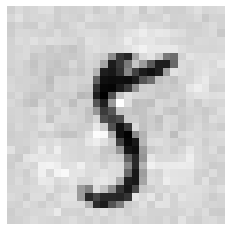

[2699] (예측값)8 (실제값)2


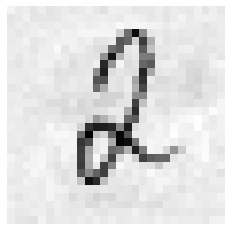

[2700] (예측값)9 (실제값)7


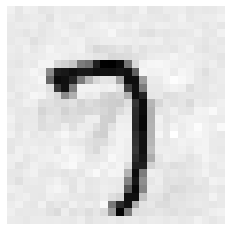

[2703] (예측값)2 (실제값)0


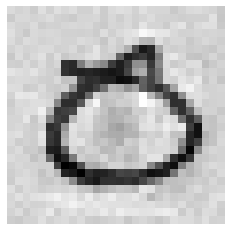

[2704] (예측값)3 (실제값)1


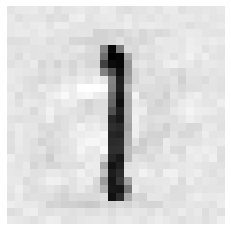

[2706] (예측값)5 (실제값)1


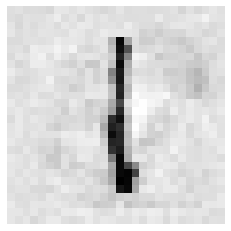

[2708] (예측값)7 (실제값)4


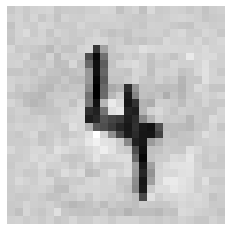

[2709] (예측값)8 (실제값)4


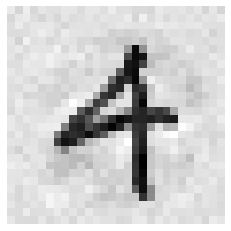

[2710] (예측값)9 (실제값)7


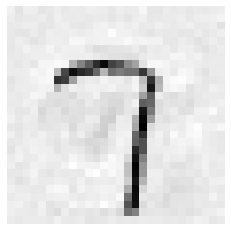

[2713] (예측값)8 (실제값)0


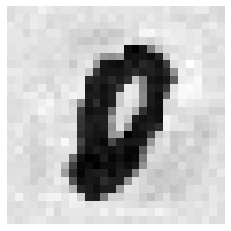

[2719] (예측값)9 (실제값)1


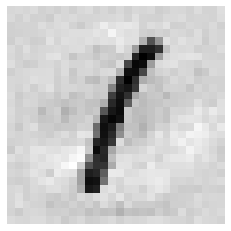

[2721] (예측값)5 (실제값)6


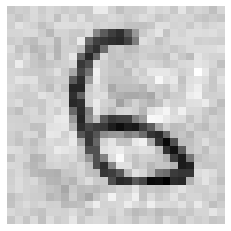

[2722] (예측값)2 (실제값)1


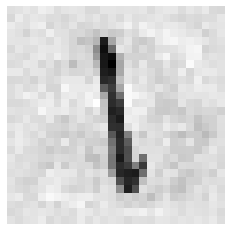

[2724] (예측값)5 (실제값)8


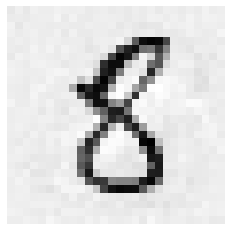

[2725] (예측값)6 (실제값)1


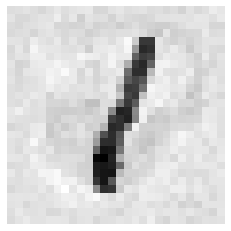

[2727] (예측값)8 (실제값)5


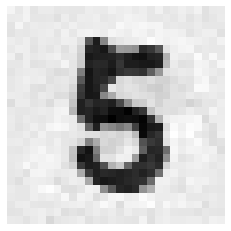

[2729] (예측값)0 (실제값)2


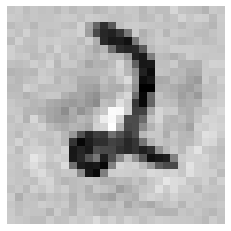

[2730] (예측값)1 (실제값)7


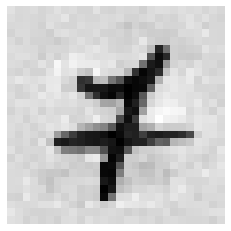

[2735] (예측값)6 (실제값)9


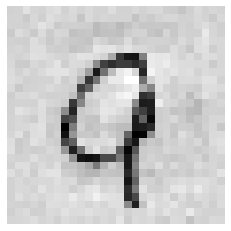

[2736] (예측값)2 (실제값)7


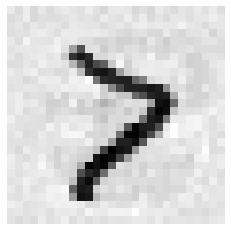

[2737] (예측값)9 (실제값)6


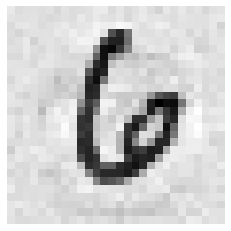

[2741] (예측값)3 (실제값)2


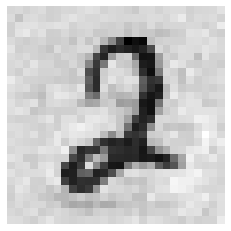

[2743] (예측값)6 (실제값)5


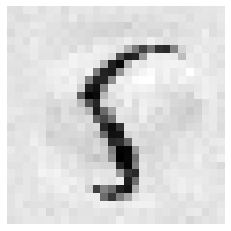

[2745] (예측값)8 (실제값)3


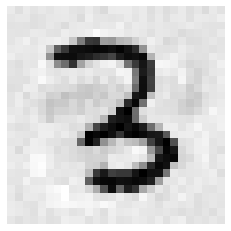

[2748] (예측값)1 (실제값)0


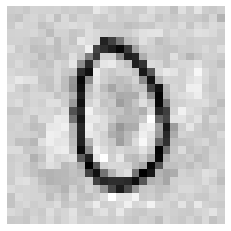

[2749] (예측값)5 (실제값)7


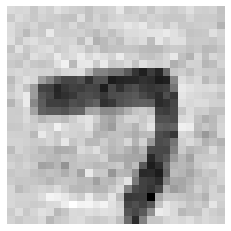

[2753] (예측값)6 (실제값)1


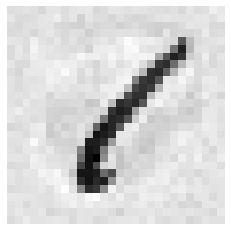

[2755] (예측값)8 (실제값)9


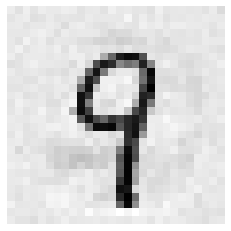

[2760] (예측값)3 (실제값)9


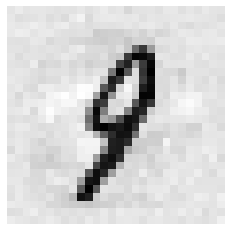

[2761] (예측값)4 (실제값)0


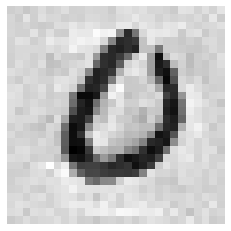

[2762] (예측값)5 (실제값)6


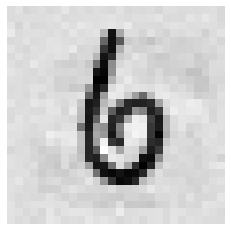

[2766] (예측값)9 (실제값)6


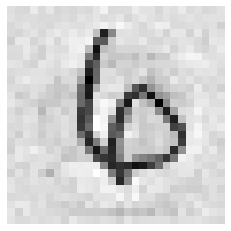

[2771] (예측값)5 (실제값)4


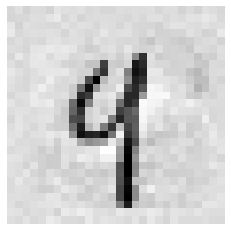

[2773] (예측값)7 (실제값)5


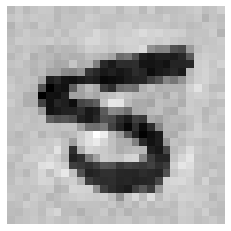

[2777] (예측값)2 (실제값)0


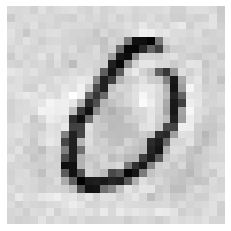

[2778] (예측값)3 (실제값)4


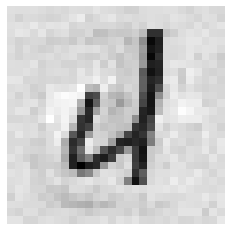

[2779] (예측값)4 (실제값)0


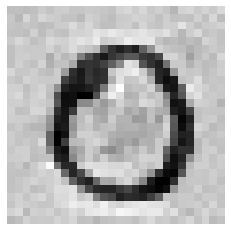

[2780] (예측값)3 (실제값)2


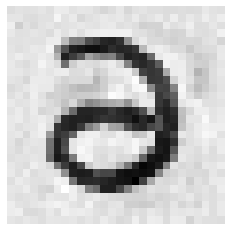

[2781] (예측값)4 (실제값)9


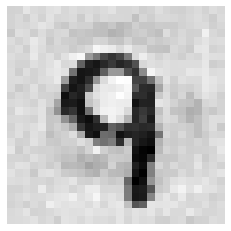

[2783] (예측값)9 (실제값)8


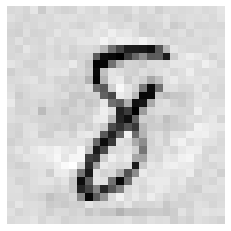

[2786] (예측값)2 (실제값)1


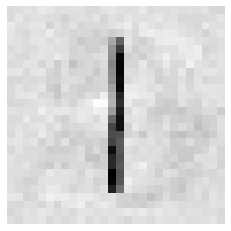

[2788] (예측값)4 (실제값)1


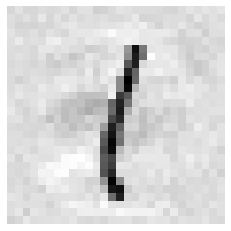

[2793] (예측값)9 (실제값)8


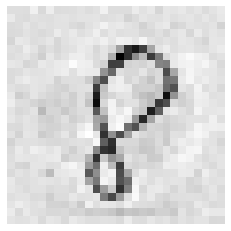

[2799] (예측값)5 (실제값)3


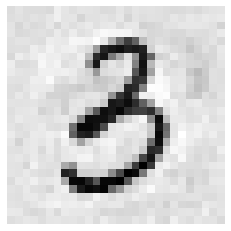

[2800] (예측값)6 (실제값)8


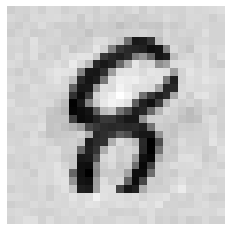

[2802] (예측값)8 (실제값)2


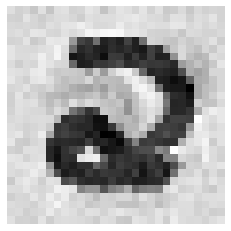

[2804] (예측값)0 (실제값)4


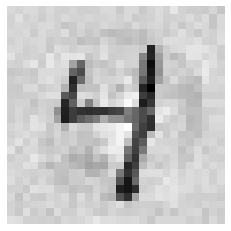

[2805] (예측값)1 (실제값)5


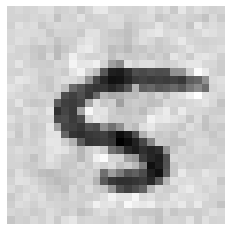

[2808] (예측값)5 (실제값)7


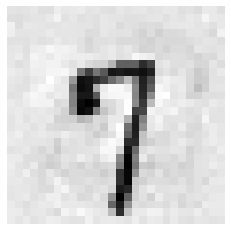

[2810] (예측값)7 (실제값)5


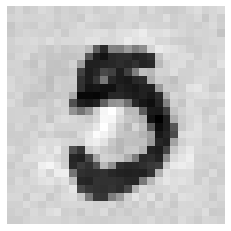

[2815] (예측값)3 (실제값)1


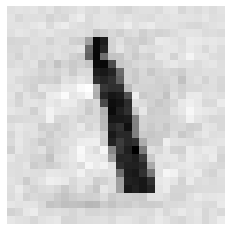

[2821] (예측값)9 (실제값)0


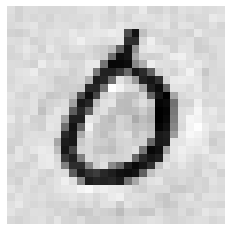

[2823] (예측값)3 (실제값)7


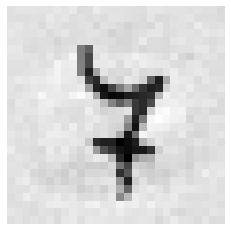

[2824] (예측값)2 (실제값)0


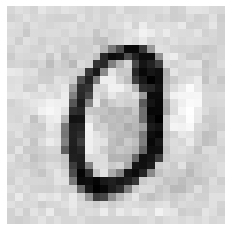

[2825] (예측값)3 (실제값)1


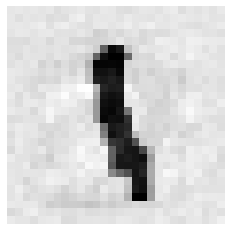

[2827] (예측값)5 (실제값)1


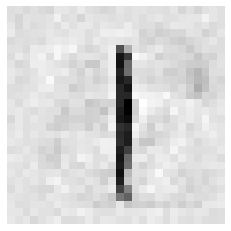

[2831] (예측값)9 (실제값)6


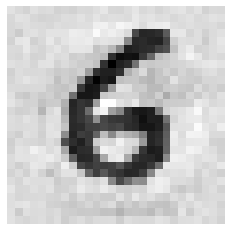

[2832] (예측값)9 (실제값)5


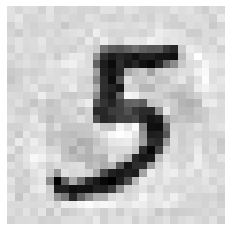

[2838] (예측값)1 (실제값)2


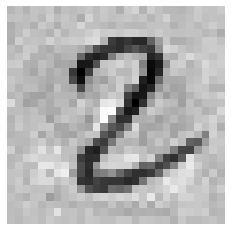

[2845] (예측값)4 (실제값)9


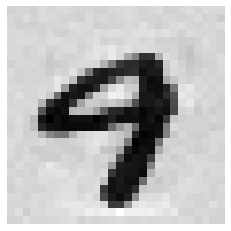

[2847] (예측값)6 (실제값)4


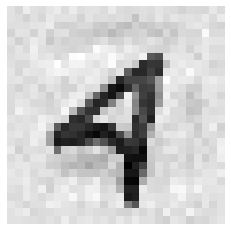

[2850] (예측값)0 (실제값)5


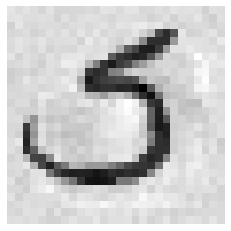

[2853] (예측값)8 (실제값)3


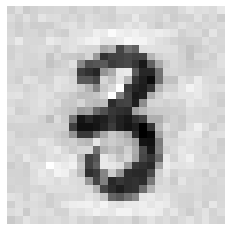

[2857] (예측값)8 (실제값)9


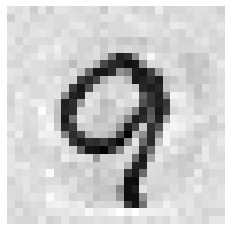

[2858] (예측값)8 (실제값)9


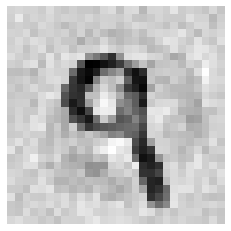

[2860] (예측값)2 (실제값)6


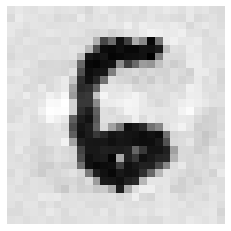

[2861] (예측값)1 (실제값)2


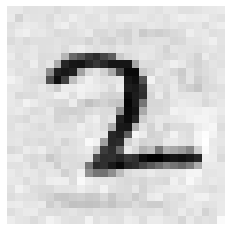

[2863] (예측값)5 (실제값)9


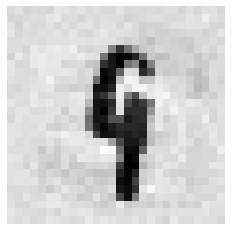

[2866] (예측값)8 (실제값)6


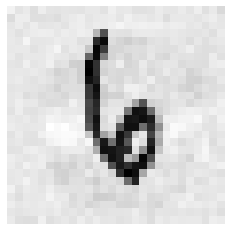

[2867] (예측값)9 (실제값)1


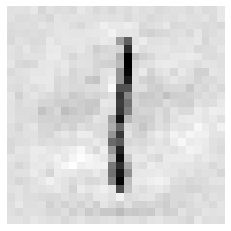

[2870] (예측값)2 (실제값)9


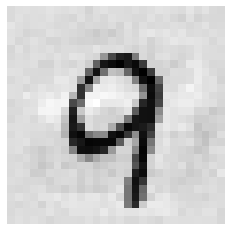

[2872] (예측값)5 (실제값)4


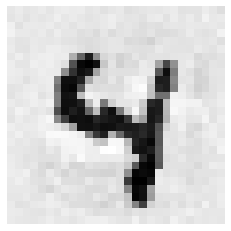

[2873] (예측값)6 (실제값)0


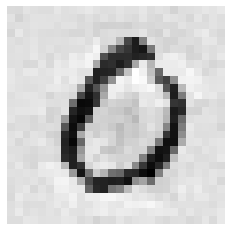

[2877] (예측값)2 (실제값)4


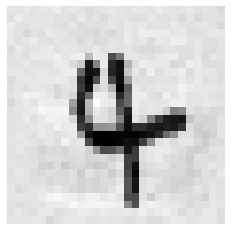

[2882] (예측값)8 (실제값)4


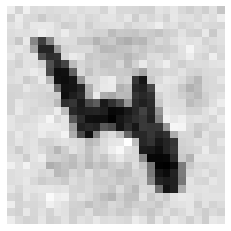

[2885] (예측값)2 (실제값)1


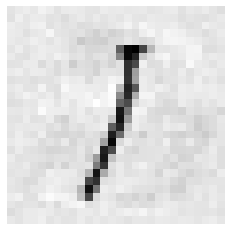

[2887] (예측값)4 (실제값)7


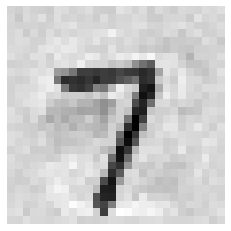

[2888] (예측값)5 (실제값)7


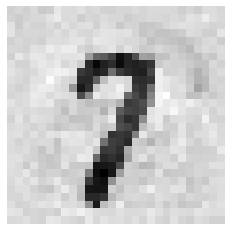

[2896] (예측값)4 (실제값)8


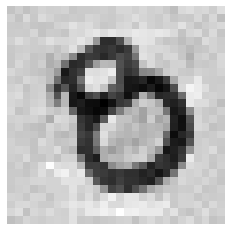

[2901] (예측값)9 (실제값)4


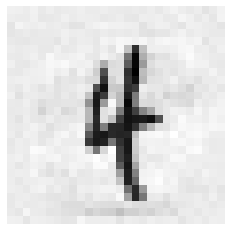

[2902] (예측값)7 (실제값)1


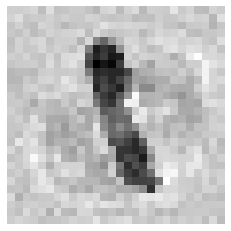

[2906] (예측값)5 (실제값)3


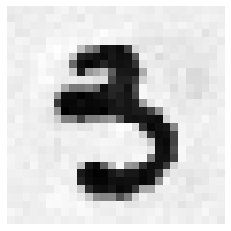

[2909] (예측값)8 (실제값)5


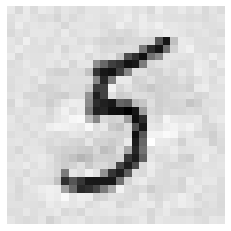

[2910] (예측값)9 (실제값)2


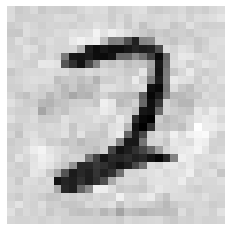

[2911] (예측값)0 (실제값)8


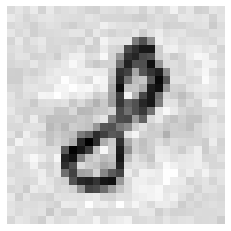

[2914] (예측값)7 (실제값)3


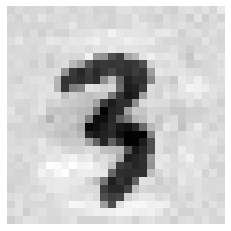

[2915] (예측값)5 (실제값)7


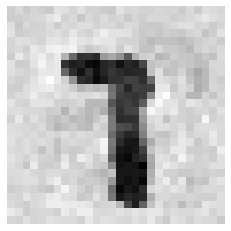

[2917] (예측값)9 (실제값)4


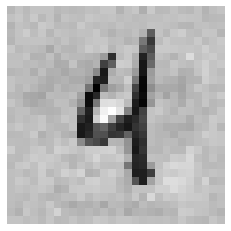

[2919] (예측값)9 (실제값)5


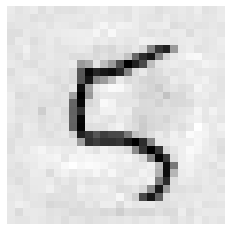

[2920] (예측값)0 (실제값)6


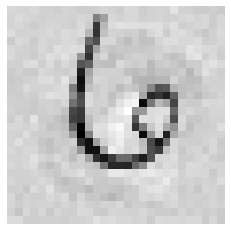

[2924] (예측값)4 (실제값)3


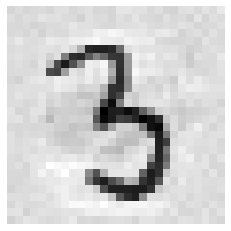

[2927] (예측값)4 (실제값)3


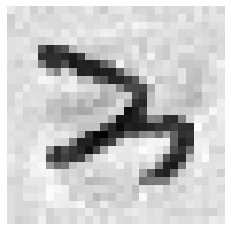

[2928] (예측값)9 (실제값)1


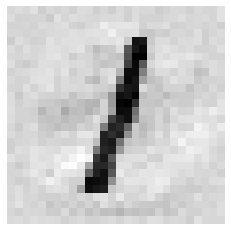

[2930] (예측값)1 (실제값)5


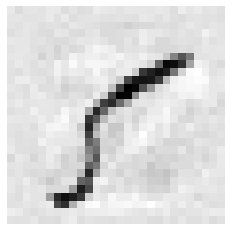

[2933] (예측값)4 (실제값)6


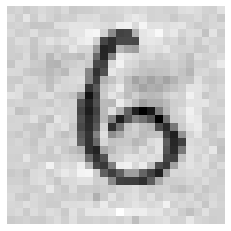

[2937] (예측값)8 (실제값)0


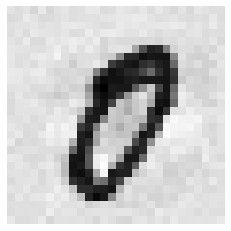

[2938] (예측값)9 (실제값)4


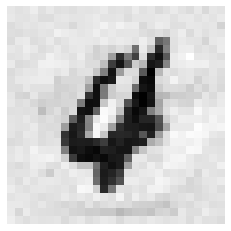

[2939] (예측값)5 (실제값)9


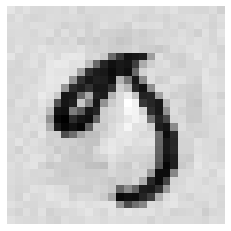

[2940] (예측값)1 (실제값)2


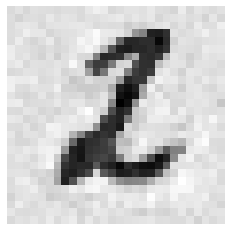

[2944] (예측값)5 (실제값)0


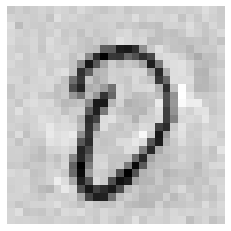

[2945] (예측값)7 (실제값)3


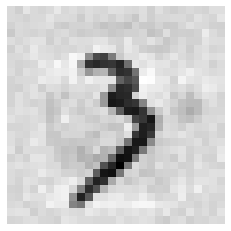

[2947] (예측값)8 (실제값)6


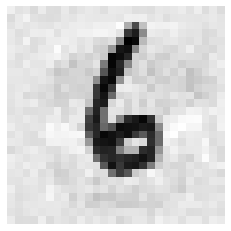

[2949] (예측값)0 (실제값)8


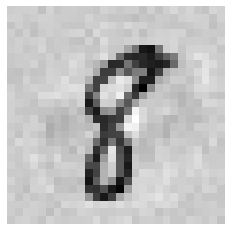

[2952] (예측값)8 (실제값)3


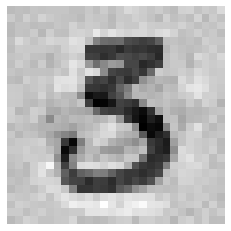

[2953] (예측값)5 (실제값)3


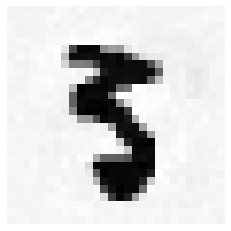

[2954] (예측값)6 (실제값)0


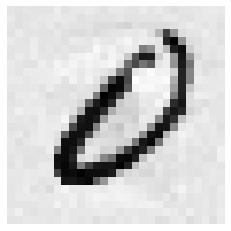

[2956] (예측값)8 (실제값)5


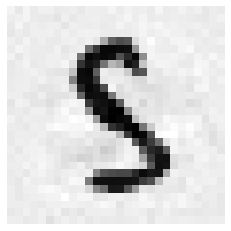

[2961] (예측값)3 (실제값)7


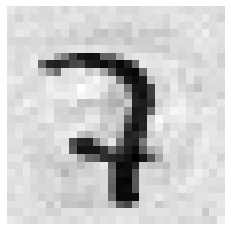

[2964] (예측값)6 (실제값)9


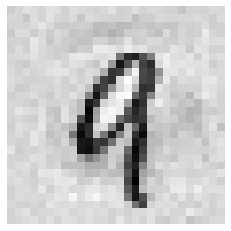

[2966] (예측값)8 (실제값)9


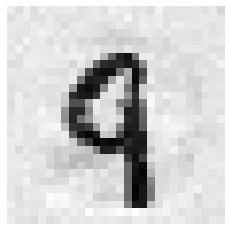

[2969] (예측값)1 (실제값)5


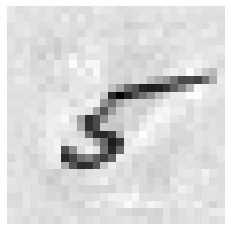

[2970] (예측값)2 (실제값)5


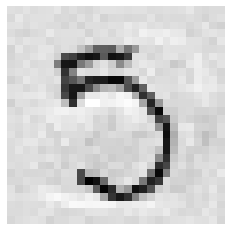

[2971] (예측값)3 (실제값)2


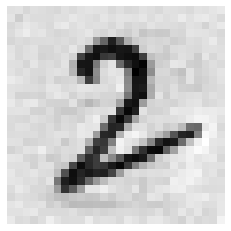

[2972] (예측값)4 (실제값)0


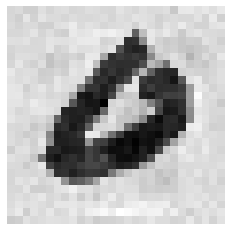

[2974] (예측값)6 (실제값)1


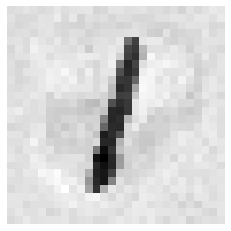

[2976] (예측값)8 (실제값)6


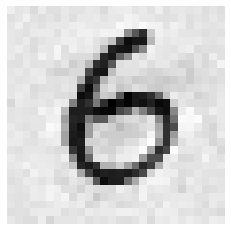

[2979] (예측값)1 (실제값)9


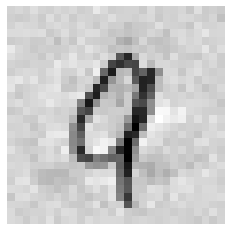

[2987] (예측값)9 (실제값)5


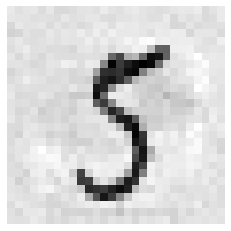

[2989] (예측값)1 (실제값)3


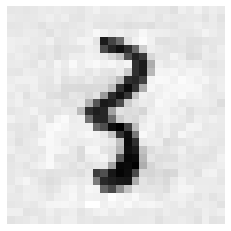

[2993] (예측값)8 (실제값)7


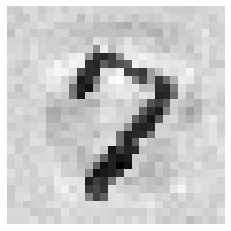

[2994] (예측값)7 (실제값)6


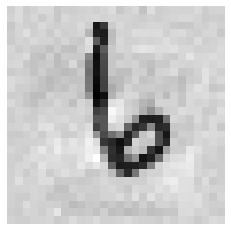

[2995] (예측값)8 (실제값)6


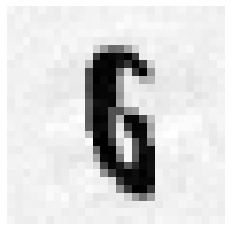

[3000] (예측값)5 (실제값)6


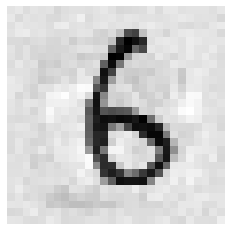

[3001] (예측값)4 (실제값)9


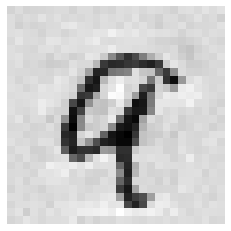

[3002] (예측값)5 (실제값)8


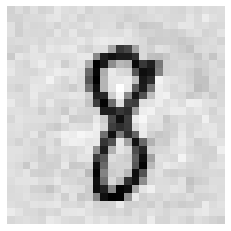

[3005] (예측값)8 (실제값)9


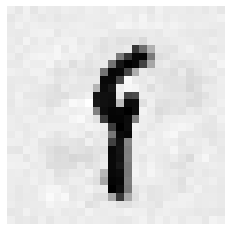

[3006] (예측값)0 (실제값)9


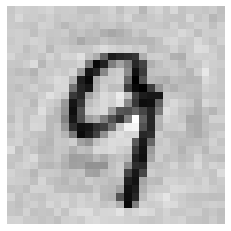

[3014] (예측값)8 (실제값)1


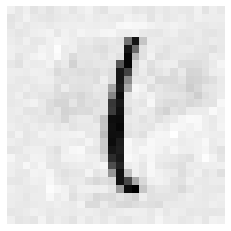

[3015] (예측값)9 (실제값)3


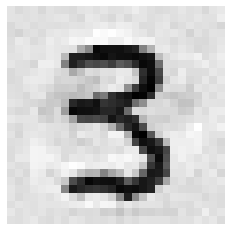

[3022] (예측값)6 (실제값)5


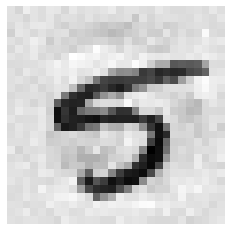

[3025] (예측값)9 (실제값)4


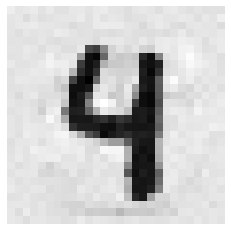

[3026] (예측값)0 (실제값)1


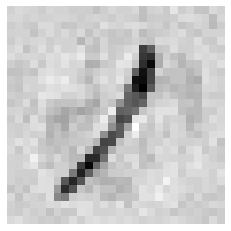

[3027] (예측값)2 (실제값)1


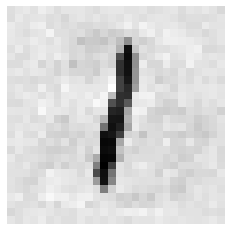

[3028] (예측값)3 (실제값)5


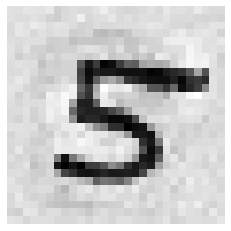

[3029] (예측값)5 (실제값)4


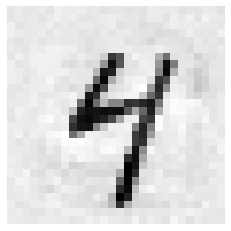

[3030] (예측값)7 (실제값)6


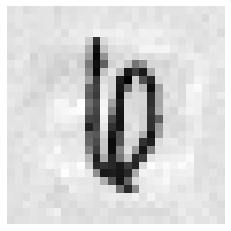

[3032] (예측값)9 (실제값)0


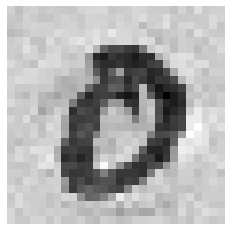

[3033] (예측값)0 (실제값)6


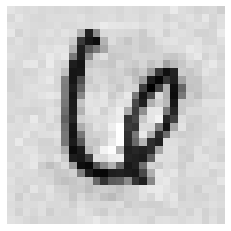

[3036] (예측값)4 (실제값)6


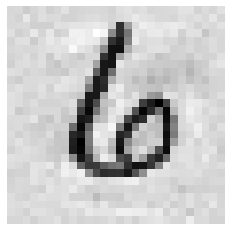

[3038] (예측값)5 (실제값)7


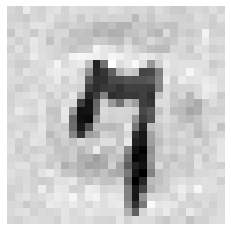

[3039] (예측값)7 (실제값)1


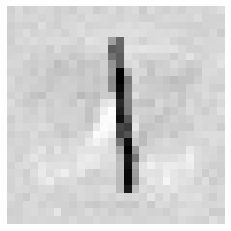

[3041] (예측값)0 (실제값)9


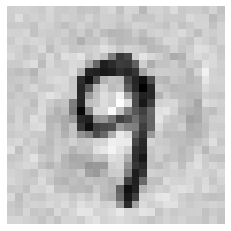

[3043] (예측값)2 (실제값)0


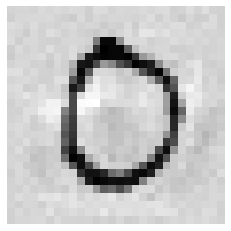

[3049] (예측값)8 (실제값)3


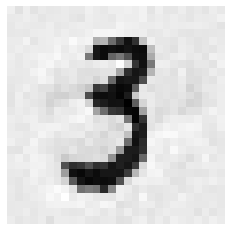

[3050] (예측값)9 (실제값)1


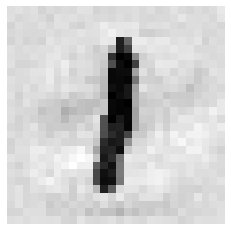

[3058] (예측값)0 (실제값)6


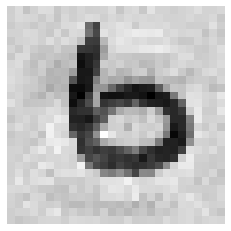

[3059] (예측값)8 (실제값)7


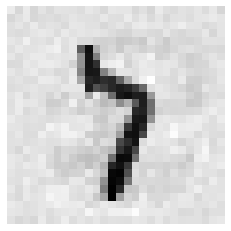

[3060] (예측값)0 (실제값)9


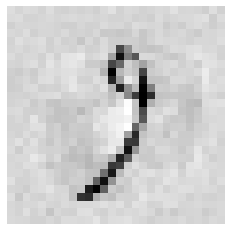

[3062] (예측값)2 (실제값)8


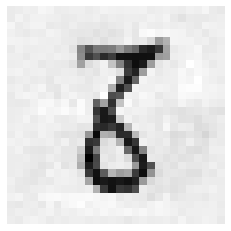

[3063] (예측값)3 (실제값)6


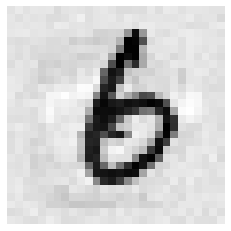

[3065] (예측값)5 (실제값)8


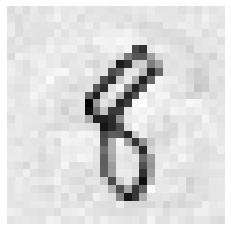

[3067] (예측값)0 (실제값)6


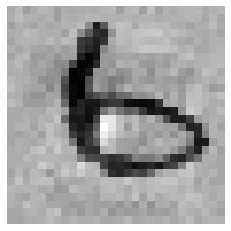

[3068] (예측값)9 (실제값)8


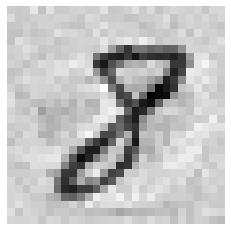

[3073] (예측값)5 (실제값)1


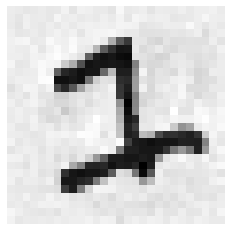

[3074] (예측값)6 (실제값)3


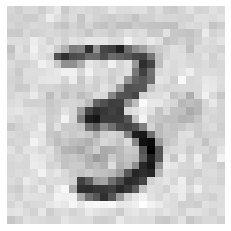

[3077] (예측값)9 (실제값)0


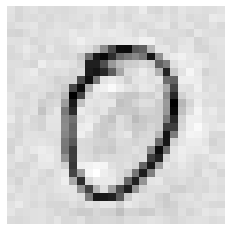

[3078] (예측값)0 (실제값)3


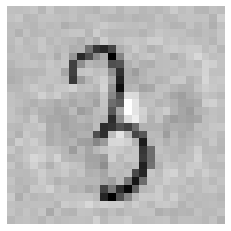

[3084] (예측값)9 (실제값)7


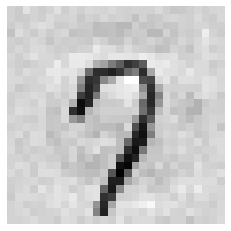

[3086] (예측값)8 (실제값)4


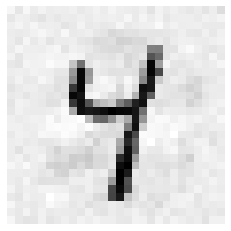

[3087] (예측값)9 (실제값)0


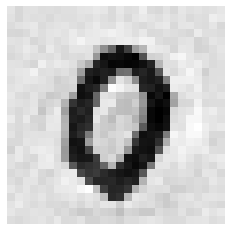

[3090] (예측값)2 (실제값)0


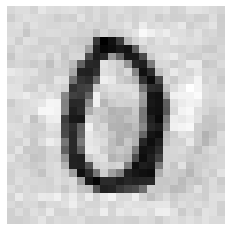

[3091] (예측값)3 (실제값)8


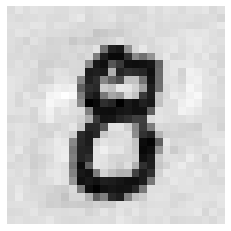

[3092] (예측값)4 (실제값)1


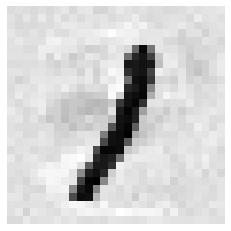

[3095] (예측값)8 (실제값)5


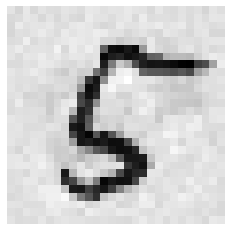

[3096] (예측값)9 (실제값)4


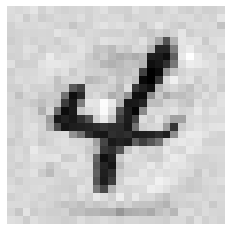

[3097] (예측값)0 (실제값)1


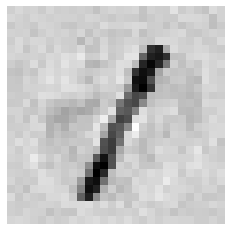

[3101] (예측값)9 (실제값)7


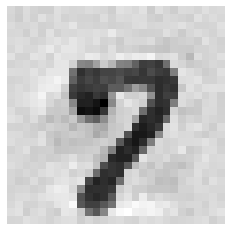

[3102] (예측값)6 (실제값)5


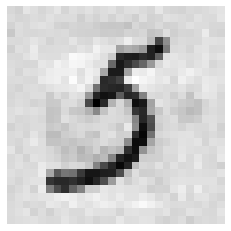

[3103] (예측값)8 (실제값)7


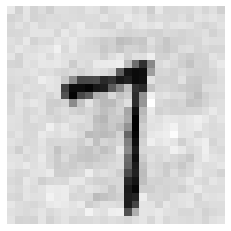

[3104] (예측값)9 (실제값)3


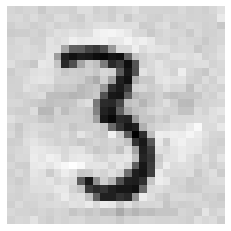

[3106] (예측값)1 (실제값)2


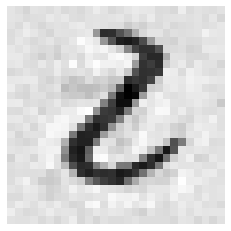

[3108] (예측값)4 (실제값)3


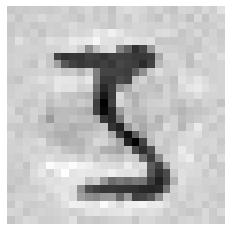

[3109] (예측값)5 (실제값)7


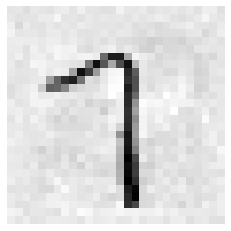

[3110] (예측값)6 (실제값)3


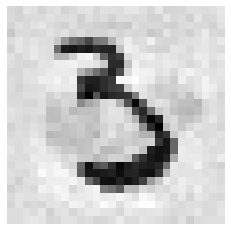

[3112] (예측값)9 (실제값)8


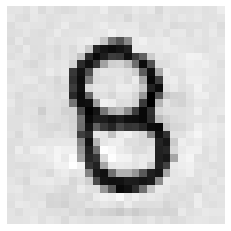

[3117] (예측값)4 (실제값)5


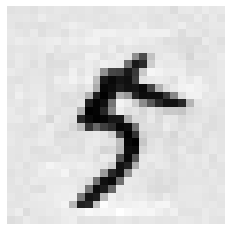

[3123] (예측값)0 (실제값)4


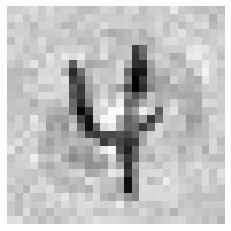

[3127] (예측값)6 (실제값)5


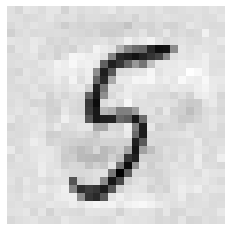

[3128] (예측값)0 (실제값)2


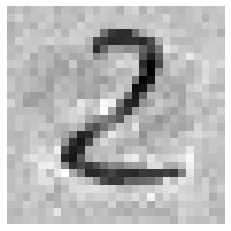

[3129] (예측값)8 (실제값)3


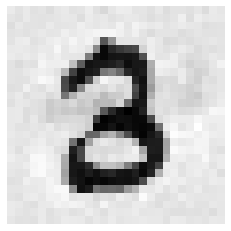

[3130] (예측값)0 (실제값)6


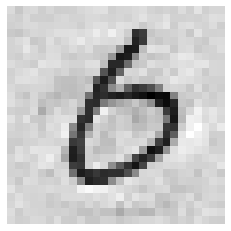

[3132] (예측값)2 (실제값)1


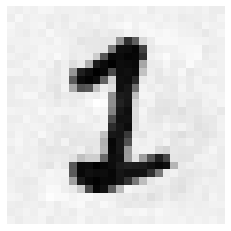

[3133] (예측값)8 (실제값)4


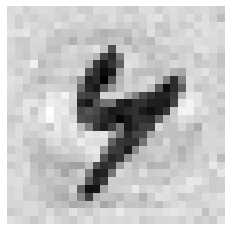

[3134] (예측값)6 (실제값)2


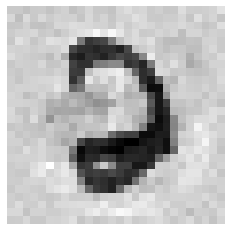

[3136] (예측값)6 (실제값)7


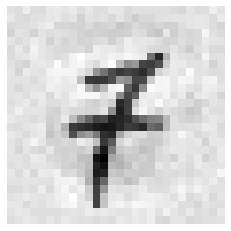

[3138] (예측값)8 (실제값)3


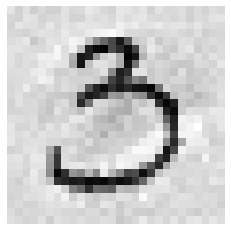

[3139] (예측값)9 (실제값)8


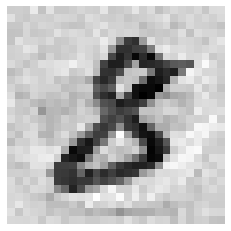

[3146] (예측값)7 (실제값)3


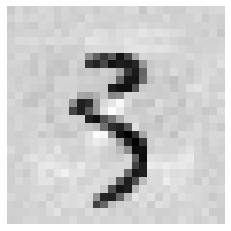

[3147] (예측값)8 (실제값)9


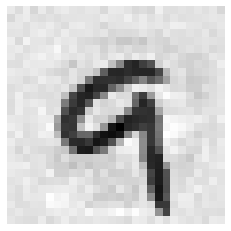

[3148] (예측값)9 (실제값)1


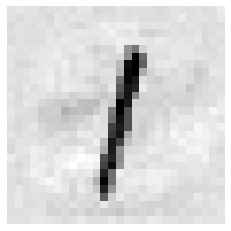

[3151] (예측값)3 (실제값)2


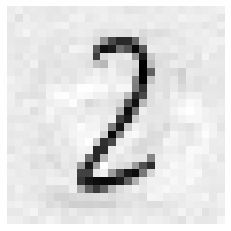

[3152] (예측값)4 (실제값)1


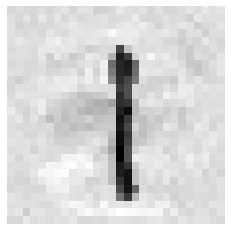

[3153] (예측값)5 (실제값)8


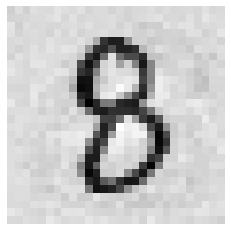

[3156] (예측값)8 (실제값)6


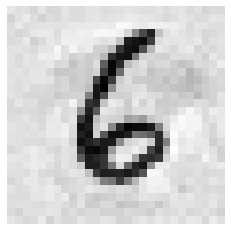

[3157] (예측값)7 (실제값)5


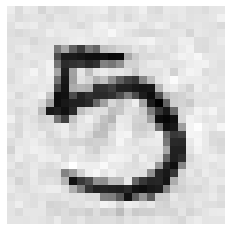

[3158] (예측값)2 (실제값)8


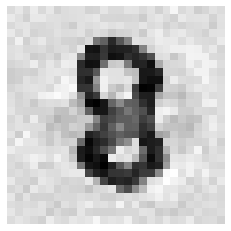

[3161] (예측값)3 (실제값)7


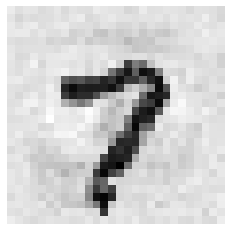

[3162] (예측값)4 (실제값)7


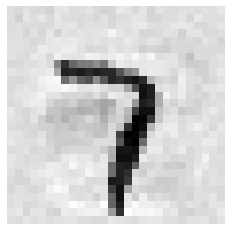

[3163] (예측값)5 (실제값)8


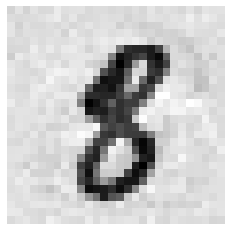

[3166] (예측값)9 (실제값)7


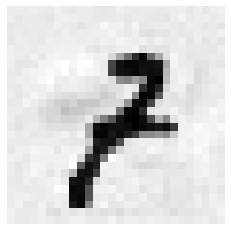

[3168] (예측값)8 (실제값)9


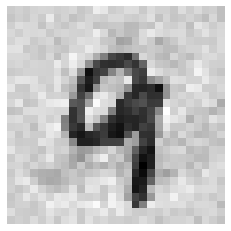

[3171] (예측값)9 (실제값)5


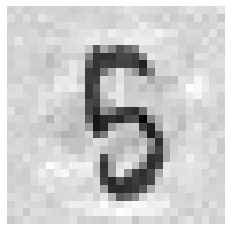

[3173] (예측값)2 (실제값)6


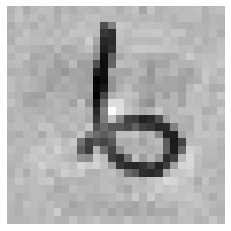

[3175] (예측값)9 (실제값)1


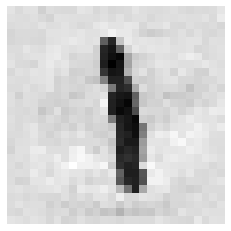

[3181] (예측값)5 (실제값)6


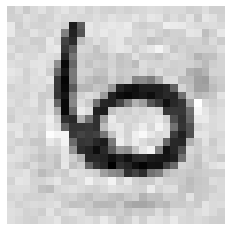

[3183] (예측값)8 (실제값)5


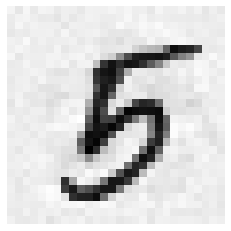

[3189] (예측값)4 (실제값)7


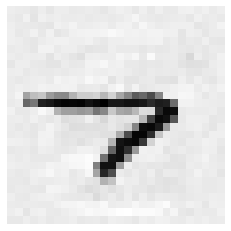

[3191] (예측값)6 (실제값)0


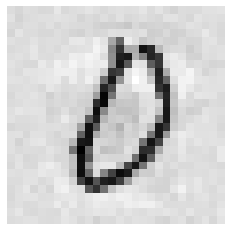

[3193] (예측값)9 (실제값)3


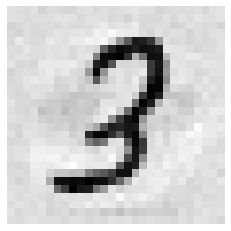

[3196] (예측값)2 (실제값)1


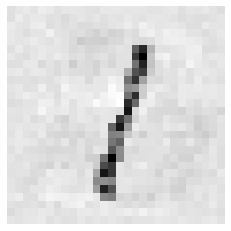

[3198] (예측값)4 (실제값)8


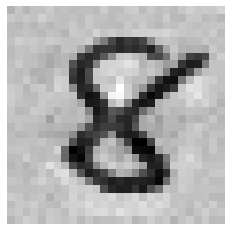

[3202] (예측값)9 (실제값)7


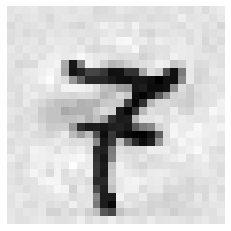

[3203] (예측값)0 (실제값)1


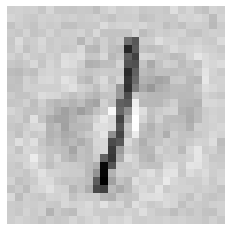

[3206] (예측값)3 (실제값)8


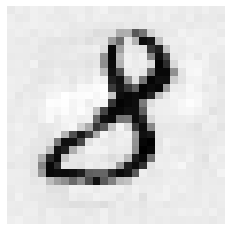

[3208] (예측값)5 (실제값)7


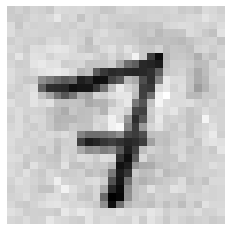

[3209] (예측값)9 (실제값)6


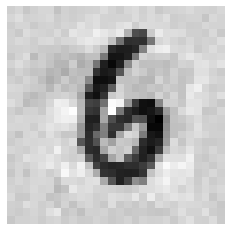

[3211] (예측값)9 (실제값)1


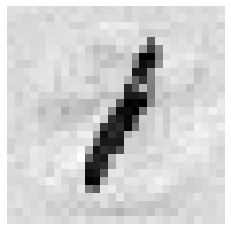

[3213] (예측값)1 (실제값)7


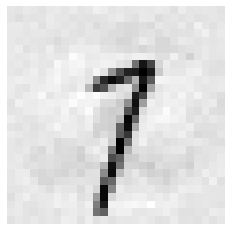

[3214] (예측값)2 (실제값)1


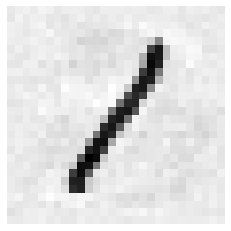

[3218] (예측값)4 (실제값)6


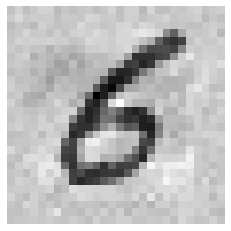

[3219] (예측값)8 (실제값)0


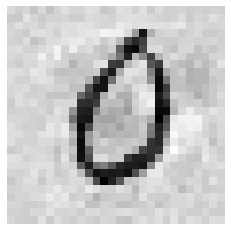

[3225] (예측값)5 (실제값)7


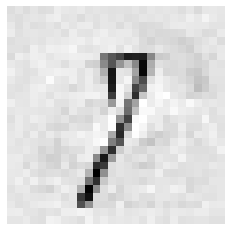

[3228] (예측값)8 (실제값)4


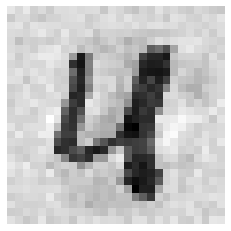

[3229] (예측값)3 (실제값)2


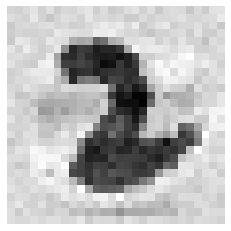

[3230] (예측값)7 (실제값)1


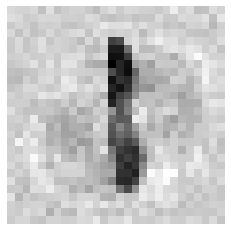

[3232] (예측값)3 (실제값)4


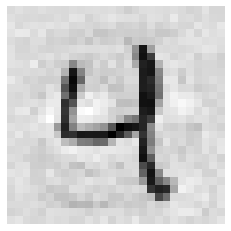

[3233] (예측값)5 (실제값)4


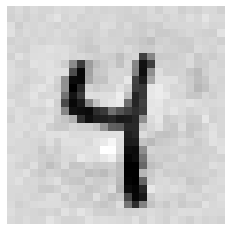

[3236] (예측값)8 (실제값)7


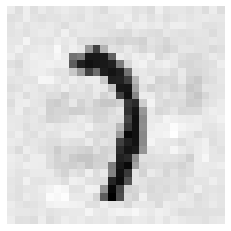

[3237] (예측값)9 (실제값)1


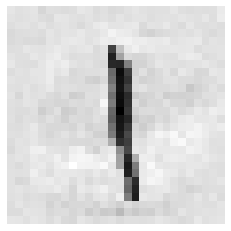

[3238] (예측값)0 (실제값)6


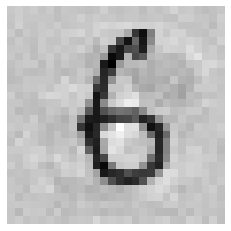

[3240] (예측값)2 (실제값)9


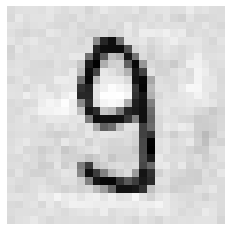

[3242] (예측값)6 (실제값)0


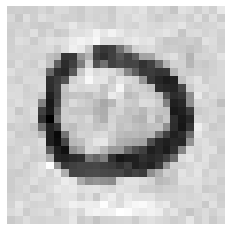

[3243] (예측값)5 (실제값)0


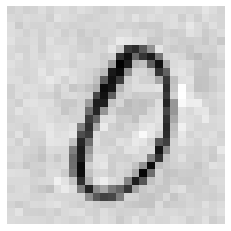

[3244] (예측값)6 (실제값)1


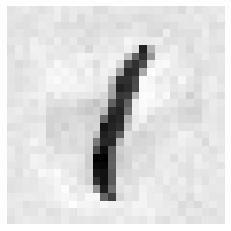

[3246] (예측값)9 (실제값)8


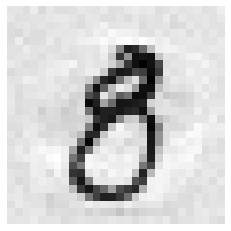

[3250] (예측값)6 (실제값)2


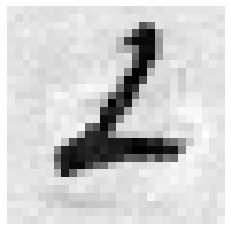

[3251] (예측값)4 (실제값)0


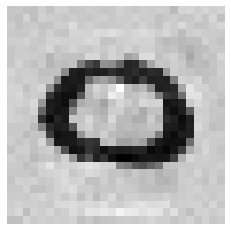

[3252] (예측값)5 (실제값)6


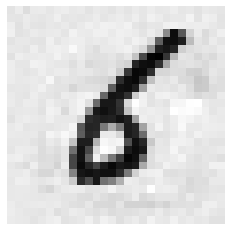

[3254] (예측값)5 (실제값)6


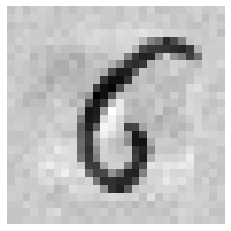

[3256] (예측값)7 (실제값)2


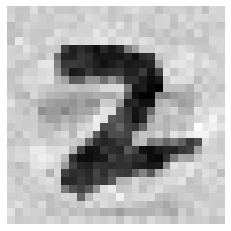

[3260] (예측값)3 (실제값)2


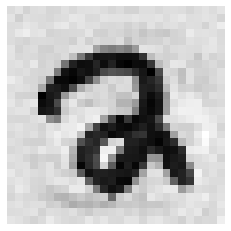

[3261] (예측값)9 (실제값)3


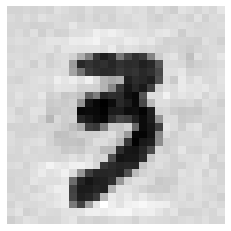

[3262] (예측값)5 (실제값)7


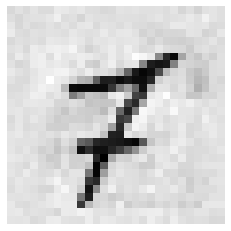

[3268] (예측값)2 (실제값)1


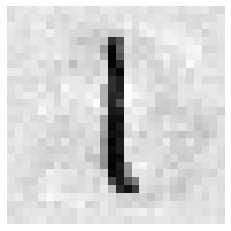

[3269] (예측값)3 (실제값)6


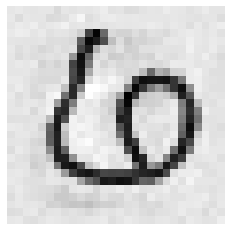

[3272] (예측값)6 (실제값)1


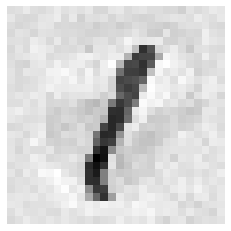

[3273] (예측값)7 (실제값)6


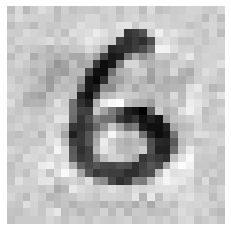

[3277] (예측값)1 (실제값)7


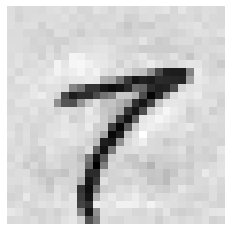

[3279] (예측값)3 (실제값)8


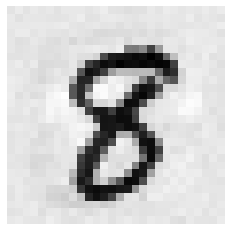

[3284] (예측값)7 (실제값)8


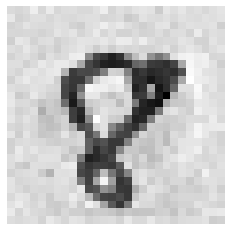

[3286] (예측값)1 (실제값)9


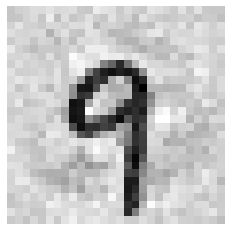

[3289] (예측값)4 (실제값)8


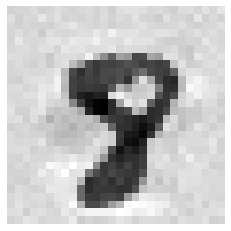

[3292] (예측값)5 (실제값)7


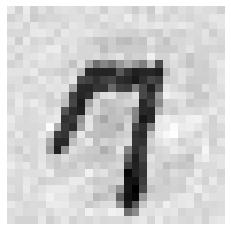

[3298] (예측값)5 (실제값)4


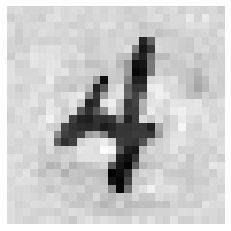

[3299] (예측값)6 (실제값)3


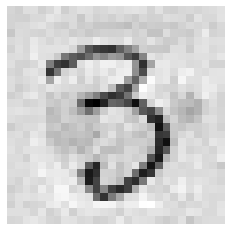

[3302] (예측값)9 (실제값)6


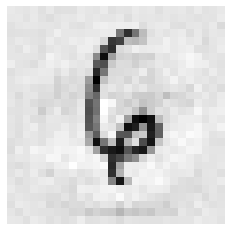

[3304] (예측값)1 (실제값)6


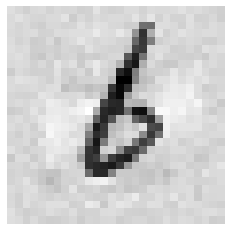

[3308] (예측값)5 (실제값)7


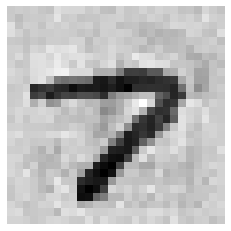

[3310] (예측값)7 (실제값)0


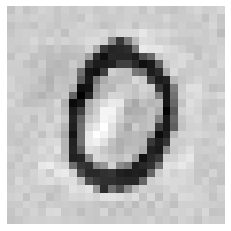

[3312] (예측값)9 (실제값)5


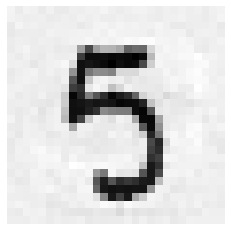

[3316] (예측값)4 (실제값)7


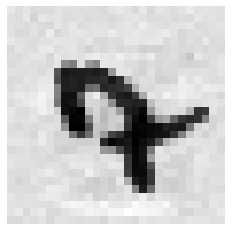

[3317] (예측값)6 (실제값)0


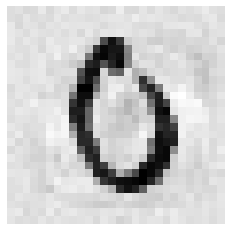

[3329] (예측값)8 (실제값)7


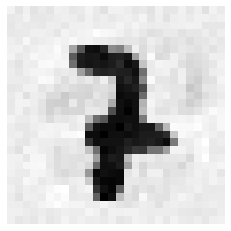

[3330] (예측값)9 (실제값)2


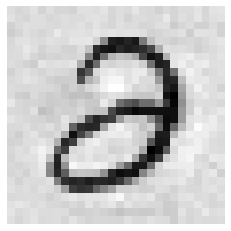

[3333] (예측값)2 (실제값)7


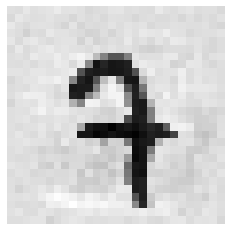

[3334] (예측값)3 (실제값)5


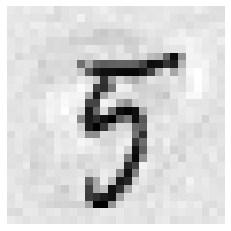

[3335] (예측값)4 (실제값)5


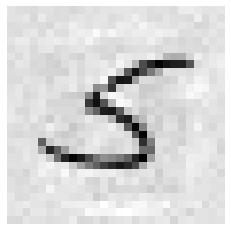

[3338] (예측값)8 (실제값)9


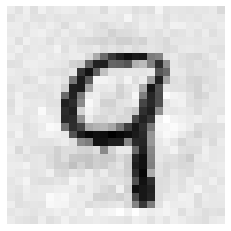

[3344] (예측값)4 (실제값)6


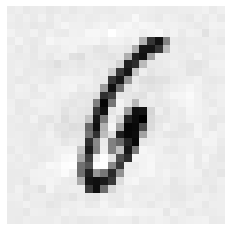

[3348] (예측값)9 (실제값)8


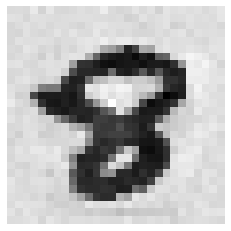

[3351] (예측값)2 (실제값)1


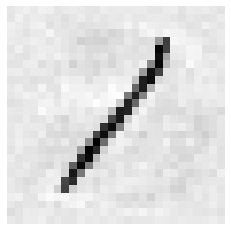

[3352] (예측값)3 (실제값)7


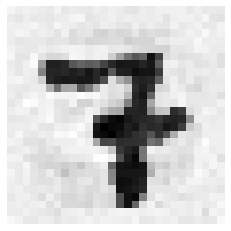

[3353] (예측값)4 (실제값)1


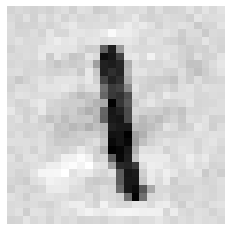

[3365] (예측값)0 (실제값)6


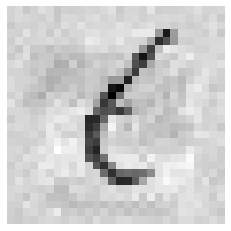

[3369] (예측값)1 (실제값)9


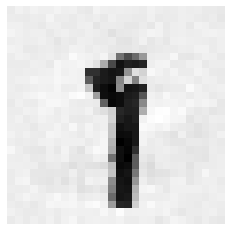

[3373] (예측값)5 (실제값)7


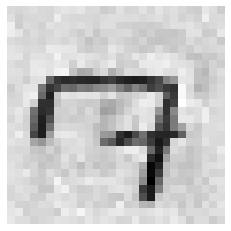

[3374] (예측값)6 (실제값)8


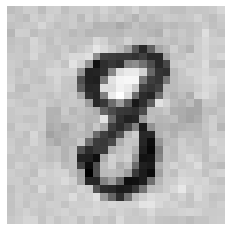

[3375] (예측값)3 (실제값)2


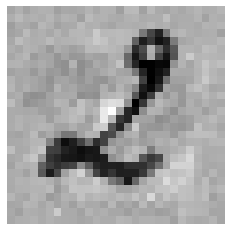

[3376] (예측값)8 (실제값)7


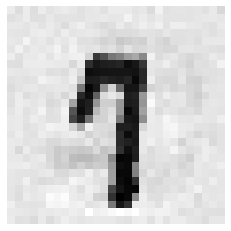

[3377] (예측값)9 (실제값)4


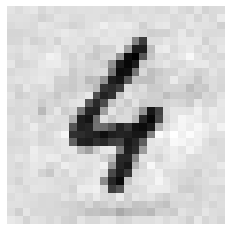

[3378] (예측값)5 (실제값)7


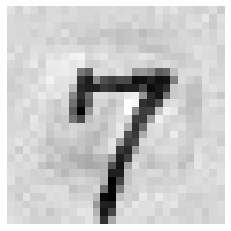

[3380] (예측값)3 (실제값)1


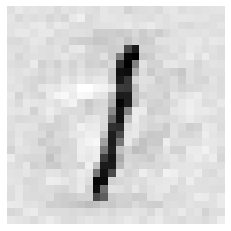

[3388] (예측값)9 (실제값)4


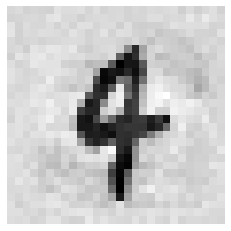

[3396] (예측값)4 (실제값)2


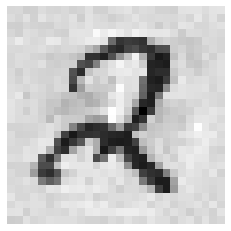

[3399] (예측값)9 (실제값)7


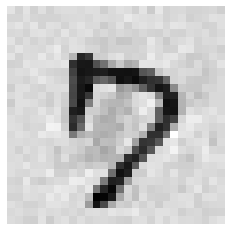

[3404] (예측값)3 (실제값)9


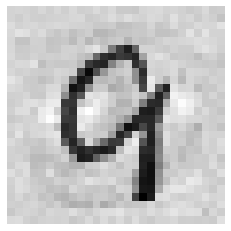

[3405] (예측값)5 (실제값)4


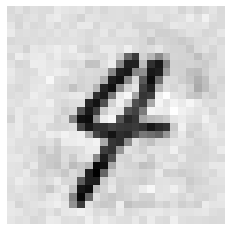

[3410] (예측값)0 (실제값)4


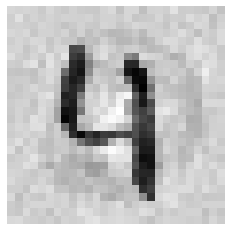

[3412] (예측값)2 (실제값)0


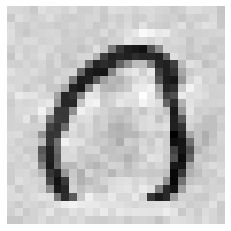

[3414] (예측값)4 (실제값)5


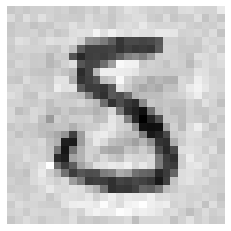

[3417] (예측값)7 (실제값)0


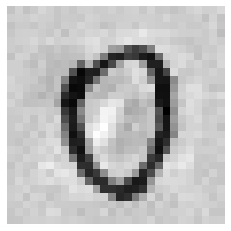

[3418] (예측값)8 (실제값)7


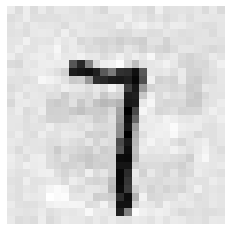

[3420] (예측값)0 (실제값)1


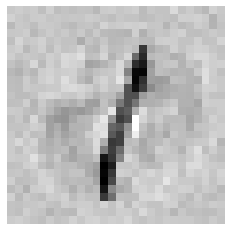

[3421] (예측값)2 (실제값)1


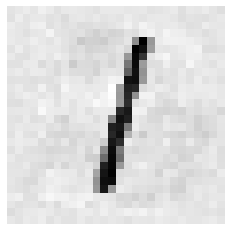

[3422] (예측값)0 (실제값)6


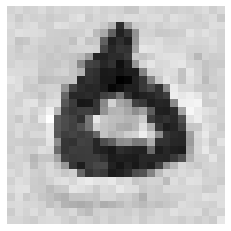

[3423] (예측값)4 (실제값)7


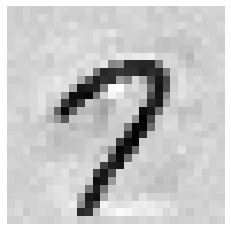

[3424] (예측값)5 (실제값)6


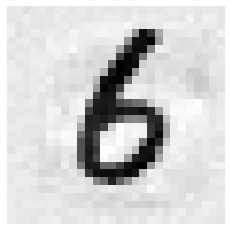

[3426] (예측값)7 (실제값)9


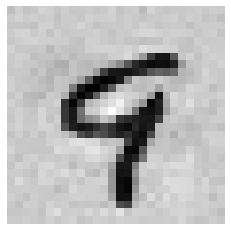

[3427] (예측값)8 (실제값)6


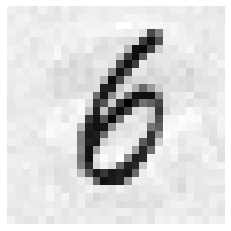

[3428] (예측값)9 (실제값)6


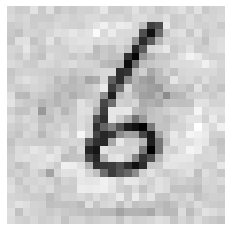

[3429] (예측값)8 (실제값)4


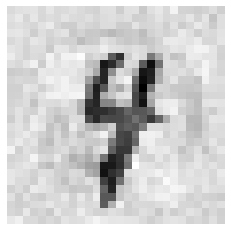

[3430] (예측값)2 (실제값)1


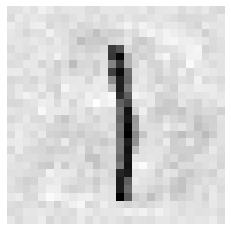

[3432] (예측값)7 (실제값)3


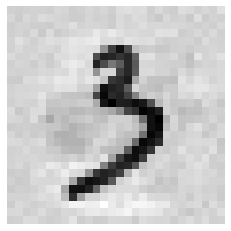

[3436] (예측값)8 (실제값)2


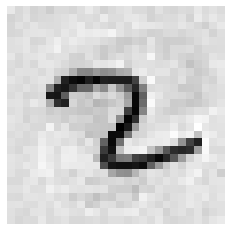

[3437] (예측값)9 (실제값)4


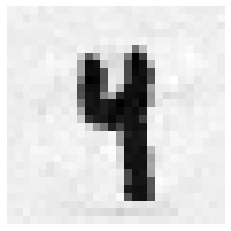

[3438] (예측값)0 (실제값)1


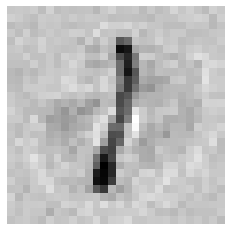

[3439] (예측값)9 (실제값)0


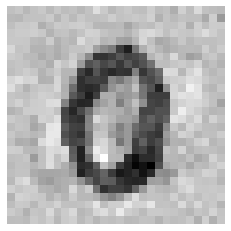

[3441] (예측값)3 (실제값)7


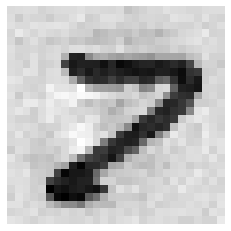

[3443] (예측값)5 (실제값)3


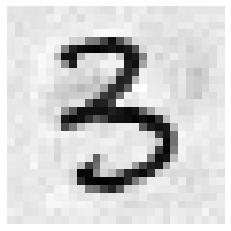

[3445] (예측값)7 (실제값)0


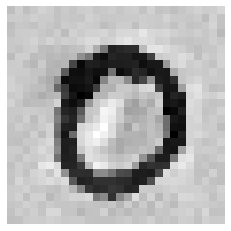

[3446] (예측값)8 (실제값)0


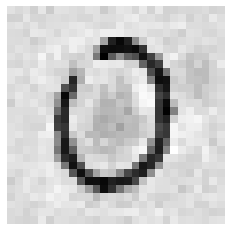

[3447] (예측값)4 (실제값)6


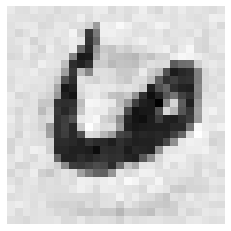

[3460] (예측값)8 (실제값)9


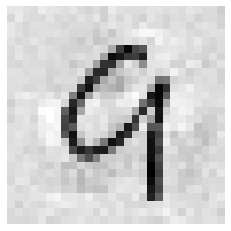

[3471] (예측값)4 (실제값)1


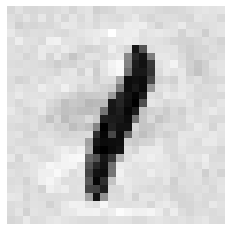

[3474] (예측값)1 (실제값)2


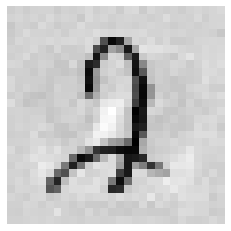

[3475] (예측값)8 (실제값)3


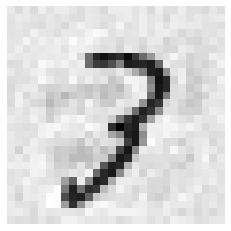

[3476] (예측값)9 (실제값)3


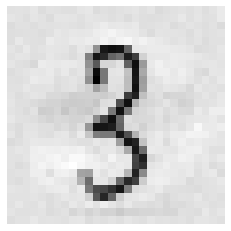

[3481] (예측값)4 (실제값)0


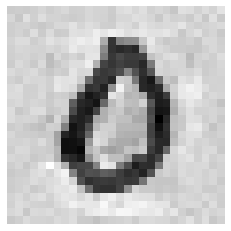

[3483] (예측값)6 (실제값)9


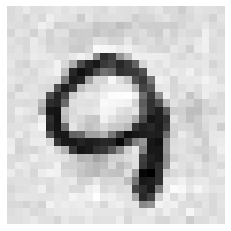

[3485] (예측값)8 (실제값)9


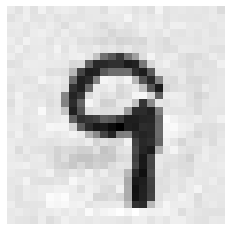

[3486] (예측값)9 (실제값)3


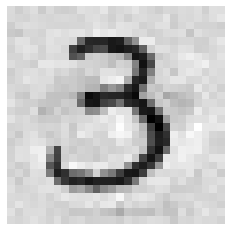

[3490] (예측값)5 (실제값)4


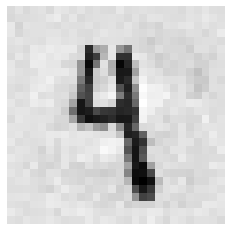

[3492] (예측값)9 (실제값)8


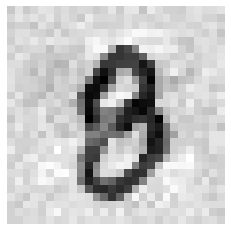

[3494] (예측값)9 (실제값)7


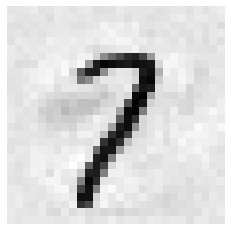

[3503] (예측값)8 (실제값)9


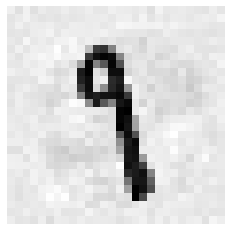

[3506] (예측값)3 (실제값)5


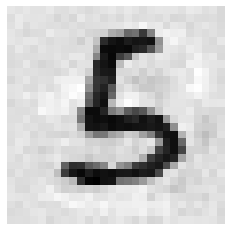

[3509] (예측값)5 (실제값)8


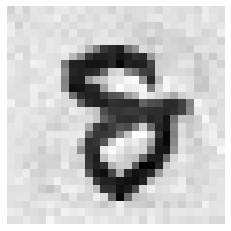

[3511] (예측값)7 (실제값)2


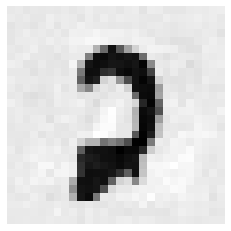

[3518] (예측값)4 (실제값)6


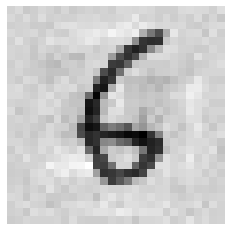

[3519] (예측값)5 (실제값)8


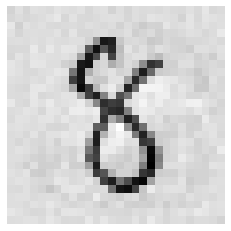

[3520] (예측값)4 (실제값)6


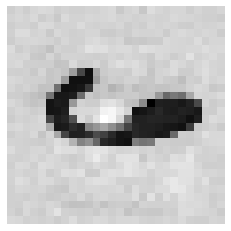

[3526] (예측값)4 (실제값)9


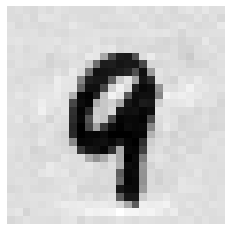

[3527] (예측값)5 (실제값)3


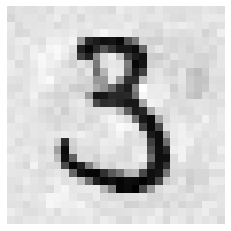

[3529] (예측값)7 (실제값)9


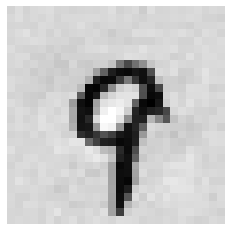

[3531] (예측값)9 (실제값)3


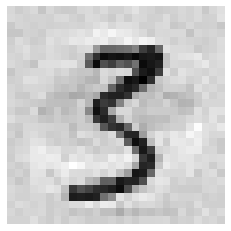

[3533] (예측값)5 (실제값)4


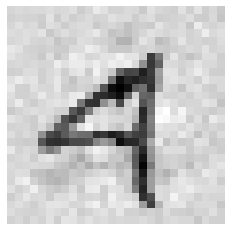

[3534] (예측값)8 (실제값)4


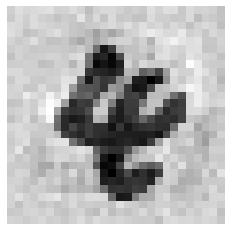

[3537] (예측값)8 (실제값)5


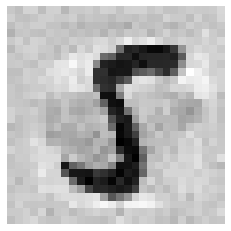

[3540] (예측값)9 (실제값)0


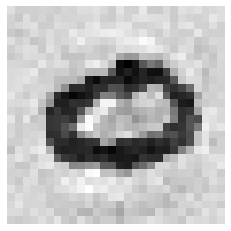

[3544] (예측값)7 (실제값)4


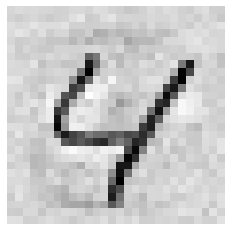

[3547] (예측값)6 (실제값)2


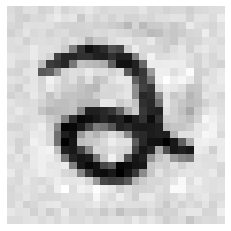

[3548] (예측값)7 (실제값)3


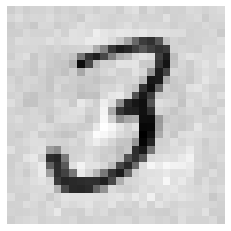

[3549] (예측값)8 (실제값)3


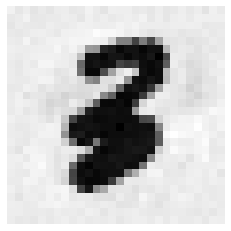

[3550] (예측값)9 (실제값)6


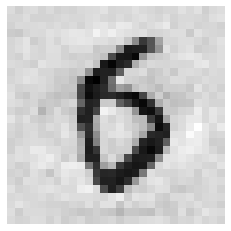

[3555] (예측값)4 (실제값)8


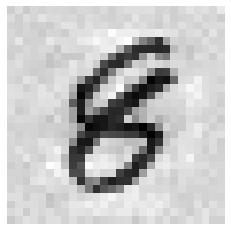

[3557] (예측값)0 (실제값)6


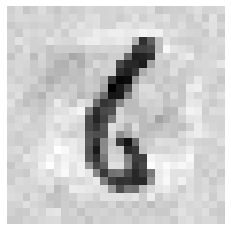

[3558] (예측값)0 (실제값)5


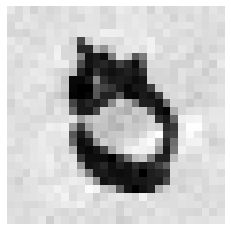

[3559] (예측값)9 (실제값)8


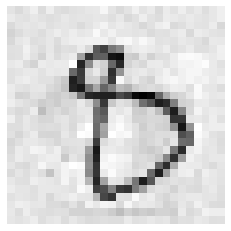

[3561] (예측값)1 (실제값)4


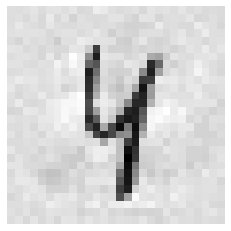

[3562] (예측값)2 (실제값)1


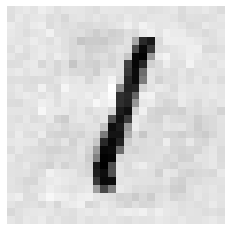

[3565] (예측값)6 (실제값)5


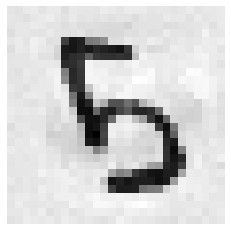

[3567] (예측값)9 (실제값)8


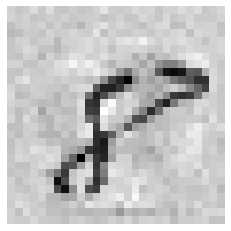

[3571] (예측값)3 (실제값)4


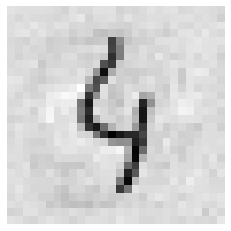

[3573] (예측값)8 (실제값)7


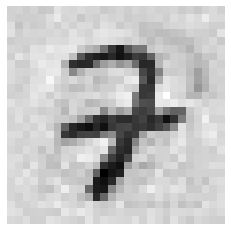

[3574] (예측값)6 (실제값)0


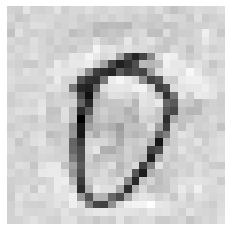

[3575] (예측값)8 (실제값)7


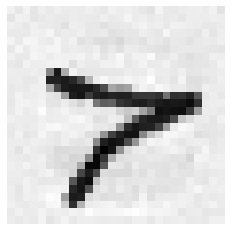

[3576] (예측값)9 (실제값)8


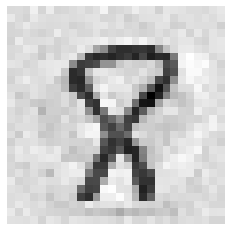

[3577] (예측값)0 (실제값)2


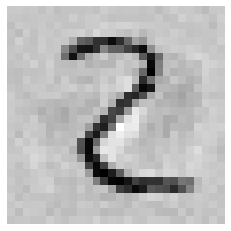

[3578] (예측값)1 (실제값)2


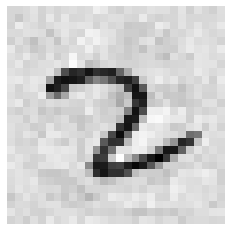

[3580] (예측값)3 (실제값)7


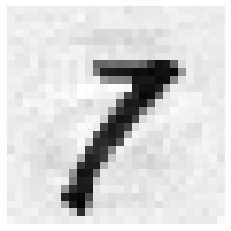

[3581] (예측값)4 (실제값)0


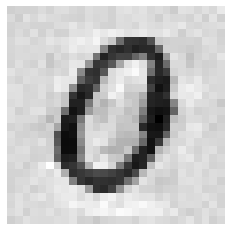

[3585] (예측값)8 (실제값)7


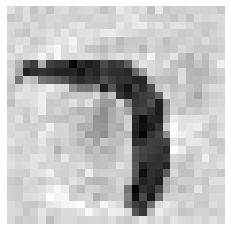

[3591] (예측값)8 (실제값)5


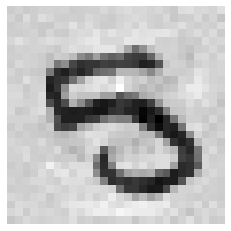

[3597] (예측값)3 (실제값)9


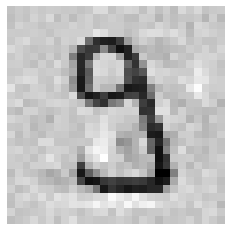

[3598] (예측값)8 (실제값)1


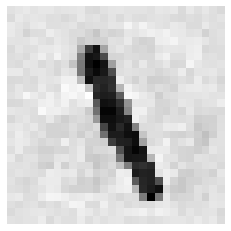

[3599] (예측값)3 (실제값)2


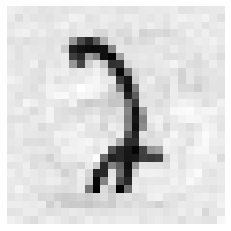

[3601] (예측값)5 (실제값)1


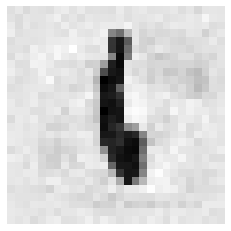

[3604] (예측값)9 (실제값)7


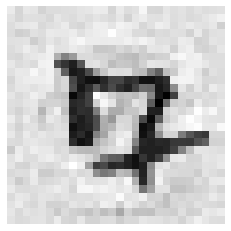

[3606] (예측값)2 (실제값)1


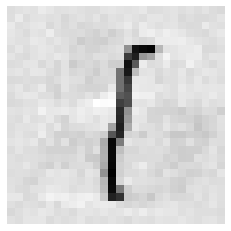

[3607] (예측값)3 (실제값)4


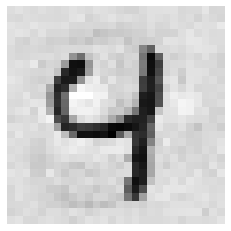

[3611] (예측값)7 (실제값)2


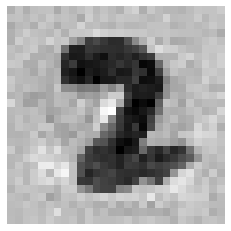

[3613] (예측값)9 (실제값)0


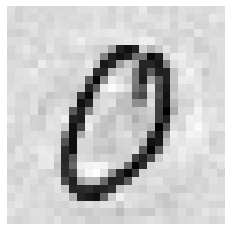

[3615] (예측값)8 (실제값)4


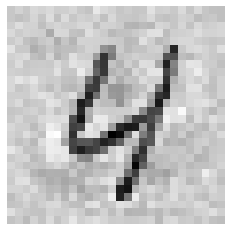

[3616] (예측값)2 (실제값)7


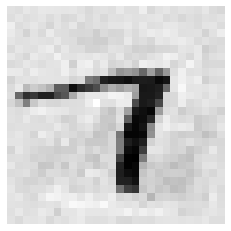

[3617] (예측값)3 (실제값)6


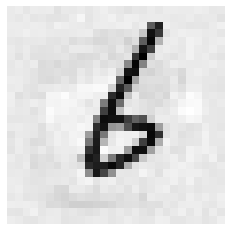

[3618] (예측값)4 (실제값)9


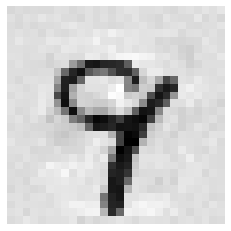

[3619] (예측값)0 (실제값)5


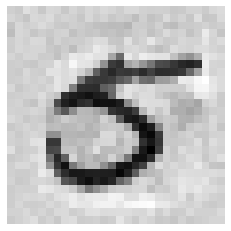

[3625] (예측값)2 (실제값)1


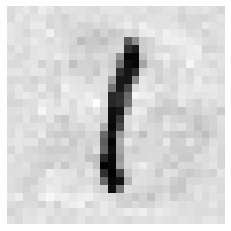

[3626] (예측값)3 (실제값)8


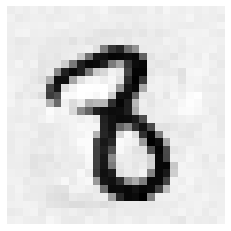

[3627] (예측값)2 (실제값)8


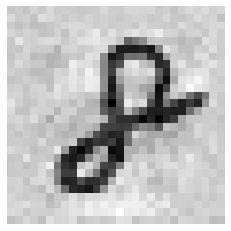

[3629] (예측값)6 (실제값)8


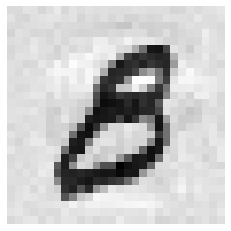

[3631] (예측값)8 (실제값)5


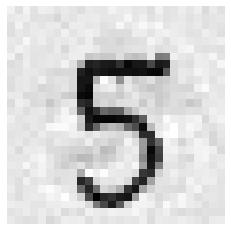

[3633] (예측값)0 (실제값)8


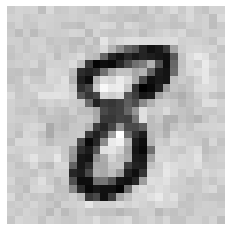

[3634] (예측값)1 (실제값)0


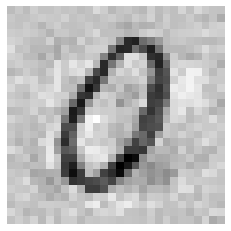

[3636] (예측값)3 (실제값)5


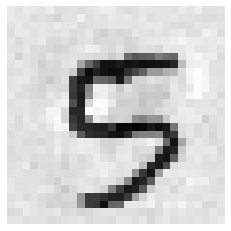

[3637] (예측값)9 (실제값)7


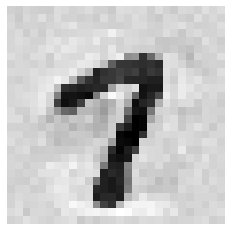

[3640] (예측값)7 (실제값)0


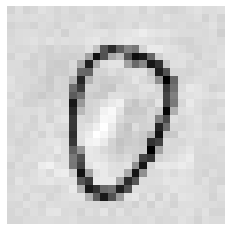

[3642] (예측값)9 (실제값)3


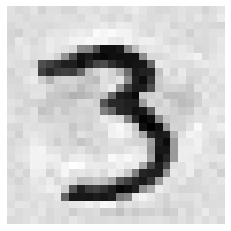

[3645] (예측값)2 (실제값)5


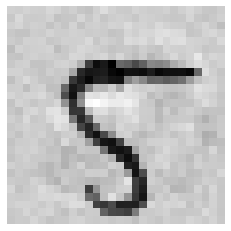

[3652] (예측값)9 (실제값)1


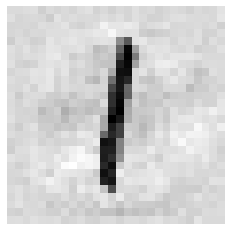

[3653] (예측값)0 (실제값)4


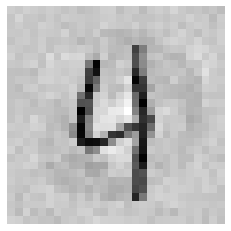

[3655] (예측값)1 (실제값)2


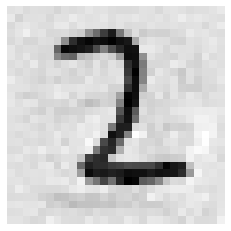

[3656] (예측값)4 (실제값)7


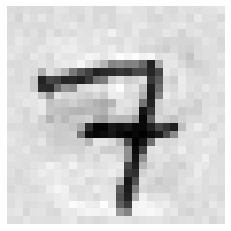

[3659] (예측값)7 (실제값)3


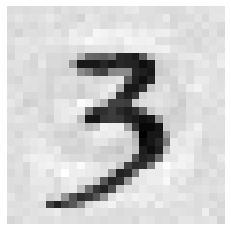

[3662] (예측값)0 (실제값)8


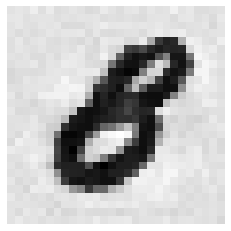

[3664] (예측값)2 (실제값)9


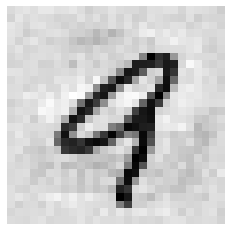

[3666] (예측값)4 (실제값)9


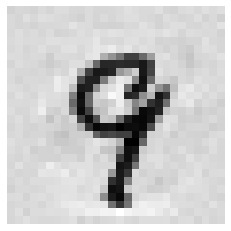

[3671] (예측값)9 (실제값)6


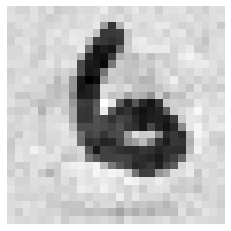

[3672] (예측값)0 (실제값)4


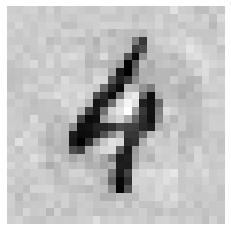

[3674] (예측값)3 (실제값)8


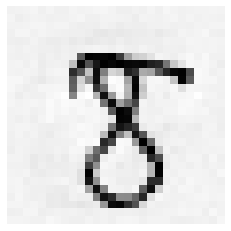

[3677] (예측값)6 (실제값)0


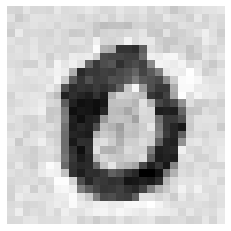

[3681] (예측값)8 (실제값)2


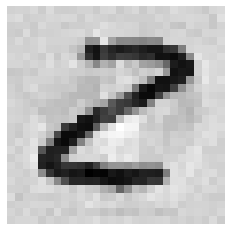

[3683] (예측값)2 (실제값)6


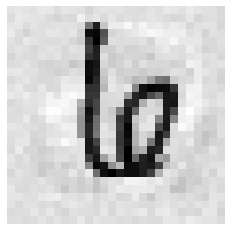

[3685] (예측값)5 (실제값)4


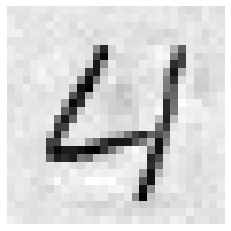

[3688] (예측값)8 (실제값)6


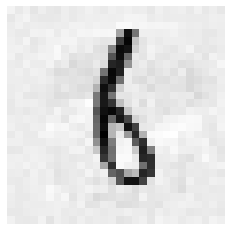

[3689] (예측값)9 (실제값)1


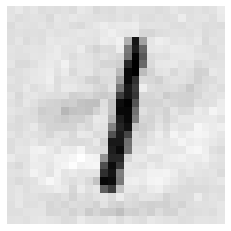

[3693] (예측값)3 (실제값)9


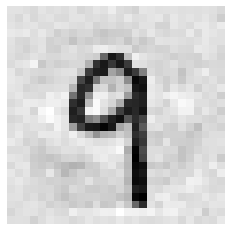

[3698] (예측값)8 (실제값)0


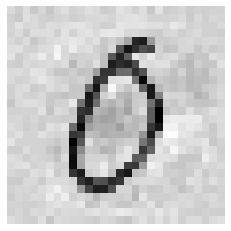

[3699] (예측값)9 (실제값)1


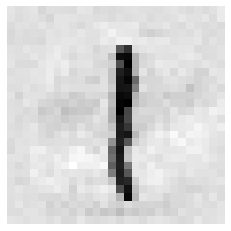

[3708] (예측값)9 (실제값)8


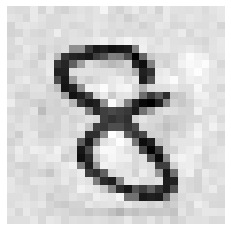

[3710] (예측값)2 (실제값)0


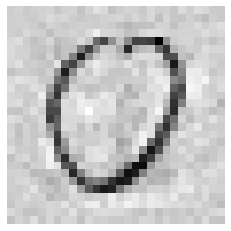

[3713] (예측값)4 (실제값)7


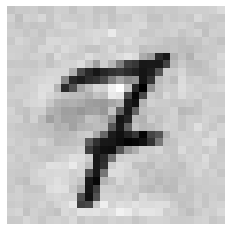

[3715] (예측값)5 (실제값)3


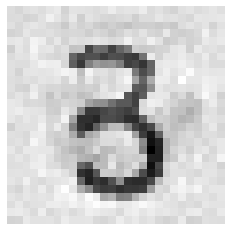

[3717] (예측값)8 (실제값)3


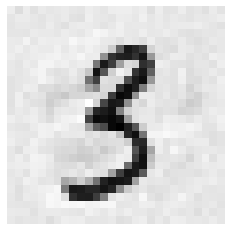

[3718] (예측값)9 (실제값)4


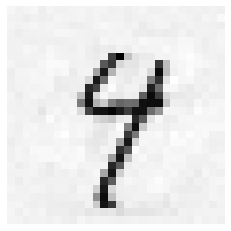

[3723] (예측값)4 (실제값)9


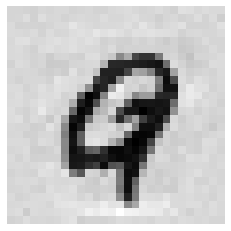

[3724] (예측값)5 (실제값)0


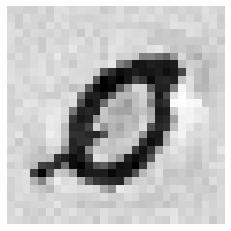

[3725] (예측값)7 (실제값)6


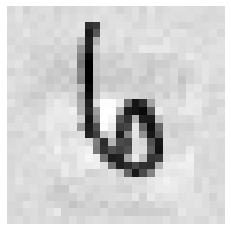

[3726] (예측값)9 (실제값)4


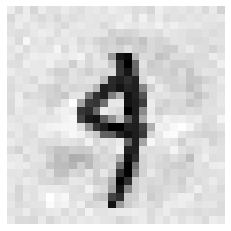

[3727] (예측값)4 (실제값)8


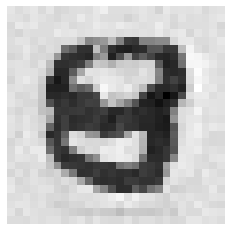

[3730] (예측값)9 (실제값)7


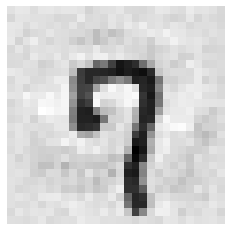

[3734] (예측값)6 (실제값)0


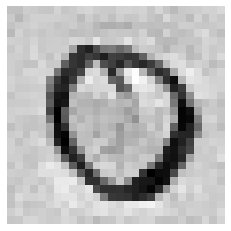

[3738] (예측값)0 (실제값)3


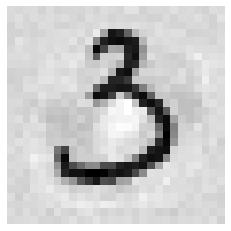

[3739] (예측값)1 (실제값)3


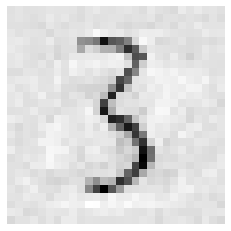

[3742] (예측값)4 (실제값)3


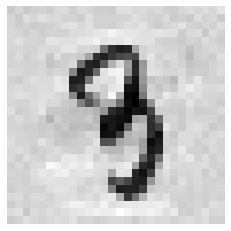

[3745] (예측값)8 (실제값)1


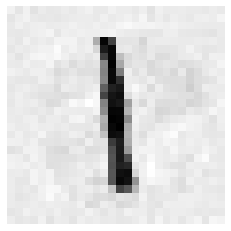

[3749] (예측값)2 (실제값)6


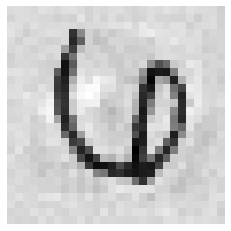

[3751] (예측값)4 (실제값)7


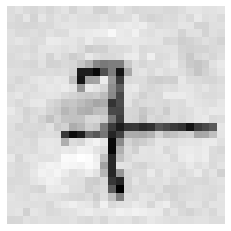

[3755] (예측값)8 (실제값)9


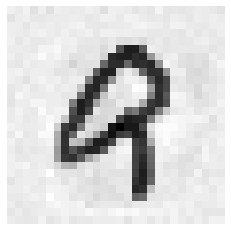

[3756] (예측값)9 (실제값)5


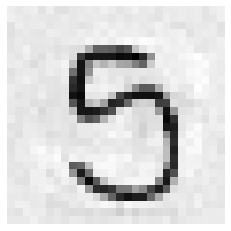

[3757] (예측값)0 (실제값)8


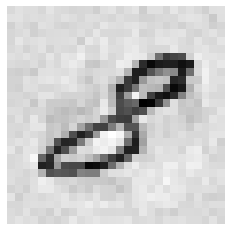

[3758] (예측값)8 (실제값)4


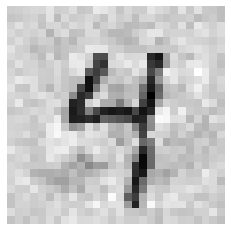

[3759] (예측값)2 (실제값)9


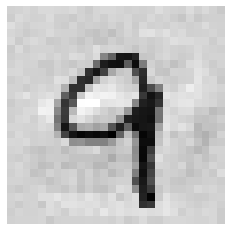

[3760] (예측값)3 (실제값)9


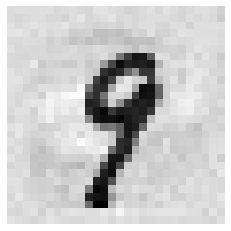

[3762] (예측값)5 (실제값)6


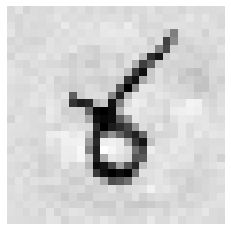

[3763] (예측값)1 (실제값)5


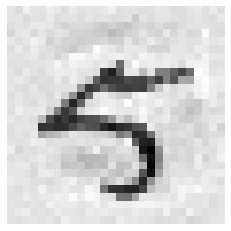

[3764] (예측값)7 (실제값)0


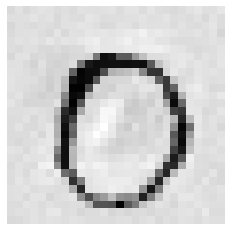

[3765] (예측값)8 (실제값)1


[3767] (예측값)2 (실제값)7


[3771] (예측값)4 (실제값)8


[3776] (예측값)8 (실제값)5


[3778] (예측값)2 (실제값)5


[3780] (예측값)2 (실제값)4


[3781] (예측값)4 (실제값)8


[3783] (예측값)4 (실제값)9


[3785] (예측값)1 (실제값)2


[3789] (예측값)8 (실제값)1


[3791] (예측값)4 (실제값)9


[3792] (예측값)5 (실제값)4


[3795] (예측값)8 (실제값)3


[3796] (예측값)8 (실제값)2


[3799] (예측값)2 (실제값)7


[3800] (예측값)3 (실제값)6


[3801] (예측값)4 (실제값)6


[3803] (예측값)6 (실제값)0


[3804] (예측값)7 (실제값)0


[3806] (예측값)9 (실제값)5


[3808] (예측값)1 (실제값)7


[3809] (예측값)2 (실제값)1


[3811] (예측값)4 (실제값)2


[3815] (예측값)8 (실제값)1


[3817] (예측값)4 (실제값)2


[3818] (예측값)6 (실제값)0


[3821] (예측값)4 (실제값)9


[3824] (예측값)7 (실제값)3


[3825] (예측값)8 (실제값)3


[3826] (예측값)7 (실제값)5


[3829] (예측값)2 (실제값)8


[3831] (예측값)4 (실제값)9


[3836] (예측값)9 (실제값)7


[3838] (예측값)1 (실제값)7


[3839] (예측값)1 (실제값)2


[3842] (예측값)6 (실제값)9


[3845] (예측값)9 (실제값)8


[3846] (예측값)0 (실제값)6


[3847] (예측값)2 (실제값)0


[3848] (예측값)3 (실제값)7


[3850] (예측값)4 (실제값)9


[3851] (예측값)5 (실제값)1


[3853] (예측값)7 (실제값)6


[3854] (예측값)8 (실제값)7


[3860] (예측값)4 (실제값)5


[3862] (예측값)6 (실제값)2


[3864] (예측값)8 (실제값)0


[3866] (예측값)7 (실제값)1


[3867] (예측값)6 (실제값)0


[3869] (예측값)8 (실제값)9


[3870] (예측값)4 (실제값)0


[3871] (예측값)5 (실제값)8


[3874] (예측값)8 (실제값)9


[3876] (예측값)0 (실제값)2


[3889] (예측값)4 (실제값)9


[3892] (예측값)9 (실제값)8


[3893] (예측값)0 (실제값)5


[3894] (예측값)2 (실제값)1


[3895] (예측값)3 (실제값)0


[3897] (예측값)5 (실제값)3


[3899] (예측값)3 (실제값)2


[3900] (예측값)8 (실제값)1


[3901] (예측값)8 (실제값)6


[3902] (예측값)0 (실제값)5


[3904] (예측값)3 (실제값)2


[3906] (예측값)5 (실제값)1


[3914] (예측값)4 (실제값)6


[3916] (예측값)8 (실제값)3


[3919] (예측값)9 (실제값)1


[3922] (예측값)2 (실제값)1


[3924] (예측값)4 (실제값)9


[3926] (예측값)8 (실제값)9


[3927] (예측값)7 (실제값)9


[3929] (예측값)9 (실제값)5


[3931] (예측값)1 (실제값)6


[3936] (예측값)8 (실제값)7


[3938] (예측값)8 (실제값)4


[3941] (예측값)2 (실제값)4


[3942] (예측값)4 (실제값)0


[3943] (예측값)5 (실제값)3


[3944] (예측값)8 (실제값)3


[3946] (예측값)8 (실제값)2


[3950] (예측값)3 (실제값)9


[3951] (예측값)3 (실제값)8


[3952] (예측값)6 (실제값)5


[3953] (예측값)5 (실제값)3


[3955] (예측값)7 (실제값)5


[3962] (예측값)4 (실제값)3


[3967] (예측값)0 (실제값)9


[3968] (예측값)3 (실제값)5


[3974] (예측값)9 (실제값)1


[3976] (예측값)1 (실제값)7


[3979] (예측값)4 (실제값)6


[3980] (예측값)5 (실제값)0


[3984] (예측값)1 (실제값)9


[3986] (예측값)3 (실제값)2


[3988] (예측값)5 (실제값)8


[3994] (예측값)2 (실제값)5


[3995] (예측값)4 (실제값)3


[3997] (예측값)9 (실제값)7


[4000] (예측값)4 (실제값)9


[4004] (예측값)4 (실제값)3


[4007] (예측값)8 (실제값)7


[4011] (예측값)3 (실제값)8


[4015] (예측값)8 (실제값)9


[4017] (예측값)1 (실제값)4


[4018] (예측값)2 (실제값)3


[4022] (예측값)4 (실제값)6


[4024] (예측값)9 (실제값)4


[4025] (예측값)7 (실제값)1


[4027] (예측값)4 (실제값)7


[4030] (예측값)6 (실제값)9


[4031] (예측값)9 (실제값)5


[4032] (예측값)8 (실제값)1


[4048] (예측값)7 (실제값)0


[4050] (예측값)9 (실제값)1


[4051] (예측값)0 (실제값)6


[4052] (예측값)1 (실제값)5


[4053] (예측값)2 (실제값)7


[4058] (예측값)9 (실제값)8


[4062] (예측값)9 (실제값)0


[4063] (예측값)4 (실제값)6


[4065] (예측값)6 (실제값)0


[4067] (예측값)8 (실제값)5


[4068] (예측값)9 (실제값)8


[4069] (예측값)7 (실제값)1


[4071] (예측값)2 (실제값)4


[4072] (예측값)3 (실제값)5


[4075] (예측값)6 (실제값)8


[4076] (예측값)9 (실제값)5


[4078] (예측값)0 (실제값)9


[4088] (예측값)8 (실제값)9


[4090] (예측값)3 (실제값)0


[4093] (예측값)4 (실제값)9


[4094] (예측값)7 (실제값)5


[4095] (예측값)8 (실제값)9


[4096] (예측값)9 (실제값)8


[4100] (예측값)3 (실제값)2


[4106] (예측값)9 (실제값)3


[4107] (예측값)2 (실제값)7


[4109] (예측값)8 (실제값)3


[4111] (예측값)4 (실제값)9


[4113] (예측값)6 (실제값)2


[4116] (예측값)9 (실제값)8


[4119] (예측값)2 (실제값)7


[4123] (예측값)2 (실제값)8


[4124] (예측값)9 (실제값)8


[4125] (예측값)0 (실제값)6


[4128] (예측값)4 (실제값)3


[4129] (예측값)8 (실제값)9


[4131] (예측값)7 (실제값)5


[4132] (예측값)8 (실제값)6


[4134] (예측값)0 (실제값)9


[4135] (예측값)1 (실제값)2


[4138] (예측값)4 (실제값)1


[4139] (예측값)4 (실제값)6


[4140] (예측값)2 (실제값)8


[4141] (예측값)7 (실제값)8


[4145] (예측값)3 (실제값)8


[4147] (예측값)5 (실제값)1


[4148] (예측값)6 (실제값)7


[4149] (예측값)3 (실제값)2


[4151] (예측값)9 (실제값)7


[4152] (예측값)0 (실제값)5


[4160] (예측값)0 (실제값)6


[4163] (예측값)5 (실제값)9


[4164] (예측값)4 (실제값)3


[4166] (예측값)6 (실제값)0


[4168] (예측값)8 (실제값)1


[4169] (예측값)9 (실제값)1


[4170] (예측값)7 (실제값)1


[4171] (예측값)8 (실제값)1


[4172] (예측값)9 (실제값)4


[4173] (예측값)4 (실제값)2


[4176] (예측값)7 (실제값)2


[4177] (예측값)4 (실제값)5


[4178] (예측값)9 (실제값)1


[4180] (예측값)1 (실제값)2


[4183] (예측값)4 (실제값)9


[4184] (예측값)5 (실제값)9


[4187] (예측값)4 (실제값)2


[4193] (예측값)7 (실제값)6


[4195] (예측값)9 (실제값)1


[4197] (예측값)2 (실제값)4


[4199] (예측값)3 (실제값)7


[4200] (예측값)4 (실제값)7


[4201] (예측값)5 (실제값)1


[4203] (예측값)4 (실제값)6


[4205] (예측값)7 (실제값)2


[4207] (예측값)1 (실제값)8


[4208] (예측값)6 (실제값)0


[4210] (예측값)4 (실제값)9


[4211] (예측값)5 (실제값)6


[4214] (예측값)8 (실제값)7


[4215] (예측값)9 (실제값)7


[4216] (예측값)0 (실제값)1


[4217] (예측값)8 (실제값)4


[4218] (예측값)2 (실제값)8


[4220] (예측값)4 (실제값)3


[4227] (예측값)1 (실제값)0


[4228] (예측값)2 (실제값)7


[4229] (예측값)3 (실제값)4


[4232] (예측값)6 (실제값)1


[4238] (예측값)3 (실제값)7


[4239] (예측값)4 (실제값)6


[4243] (예측값)8 (실제값)6


[4244] (예측값)9 (실제값)3


[4246] (예측값)3 (실제값)8


[4248] (예측값)4 (실제값)2


[4249] (예측값)5 (실제값)1


[4252] (예측값)8 (실제값)6


[4253] (예측값)9 (실제값)8


[4254] (예측값)0 (실제값)5


[4255] (예측값)3 (실제값)5


[4259] (예측값)6 (실제값)9


[4260] (예측값)7 (실제값)2


[4261] (예측값)8 (실제값)5


[4265] (예측값)3 (실제값)4


[4268] (예측값)7 (실제값)4


[4272] (예측값)8 (실제값)9


[4273] (예측값)2 (실제값)1


[4274] (예측값)3 (실제값)2


[4277] (예측값)6 (실제값)3


[4281] (예측값)6 (실제값)0


[4284] (예측값)4 (실제값)9


[4286] (예측값)2 (실제값)0


[4289] (예측값)9 (실제값)2


[4291] (예측값)1 (실제값)4


[4292] (예측값)2 (실제값)1


[4294] (예측값)4 (실제값)9


[4295] (예측값)5 (실제값)7


[4300] (예측값)3 (실제값)5


[4306] (예측값)8 (실제값)3


[4307] (예측값)9 (실제값)5


[4308] (예측값)0 (실제값)1


[4309] (예측값)8 (실제값)9


[4311] (예측값)4 (실제값)3


[4313] (예측값)7 (실제값)4


[4314] (예측값)8 (실제값)9


[4315] (예측값)9 (실제값)5


[4316] (예측값)0 (실제값)9


[4318] (예측값)2 (실제값)1


[4322] (예측값)9 (실제값)7


[4323] (예측값)7 (실제값)5


[4324] (예측값)8 (실제값)4


[4329] (예측값)6 (실제값)0


[4330] (예측값)6 (실제값)5


[4331] (예측값)7 (실제값)1


[4332] (예측값)8 (실제값)4


[4333] (예측값)0 (실제값)9


[4341] (예측값)9 (실제값)2


[4343] (예측값)3 (실제값)0


[4344] (예측값)2 (실제값)9


[4346] (예측값)4 (실제값)6


[4350] (예측값)8 (실제값)2


[4353] (예측값)1 (실제값)0


[4354] (예측값)3 (실제값)2


[4355] (예측값)9 (실제값)5


[4356] (예측값)8 (실제값)5


[4357] (예측값)5 (실제값)7


[4360] (예측값)3 (실제값)5


[4363] (예측값)5 (실제값)9


[4366] (예측값)8 (실제값)3


[4369] (예측값)1 (실제값)9


[4374] (예측값)6 (실제값)5


[4375] (예측값)7 (실제값)8


[4381] (예측값)8 (실제값)5


[4382] (예측값)9 (실제값)4


[4383] (예측값)4 (실제값)9


[4386] (예측값)9 (실제값)1


[4393] (예측값)6 (실제값)3


[4394] (예측값)7 (실제값)6


[4396] (예측값)9 (실제값)4


[4400] (예측값)3 (실제값)7


[4403] (예측값)6 (실제값)0


[4405] (예측값)8 (실제값)9


[4408] (예측값)4 (실제값)9


[4409] (예측값)2 (실제값)1


[4410] (예측값)3 (실제값)9


[4413] (예측값)7 (실제값)6


[4415] (예측값)9 (실제값)2


[4417] (예측값)8 (실제값)9


[4423] (예측값)9 (실제값)7


[4425] (예측값)4 (실제값)9


[4427] (예측값)3 (실제값)2


[4428] (예측값)4 (실제값)1


[4429] (예측값)5 (실제값)8


[4431] (예측값)7 (실제값)4


[4432] (예측값)8 (실제값)0


[4435] (예측값)1 (실제값)3


[4437] (예측값)2 (실제값)3


[4438] (예측값)5 (실제값)4


[4439] (예측값)7 (실제값)6


[4441] (예측값)9 (실제값)6


[4443] (예측값)1 (실제값)3


[4449] (예측값)0 (실제값)6


[4450] (예측값)8 (실제값)1


[4451] (예측값)9 (실제값)2


[4452] (예측값)0 (실제값)8


[4453] (예측값)1 (실제값)7


[4463] (예측값)2 (실제값)5


[4466] (예측값)3 (실제값)6


[4468] (예측값)9 (실제값)4


[4469] (예측값)2 (실제값)3


[4476] (예측값)1 (실제값)2


[4477] (예측값)8 (실제값)0


[4481] (예측값)2 (실제값)4


[4482] (예측값)3 (실제값)2


[4483] (예측값)5 (실제값)4


[4485] (예측값)8 (실제값)7


[4487] (예측값)0 (실제값)7


[4491] (예측값)4 (실제값)1


[4492] (예측값)5 (실제값)3


[4497] (예측값)3 (실제값)8


[4499] (예측값)2 (실제값)6


[4500] (예측값)1 (실제값)9


[4503] (예측값)6 (실제값)2


[4505] (예측값)8 (실제값)9


[4507] (예측값)0 (실제값)1


[4510] (예측값)3 (실제값)2


[4511] (예측값)4 (실제값)9


[4513] (예측값)6 (실제값)8


[4515] (예측값)9 (실제값)0


[4516] (예측값)9 (실제값)1


[4524] (예측값)7 (실제값)1


[4525] (예측값)8 (실제값)1


[4530] (예측값)3 (실제값)7


[4534] (예측값)7 (실제값)9


[4535] (예측값)8 (실제값)3


[4536] (예측값)9 (실제값)6


[4538] (예측값)2 (실제값)1


[4541] (예측값)5 (실제값)3


[4547] (예측값)4 (실제값)6


[4548] (예측값)2 (실제값)5


[4549] (예측값)3 (실제값)2


[4550] (예측값)4 (실제값)9


[4551] (예측값)5 (실제값)7


[4552] (예측값)8 (실제값)3


[4556] (예측값)5 (실제값)9


[4557] (예측값)2 (실제값)6


[4562] (예측값)7 (실제값)2


[4564] (예측값)9 (실제값)1


[4565] (예측값)0 (실제값)6


[4567] (예측값)9 (실제값)4


[4569] (예측값)4 (실제값)5


[4571] (예측값)5 (실제값)6


[4572] (예측값)9 (실제값)8


[4573] (예측값)0 (실제값)2


[4575] (예측값)3 (실제값)4


[4578] (예측값)8 (실제값)7


[4579] (예측값)9 (실제값)6


[4582] (예측값)1 (실제값)2


[4584] (예측값)5 (실제값)9


[4585] (예측값)4 (실제값)9


[4586] (예측값)9 (실제값)3


[4589] (예측값)0 (실제값)1


[4593] (예측값)4 (실제값)7


[4596] (예측값)3 (실제값)5


[4598] (예측값)9 (실제값)4


[4599] (예측값)0 (실제값)6


[4601] (예측값)4 (실제값)8


[4605] (예측값)8 (실제값)3


[4606] (예측값)7 (실제값)1


[4607] (예측값)8 (실제값)6


[4608] (예측값)9 (실제값)8


[4611] (예측값)2 (실제값)0


[4615] (예측값)4 (실제값)2


[4619] (예측값)0 (실제값)6


[4626] (예측값)9 (실제값)8


[4631] (예측값)2 (실제값)0


[4632] (예측값)3 (실제값)2


[4633] (예측값)4 (실제값)9


[4635] (예측값)6 (실제값)3


[4638] (예측값)9 (실제값)3


[4639] (예측값)7 (실제값)8


[4640] (예측값)1 (실제값)8


[4641] (예측값)2 (실제값)0


[4642] (예측값)2 (실제값)0


[4656] (예측값)7 (실제값)2


[4660] (예측값)4 (실제값)7


[4662] (예측값)8 (실제값)9


[4664] (예측값)8 (실제값)3


[4665] (예측값)0 (실제값)9


[4669] (예측값)4 (실제값)7


[4671] (예측값)6 (실제값)8


[4673] (예측값)8 (실제값)9


[4676] (예측값)2 (실제값)1


[4677] (예측값)3 (실제값)7


[4678] (예측값)4 (실제값)7


[4680] (예측값)9 (실제값)6


[4692] (예측값)3 (실제값)9


[4693] (예측값)5 (실제값)7


[4695] (예측값)9 (실제값)4


[4696] (예측값)6 (실제값)5


[4698] (예측값)9 (실제값)6


[4699] (예측값)0 (실제값)6


[4700] (예측값)4 (실제값)9


[4701] (예측값)2 (실제값)9


[4704] (예측값)5 (실제값)6


[4707] (예측값)9 (실제값)8


[4710] (예측값)3 (실제값)2


[4711] (예측값)4 (실제값)5


[4712] (예측값)8 (실제값)5


[4713] (예측값)6 (실제값)2


[4714] (예측값)8 (실제값)3


[4719] (예측값)4 (실제값)1


[4722] (예측값)7 (실제값)5


[4724] (예측값)9 (실제값)8


[4726] (예측값)1 (실제값)8


[4728] (예측값)3 (실제값)5


[4730] (예측값)5 (실제값)7


[4731] (예측값)6 (실제값)8


[4733] (예측값)8 (실제값)1


[4735] (예측값)0 (실제값)9


[4736] (예측값)2 (실제값)7


[4738] (예측값)3 (실제값)4


[4739] (예측값)4 (실제값)0


[4740] (예측값)5 (실제값)3


[4741] (예측값)6 (실제값)0


[4742] (예측값)4 (실제값)7


[4743] (예측값)9 (실제값)8


[4744] (예측값)0 (실제값)8


[4745] (예측값)1 (실제값)4


[4746] (예측값)5 (실제값)7


[4748] (예측값)4 (실제값)8


[4749] (예측값)6 (실제값)5


[4750] (예측값)7 (실제값)8


[4751] (예측값)8 (실제값)4


[4753] (예측값)1 (실제값)8


[4755] (예측값)4 (실제값)3


[4759] (예측값)8 (실제값)1


[4760] (예측값)9 (실제값)7


[4761] (예측값)8 (실제값)9


[4763] (예측값)6 (실제값)5


[4764] (예측값)3 (실제값)1


[4772] (예측값)3 (실제값)4


[4773] (예측값)4 (실제값)7


[4774] (예측값)5 (실제값)1


[4777] (예측값)9 (실제값)8


[4778] (예측값)7 (실제값)1


[4780] (예측값)2 (실제값)0


[4782] (예측값)7 (실제값)3


[4783] (예측값)5 (실제값)4


[4786] (예측값)8 (실제값)9


[4792] (예측값)4 (실제값)8


[4794] (예측값)5 (실제값)7


[4795] (예측값)7 (실제값)9


[4796] (예측값)8 (실제값)3


[4798] (예측값)0 (실제값)6


[4799] (예측값)2 (실제값)9


[4802] (예측값)4 (실제값)3


[4805] (예측값)1 (실제값)2


[4806] (예측값)8 (실제값)1


[4807] (예측값)9 (실제값)8


[4808] (예측값)5 (실제값)3


[4812] (예측값)1 (실제값)2


[4814] (예측값)0 (실제값)6


[4815] (예측값)8 (실제값)7


[4816] (예측값)9 (실제값)2


[4817] (예측값)0 (실제값)8


[4820] (예측값)3 (실제값)8


[4822] (예측값)5 (실제값)8


[4823] (예측값)6 (실제값)9


[4825] (예측값)9 (실제값)8


[4826] (예측값)9 (실제값)4


[4828] (예측값)2 (실제값)5


[4829] (예측값)3 (실제값)8


[4830] (예측값)4 (실제값)5


[4833] (예측값)8 (실제값)3


[4834] (예측값)9 (실제값)0


[4836] (예측값)1 (실제값)3


[4837] (예측값)2 (실제값)7


[4838] (예측값)5 (실제값)6


[4841] (예측값)6 (실제값)3


[4845] (예측값)0 (실제값)8


[4848] (예측값)3 (실제값)2


[4852] (예측값)9 (실제값)8


[4861] (예측값)8 (실제값)7


[4863] (예측값)0 (실제값)8


[4864] (예측값)2 (실제값)1


[4866] (예측값)5 (실제값)4


[4869] (예측값)9 (실제값)1


[4871] (예측값)2 (실제값)1


[4872] (예측값)3 (실제값)1


[4873] (예측값)4 (실제값)3


[4874] (예측값)5 (실제값)9


[4876] (예측값)8 (실제값)2


[4877] (예측값)9 (실제값)1


[4878] (예측값)0 (실제값)2


[4880] (예측값)5 (실제값)0


[4885] (예측값)7 (실제값)3


[4886] (예측값)8 (실제값)7


[4890] (예측값)2 (실제값)8


[4893] (예측값)5 (실제값)4


[4894] (예측값)8 (실제값)3


[4897] (예측값)9 (실제값)6


[4898] (예측값)0 (실제값)6


[4901] (예측값)3 (실제값)9


[4902] (예측값)4 (실제값)5


[4903] (예측값)5 (실제값)1


[4904] (예측값)8 (실제값)3


[4917] (예측값)2 (실제값)1


[4918] (예측값)3 (실제값)9


[4923] (예측값)8 (실제값)0


[4924] (예측값)9 (실제값)1


[4929] (예측값)5 (실제값)4


[4937] (예측값)3 (실제값)0


[4938] (예측값)4 (실제값)7


[4939] (예측값)5 (실제값)2


[4940] (예측값)5 (실제값)3


[4942] (예측값)8 (실제값)5


[4943] (예측값)9 (실제값)2


[4948] (예측값)4 (실제값)8


[4949] (예측값)5 (실제값)1


[4951] (예측값)7 (실제값)1


[4952] (예측값)8 (실제값)6


[4953] (예측값)9 (실제값)1


[4958] (예측값)4 (실제값)0


[4962] (예측값)8 (실제값)2


[4963] (예측값)0 (실제값)9


[4964] (예측값)1 (실제값)2


[4965] (예측값)3 (실제값)2


[4966] (예측값)4 (실제값)7


[4968] (예측값)6 (실제값)9


[4969] (예측값)7 (실제값)2


[4970] (예측값)9 (실제값)7


[4972] (예측값)0 (실제값)1


[4978] (예측값)7 (실제값)8


[4980] (예측값)9 (실제값)6


[4987] (예측값)6 (실제값)4


[4989] (예측값)8 (실제값)9


[4990] (예측값)9 (실제값)3


[4995] (예측값)1 (실제값)2


[4997] (예측값)6 (실제값)2


[4998] (예측값)7 (실제값)4


[5002] (예측값)4 (실제값)9


[5005] (예측값)4 (실제값)1


[5009] (예측값)0 (실제값)9


[5018] (예측값)4 (실제값)2


[5024] (예측값)6 (실제값)2


[5025] (예측값)7 (실제값)1


[5026] (예측값)8 (실제값)9


[5027] (예측값)9 (실제값)4


[5036] (예측값)9 (실제값)1


[5041] (예측값)4 (실제값)8


[5044] (예측값)7 (실제값)1


[5048] (예측값)1 (실제값)7


[5062] (예측값)5 (실제값)3


[5065] (예측값)9 (실제값)8


[5070] (예측값)4 (실제값)9


[5071] (예측값)5 (실제값)7


[5073] (예측값)7 (실제값)9


[5074] (예측값)8 (실제값)3


[5077] (예측값)1 (실제값)7


[5078] (예측값)2 (실제값)3


[5085] (예측값)9 (실제값)6


[5086] (예측값)9 (실제값)2


[5090] (예측값)4 (실제값)1


[5093] (예측값)7 (실제값)1


[5094] (예측값)8 (실제값)7


[5099] (예측값)3 (실제값)2


[5100] (예측값)4 (실제값)9


[5106] (예측값)0 (실제값)9


[5114] (예측값)9 (실제값)7


[5115] (예측값)0 (실제값)6


[5116] (예측값)4 (실제값)6


[5121] (예측값)5 (실제값)7


[5125] (예측값)5 (실제값)2


[5127] (예측값)7 (실제값)2


[5129] (예측값)5 (실제값)8


[5135] (예측값)4 (실제값)9


[5138] (예측값)4 (실제값)8


[5140] (예측값)6 (실제값)3


[5144] (예측값)5 (실제값)9


[5146] (예측값)9 (실제값)3


[5147] (예측값)5 (실제값)0


[5148] (예측값)6 (실제값)1


[5150] (예측값)8 (실제값)3


[5151] (예측값)9 (실제값)4


[5155] (예측값)3 (실제값)0


[5156] (예측값)4 (실제값)1


[5159] (예측값)7 (실제값)4


[5161] (예측값)9 (실제값)6


[5165] (예측값)3 (실제값)0


[5169] (예측값)7 (실제값)4


[5171] (예측값)9 (실제값)6


[5176] (예측값)4 (실제값)8


[5182] (예측값)7 (실제값)9


[5186] (예측값)5 (실제값)1


[5190] (예측값)9 (실제값)7


[5196] (예측값)6 (실제값)5


[5199] (예측값)0 (실제값)6


[5203] (예측값)4 (실제값)1


[5207] (예측값)8 (실제값)5


[5208] (예측값)9 (실제값)1


[5210] (예측값)5 (실제값)9


[5212] (예측값)8 (실제값)3


[5214] (예측값)8 (실제값)3


[5217] (예측값)0 (실제값)2


[5218] (예측값)0 (실제값)6


[5221] (예측값)5 (실제값)6


[5222] (예측값)4 (실제값)5


[5223] (예측값)6 (실제값)5


[5225] (예측값)8 (실제값)3


[5231] (예측값)4 (실제값)8


[5235] (예측값)9 (실제값)6


[5238] (예측값)2 (실제값)7


[5239] (예측값)3 (실제값)4


[5240] (예측값)4 (실제값)7


[5243] (예측값)7 (실제값)0


[5245] (예측값)9 (실제값)3


[5246] (예측값)2 (실제값)7


[5248] (예측값)2 (실제값)3


[5249] (예측값)3 (실제값)0


[5257] (예측값)6 (실제값)0


[5261] (예측값)9 (실제값)7


[5262] (예측값)7 (실제값)9


[5265] (예측값)0 (실제값)6


[5267] (예측값)3 (실제값)2


[5270] (예측값)6 (실제값)0


[5273] (예측값)9 (실제값)3


[5277] (예측값)3 (실제값)7


[5283] (예측값)9 (실제값)3


[5288] (예측값)9 (실제값)8


[5291] (예측값)7 (실제값)1


[5293] (예측값)9 (실제값)3


[5302] (예측값)8 (실제값)5


[5303] (예측값)9 (실제값)6


[5304] (예측값)0 (실제값)6


[5306] (예측값)2 (실제값)8


[5310] (예측값)9 (실제값)7


[5311] (예측값)7 (실제값)9


[5318] (예측값)4 (실제값)1


[5322] (예측값)8 (실제값)4


[5323] (예측값)9 (실제값)1


[5329] (예측값)5 (실제값)3


[5331] (예측값)2 (실제값)1


[5332] (예측값)8 (실제값)6


[5335] (예측값)2 (실제값)4


[5341] (예측값)9 (실제값)6


[5348] (예측값)7 (실제값)4


[5349] (예측값)9 (실제값)8


[5356] (예측값)8 (실제값)3


[5357] (예측값)7 (실제값)6


[5359] (예측값)9 (실제값)3


[5361] (예측값)2 (실제값)1


[5362] (예측값)9 (실제값)4


[5363] (예측값)4 (실제값)7


[5371] (예측값)4 (실제값)7


[5380] (예측값)3 (실제값)8


[5383] (예측값)4 (실제값)6


[5384] (예측값)8 (실제값)1


[5390] (예측값)4 (실제값)2


[5394] (예측값)9 (실제값)8


[5395] (예측값)0 (실제값)4


[5401] (예측값)0 (실제값)6


[5403] (예측값)9 (실제값)8


[5405] (예측값)8 (실제값)0


[5406] (예측값)2 (실제값)1


[5407] (예측값)3 (실제값)2


[5409] (예측값)6 (실제값)4


[5410] (예측값)0 (실제값)5


[5412] (예측값)8 (실제값)7


[5413] (예측값)9 (실제값)8


[5417] (예측값)3 (실제값)2


[5422] (예측값)5 (실제값)7


[5423] (예측값)9 (실제값)8


[5426] (예측값)2 (실제값)4


[5431] (예측값)7 (실제값)1


[5432] (예측값)8 (실제값)5


[5446] (예측값)4 (실제값)3


[5450] (예측값)5 (실제값)0


[5457] (예측값)9 (실제값)1


[5477] (예측값)0 (실제값)1


[5482] (예측값)5 (실제값)7


[5483] (예측값)6 (실제값)0


[5491] (예측값)4 (실제값)9


[5495] (예측값)3 (실제값)8


[5499] (예측값)3 (실제값)1


[5502] (예측값)8 (실제값)2


[5517] (예측값)5 (실제값)4


[5522] (예측값)0 (실제값)8


[5523] (예측값)8 (실제값)9


[5525] (예측값)9 (실제값)4


[5530] (예측값)9 (실제값)8


[5535] (예측값)4 (실제값)1


[5539] (예측값)8 (실제값)6


[5542] (예측값)7 (실제값)3


[5543] (예측값)2 (실제값)8


[5545] (예측값)6 (실제값)2


[5547] (예측값)6 (실제값)8


[5548] (예측값)9 (실제값)8


[5550] (예측값)9 (실제값)1


[5559] (예측값)9 (실제값)4


[5562] (예측값)3 (실제값)2


[5564] (예측값)9 (실제값)4


[5569] (예측값)0 (실제값)8


[5572] (예측값)3 (실제값)5


[5573] (예측값)4 (실제값)3


[5575] (예측값)7 (실제값)9


[5577] (예측값)9 (실제값)4


[5578] (예측값)0 (실제값)8


[5580] (예측값)2 (실제값)9


[5582] (예측값)4 (실제값)9


[5583] (예측값)5 (실제값)3


[5584] (예측값)6 (실제값)0


[5586] (예측값)9 (실제값)8


[5588] (예측값)2 (실제값)1


[5594] (예측값)8 (실제값)1


[5595] (예측값)8 (실제값)2


[5597] (예측값)1 (실제값)4


[5600] (예측값)4 (실제값)7


[5601] (예측값)5 (실제값)8


[5604] (예측값)8 (실제값)1


[5605] (예측값)8 (실제값)2


[5608] (예측값)2 (실제값)5


[5610] (예측값)4 (실제값)7


[5614] (예측값)8 (실제값)1


[5620] (예측값)4 (실제값)7


[5621] (예측값)5 (실제값)8


[5623] (예측값)2 (실제값)3


[5625] (예측값)9 (실제값)3


[5627] (예측값)5 (실제값)9


[5634] (예측값)8 (실제값)2


[5636] (예측값)0 (실제값)2


[5639] (예측값)5 (실제값)9


[5640] (예측값)9 (실제값)7


[5641] (예측값)3 (실제값)2


[5642] (예측값)8 (실제값)1


[5643] (예측값)8 (실제값)2


[5652] (예측값)8 (실제값)0


[5654] (예측값)2 (실제값)7


[5661] (예측값)8 (실제값)1


[5662] (예측값)9 (실제값)5


[5664] (예측값)1 (실제값)4


[5670] (예측값)5 (실제값)7


[5672] (예측값)3 (실제값)9


[5675] (예측값)5 (실제값)8


[5677] (예측값)7 (실제값)4


[5678] (예측값)9 (실제값)8


[5679] (예측값)0 (실제값)1


[5681] (예측값)2 (실제값)6


[5685] (예측값)6 (실제값)0


[5687] (예측값)8 (실제값)3


[5688] (예측값)9 (실제값)7


[5691] (예측값)2 (실제값)4


[5695] (예측값)6 (실제값)0


[5697] (예측값)8 (실제값)5


[5698] (예측값)9 (실제값)4


[5705] (예측값)6 (실제값)9


[5706] (예측값)7 (실제값)5


[5709] (예측값)9 (실제값)7


[5714] (예측값)9 (실제값)7


[5715] (예측값)3 (실제값)6


[5720] (예측값)2 (실제값)4


[5724] (예측값)8 (실제값)3


[5726] (예측값)8 (실제값)5


[5731] (예측값)3 (실제값)0


[5734] (예측값)2 (실제값)3


[5735] (예측값)7 (실제값)5


[5736] (예측값)4 (실제값)6


[5737] (예측값)9 (실제값)0


[5741] (예측값)9 (실제값)4


[5742] (예측값)4 (실제값)5


[5744] (예측값)6 (실제값)8


[5745] (예측값)1 (실제값)7


[5746] (예측값)9 (실제값)1


[5749] (예측값)2 (실제값)8


[5752] (예측값)6 (실제값)5


[5757] (예측값)7 (실제값)9


[5759] (예측값)3 (실제값)1


[5760] (예측값)4 (실제값)3


[5764] (예측값)8 (실제값)3


[5769] (예측값)3 (실제값)5


[5770] (예측값)4 (실제값)6


[5772] (예측값)6 (실제값)2


[5773] (예측값)8 (실제값)7


[5774] (예측값)9 (실제값)4


[5778] (예측값)4 (실제값)0


[5784] (예측값)4 (실제값)9


[5786] (예측값)4 (실제값)1


[5791] (예측값)6 (실제값)0


[5802] (예측값)3 (실제값)5


[5806] (예측값)6 (실제값)0


[5813] (예측값)4 (실제값)9


[5818] (예측값)9 (실제값)0


[5819] (예측값)0 (실제값)6


[5821] (예측값)8 (실제값)5


[5827] (예측값)8 (실제값)0


[5828] (예측값)6 (실제값)0


[5831] (예측값)2 (실제값)1


[5833] (예측값)4 (실제값)5


[5835] (예측값)9 (실제값)7


[5836] (예측값)9 (실제값)8


[5837] (예측값)8 (실제값)9


[5839] (예측값)0 (실제값)1


[5842] (예측값)9 (실제값)4


[5845] (예측값)9 (실제값)7


[5848] (예측값)9 (실제값)1


[5849] (예측값)0 (실제값)2


[5852] (예측값)3 (실제값)5


[5854] (예측값)4 (실제값)7


[5855] (예측값)6 (실제값)8


[5857] (예측값)9 (실제값)8


[5858] (예측값)8 (실제값)7


[5859] (예측값)8 (실제값)1


[5867] (예측값)3 (실제값)5


[5869] (예측값)4 (실제값)9


[5870] (예측값)5 (실제값)0


[5874] (예측값)3 (실제값)5


[5875] (예측값)0 (실제값)8


[5881] (예측값)7 (실제값)8


[5885] (예측값)3 (실제값)5


[5887] (예측값)3 (실제값)7


[5891] (예측값)8 (실제값)5


[5896] (예측값)4 (실제값)1


[5898] (예측값)7 (실제값)6


[5899] (예측값)8 (실제값)0


[5901] (예측값)0 (실제값)6


[5904] (예측값)4 (실제값)3


[5906] (예측값)4 (실제값)7


[5909] (예측값)9 (실제값)6


[5913] (예측값)3 (실제값)5


[5914] (예측값)4 (실제값)7


[5916] (예측값)7 (실제값)6


[5917] (예측값)8 (실제값)1


[5918] (예측값)9 (실제값)0


[5921] (예측값)3 (실제값)2


[5932] (예측값)4 (실제값)0


[5933] (예측값)5 (실제값)1


[5934] (예측값)6 (실제값)2


[5935] (예측값)7 (실제값)3


[5936] (예측값)9 (실제값)4


[5937] (예측값)9 (실제값)5


[5938] (예측값)4 (실제값)6


[5939] (예측값)1 (실제값)7


[5940] (예측값)2 (실제값)8


[5944] (예측값)6 (실제값)2


[5946] (예측값)8 (실제값)4


[5947] (예측값)9 (실제값)5


[5948] (예측값)2 (실제값)6


[5949] (예측값)3 (실제값)7


[5953] (예측값)5 (실제값)1


[5955] (예측값)8 (실제값)3


[5956] (예측값)8 (실제값)4


[5957] (예측값)9 (실제값)5


[5958] (예측값)2 (실제값)6


[5959] (예측값)1 (실제값)7


[5961] (예측값)3 (실제값)9


[5962] (예측값)4 (실제값)8


[5967] (예측값)9 (실제값)8


[5969] (예측값)8 (실제값)4


[5972] (예측값)4 (실제값)5


[5973] (예측값)8 (실제값)3


[5975] (예측값)9 (실제값)4


[5978] (예측값)2 (실제값)1


[5979] (예측값)5 (실제값)4


[5980] (예측값)4 (실제값)0


[5982] (예측값)3 (실제값)5


[5984] (예측값)9 (실제값)1


[5986] (예측값)8 (실제값)4


[5988] (예측값)3 (실제값)7


[5992] (예측값)8 (실제값)7


[5997] (예측값)3 (실제값)5


[5998] (예측값)4 (실제값)1


[6001] (예측값)9 (실제값)8


[6002] (예측값)3 (실제값)6


[6005] (예측값)2 (실제값)1


[6006] (예측값)3 (실제값)7


[6009] (예측값)6 (실제값)3


[6011] (예측값)9 (실제값)3


[6015] (예측값)5 (실제값)0


[6017] (예측값)4 (실제값)7


[6018] (예측값)5 (실제값)8


[6019] (예측값)5 (실제값)4


[6020] (예측값)7 (실제값)6


[6021] (예측값)8 (실제값)4


[6023] (예측값)1 (실제값)3


[6024] (예측값)3 (실제값)8


[6025] (예측값)3 (실제값)4


[6026] (예측값)4 (실제값)7


[6027] (예측값)5 (실제값)2


[6028] (예측값)8 (실제값)5


[6029] (예측값)3 (실제값)6


[6030] (예측값)8 (실제값)3


[6031] (예측값)3 (실제값)6


[6037] (예측값)5 (실제값)4


[6038] (예측값)7 (실제값)6


[6041] (예측값)6 (실제값)2


[6042] (예측값)3 (실제값)5


[6043] (예측값)3 (실제값)5


[6044] (예측값)3 (실제값)1


[6045] (예측값)4 (실제값)3


[6046] (예측값)5 (실제값)3


[6047] (예측값)4 (실제값)9


[6048] (예측값)8 (실제값)7


[6049] (예측값)9 (실제값)8


[6050] (예측값)5 (실제값)7


[6052] (예측값)3 (실제값)2


[6053] (예측값)8 (실제값)5


[6054] (예측값)5 (실제값)7


[6055] (예측값)8 (실제값)9


[6056] (예측값)9 (실제값)8


[6059] (예측값)0 (실제값)3


[6063] (예측값)6 (실제값)1


[6065] (예측값)8 (실제값)3


[6071] (예측값)4 (실제값)9


[6075] (예측값)8 (실제값)3


[6084] (예측값)3 (실제값)2


[6085] (예측값)8 (실제값)3


[6091] (예측값)4 (실제값)9


[6103] (예측값)8 (실제값)3


[6107] (예측값)8 (실제값)3


[6108] (예측값)2 (실제값)1


[6113] (예측값)9 (실제값)6


[6115] (예측값)9 (실제값)1


[6118] (예측값)3 (실제값)2


[6121] (예측값)9 (실제값)7


[6122] (예측값)9 (실제값)6


[6125] (예측값)8 (실제값)1


[6135] (예측값)2 (실제값)1


[6137] (예측값)4 (실제값)8


[6139] (예측값)2 (실제값)3


[6141] (예측값)8 (실제값)1


[6143] (예측값)0 (실제값)4


[6149] (예측값)8 (실제값)7


[6150] (예측값)9 (실제값)8


[6151] (예측값)8 (실제값)3


[6153] (예측값)2 (실제값)8


[6155] (예측값)4 (실제값)5


[6158] (예측값)8 (실제값)7


[6159] (예측값)9 (실제값)1


[6165] (예측값)8 (실제값)5


[6166] (예측값)7 (실제값)9


[6168] (예측값)0 (실제값)9


[6172] (예측값)4 (실제값)9


[6174] (예측값)5 (실제값)3


[6175] (예측값)7 (실제값)4


[6178] (예측값)0 (실제값)8


[6184] (예측값)7 (실제값)3


[6186] (예측값)9 (실제값)5


[6196] (예측값)9 (실제값)5


[6197] (예측값)0 (실제값)6


[6201] (예측값)4 (실제값)0


[6206] (예측값)9 (실제값)5


[6216] (예측값)9 (실제값)5


[6221] (예측값)4 (실제값)9


[6224] (예측값)7 (실제값)1


[6228] (예측값)3 (실제값)9


[6234] (예측값)7 (실제값)2


[6235] (예측값)8 (실제값)9


[6236] (예측값)9 (실제값)5


[6238] (예측값)2 (실제값)8


[6243] (예측값)5 (실제값)7


[6245] (예측값)9 (실제값)8


[6249] (예측값)3 (실제값)9


[6250] (예측값)4 (실제값)0


[6252] (예측값)4 (실제값)6


[6254] (예측값)9 (실제값)1


[6262] (예측값)9 (실제값)8


[6267] (예측값)4 (실제값)7


[6272] (예측값)9 (실제값)3


[6276] (예측값)3 (실제값)1


[6277] (예측값)4 (실제값)5


[6279] (예측값)6 (실제값)2


[6282] (예측값)9 (실제값)5


[6283] (예측값)0 (실제값)6


[6289] (예측값)8 (실제값)3


[6291] (예측값)8 (실제값)5


[6292] (예측값)9 (실제값)7


[6297] (예측값)4 (실제값)8


[6300] (예측값)7 (실제값)4


[6303] (예측값)3 (실제값)9


[6306] (예측값)4 (실제값)7


[6316] (예측값)4 (실제값)7


[6320] (예측값)8 (실제값)1


[6323] (예측값)3 (실제값)4


[6324] (예측값)2 (실제값)5


[6328] (예측값)6 (실제값)0


[6339] (예측값)8 (실제값)7


[6342] (예측값)2 (실제값)0


[6346] (예측값)5 (실제값)7


[6347] (예측값)6 (실제값)8


[6349] (예측값)8 (실제값)3


[6352] (예측값)6 (실제값)2


[6353] (예측값)5 (실제값)7


[6363] (예측값)5 (실제값)7


[6364] (예측값)9 (실제값)7


[6366] (예측값)5 (실제값)7


[6367] (예측값)7 (실제값)4


[6368] (예측값)8 (실제값)5


[6369] (예측값)9 (실제값)4


[6370] (예측값)2 (실제값)3


[6376] (예측값)6 (실제값)9


[6377] (예측값)5 (실제값)7


[6378] (예측값)7 (실제값)4


[6379] (예측값)8 (실제값)3


[6392] (예측값)2 (실제값)5


[6396] (예측값)8 (실제값)4


[6397] (예측값)9 (실제값)1


[6400] (예측값)2 (실제값)0


[6405] (예측값)3 (실제값)5


[6406] (예측값)8 (실제값)6


[6407] (예측값)9 (실제값)1


[6409] (예측값)8 (실제값)9


[6416] (예측값)8 (실제값)9


[6417] (예측값)9 (실제값)4


[6418] (예측값)0 (실제값)2


[6426] (예측값)6 (실제값)0


[6427] (예측값)0 (실제값)4


[6428] (예측값)1 (실제값)0


[6430] (예측값)3 (실제값)1


[6432] (예측값)5 (실제값)3


[6434] (예측값)8 (실제값)7


[6435] (예측값)9 (실제값)8


[6441] (예측값)5 (실제값)7


[6450] (예측값)4 (실제값)8


[6453] (예측값)7 (실제값)3


[6456] (예측값)0 (실제값)1


[6458] (예측값)4 (실제값)7


[6461] (예측값)6 (실제값)0


[6463] (예측값)8 (실제값)6


[6471] (예측값)5 (실제값)7


[6478] (예측값)3 (실제값)0


[6481] (예측값)5 (실제값)3


[6485] (예측값)0 (실제값)8


[6490] (예측값)5 (실제값)7


[6493] (예측값)9 (실제값)8


[6494] (예측값)0 (실제값)3


[6498] (예측값)4 (실제값)6


[6503] (예측값)9 (실제값)7


[6505] (예측값)5 (실제값)9


[6508] (예측값)4 (실제값)9


[6514] (예측값)0 (실제값)8


[6515] (예측값)2 (실제값)1


[6531] (예측값)9 (실제값)6


[6533] (예측값)2 (실제값)1


[6534] (예측값)3 (실제값)2


[6536] (예측값)5 (실제값)4


[6538] (예측값)7 (실제값)6


[6539] (예측값)8 (실제값)7


[6540] (예측값)9 (실제값)1


[6541] (예측값)0 (실제값)2


[6543] (예측값)2 (실제값)4


[6544] (예측값)3 (실제값)5


[6545] (예측값)4 (실제값)1


[6546] (예측값)5 (실제값)0


[6550] (예측값)9 (실제값)6


[6552] (예측값)2 (실제값)4


[6553] (예측값)2 (실제값)4


[6555] (예측값)4 (실제값)8


[6557] (예측값)6 (실제값)0


[6559] (예측값)2 (실제값)4


[6560] (예측값)0 (실제값)9


[6561] (예측값)1 (실제값)7


[6563] (예측값)4 (실제값)3


[6564] (예측값)5 (실제값)3


[6565] (예측값)6 (실제값)9


[6566] (예측값)4 (실제값)2


[6568] (예측값)0 (실제값)9


[6569] (예측값)1 (실제값)3


[6571] (예측값)3 (실제값)9


[6572] (예측값)4 (실제값)1


[6574] (예측값)7 (실제값)2


[6575] (예측값)8 (실제값)3


[6576] (예측값)9 (실제값)7


[6577] (예측값)2 (실제값)7


[6578] (예측값)1 (실제값)8


[6579] (예측값)2 (실제값)4


[6580] (예측값)3 (실제값)0


[6588] (예측값)1 (실제값)0


[6590] (예측값)3 (실제값)0


[6591] (예측값)4 (실제값)6


[6592] (예측값)5 (실제값)9


[6594] (예측값)7 (실제값)2


[6597] (예측값)3 (실제값)0


[6598] (예측값)6 (실제값)5


[6599] (예측값)3 (실제값)7


[6603] (예측값)7 (실제값)8


[6604] (예측값)8 (실제값)1


[6605] (예측값)9 (실제값)6


[6606] (예측값)5 (실제값)7


[6609] (예측값)3 (실제값)7


[6610] (예측값)4 (실제값)9


[6613] (예측값)4 (실제값)6


[6614] (예측값)7 (실제값)2


[6617] (예측값)2 (실제값)8


[6618] (예측값)3 (실제값)1


[6621] (예측값)7 (실제값)0


[6623] (예측값)9 (실제값)1


[6624] (예측값)0 (실제값)3


[6628] (예측값)4 (실제값)1


[6631] (예측값)9 (실제값)8


[6632] (예측값)0 (실제값)9


[6633] (예측값)1 (실제값)0


[6636] (예측값)7 (실제값)3


[6641] (예측값)5 (실제값)8


[6642] (예측값)5 (실제값)9


[6643] (예측값)5 (실제값)0


[6644] (예측값)2 (실제값)1


[6650] (예측값)8 (실제값)9


[6651] (예측값)9 (실제값)0


[6652] (예측값)0 (실제값)1


[6655] (예측값)3 (실제값)9


[6656] (예측값)4 (실제값)9


[6658] (예측값)4 (실제값)9


[6662] (예측값)0 (실제값)7


[6667] (예측값)7 (실제값)6


[6668] (예측값)8 (실제값)6


[6670] (예측값)0 (실제값)1


[6671] (예측값)1 (실제값)9


[6673] (예측값)3 (실제값)1


[6676] (예측값)8 (실제값)3


[6677] (예측값)7 (실제값)2


[6679] (예측값)9 (실제값)7


[6680] (예측값)0 (실제값)1


[6687] (예측값)7 (실제값)4


[6688] (예측값)8 (실제값)1


[6689] (예측값)9 (실제값)4


[6692] (예측값)0 (실제값)9


[6694] (예측값)4 (실제값)1


[6706] (예측값)9 (실제값)5


[6708] (예측값)9 (실제값)7


[6709] (예측값)0 (실제값)8


[6710] (예측값)4 (실제값)9


[6713] (예측값)4 (실제값)2


[6718] (예측값)0 (실제값)9


[6720] (예측값)2 (실제값)1


[6725] (예측값)7 (실제값)8


[6730] (예측값)3 (실제값)7


[6739] (예측값)8 (실제값)3


[6740] (예측값)5 (실제값)9


[6742] (예측값)7 (실제값)4


[6744] (예측값)9 (실제값)2


[6755] (예측값)0 (실제값)8


[6765] (예측값)1 (실제값)8


[6780] (예측값)8 (실제값)4


[6783] (예측값)6 (실제값)1


[6785] (예측값)4 (실제값)2


[6787] (예측값)4 (실제값)9


[6799] (예측값)9 (실제값)1


[6802] (예측값)2 (실제값)4


[6804] (예측값)4 (실제값)6


[6806] (예측값)6 (실제값)8


[6807] (예측값)7 (실제값)9


[6809] (예측값)9 (실제값)1


[6812] (예측값)2 (실제값)4


[6813] (예측값)3 (실제값)5


[6814] (예측값)4 (실제값)6


[6815] (예측값)5 (실제값)7


[6817] (예측값)7 (실제값)9


[6818] (예측값)8 (실제값)0


[6819] (예측값)9 (실제값)1


[6822] (예측값)2 (실제값)4


[6827] (예측값)4 (실제값)9


[6831] (예측값)1 (실제값)2


[6837] (예측값)9 (실제값)7


[6845] (예측값)9 (실제값)7


[6846] (예측값)9 (실제값)6


[6847] (예측값)4 (실제값)6


[6848] (예측값)9 (실제값)1


[6853] (예측값)4 (실제값)7


[6854] (예측값)5 (실제값)4


[6855] (예측값)5 (실제값)7


[6863] (예측값)5 (실제값)3


[6865] (예측값)7 (실제값)4


[6866] (예측값)8 (실제값)5


[6867] (예측값)9 (실제값)4


[6871] (예측값)4 (실제값)7


[6877] (예측값)1 (실제값)0


[6879] (예측값)4 (실제값)5


[6881] (예측값)9 (실제값)6


[6882] (예측값)8 (실제값)3


[6885] (예측값)1 (실제값)2


[6890] (예측값)2 (실제값)4


[6898] (예측값)4 (실제값)8


[6901] (예측값)8 (실제값)1


[6902] (예측값)9 (실제값)1


[6905] (예측값)5 (실제값)9


[6910] (예측값)8 (실제값)9


[6914] (예측값)3 (실제값)9


[6918] (예측값)8 (실제값)3


[6920] (예측값)1 (실제값)2


[6921] (예측값)2 (실제값)0


[6922] (예측값)3 (실제값)6


[6924] (예측값)5 (실제값)4


[6926] (예측값)4 (실제값)6


[6927] (예측값)9 (실제값)0


[6928] (예측값)9 (실제값)1


[6936] (예측값)7 (실제값)9


[6938] (예측값)9 (실제값)1


[6944] (예측값)5 (실제값)7


[6948] (예측값)9 (실제값)1


[6956] (예측값)7 (실제값)9


[6957] (예측값)8 (실제값)3


[6963] (예측값)4 (실제값)7


[6964] (예측값)6 (실제값)5


[6968] (예측값)2 (실제값)0


[6969] (예측값)2 (실제값)1


[6971] (예측값)4 (실제값)0


[6978] (예측값)9 (실제값)0


[6979] (예측값)2 (실제값)0


[6981] (예측값)6 (실제값)5


[6987] (예측값)0 (실제값)6


[6990] (예측값)9 (실제값)4


[6994] (예측값)0 (실제값)6


[6997] (예측값)3 (실제값)4


[7000] (예측값)6 (실제값)1


[7001] (예측값)7 (실제값)2


[7002] (예측값)8 (실제값)2


[7003] (예측값)9 (실제값)5


[7004] (예측값)0 (실제값)8


[7010] (예측값)8 (실제값)3


[7014] (예측값)2 (실제값)1


[7018] (예측값)8 (실제값)5


[7020] (예측값)8 (실제값)6


[7021] (예측값)9 (실제값)7


[7027] (예측값)7 (실제값)8


[7028] (예측값)8 (실제값)7


[7031] (예측값)3 (실제값)0


[7033] (예측값)3 (실제값)4


[7039] (예측값)9 (실제값)6


[7043] (예측값)3 (실제값)9


[7053] (예측값)3 (실제값)1


[7054] (예측값)4 (실제값)2


[7058] (예측값)5 (실제값)6


[7061] (예측값)1 (실제값)9


[7064] (예측값)4 (실제값)2


[7071] (예측값)7 (실제값)9


[7072] (예측값)2 (실제값)0


[7074] (예측값)4 (실제값)2


[7081] (예측값)1 (실제값)9


[7083] (예측값)3 (실제값)4


[7087] (예측값)7 (실제값)1


[7089] (예측값)0 (실제값)9


[7092] (예측값)9 (실제값)4


[7093] (예측값)4 (실제값)2


[7094] (예측값)5 (실제값)8


[7095] (예측값)4 (실제값)9


[7099] (예측값)0 (실제값)8


[7102] (예측값)3 (실제값)4


[7106] (예측값)8 (실제값)9


[7114] (예측값)9 (실제값)8


[7119] (예측값)8 (실제값)3


[7123] (예측값)8 (실제값)1


[7128] (예측값)3 (실제값)9


[7130] (예측값)5 (실제값)3


[7131] (예측값)7 (실제값)3


[7135] (예측값)0 (실제값)2


[7148] (예측값)4 (실제값)9


[7151] (예측값)7 (실제값)2


[7153] (예측값)9 (실제값)4


[7157] (예측값)8 (실제값)3


[7159] (예측값)4 (실제값)6


[7170] (예측값)8 (실제값)3


[7175] (예측값)4 (실제값)0


[7178] (예측값)7 (실제값)5


[7179] (예측값)8 (실제값)6


[7181] (예측값)0 (실제값)8


[7183] (예측값)2 (실제값)1


[7186] (예측값)5 (실제값)4


[7189] (예측값)8 (실제값)7


[7191] (예측값)0 (실제값)1


[7197] (예측값)9 (실제값)7


[7198] (예측값)7 (실제값)8


[7200] (예측값)9 (실제값)8


[7205] (예측값)4 (실제값)2


[7208] (예측값)7 (실제값)8


[7209] (예측값)8 (실제값)6


[7210] (예측값)9 (실제값)6


[7213] (예측값)2 (실제값)6


[7216] (예측값)6 (실제값)0


[7217] (예측값)7 (실제값)1


[7219] (예측값)9 (실제값)7


[7220] (예측값)0 (실제값)8


[7221] (예측값)3 (실제값)0


[7223] (예측값)3 (실제값)1


[7224] (예측값)4 (실제값)9


[7225] (예측값)6 (실제값)0


[7227] (예측값)7 (실제값)9


[7231] (예측값)3 (실제값)0


[7232] (예측값)2 (실제값)1


[7233] (예측값)5 (실제값)3


[7235] (예측값)4 (실제값)2


[7236] (예측값)7 (실제값)9


[7238] (예측값)9 (실제값)7


[7252] (예측값)8 (실제값)3


[7255] (예측값)7 (실제값)0


[7256] (예측값)8 (실제값)9


[7257] (예측값)9 (실제값)3


[7265] (예측값)9 (실제값)8


[7267] (예측값)9 (실제값)7


[7271] (예측값)3 (실제값)2


[7272] (예측값)8 (실제값)3


[7276] (예측값)8 (실제값)7


[7277] (예측값)9 (실제값)8


[7279] (예측값)2 (실제값)0


[7284] (예측값)6 (실제값)5


[7285] (예측값)4 (실제값)6


[7287] (예측값)9 (실제값)8


[7289] (예측값)1 (실제값)0


[7293] (예측값)5 (실제값)4


[7295] (예측값)7 (실제값)6


[7297] (예측값)9 (실제값)8


[7304] (예측값)8 (실제값)5


[7313] (예측값)9 (실제값)8


[7318] (예측값)4 (실제값)9


[7320] (예측값)9 (실제값)7


[7323] (예측값)9 (실제값)1


[7325] (예측값)2 (실제값)1


[7331] (예측값)9 (실제값)6


[7336] (예측값)4 (실제값)9


[7338] (예측값)6 (실제값)4


[7339] (예측값)7 (실제값)8


[7340] (예측값)8 (실제값)1


[7341] (예측값)9 (실제값)4


[7345] (예측값)3 (실제값)2


[7350] (예측값)8 (실제값)3


[7351] (예측값)9 (실제값)5


[7352] (예측값)0 (실제값)5


[7353] (예측값)2 (실제값)1


[7354] (예측값)3 (실제값)0


[7355] (예측값)4 (실제값)7


[7361] (예측값)8 (실제값)4


[7369] (예측값)9 (실제값)8


[7370] (예측값)0 (실제값)8


[7378] (예측값)9 (실제값)8


[7383] (예측값)4 (실제값)8


[7386] (예측값)7 (실제값)2


[7393] (예측값)4 (실제값)5


[7395] (예측값)6 (실제값)1


[7396] (예측값)7 (실제값)3


[7397] (예측값)8 (실제값)5


[7398] (예측값)9 (실제값)3


[7401] (예측값)2 (실제값)3


[7402] (예측값)3 (실제값)4


[7403] (예측값)4 (실제값)5


[7404] (예측값)4 (실제값)6


[7405] (예측값)6 (실제값)1


[7406] (예측값)7 (실제값)2


[7408] (예측값)9 (실제값)4


[7410] (예측값)5 (실제값)0


[7425] (예측값)9 (실제값)4


[7430] (예측값)4 (실제값)5


[7432] (예측값)2 (실제값)7


[7434] (예측값)8 (실제값)4


[7441] (예측값)4 (실제값)6


[7443] (예측값)4 (실제값)6


[7446] (예측값)1 (실제값)0


[7447] (예측값)2 (실제값)1


[7451] (예측값)6 (실제값)5


[7454] (예측값)9 (실제값)5


[7455] (예측값)0 (실제값)8


[7459] (예측값)5 (실제값)9


[7461] (예측값)7 (실제값)6


[7462] (예측값)8 (실제값)9


[7463] (예측값)9 (실제값)1


[7465] (예측값)3 (실제값)0


[7472] (예측값)9 (실제값)2


[7473] (예측값)9 (실제값)4


[7477] (예측값)3 (실제값)7


[7478] (예측값)4 (실제값)5


[7479] (예측값)5 (실제값)3


[7480] (예측값)6 (실제값)1


[7481] (예측값)9 (실제값)8


[7482] (예측값)8 (실제값)2


[7483] (예측값)7 (실제값)2


[7485] (예측값)6 (실제값)0


[7487] (예측값)4 (실제값)9


[7491] (예측값)9 (실제값)0


[7492] (예측값)0 (실제값)2


[7494] (예측값)2 (실제값)4


[7497] (예측값)5 (실제값)2


[7498] (예측값)6 (실제값)5


[7503] (예측값)2 (실제값)6


[7505] (예측값)4 (실제값)0


[7510] (예측값)9 (실제값)4


[7515] (예측값)4 (실제값)9


[7538] (예측값)5 (실제값)7


[7545] (예측값)6 (실제값)8


[7546] (예측값)7 (실제값)6


[7548] (예측값)9 (실제값)6


[7549] (예측값)0 (실제값)6


[7561] (예측값)2 (실제값)1


[7565] (예측값)4 (실제값)7


[7568] (예측값)9 (실제값)3


[7569] (예측값)0 (실제값)8


[7572] (예측값)3 (실제값)2


[7579] (예측값)0 (실제값)9


[7584] (예측값)5 (실제값)7


[7586] (예측값)9 (실제값)8


[7593] (예측값)7 (실제값)0


[7595] (예측값)9 (실제값)3


[7603] (예측값)9 (실제값)8


[7605] (예측값)9 (실제값)7


[7606] (예측값)5 (실제값)7


[7607] (예측값)1 (실제값)0


[7610] (예측값)4 (실제값)3


[7615] (예측값)9 (실제값)8


[7619] (예측값)3 (실제값)2


[7620] (예측값)4 (실제값)3


[7624] (예측값)8 (실제값)9


[7627] (예측값)6 (실제값)2


[7633] (예측값)7 (실제값)8


[7634] (예측값)8 (실제값)9


[7636] (예측값)7 (실제값)1


[7639] (예측값)4 (실제값)3


[7640] (예측값)5 (실제값)9


[7641] (예측값)6 (실제값)9


[7643] (예측값)8 (실제값)5


[7644] (예측값)9 (실제값)3


[7645] (예측값)2 (실제값)7


[7646] (예측값)2 (실제값)0


[7649] (예측값)4 (실제값)5


[7651] (예측값)6 (실제값)9


[7653] (예측값)9 (실제값)4


[7660] (예측값)5 (실제값)8


[7672] (예측값)9 (실제값)5


[7675] (예측값)2 (실제값)3


[7677] (예측값)4 (실제값)7


[7684] (예측값)2 (실제값)6


[7689] (예측값)7 (실제값)8


[7690] (예측값)8 (실제값)3


[7691] (예측값)9 (실제값)8


[7692] (예측값)0 (실제값)3


[7697] (예측값)6 (실제값)9


[7702] (예측값)2 (실제값)0


[7706] (예측값)8 (실제값)0


[7707] (예측값)7 (실제값)9


[7711] (예측값)5 (실제값)7


[7712] (예측값)8 (실제값)6


[7714] (예측값)0 (실제값)3


[7717] (예측값)4 (실제값)1


[7719] (예측값)4 (실제값)3


[7721] (예측값)8 (실제값)6


[7722] (예측값)9 (실제값)1


[7728] (예측값)8 (실제값)1


[7731] (예측값)8 (실제값)4


[7732] (예측값)8 (실제값)5


[7733] (예측값)0 (실제값)6


[7734] (예측값)8 (실제값)7


[7739] (예측값)6 (실제값)2


[7742] (예측값)8 (실제값)5


[7744] (예측값)3 (실제값)7


[7745] (예측값)2 (실제값)8


[7760] (예측값)8 (실제값)7


[7761] (예측값)9 (실제값)6


[7773] (예측값)3 (실제값)2


[7783] (예측값)3 (실제값)1


[7790] (예측값)2 (실제값)1


[7793] (예측값)8 (실제값)5


[7796] (예측값)9 (실제값)7


[7800] (예측값)0 (실제값)3


[7802] (예측값)6 (실제값)1


[7806] (예측값)0 (실제값)1


[7810] (예측값)4 (실제값)0


[7821] (예측값)0 (실제값)3


[7825] (예측값)3 (실제값)7


[7830] (예측값)6 (실제값)0


[7833] (예측값)9 (실제값)4


[7834] (예측값)0 (실제값)4


[7835] (예측값)3 (실제값)0


[7836] (예측값)2 (실제값)4


[7839] (예측값)5 (실제값)1


[7842] (예측값)8 (실제값)5


[7843] (예측값)9 (실제값)6


[7849] (예측값)5 (실제값)3


[7851] (예측값)4 (실제값)6


[7852] (예측값)8 (실제값)7


[7856] (예측값)2 (실제값)1


[7858] (예측값)2 (실제값)3


[7859] (예측값)6 (실제값)5


[7860] (예측값)4 (실제값)6


[7861] (예측값)8 (실제값)7


[7867] (예측값)4 (실제값)9


[7870] (예측값)9 (실제값)5


[7872] (예측값)0 (실제값)8


[7880] (예측값)4 (실제값)6


[7881] (예측값)0 (실제값)1


[7890] (예측값)0 (실제값)1


[7896] (예측값)7 (실제값)1


[7897] (예측값)8 (실제값)6


[7898] (예측값)9 (실제값)0


[7899] (예측값)0 (실제값)1


[7900] (예측값)2 (실제값)1


[7902] (예측값)9 (실제값)7


[7903] (예측값)8 (실제값)7


[7904] (예측값)4 (실제값)6


[7906] (예측값)9 (실제값)6


[7912] (예측값)8 (실제값)7


[7913] (예측값)9 (실제값)0


[7916] (예측값)2 (실제값)1


[7918] (예측값)4 (실제값)5


[7920] (예측값)6 (실제값)1


[7921] (예측값)7 (실제값)8


[7924] (예측값)8 (실제값)7


[7927] (예측값)9 (실제값)7


[7928] (예측값)4 (실제값)1


[7934] (예측값)8 (실제값)1


[7938] (예측값)4 (실제값)5


[7948] (예측값)8 (실제값)5


[7957] (예측값)3 (실제값)4


[7961] (예측값)7 (실제값)8


[7963] (예측값)9 (실제값)8


[7970] (예측값)7 (실제값)6


[7971] (예측값)9 (실제값)8


[7975] (예측값)4 (실제값)6


[7979] (예측값)9 (실제값)8


[7985] (예측값)8 (실제값)7


[7988] (예측값)9 (실제값)5


[7990] (예측값)8 (실제값)1


[7991] (예측값)3 (실제값)9


[7998] (예측값)2 (실제값)7


[8004] (예측값)6 (실제값)1


[8005] (예측값)7 (실제값)1


[8008] (예측값)2 (실제값)7


[8014] (예측값)5 (실제값)3


[8020] (예측값)8 (실제값)1


[8022] (예측값)6 (실제값)1


[8032] (예측값)8 (실제값)3


[8043] (예측값)8 (실제값)7


[8047] (예측값)4 (실제값)2


[8048] (예측값)5 (실제값)1


[8049] (예측값)6 (실제값)5


[8058] (예측값)5 (실제값)1


[8059] (예측값)6 (실제값)2


[8061] (예측값)8 (실제값)4


[8062] (예측값)8 (실제값)5


[8063] (예측값)0 (실제값)6


[8069] (예측값)1 (실제값)2


[8071] (예측값)8 (실제값)4


[8072] (예측값)9 (실제값)5


[8078] (예측값)5 (실제값)1


[8081] (예측값)8 (실제값)4


[8083] (예측값)0 (실제값)6


[8089] (예측값)4 (실제값)5


[8091] (예측값)8 (실제값)2


[8092] (예측값)9 (실제값)4


[8094] (예측값)1 (실제값)2


[8095] (예측값)8 (실제값)4


[8097] (예측값)4 (실제값)8


[8102] (예측값)8 (실제값)2


[8103] (예측값)0 (실제값)6


[8109] (예측값)7 (실제값)9


[8110] (예측값)8 (실제값)7


[8115] (예측값)4 (실제값)3


[8119] (예측값)4 (실제값)2


[8120] (예측값)9 (실제값)3


[8124] (예측값)3 (실제값)7


[8125] (예측값)4 (실제값)8


[8126] (예측값)5 (실제값)9


[8130] (예측값)9 (실제값)3


[8134] (예측값)3 (실제값)7


[8135] (예측값)4 (실제값)8


[8139] (예측값)3 (실제값)2


[8143] (예측값)2 (실제값)6


[8145] (예측값)4 (실제값)8


[8146] (예측값)5 (실제값)9


[8152] (예측값)2 (실제값)0


[8156] (예측값)8 (실제값)3


[8159] (예측값)9 (실제값)1


[8160] (예측값)0 (실제값)5


[8165] (예측값)1 (실제값)2


[8166] (예측값)6 (실제값)1


[8172] (예측값)2 (실제값)0


[8178] (예측값)8 (실제값)4


[8180] (예측값)0 (실제값)5


[8181] (예측값)5 (실제값)9


[8182] (예측값)2 (실제값)9


[8183] (예측값)5 (실제값)8


[8184] (예측값)4 (실제값)9


[8185] (예측값)6 (실제값)5


[8188] (예측값)9 (실제값)7


[8196] (예측값)5 (실제값)6


[8197] (예측값)5 (실제값)6


[8198] (예측값)4 (실제값)2


[8199] (예측값)1 (실제값)0


[8212] (예측값)5 (실제값)0


[8213] (예측값)6 (실제값)9


[8215] (예측값)8 (실제값)3


[8216] (예측값)9 (실제값)8


[8217] (예측값)0 (실제값)8


[8221] (예측값)4 (실제값)0


[8224] (예측값)7 (실제값)5


[8226] (예측값)9 (실제값)3


[8227] (예측값)0 (실제값)9


[8228] (예측값)3 (실제값)0


[8229] (예측값)2 (실제값)1


[8233] (예측값)7 (실제값)1


[8242] (예측값)2 (실제값)8


[8246] (예측값)8 (실제값)3


[8252] (예측값)7 (실제값)1


[8254] (예측값)9 (실제값)3


[8255] (예측값)0 (실제값)4


[8259] (예측값)4 (실제값)9


[8262] (예측값)7 (실제값)2


[8263] (예측값)8 (실제값)3


[8264] (예측값)9 (실제값)4


[8272] (예측값)8 (실제값)3


[8273] (예측값)9 (실제값)0


[8274] (예측값)0 (실제값)9


[8277] (예측값)8 (실제값)3


[8286] (예측값)3 (실제값)1


[8287] (예측값)4 (실제값)6


[8290] (예측값)7 (실제값)3


[8292] (예측값)9 (실제값)2


[8293] (예측값)0 (실제값)3


[8294] (예측값)7 (실제값)8


[8295] (예측값)7 (실제값)2


[8296] (예측값)8 (실제값)3


[8298] (예측값)6 (실제값)9


[8308] (예측값)7 (실제값)3


[8311] (예측값)4 (실제값)6


[8315] (예측값)4 (실제값)2


[8316] (예측값)8 (실제값)7


[8318] (예측값)7 (실제값)2


[8320] (예측값)7 (실제값)2


[8322] (예측값)6 (실제값)9


[8323] (예측값)3 (실제값)2


[8325] (예측값)5 (실제값)0


[8328] (예측값)9 (실제값)3


[8333] (예측값)4 (실제값)6


[8335] (예측값)6 (실제값)0


[8337] (예측값)8 (실제값)3


[8339] (예측값)4 (실제값)8


[8343] (예측값)5 (실제값)0


[8345] (예측값)7 (실제값)2


[8346] (예측값)8 (실제값)3


[8347] (예측값)9 (실제값)4


[8349] (예측값)4 (실제값)6


[8352] (예측값)4 (실제값)1


[8354] (예측값)8 (실제값)3


[8357] (예측값)9 (실제값)8


[8359] (예측값)2 (실제값)0


[8366] (예측값)8 (실제값)5


[8372] (예측값)4 (실제값)9


[8375] (예측값)9 (실제값)7


[8376] (예측값)9 (실제값)1


[8381] (예측값)4 (실제값)2


[8383] (예측값)5 (실제값)9


[8386] (예측값)9 (실제값)5


[8388] (예측값)3 (실제값)0


[8390] (예측값)3 (실제값)1


[8396] (예측값)9 (실제값)1


[8400] (예측값)3 (실제값)4


[8401] (예측값)4 (실제값)7


[8405] (예측값)9 (실제값)8


[8408] (예측값)6 (실제값)8


[8409] (예측값)3 (실제값)2


[8410] (예측값)6 (실제값)8


[8416] (예측값)0 (실제값)4


[8419] (예측값)4 (실제값)3


[8423] (예측값)4 (실제값)6


[8426] (예측값)7 (실제값)9


[8427] (예측값)2 (실제값)1


[8429] (예측값)9 (실제값)3


[8430] (예측값)5 (실제값)3


[8435] (예측값)0 (실제값)3


[8441] (예측값)4 (실제값)6


[8443] (예측값)9 (실제값)1


[8444] (예측값)0 (실제값)5


[8449] (예측값)5 (실제값)1


[8450] (예측값)6 (실제값)2


[8453] (예측값)9 (실제값)5


[8459] (예측값)5 (실제값)1


[8469] (예측값)5 (실제값)1


[8477] (예측값)3 (실제값)9


[8482] (예측값)8 (실제값)2


[8489] (예측값)5 (실제값)3


[8490] (예측값)6 (실제값)0


[8491] (예측값)7 (실제값)1


[8495] (예측값)1 (실제값)2


[8496] (예측값)2 (실제값)0


[8497] (예측값)3 (실제값)7


[8502] (예측값)8 (실제값)5


[8508] (예측값)5 (실제값)3


[8509] (예측값)6 (실제값)1


[8511] (예측값)9 (실제값)4


[8519] (예측값)8 (실제값)7


[8520] (예측값)9 (실제값)4


[8521] (예측값)8 (실제값)2


[8522] (예측값)6 (실제값)8


[8523] (예측값)5 (실제값)9


[8530] (예측값)9 (실제값)8


[8531] (예측값)8 (실제값)5


[8536] (예측값)5 (실제값)1


[8537] (예측값)8 (실제값)9


[8539] (예측값)8 (실제값)5


[8541] (예측값)2 (실제값)7


[8542] (예측값)1 (실제값)6


[8549] (예측값)8 (실제값)1


[8559] (예측값)8 (실제값)1


[8565] (예측값)4 (실제값)7


[8567] (예측값)6 (실제값)0


[8574] (예측값)3 (실제값)8


[8580] (예측값)9 (실제값)6


[8583] (예측값)2 (실제값)4


[8584] (예측값)3 (실제값)2


[8585] (예측값)4 (실제값)8


[8592] (예측값)3 (실제값)2


[8597] (예측값)8 (실제값)3


[8598] (예측값)9 (실제값)3


[8600] (예측값)2 (실제값)1


[8601] (예측값)3 (실제값)5


[8602] (예측값)4 (실제값)2


[8611] (예측값)3 (실제값)0


[8617] (예측값)9 (실제값)7


[8618] (예측값)0 (실제값)8


[8620] (예측값)2 (실제값)7


[8621] (예측값)3 (실제값)0


[8624] (예측값)5 (실제값)3


[8625] (예측값)4 (실제값)2


[8627] (예측값)9 (실제값)8


[8628] (예측값)0 (실제값)6


[8629] (예측값)1 (실제값)0


[8631] (예측값)3 (실제값)7


[8632] (예측값)4 (실제값)5


[8634] (예측값)6 (실제값)0


[8635] (예측값)7 (실제값)8


[8636] (예측값)8 (실제값)1


[8642] (예측값)4 (실제값)9


[8645] (예측값)8 (실제값)5


[8651] (예측값)4 (실제값)7


[8652] (예측값)6 (실제값)5


[8653] (예측값)7 (실제값)5


[8654] (예측값)8 (실제값)7


[8666] (예측값)8 (실제값)1


[8670] (예측값)4 (실제값)9


[8674] (예측값)8 (실제값)3


[8684] (예측값)8 (실제값)3


[8700] (예측값)4 (실제값)9


[8702] (예측값)6 (실제값)5


[8710] (예측값)6 (실제값)5


[8713] (예측값)9 (실제값)3


[8720] (예측값)8 (실제값)1


[8722] (예측값)0 (실제값)8


[8724] (예측값)2 (실제값)1


[8725] (예측값)3 (실제값)8


[8731] (예측값)9 (실제값)0


[8740] (예측값)9 (실제값)1


[8747] (예측값)6 (실제값)5


[8749] (예측값)8 (실제값)7


[8756] (예측값)9 (실제값)8


[8767] (예측값)5 (실제값)7


[8783] (예측값)6 (실제값)5


[8788] (예측값)8 (실제값)5


[8798] (예측값)2 (실제값)0


[8799] (예측값)3 (실제값)1


[8805] (예측값)9 (실제값)7


[8816] (예측값)0 (실제값)8


[8818] (예측값)2 (실제값)0


[8825] (예측값)9 (실제값)7


[8829] (예측값)9 (실제값)4


[8833] (예측값)9 (실제값)7


[8834] (예측값)9 (실제값)5


[8845] (예측값)1 (실제값)0


[8848] (예측값)4 (실제값)6


[8858] (예측값)4 (실제값)0


[8859] (예측값)2 (실제값)0


[8878] (예측값)7 (실제값)5


[8890] (예측값)9 (실제값)6


[8896] (예측값)4 (실제값)6


[8904] (예측값)5 (실제값)7


[8906] (예측값)7 (실제값)9


[8908] (예측값)9 (실제값)2


[8918] (예측값)9 (실제값)7


[8919] (예측값)0 (실제값)8


[8924] (예측값)5 (실제값)3


[8926] (예측값)8 (실제값)7


[8932] (예측값)4 (실제값)8


[8938] (예측값)0 (실제값)1


[8942] (예측값)4 (실제값)8


[8944] (예측값)8 (실제값)6


[8946] (예측값)9 (실제값)3


[8952] (예측값)9 (실제값)3


[8956] (예측값)9 (실제값)7


[8974] (예측값)5 (실제값)7


[8975] (예측값)9 (실제값)3


[8981] (예측값)5 (실제값)3


[8986] (예측값)0 (실제값)1


[8990] (예측값)4 (실제값)6


[8991] (예측값)5 (실제값)0


[8995] (예측값)7 (실제값)1


[8999] (예측값)3 (실제값)0


[9009] (예측값)3 (실제값)7


[9018] (예측값)3 (실제값)2


[9019] (예측값)4 (실제값)7


[9023] (예측값)0 (실제값)9


[9024] (예측값)2 (실제값)7


[9027] (예측값)8 (실제값)3


[9041] (예측값)5 (실제값)6


[9044] (예측값)2 (실제값)7


[9045] (예측값)2 (실제값)7


[9048] (예측값)6 (실제값)2


[9049] (예측값)7 (실제값)1


[9050] (예측값)8 (실제값)6


[9051] (예측값)9 (실제값)1


[9064] (예측값)7 (실제값)4


[9068] (예측값)7 (실제값)8


[9070] (예측값)9 (실제값)0


[9071] (예측값)8 (실제값)1


[9077] (예측값)5 (실제값)7


[9079] (예측값)4 (실제값)9


[9085] (예측값)4 (실제값)5


[9089] (예측값)8 (실제값)9


[9090] (예측값)9 (실제값)1


[9096] (예측값)5 (실제값)1


[9104] (예측값)7 (실제값)4


[9108] (예측값)5 (실제값)7


[9111] (예측값)1 (실제값)2


[9112] (예측값)8 (실제값)1


[9115] (예측값)5 (실제값)3


[9136] (예측값)9 (실제값)8


[9139] (예측값)3 (실제값)8


[9146] (예측값)9 (실제값)6


[9153] (예측값)6 (실제값)9


[9155] (예측값)8 (실제값)1


[9158] (예측값)4 (실제값)0


[9161] (예측값)4 (실제값)8


[9163] (예측값)8 (실제값)3


[9164] (예측값)5 (실제값)7


[9168] (예측값)3 (실제값)2


[9172] (예측값)5 (실제값)7


[9173] (예측값)9 (실제값)8


[9181] (예측값)8 (실제값)2


[9182] (예측값)9 (실제값)3


[9187] (예측값)4 (실제값)8


[9192] (예측값)9 (실제값)3


[9193] (예측값)0 (실제값)4


[9197] (예측값)4 (실제값)8


[9202] (예측값)9 (실제값)3


[9203] (예측값)0 (실제값)4


[9205] (예측값)2 (실제값)8


[9208] (예측값)5 (실제값)4


[9210] (예측값)0 (실제값)6


[9211] (예측값)8 (실제값)4


[9212] (예측값)9 (실제값)7


[9214] (예측값)1 (실제값)9


[9215] (예측값)3 (실제값)2


[9219] (예측값)7 (실제값)3


[9229] (예측값)7 (실제값)3


[9231] (예측값)9 (실제값)3


[9238] (예측값)7 (실제값)3


[9241] (예측값)0 (실제값)1


[9243] (예측값)2 (실제값)8


[9250] (예측값)0 (실제값)9


[9254] (예측값)4 (실제값)9


[9263] (예측값)4 (실제값)8


[9264] (예측값)5 (실제값)0


[9267] (예측값)8 (실제값)4


[9272] (예측값)3 (실제값)9


[9273] (예측값)4 (실제값)0


[9275] (예측값)6 (실제값)3


[9278] (예측값)9 (실제값)6


[9281] (예측값)2 (실제값)0


[9283] (예측값)4 (실제값)3


[9284] (예측값)5 (실제값)4


[9293] (예측값)4 (실제값)9


[9299] (예측값)0 (실제값)9


[9301] (예측값)2 (실제값)1


[9302] (예측값)3 (실제값)7


[9305] (예측값)6 (실제값)3


[9308] (예측값)0 (실제값)3


[9313] (예측값)5 (실제값)1


[9316] (예측값)9 (실제값)8


[9317] (예측값)4 (실제값)6


[9320] (예측값)3 (실제값)4


[9322] (예측값)5 (실제값)8


[9325] (예측값)8 (실제값)0


[9326] (예측값)9 (실제값)8


[9330] (예측값)3 (실제값)8


[9331] (예측값)4 (실제값)5


[9335] (예측값)8 (실제값)1


[9336] (예측값)9 (실제값)1


[9339] (예측값)2 (실제값)0


[9342] (예측값)5 (실제값)3


[9345] (예측값)9 (실제값)1


[9350] (예측값)5 (실제값)4


[9355] (예측값)4 (실제값)6


[9356] (예측값)2 (실제값)1


[9358] (예측값)4 (실제값)0


[9360] (예측값)6 (실제값)5


[9363] (예측값)9 (실제값)3


[9366] (예측값)2 (실제값)6


[9370] (예측값)6 (실제값)3


[9372] (예측값)8 (실제값)5


[9376] (예측값)2 (실제값)9


[9380] (예측값)6 (실제값)3


[9381] (예측값)7 (실제값)4


[9390] (예측값)6 (실제값)3


[9391] (예측값)7 (실제값)5


[9397] (예측값)4 (실제값)9


[9399] (예측값)9 (실제값)7


[9401] (예측값)7 (실제값)1


[9409] (예측값)8 (실제값)3


[9411] (예측값)9 (실제값)4


[9419] (예측값)5 (실제값)7


[9421] (예측값)0 (실제값)2


[9422] (예측값)3 (실제값)5


[9426] (예측값)4 (실제값)6


[9427] (예측값)3 (실제값)5


[9429] (예측값)8 (실제값)3


[9431] (예측값)8 (실제값)3


[9432] (예측값)8 (실제값)9


[9437] (예측값)7 (실제값)6


[9438] (예측값)8 (실제값)1


[9446] (예측값)7 (실제값)2


[9447] (예측값)8 (실제값)7


[9449] (예측값)0 (실제값)8


[9450] (예측값)5 (실제값)8


[9454] (예측값)7 (실제값)6


[9456] (예측값)9 (실제값)2


[9460] (예측값)8 (실제값)3


[9463] (예측값)9 (실제값)7


[9464] (예측값)9 (실제값)1


[9465] (예측값)0 (실제값)5


[9472] (예측값)8 (실제값)9


[9473] (예측값)9 (실제값)4


[9474] (예측값)0 (실제값)3


[9477] (예측값)4 (실제값)2


[9482] (예측값)2 (실제값)5


[9483] (예측값)5 (실제값)9


[9488] (예측값)6 (실제값)0


[9491] (예측값)9 (실제값)3


[9495] (예측값)3 (실제값)7


[9496] (예측값)4 (실제값)8


[9497] (예측값)5 (실제값)9


[9500] (예측값)8 (실제값)2


[9501] (예측값)9 (실제값)3


[9507] (예측값)5 (실제값)9


[9509] (예측값)7 (실제값)1


[9511] (예측값)9 (실제값)3


[9514] (예측값)2 (실제값)6


[9517] (예측값)5 (실제값)9


[9520] (예측값)8 (실제값)1


[9531] (예측값)4 (실제값)6


[9534] (예측값)4 (실제값)7


[9538] (예측값)8 (실제값)4


[9540] (예측값)2 (실제값)1


[9541] (예측값)8 (실제값)4


[9546] (예측값)9 (실제값)7


[9547] (예측값)9 (실제값)2


[9552] (예측값)6 (실제값)0


[9553] (예측값)7 (실제값)9


[9554] (예측값)8 (실제값)9


[9555] (예측값)9 (실제값)6


[9556] (예측값)0 (실제값)1


[9558] (예측값)9 (실제값)3


[9559] (예측값)9 (실제값)3


[9562] (예측값)7 (실제값)9


[9564] (예측값)2 (실제값)8


[9569] (예측값)5 (실제값)2


[9582] (예측값)9 (실제값)3


[9585] (예측값)2 (실제값)0


[9587] (예측값)4 (실제값)9


[9599] (예측값)8 (실제값)1


[9611] (예측값)3 (실제값)0


[9613] (예측값)1 (실제값)2


[9617] (예측값)7 (실제값)6


[9618] (예측값)8 (실제값)7


[9619] (예측값)9 (실제값)8


[9621] (예측값)7 (실제값)0


[9622] (예측값)2 (실제값)1


[9624] (예측값)8 (실제값)3


[9625] (예측값)5 (실제값)4


[9627] (예측값)0 (실제값)6


[9630] (예측값)0 (실제값)8


[9631] (예측값)1 (실제값)0


[9632] (예측값)2 (실제값)6


[9634] (예측값)3 (실제값)0


[9636] (예측값)6 (실제값)3


[9639] (예측값)1 (실제값)4


[9641] (예측값)3 (실제값)1


[9645] (예측값)7 (실제값)1


[9647] (예측값)9 (실제값)0


[9652] (예측값)5 (실제값)7


[9654] (예측값)7 (실제값)3


[9655] (예측값)8 (실제값)3


[9664] (예측값)7 (실제값)2


[9665] (예측값)8 (실제값)6


[9666] (예측값)9 (실제값)0


[9667] (예측값)0 (실제값)8


[9669] (예측값)5 (실제값)4


[9670] (예측값)8 (실제값)3


[9678] (예측값)4 (실제값)6


[9679] (예측값)5 (실제값)6


[9680] (예측값)8 (실제값)3


[9682] (예측값)8 (실제값)1


[9683] (예측값)9 (실제값)4


[9686] (예측값)3 (실제값)2


[9692] (예측값)0 (실제값)9


[9694] (예측값)2 (실제값)8


[9697] (예측값)5 (실제값)3


[9698] (예측값)7 (실제값)6


[9700] (예측값)7 (실제값)2


[9703] (예측값)1 (실제값)2


[9711] (예측값)1 (실제값)7


[9713] (예측값)3 (실제값)9


[9714] (예측값)4 (실제값)0


[9716] (예측값)0 (실제값)2


[9719] (예측값)0 (실제값)5


[9731] (예측값)1 (실제값)7


[9733] (예측값)8 (실제값)9


[9734] (예측값)4 (실제값)7


[9735] (예측값)5 (실제값)4


[9740] (예측값)7 (실제값)9


[9741] (예측값)2 (실제값)9


[9742] (예측값)4 (실제값)3


[9743] (예측값)5 (실제값)7


[9744] (예측값)6 (실제값)8


[9745] (예측값)7 (실제값)4


[9746] (예측값)8 (실제값)7


[9749] (예측값)8 (실제값)5


[9752] (예측값)9 (실제값)2


[9754] (예측값)6 (실제값)5


[9755] (예측값)9 (실제값)8


[9756] (예측값)8 (실제값)6


[9757] (예측값)9 (실제값)0


[9760] (예측값)2 (실제값)1


[9763] (예측값)5 (실제값)0


[9765] (예측값)5 (실제값)7


[9767] (예측값)0 (실제값)9


[9768] (예측값)4 (실제값)2


[9770] (예측값)0 (실제값)5


[9776] (예측값)9 (실제값)6


[9777] (예측값)0 (실제값)5


[9782] (예측값)5 (실제값)6


[9783] (예측값)8 (실제값)4


[9792] (예측값)9 (실제값)4


[9793] (예측값)0 (실제값)6


[9795] (예측값)2 (실제값)1


[9801] (예측값)8 (실제값)0


[9802] (예측값)9 (실제값)1


[9803] (예측값)0 (실제값)2


[9806] (예측값)3 (실제값)7


[9810] (예측값)7 (실제값)1


[9811] (예측값)8 (실제값)2


[9816] (예측값)3 (실제값)7


[9828] (예측값)5 (실제값)3


[9829] (예측값)6 (실제값)9


[9831] (예측값)8 (실제값)5


[9832] (예측값)8 (실제값)2


[9833] (예측값)0 (실제값)6


[9835] (예측값)2 (실제값)4


[9837] (예측값)9 (실제값)7


[9839] (예측값)8 (실제값)2


[9842] (예측값)9 (실제값)6


[9843] (예측값)0 (실제값)9


[9844] (예측값)2 (실제값)1


[9855] (예측값)3 (실제값)2


[9856] (예측값)4 (실제값)9


[9857] (예측값)5 (실제값)8


[9858] (예측값)7 (실제값)6


[9862] (예측값)1 (실제값)6


[9864] (예측값)3 (실제값)7


[9867] (예측값)8 (실제값)2


[9875] (예측값)5 (실제값)8


[9879] (예측값)9 (실제값)0


[9883] (예측값)3 (실제값)5


[9884] (예측값)5 (실제값)7


[9886] (예측값)7 (실제값)6


[9887] (예측값)9 (실제값)8


[9888] (예측값)0 (실제값)6


[9890] (예측값)4 (실제값)9


[9891] (예측값)3 (실제값)9


[9892] (예측값)6 (실제값)8


[9893] (예측값)5 (실제값)2


[9894] (예측값)1 (실제값)7


[9896] (예측값)9 (실제값)1


[9903] (예측값)7 (실제값)1


[9905] (예측값)9 (실제값)3


[9911] (예측값)5 (실제값)0


[9914] (예측값)8 (실제값)3


[9916] (예측값)9 (실제값)7


[9918] (예측값)2 (실제값)9


[9922] (예측값)5 (실제값)4


[9924] (예측값)0 (실제값)9


[9925] (예측값)9 (실제값)3


[9929] (예측값)3 (실제값)7


[9937] (예측값)3 (실제값)2


[9940] (예측값)4 (실제값)6


[9941] (예측값)8 (실제값)5


[9944] (예측값)8 (실제값)3


[9945] (예측값)4 (실제값)9


[9946] (예측값)3 (실제값)1


[9959] (예측값)9 (실제값)8


[9962] (예측값)2 (실제값)0


[9963] (예측값)3 (실제값)7


[9965] (예측값)5 (실제값)3


[9966] (예측값)7 (실제값)6


[9967] (예측값)9 (실제값)8


[9970] (예측값)3 (실제값)5


[9973] (예측값)4 (실제값)9


[9975] (예측값)8 (실제값)3


[9976] (예측값)9 (실제값)6


[9981] (예측값)5 (실제값)6


[9982] (예측값)6 (실제값)5


[9983] (예측값)7 (실제값)0


[9984] (예측값)8 (실제값)1


[9986] (예측값)8 (실제값)3


[9992] (예측값)4 (실제값)9


[9994] (예측값)8 (실제값)1


[9996] (예측값)0 (실제값)3


[9997] (예측값)5 (실제값)4


In [21]:
Report_Performance()

In [22]:
# Adversarial Training : 정상샘플로 1차학습 후 적대샘플로 2차학습 수행
def Adversarial_Training():
    # ML MNIST dataset 불러오기
    saved_npz = np.load("./mnist.npz")
    x_train = saved_npz ['x_train']
    x_test = saved_npz ['x_test']
    t_train = saved_npz ['t_train']
    t_test = saved_npz ['t_test']
    
    # Adversarial MNIST dataset 불러오기
    adv_saved_npz = np.load("./adv_mnist.npz")
    adv_x_train = adv_saved_npz ['adv_x_train']
    adv_x_test = adv_saved_npz ['adv_x_test']
    adv_t_train = adv_saved_npz ['adv_t_train']
    adv_t_test = adv_saved_npz ['adv_t_test'] 
    
    print("정상샘플로 학습한 결과: ")
    error_record_train, error_record_test = Training(x_train, x_test, t_train, t_test)
    ShowGraph_ErrorRecord(error_record_train, error_record_test)

    print("적대적샘플로 추가 학습한 결과: ")
    error_record_train, error_record_test = Training(adv_x_train, adv_x_test, adv_t_train, adv_t_test)
    ShowGraph_ErrorRecord(error_record_train, error_record_test)

정상샘플로 학습한 결과: 
Epoch:1/20 Error_train: 0.07881867983483182 Error_test: 0.11925239349453923
Epoch:6/20 Error_train: 0.06788289059420528 Error_test: 0.11623985069605633
Epoch:11/20 Error_train: 0.06286759416725166 Error_test: 0.12063989771495519
Epoch:16/20 Error_train: 0.0538667566760674 Error_test: 0.11664433007308998


적대적샘플로 추가 학습한 결과: 
Epoch:1/20 Error_train: 0.15831502400961958 Error_test: 0.20396886827118865
Epoch:6/20 Error_train: 0.07760519452269075 Error_test: 0.13098958385183124
Epoch:11/20 Error_train: 0.06280524034926295 Error_test: 0.12481650872467316
Epoch:16/20 Error_train: 0.053529195962985436 Error_test: 0.11971242732334035


정상샘플로 측정한 성능결과 : 
Result of Training Data : (total)60000, (hit)59005, (miss)995, (accuracy)98.34166666666667%
Result of Test Data : (total)10000, (hit)9654, (miss)346, (accuracy)96.54%
적대적샘플로 측정한 성능결과 : 
Result of Training Data : (total)60000, (hit)59212, (miss)788, (accuracy)98.68666666666667%
Result of Test Data : (total)10000, (hit)9647, (miss)353, (accuracy)96.47%
[8] (예측값)6 (실제값)5


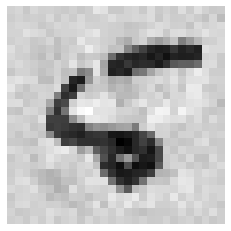

[217] (예측값)5 (실제값)6


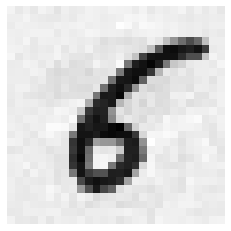

[247] (예측값)2 (실제값)4


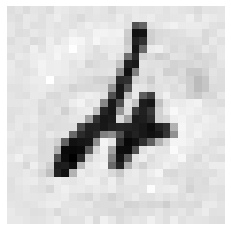

[297] (예측값)5 (실제값)0


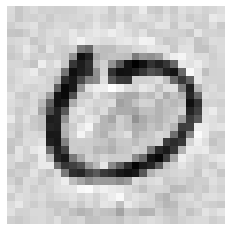

[321] (예측값)7 (실제값)2


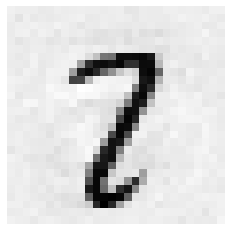

[324] (예측값)4 (실제값)0


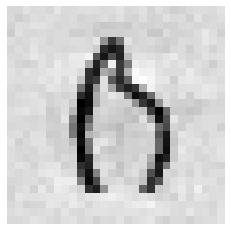

[340] (예측값)3 (실제값)5


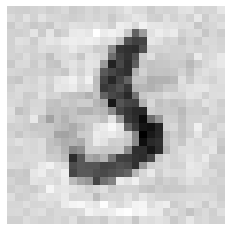

[404] (예측값)7 (실제값)2


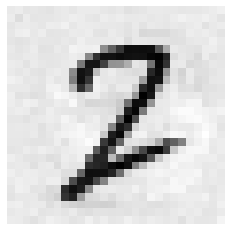

[412] (예측값)3 (실제값)5


[445] (예측값)0 (실제값)6


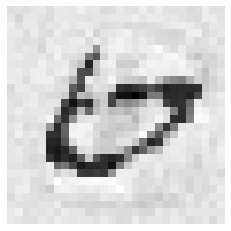

[449] (예측값)5 (실제값)3


[536] (예측값)1 (실제값)2


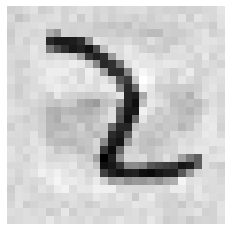

[543] (예측값)4 (실제값)8


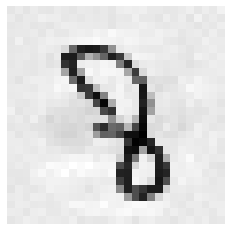

[582] (예측값)1 (실제값)8


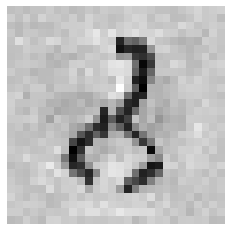

[610] (예측값)2 (실제값)4


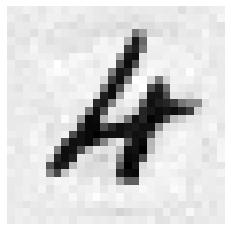

[619] (예측값)8 (실제값)1


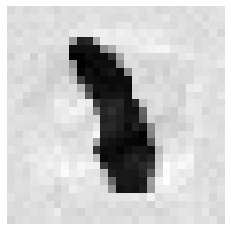

[684] (예측값)2 (실제값)7


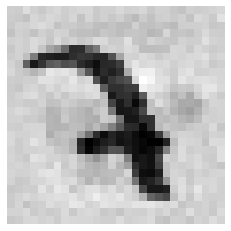

[691] (예측값)4 (실제값)8


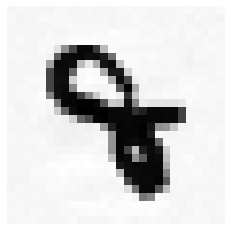

[707] (예측값)9 (실제값)4


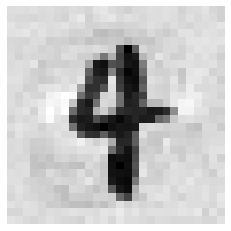

[720] (예측값)8 (실제값)5


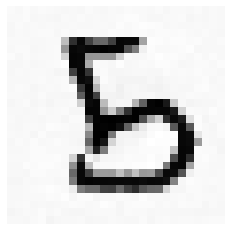

[738] (예측값)3 (실제값)2


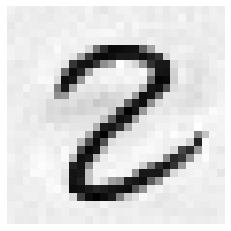

[760] (예측값)9 (실제값)4


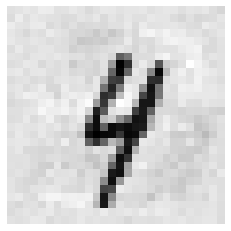

[839] (예측값)3 (실제값)8


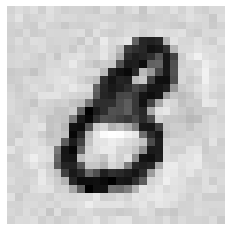

[844] (예측값)7 (실제값)8


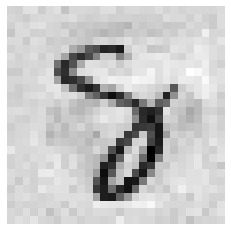

[900] (예측값)3 (실제값)1


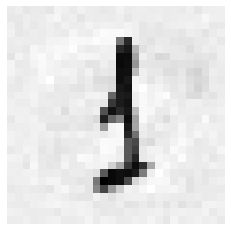

[947] (예측값)9 (실제값)8


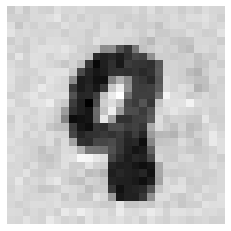

[951] (예측값)4 (실제값)5


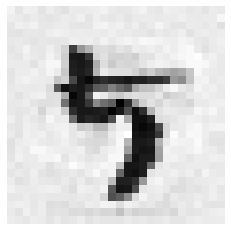

[956] (예측값)3 (실제값)1


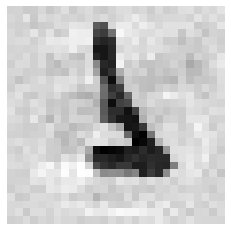

[965] (예측값)0 (실제값)6


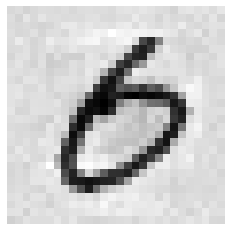

[1003] (예측값)3 (실제값)5


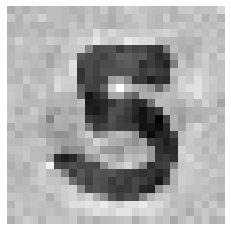

[1014] (예측값)2 (실제값)6


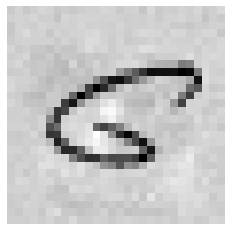

[1017] (예측값)2 (실제값)6


[1022] (예측값)9 (실제값)5


[1039] (예측값)2 (실제값)7


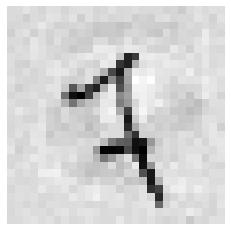

[1044] (예측값)8 (실제값)6


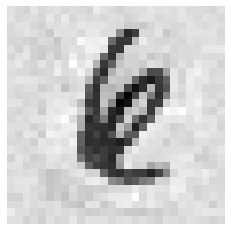

[1062] (예측값)9 (실제값)3


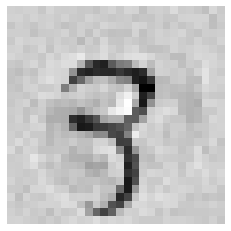

[1112] (예측값)6 (실제값)4


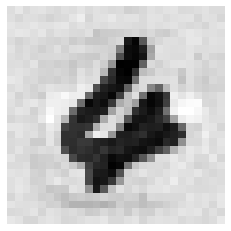

[1124] (예측값)7 (실제값)8


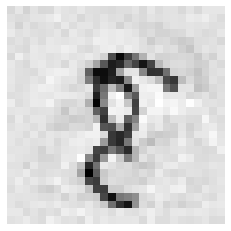

[1128] (예측값)7 (실제값)3


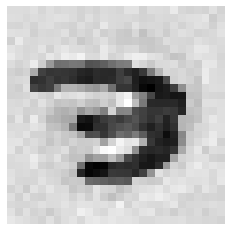

[1156] (예측값)8 (실제값)7


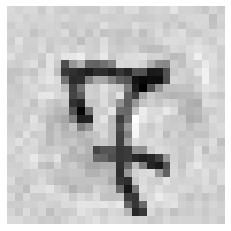

[1181] (예측값)1 (실제값)6


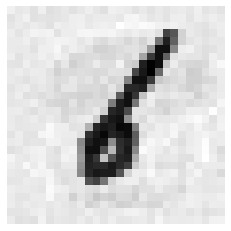

[1182] (예측값)8 (실제값)6


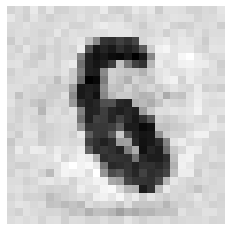

[1191] (예측값)7 (실제값)0


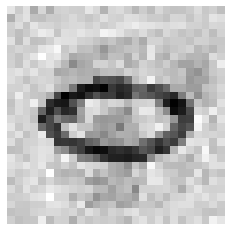

[1194] (예측값)2 (실제값)7


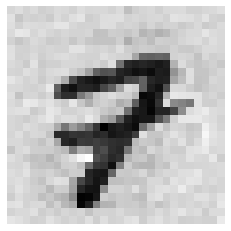

[1226] (예측값)2 (실제값)7


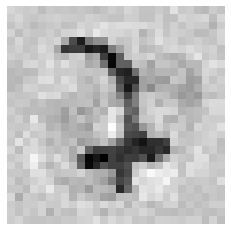

[1232] (예측값)4 (실제값)9


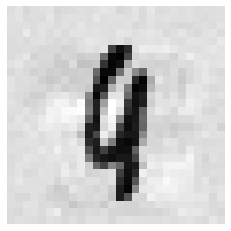

[1242] (예측값)9 (실제값)4


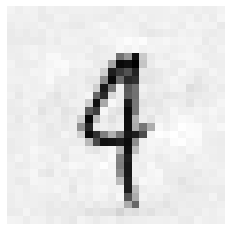

[1247] (예측값)3 (실제값)9


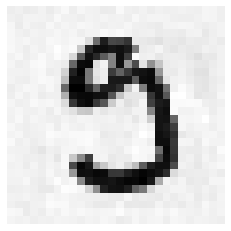

[1251] (예측값)1 (실제값)2


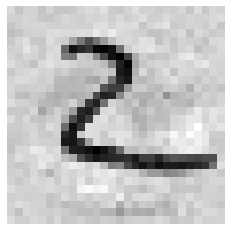

[1260] (예측값)1 (실제값)7


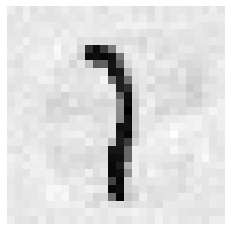

[1299] (예측값)7 (실제값)5


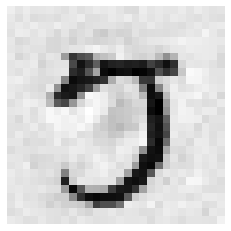

[1319] (예측값)6 (실제값)8


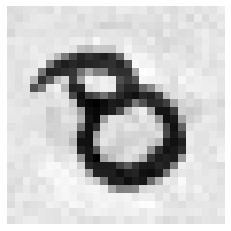

[1325] (예측값)6 (실제값)8


[1326] (예측값)2 (실제값)7


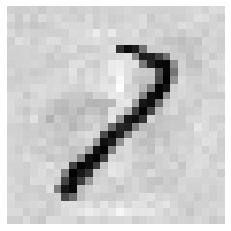

[1328] (예측값)9 (실제값)7


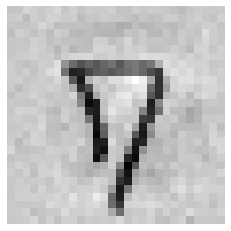

[1331] (예측값)3 (실제값)5


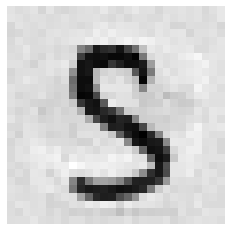

[1364] (예측값)2 (실제값)8


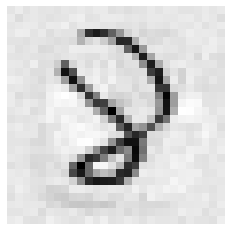

[1402] (예측값)7 (실제값)2


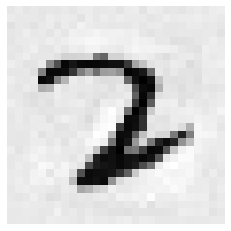

[1411] (예측값)8 (실제값)0


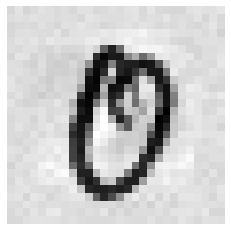

[1414] (예측값)7 (실제값)9


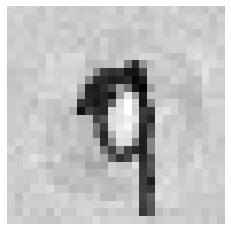

[1433] (예측값)1 (실제값)8


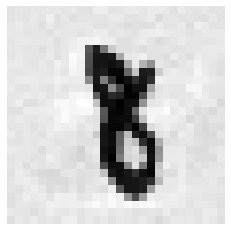

[1438] (예측값)6 (실제값)0


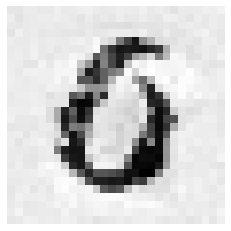

[1444] (예측값)4 (실제값)6


[1467] (예측값)9 (실제값)5


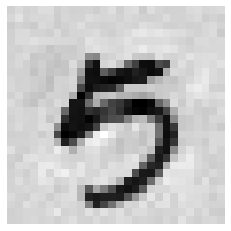

[1494] (예측값)9 (실제값)7


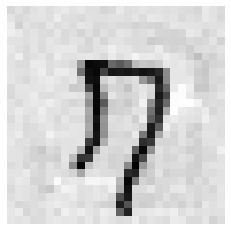

[1500] (예측값)1 (실제값)7


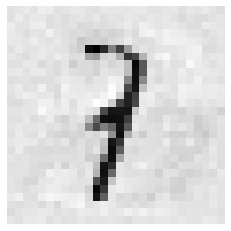

[1509] (예측값)7 (실제값)4


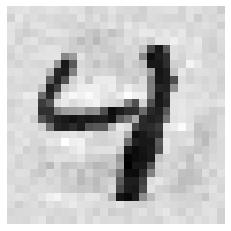

[1522] (예측값)9 (실제값)7


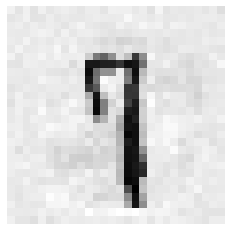

[1527] (예측값)3 (실제값)1


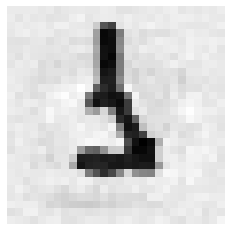

[1530] (예측값)7 (실제값)8


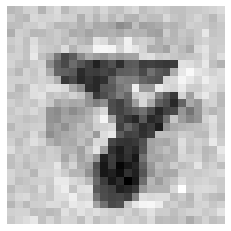

[1549] (예측값)6 (실제값)4


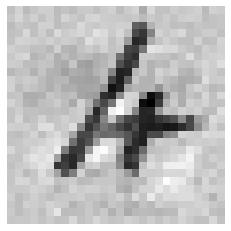

[1569] (예측값)7 (실제값)6


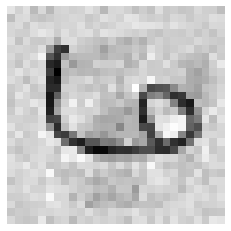

[1581] (예측값)9 (실제값)7


[1597] (예측값)8 (실제값)9


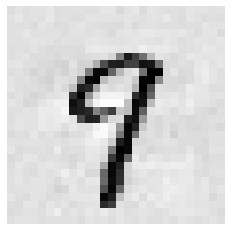

[1609] (예측값)6 (실제값)2


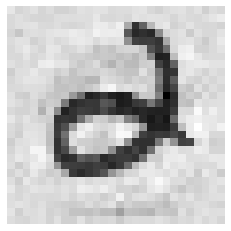

[1621] (예측값)6 (실제값)0


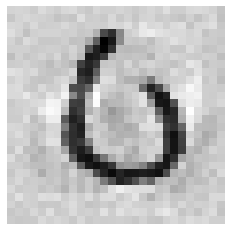

[1670] (예측값)3 (실제값)5


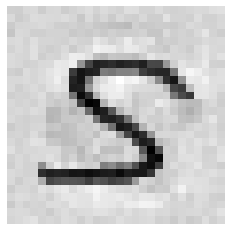

[1681] (예측값)7 (실제값)3


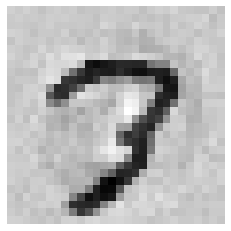

[1709] (예측값)5 (실제값)9


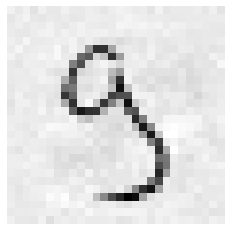

[1717] (예측값)0 (실제값)8


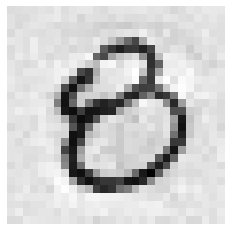

[1730] (예측값)5 (실제값)3


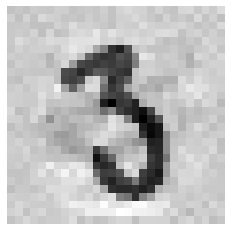

[1751] (예측값)2 (실제값)4


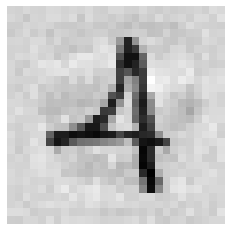

[1754] (예측값)2 (실제값)7


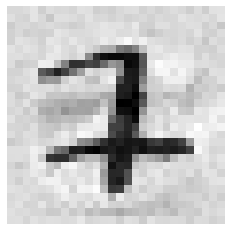

[1773] (예측값)8 (실제값)1


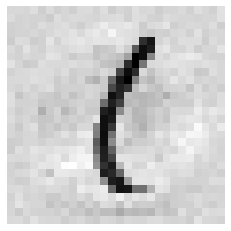

[1790] (예측값)7 (실제값)2


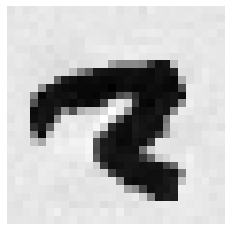

[1800] (예측값)4 (실제값)6


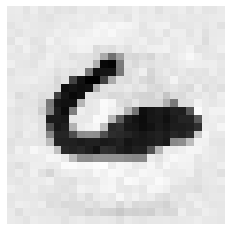

[1850] (예측값)7 (실제값)8


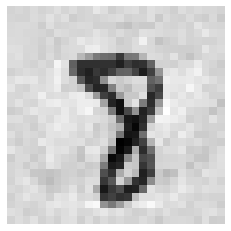

[1878] (예측값)3 (실제값)8


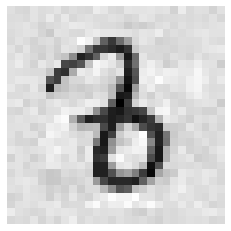

[1893] (예측값)3 (실제값)8


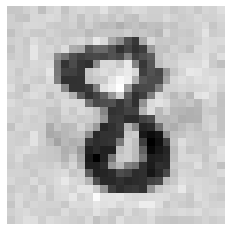

[1901] (예측값)4 (실제값)9


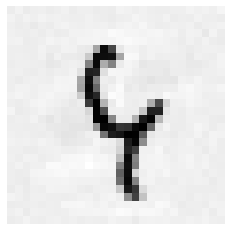

[1903] (예측값)2 (실제값)7


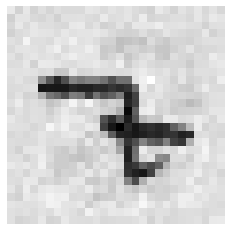

[1911] (예측값)6 (실제값)5


[1938] (예측값)6 (실제값)4


[1940] (예측값)0 (실제값)5


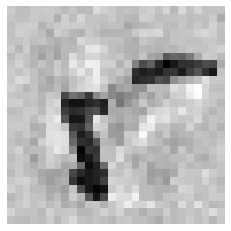

[1941] (예측값)2 (실제값)7


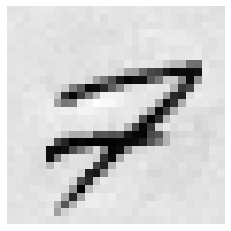

[1984] (예측값)0 (실제값)2


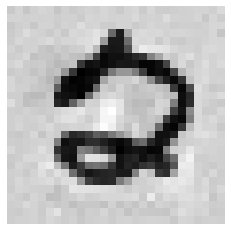

[2001] (예측값)8 (실제값)5


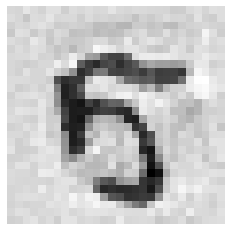

[2004] (예측값)2 (실제값)8


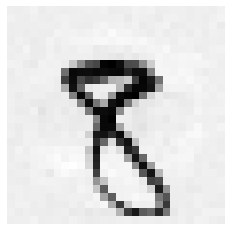

[2016] (예측값)2 (실제값)7


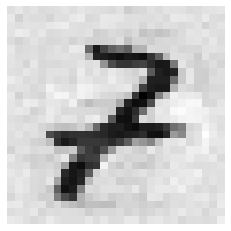

[2029] (예측값)6 (실제값)5


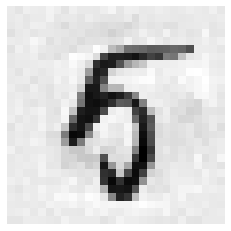

[2035] (예측값)3 (실제값)5


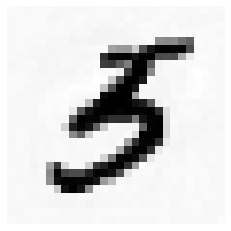

[2043] (예측값)8 (실제값)4


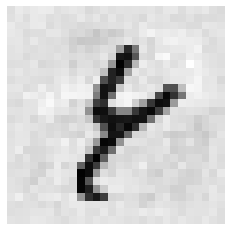

[2044] (예측값)7 (실제값)2


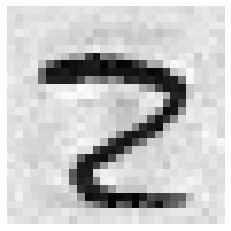

[2053] (예측값)9 (실제값)4


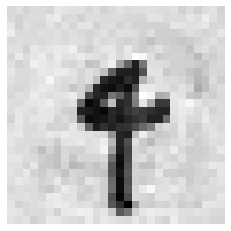

[2063] (예측값)3 (실제값)7


[2070] (예측값)9 (실제값)7


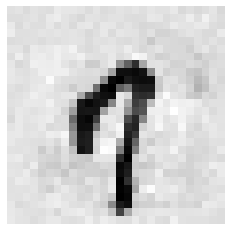

[2093] (예측값)1 (실제값)8


[2098] (예측값)0 (실제값)2


[2109] (예측값)7 (실제값)3


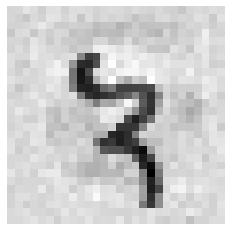

[2118] (예측값)0 (실제값)6


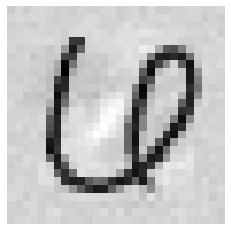

[2129] (예측값)2 (실제값)9


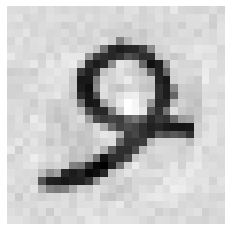

[2130] (예측값)9 (실제값)4


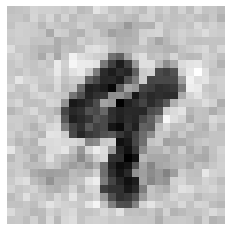

[2135] (예측값)1 (실제값)6


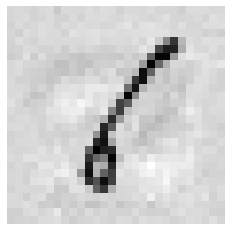

[2162] (예측값)8 (실제값)5


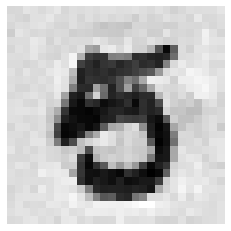

[2182] (예측값)3 (실제값)1


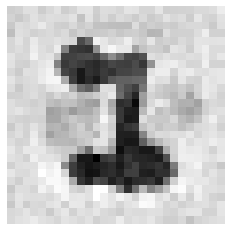

[2185] (예측값)8 (실제값)0


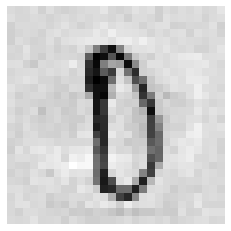

[2189] (예측값)8 (실제값)9


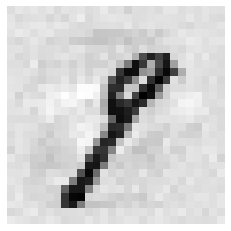

[2224] (예측값)6 (실제값)5


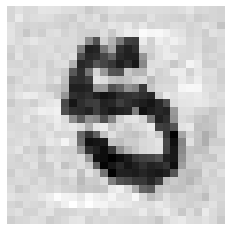

[2266] (예측값)3 (실제값)1


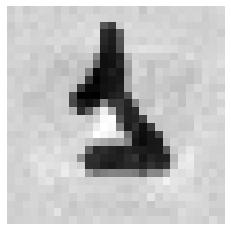

[2272] (예측값)0 (실제값)8


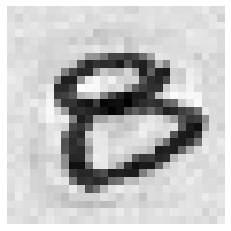

[2293] (예측값)6 (실제값)9


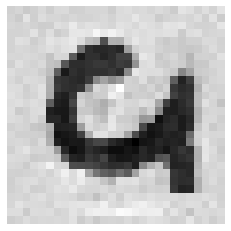

[2298] (예측값)0 (실제값)8


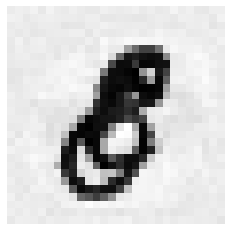

[2299] (예측값)7 (실제값)2


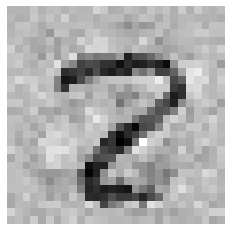

[2326] (예측값)5 (실제값)0


[2329] (예측값)2 (실제값)0


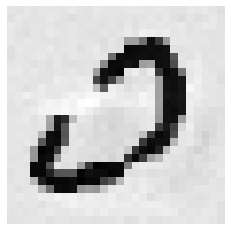

[2333] (예측값)2 (실제값)0


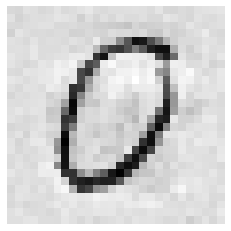

[2339] (예측값)8 (실제값)5


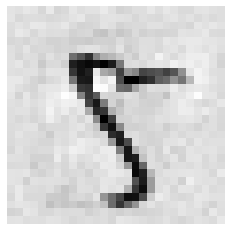

[2387] (예측값)1 (실제값)9


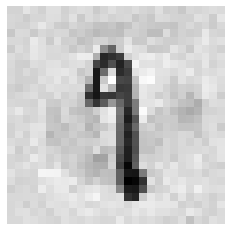

[2422] (예측값)4 (실제값)6


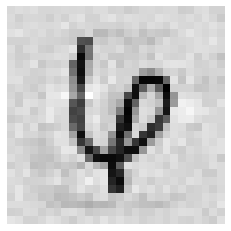

[2433] (예측값)1 (실제값)2


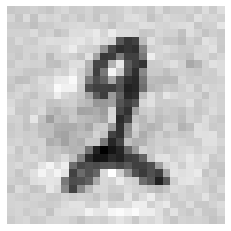

[2437] (예측값)1 (실제값)2


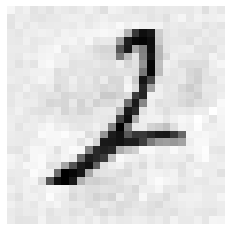

[2455] (예측값)5 (실제값)0


[2525] (예측값)3 (실제값)5


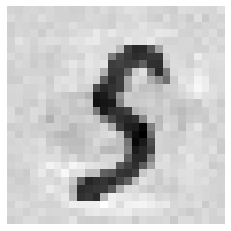

[2545] (예측값)3 (실제값)5


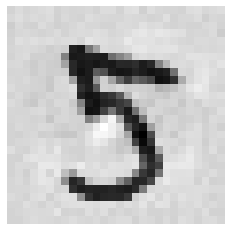

[2607] (예측값)1 (실제값)7


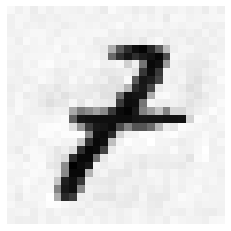

[2631] (예측값)6 (실제값)0


[2648] (예측값)5 (실제값)9


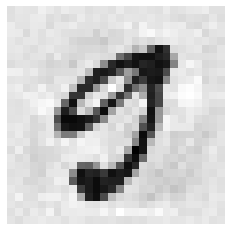

[2654] (예측값)1 (실제값)6


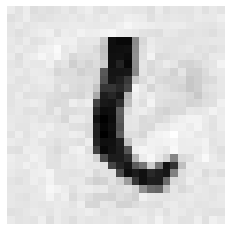

[2684] (예측값)5 (실제값)3


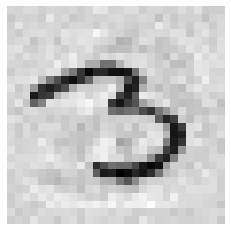

[2730] (예측값)3 (실제값)7


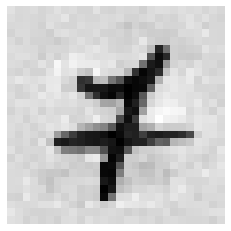

[2739] (예측값)4 (실제값)8


[2742] (예측값)7 (실제값)9


[2743] (예측값)8 (실제값)5


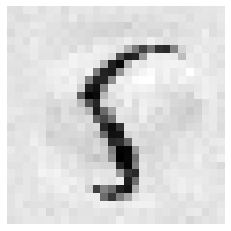

[2810] (예측값)3 (실제값)5


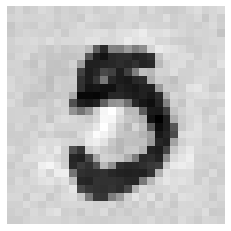

[2863] (예측값)4 (실제값)9


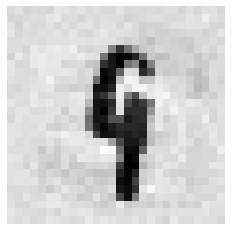

[2877] (예측값)7 (실제값)4


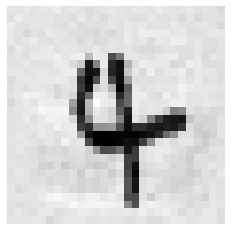

[2896] (예측값)0 (실제값)8


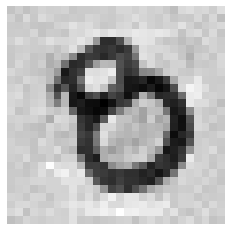

[2921] (예측값)8 (실제값)3


[2927] (예측값)2 (실제값)3


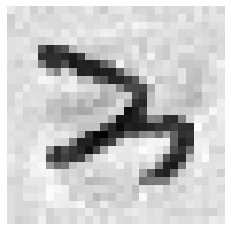

[2939] (예측값)7 (실제값)9


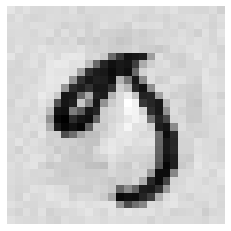

[2945] (예측값)7 (실제값)3


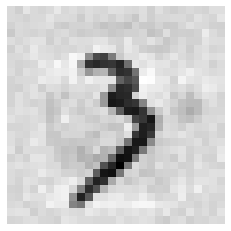

[2953] (예측값)5 (실제값)3


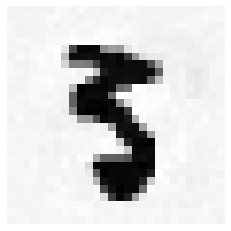

[3005] (예측값)1 (실제값)9


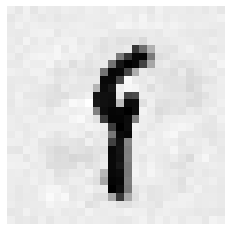

[3030] (예측값)8 (실제값)6


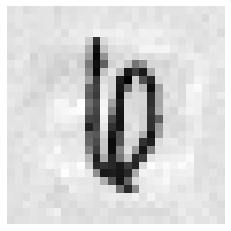

[3073] (예측값)3 (실제값)1


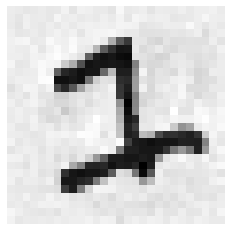

[3078] (예측값)8 (실제값)3


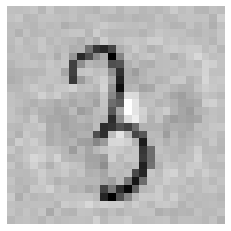

[3114] (예측값)6 (실제값)4


[3115] (예측값)4 (실제값)5


[3117] (예측값)9 (실제값)5


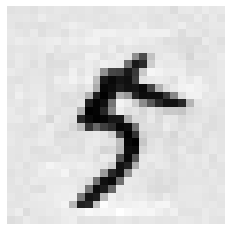

[3189] (예측값)6 (실제값)7


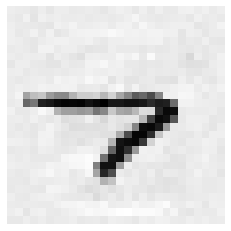

[3284] (예측값)7 (실제값)8


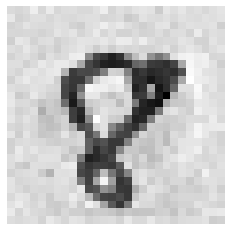

[3330] (예측값)3 (실제값)2


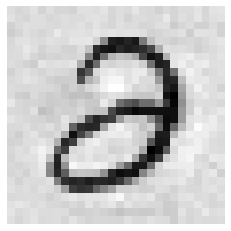

[3333] (예측값)9 (실제값)7


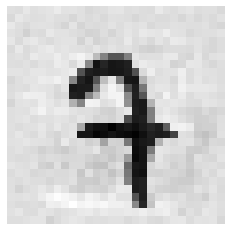

[3412] (예측값)9 (실제값)0


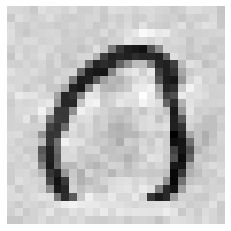

[3460] (예측값)4 (실제값)9


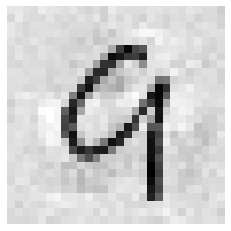

[3474] (예측값)1 (실제값)2


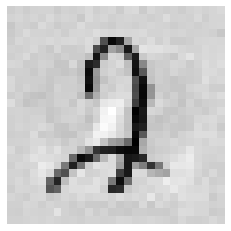

[3475] (예측값)7 (실제값)3


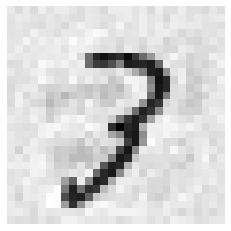

[3503] (예측값)1 (실제값)9


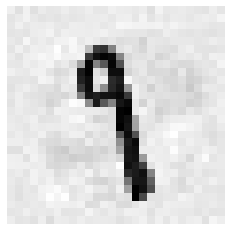

[3520] (예측값)4 (실제값)6


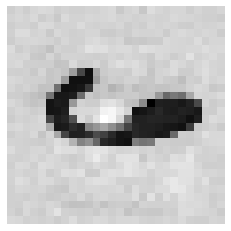

[3549] (예측값)2 (실제값)3


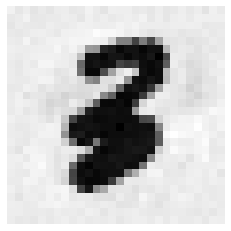

[3558] (예측값)0 (실제값)5


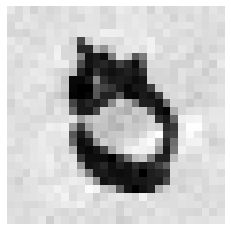

[3559] (예측값)5 (실제값)8


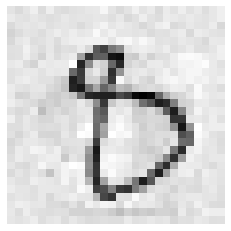

[3565] (예측값)8 (실제값)5


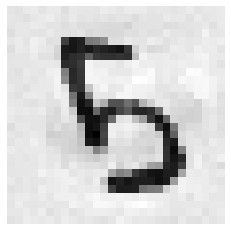

[3597] (예측값)3 (실제값)9


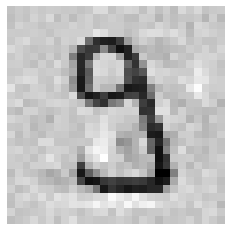

[3618] (예측값)8 (실제값)9


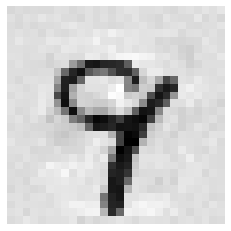

[3629] (예측값)3 (실제값)8


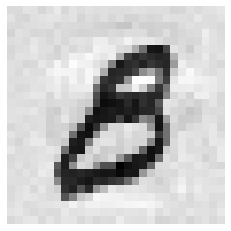

[3681] (예측값)8 (실제값)2


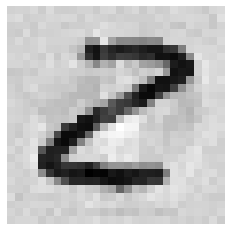

[3718] (예측값)9 (실제값)4


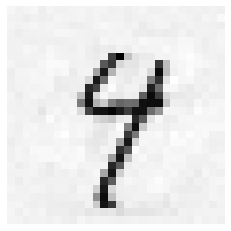

[3749] (예측값)4 (실제값)6


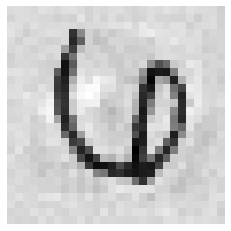

[3751] (예측값)3 (실제값)7


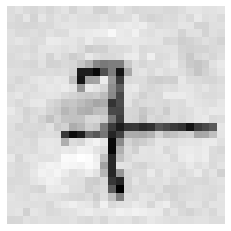

[3767] (예측값)2 (실제값)7


[3780] (예측값)6 (실제값)4


[3796] (예측값)8 (실제값)2


[3806] (예측값)8 (실제값)5


[3808] (예측값)3 (실제값)7


[3811] (예측값)9 (실제값)2


[3818] (예측값)6 (실제값)0


[3853] (예측값)5 (실제값)6


[3869] (예측값)4 (실제값)9


[3893] (예측값)6 (실제값)5


[3902] (예측값)3 (실제값)5


[3906] (예측값)3 (실제값)1


[3941] (예측값)2 (실제값)4


[3951] (예측값)7 (실제값)8


[3968] (예측값)3 (실제값)5


[3976] (예측값)1 (실제값)7


[4000] (예측값)8 (실제값)9


[4065] (예측값)2 (실제값)0


[4075] (예측값)0 (실제값)8


[4078] (예측값)3 (실제값)9


[4093] (예측값)4 (실제값)9


[4140] (예측값)2 (실제값)8


[4149] (예측값)3 (실제값)2


[4163] (예측값)4 (실제값)9


[4199] (예측값)9 (실제값)7


[4201] (예측값)7 (실제값)1


[4205] (예측값)3 (실제값)2


[4224] (예측값)7 (실제값)9


[4248] (예측값)8 (실제값)2


[4271] (예측값)3 (실제값)5


[4289] (예측값)7 (실제값)2


[4300] (예측값)3 (실제값)5


[4350] (예측값)8 (실제값)2


[4355] (예측값)3 (실제값)5


[4369] (예측값)4 (실제값)9


[4425] (예측값)4 (실제값)9


[4477] (예측값)6 (실제값)0


[4497] (예측값)7 (실제값)8


[4500] (예측값)1 (실제값)9


[4534] (예측값)3 (실제값)9


[4536] (예측값)8 (실제값)6


[4552] (예측값)9 (실제값)3


[4601] (예측값)4 (실제값)8


[4639] (예측값)7 (실제값)8


[4740] (예측값)1 (실제값)3


[4807] (예측값)3 (실제값)8


[4823] (예측값)6 (실제값)9


[4860] (예측값)9 (실제값)4


[4880] (예측값)6 (실제값)0


[4886] (예측값)1 (실제값)7


[4950] (예측값)1 (실제값)2


[4956] (예측값)4 (실제값)8


[4966] (예측값)3 (실제값)7


[5086] (예측값)4 (실제값)2


[5127] (예측값)7 (실제값)2


[5165] (예측값)5 (실제값)0


[5176] (예측값)4 (실제값)8


[5201] (예측값)9 (실제값)4


[5283] (예측값)8 (실제값)3


[5331] (예측값)6 (실제값)1


[5457] (예측값)8 (실제값)1


[5493] (예측값)3 (실제값)8


[5600] (예측값)9 (실제값)7


[5634] (예측값)3 (실제값)2


[5642] (예측값)5 (실제값)1


[5734] (예측값)2 (실제값)3


[5735] (예측값)6 (실제값)5


[5749] (예측값)5 (실제값)8


[5757] (예측값)7 (실제값)9


[5913] (예측값)3 (실제값)5


[5922] (예측값)3 (실제값)5


[5936] (예측값)9 (실제값)4


[5937] (예측값)3 (실제값)5


[5973] (예측값)9 (실제값)3


[5975] (예측값)9 (실제값)4


[5981] (예측값)9 (실제값)5


[5982] (예측값)3 (실제값)5


[6023] (예측값)9 (실제값)3


[6030] (예측값)9 (실제값)3


[6042] (예측값)9 (실제값)5


[6059] (예측값)9 (실제값)3


[6091] (예측값)3 (실제값)9


[6166] (예측값)3 (실제값)9


[6172] (예측값)3 (실제값)9


[6174] (예측값)5 (실제값)3


[6392] (예측값)2 (실제값)5


[6400] (예측값)6 (실제값)0


[6416] (예측값)3 (실제값)9


[6505] (예측값)0 (실제값)9


[6555] (예측값)7 (실제값)8


[6557] (예측값)2 (실제값)0


[6564] (예측값)9 (실제값)3


[6576] (예측값)1 (실제값)7


[6590] (예측값)5 (실제값)0


[6597] (예측값)9 (실제값)0


[6598] (예측값)3 (실제값)5


[6599] (예측값)9 (실제값)7


[6603] (예측값)7 (실제값)8


[6625] (예측값)3 (실제값)8


[6641] (예측값)5 (실제값)8


[6651] (예측값)8 (실제값)0


[6681] (예측값)0 (실제값)3


[6706] (예측값)9 (실제값)5


[6755] (예측값)9 (실제값)8


[6783] (예측값)6 (실제값)1


[6784] (예측값)8 (실제값)9


[6826] (예측값)2 (실제값)8


[6847] (예측값)4 (실제값)6


[6926] (예측값)4 (실제값)6


[7031] (예측값)3 (실제값)0


[7081] (예측값)4 (실제값)9


[7210] (예측값)8 (실제값)6


[7216] (예측값)6 (실제값)0


[7434] (예측값)8 (실제값)4


[7451] (예측값)4 (실제값)5


[7459] (예측값)5 (실제값)9


[7472] (예측값)7 (실제값)2


[7492] (예측값)9 (실제값)2


[7732] (예측값)8 (실제값)5


[7783] (예측값)8 (실제값)1


[7797] (예측값)6 (실제값)5


[7821] (예측값)2 (실제값)3


[7823] (예측값)2 (실제값)8


[7899] (예측값)8 (실제값)1


[7902] (예측값)9 (실제값)7


[8020] (예측값)8 (실제값)1


[8062] (예측값)8 (실제값)5


[8094] (예측값)8 (실제값)2


[8246] (예측값)8 (실제값)3


[8255] (예측값)0 (실제값)4


[8277] (예측값)8 (실제값)3


[8293] (예측값)5 (실제값)3


[8311] (예측값)4 (실제값)6


[8339] (예측값)6 (실제값)8


[8408] (예측값)4 (실제값)8


[8520] (예측값)9 (실제값)4


[8522] (예측값)6 (실제값)8


[8527] (예측값)9 (실제값)4


[8639] (예측값)3 (실제값)2


[9009] (예측값)2 (실제값)7


[9015] (예측값)2 (실제값)7


[9019] (예측값)2 (실제값)7


[9024] (예측값)2 (실제값)7


[9036] (예측값)2 (실제값)7


[9168] (예측값)8 (실제값)2


[9411] (예측값)9 (실제값)4


[9427] (예측값)3 (실제값)5


[9500] (예측값)7 (실제값)2


[9587] (예측값)4 (실제값)9


[9634] (예측값)3 (실제값)0


[9664] (예측값)7 (실제값)2


[9679] (예측값)5 (실제값)6


[9698] (예측값)5 (실제값)6


[9726] (예측값)3 (실제값)2


[9729] (예측값)6 (실제값)5


[9738] (예측값)6 (실제값)4


[9745] (예측값)6 (실제값)4


[9749] (예측값)0 (실제값)5


[9752] (예측값)0 (실제값)2


[9755] (예측값)5 (실제값)8


[9768] (예측값)9 (실제값)2


[9770] (예측값)0 (실제값)5


[9808] (예측값)4 (실제값)9


[9811] (예측값)3 (실제값)2


[9839] (예측값)3 (실제값)2


[9867] (예측값)8 (실제값)2


[9879] (예측값)2 (실제값)0


[9891] (예측값)4 (실제값)9


[9892] (예측값)5 (실제값)8


[9940] (예측값)4 (실제값)6


[9944] (예측값)8 (실제값)3


[9975] (예측값)8 (실제값)3


[9982] (예측값)6 (실제값)5


In [23]:
Adversarial_Training()
Report_Performance()